In [1]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
import pandas as pd
import time
from sklearn.externals import joblib
from sklearn.model_selection import cross_val_score
import numpy as np
from sklearn.exceptions import ConvergenceWarning
from sklearn.preprocessing import StandardScaler

In [2]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
class LearningManager:
    def __init__(self, mode):
        self.mode = mode
        if mode == 1:  # news_content
            self.classifer_path = "model\svm_news.pkl"
            self.sc_path = "model\sc_news.pkl"
        elif mode == 2:    # news_title
            self.classifer_path = "model\svm_news_title.pkl"
            self.sc_path = "model\sc_news_title.pkl"
        elif mode == 3:    # blog_content
            self.classifer_path = "model\svm_blog.pkl"
            self.sc_path = "model\sc_blog.pkl"
        elif mode == 4:    # blog_title
            self.classifer_path = "model\svm_blog_title.pkl"
            self.sc_path = "model\sc_blog_title.pkl"
        elif mode == 5:    # shopping mall_content
            self.classifer_path = "model\svm_shop.pkl"
            self.sc_path = "model\sc_shop.pkl"
        elif mode == 6:    # shopping mall_title
            self.classifer_path = "model\svm_shop_title.pkl"
            self.sc_path = "model\sc_shop_title.pkl"

        try:
            self.classifer = joblib.load(self.classifer_path)
            self.sc = joblib.load(self.sc_path)
        except:
            self.classifer = SVC(random_state=1)
            self.sc = StandardScaler()

        self.x_train = []
        self.y_train = []
        self.x_test = []
        self.y_test = []

    def readdata(self, filedir): # [content, x, y, w, h, font_size, label]
        csv = pd.read_csv(filedir, header=None, encoding="utf-8")
        for index, row in csv.iterrows():
            if not (row[1] == 0.0 and row[2] == 0.0 and row[3] == 0.0 and row[4] == 0.0):
                block = [row[1], row[2], row[3], row[4], row[5]]
                self.x_train.append(block)
                self.y_train.append(row[6])

    def fit(self):
        self.classifer.fit(self.x_train_std, self.y_train)
        joblib.dump(self.classifer, self.classifer_path)

    def preprocessing(self):
        self.sc.fit(self.x_train)
        self.x_train_std = self.sc.transform(self.x_train)
        joblib.dump(self.sc, self.sc_path)

    def resetmodel(self):
        self.classifer = SVC(random_state=1)
        self.sc = StandardScaler()

    def setmodel(self, params):
        try:
            self.classifer = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], max_iter=params["max_iter"], class_weight=params["class_weight"])
        except:
            self.classifer = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], max_iter=params["max_iter"])

    def eval_train(self):
        scores = cross_val_score(estimator=self.classifer, X=self.x_train_std, y=self.y_train, cv=5, n_jobs=-1, scoring="accuracy")
        print('Train CV accuracy scores: %s' % scores)
        print('Train CV accuracy: {0:.3f} +/- {1:.3f}'.format(np.mean(scores), np.std(scores)))

        scores = cross_val_score(estimator=self.classifer, X=self.x_train_std, y=self.y_train, cv=5, n_jobs=-1,scoring="f1_weighted")
        print('Train CV f1 scores: %s' % scores)
        print('Train CV f1: {0:.3f} +/- {1:.3f}'.format(np.mean(scores), np.std(scores)))
    def readtest(self, filedir): # [content, x, y, w, h, font_size, label]
        csv = pd.read_csv(filedir, header=None, encoding="utf-8")
        for index, row in csv.iterrows():
            if not (row[1] == 0.0 and row[2] == 0.0 and row[3] == 0.0 and row[4] == 0.0):
                block = [row[1], row[2], row[3], row[4], row[5]]
                self.x_test.append(block)
                self.y_test.append(row[6])
        self.x_test = self.sc.transform(self.x_test)
        
    def eval_test(self):
        y_pred = self.classifer.predict(self.x_test)
        print("Test accuracy : ",accuracy_score(y_pred,self.y_test))

        y_pred = self.classifer.predict(self.x_test)
        print("Test f1 : ",f1_score(y_pred,self.y_test))

In [3]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
def plot(mode,flag):
    learningmanager = LearningManager(mode)
    learningmanager.resetmodel()
    if flag == "train":
        if mode == 1:
            path = "dataset/train_news.csv"
        elif mode == 2:
            path = "dataset/train_news_title.csv"
        elif mode == 3:
            path = "dataset/train_blog.csv"
        elif mode == 4:
            path = "dataset/train_blog_title.csv"
        elif mode == 5:
            path = "dataset/train_shop.csv"
        elif mode == 6:
            path = "dataset/train_shop_title.csv"
    elif flag == "test":
        if mode == 1:
            path = "dataset/test_news.csv"
        elif mode == 2:
            path = "dataset/test_news_title.csv"
        elif mode == 3:
            path = "dataset/test_blog.csv"
        elif mode == 4:
            path = "dataset/test_blog_title.csv"
        elif mode == 5:
            path = "dataset/test_shop.csv"
        elif mode == 6:
            path = "dataset/test_shop_title.csv"
    learningmanager.readdata(path)
    learningmanager.preprocessing()
    
    # x, y, w, h, font size 분포
    for i in range(0,5):
        plt.hist(learningmanager.x_train_std[:,i],bins=100)
        plt.show()
        
    # x, y 분포
    y = learningmanager.y_train
    x_1 = []
    x_0 = []
    for i in range(len(y)):
        if y[i] == 1:
            x_1.append(learningmanager.x_train_std[i])
        else:
            x_0.append(learningmanager.x_train_std[i])
    x_1 = np.array(x_1)
    x_0 = np.array(x_0)

    plt.scatter(x=x_1[:,0],y=x_1[:,1],s=0.5,c="red")
    plt.scatter(x=x_0[:,0],y=x_0[:,1],s=0.5)
    plt.title("X,Y")
    plt.show()

    # x, y, w 분포
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111, projection='3d')
#     ax.view_init(0,60)
    ax.scatter(x_1[:,0], x_1[:,1], x_1[:,2],s=0.5,c="red")
    ax.scatter(x_0[:,0], x_0[:,1], x_0[:,2],s=0.5)
    plt.title("X,Y,W")
    plt.show()
    
    # PCA 확인
    pca = PCA()
    pca.fit(learningmanager.x_train_std)
    plt.bar(range(1, 6), pca.explained_variance_ratio_, alpha=0.5, align='center')
    plt.step(range(1, 6), np.cumsum(pca.explained_variance_ratio_), where='mid')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal components')
    plt.show()
    
    # PCA(3) 분포
    x = learningmanager.x_train
    pca = PCA(3)
    sc = StandardScaler()
    x = pca.fit_transform(x)
    x = sc.fit_transform(x)

    y = learningmanager.y_train
    x_1 = []
    x_0 = []
    for i in range(len(y)):
        if y[i] == 1:
            x_1.append(x[i])
        else:
            x_0.append(x[i])
    x_1 = np.array(x_1)
    x_0 = np.array(x_0)

    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111, projection='3d')
#     ax.view_init(45,0)
    ax.scatter(x_1[:,0], x_1[:,1], x_1[:,2],s=0.5,c="red")
    ax.scatter(x_0[:,0], x_0[:,1], x_0[:,2],s=0.5)
    plt.title("PCA_3")
    plt.show()

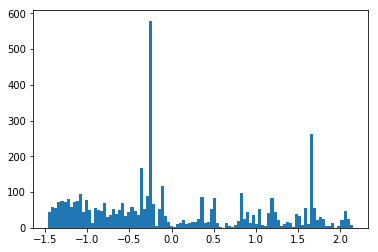

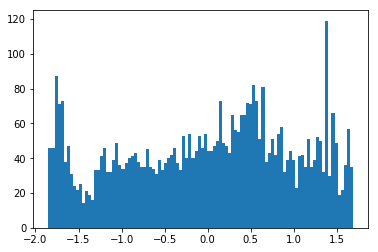

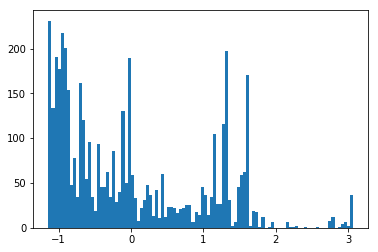

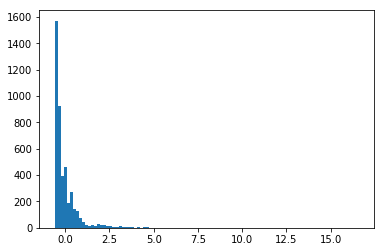

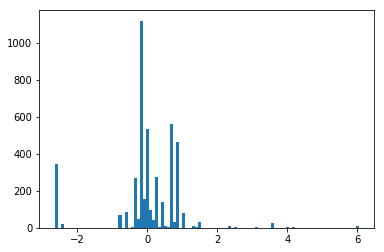

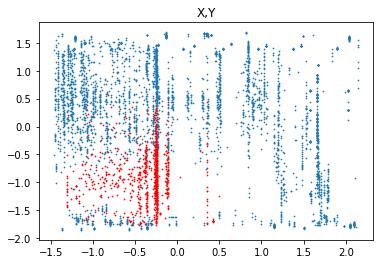

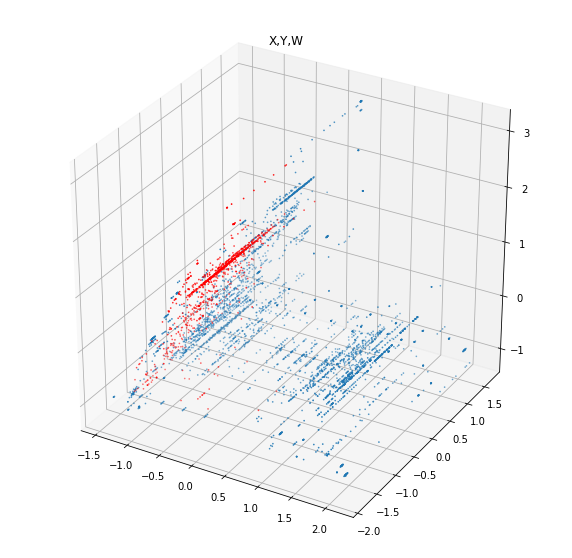

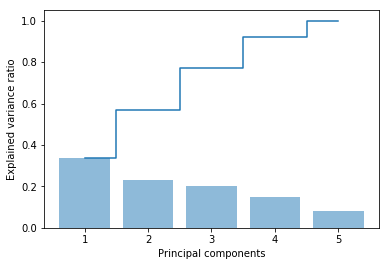

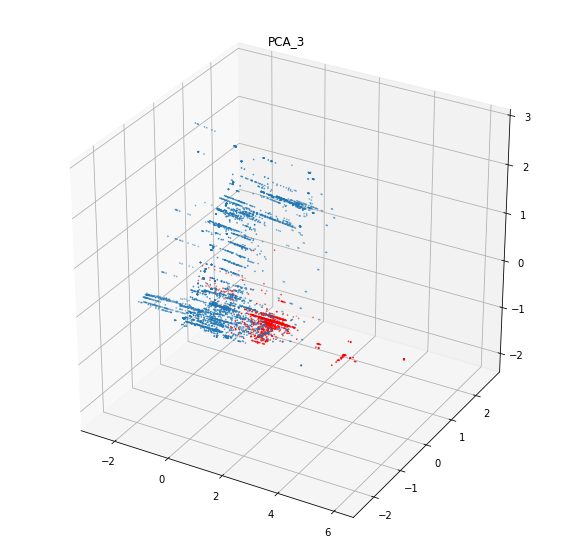

In [4]:
plot(1,"train")

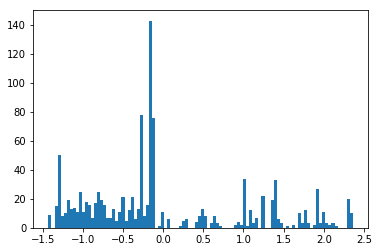

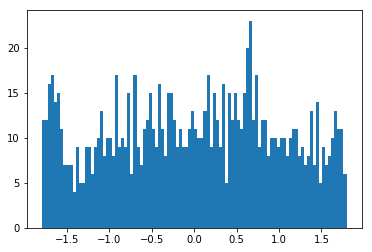

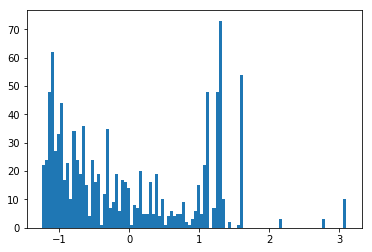

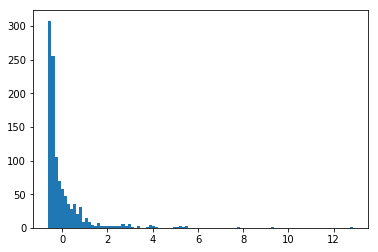

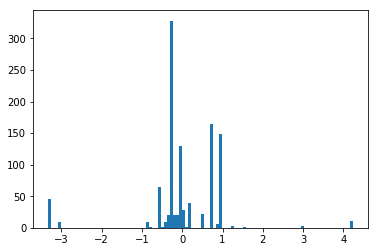

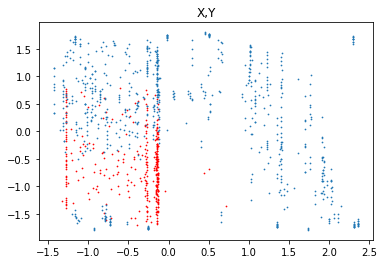

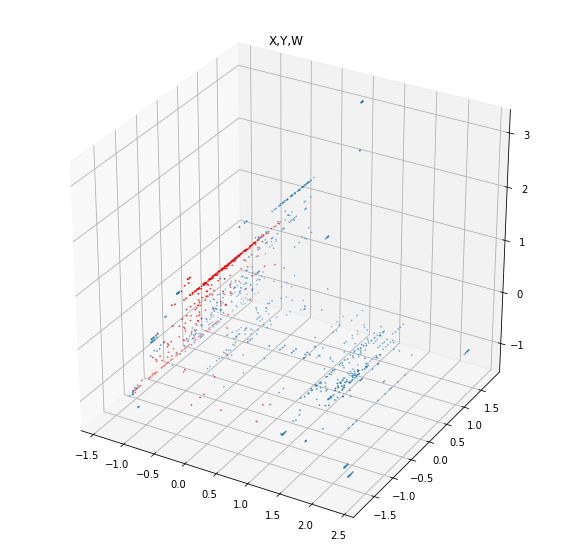

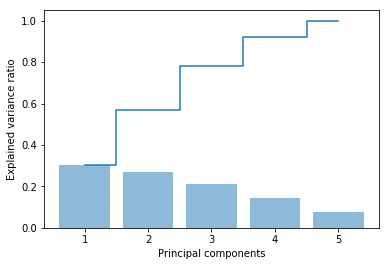

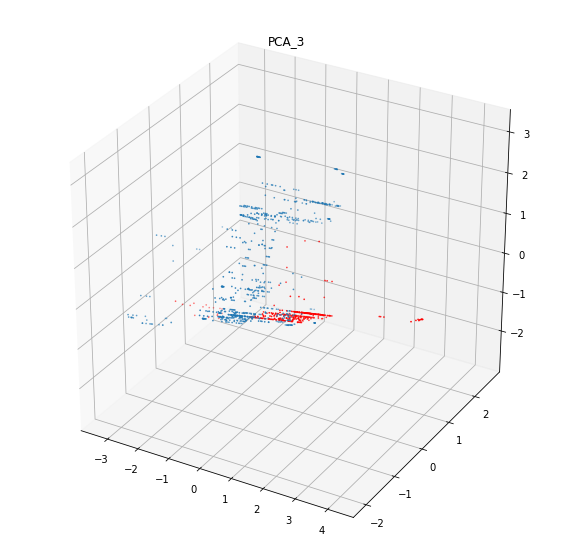

In [5]:
plot(1,"test")

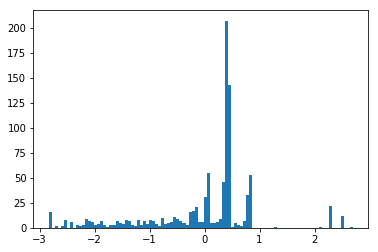

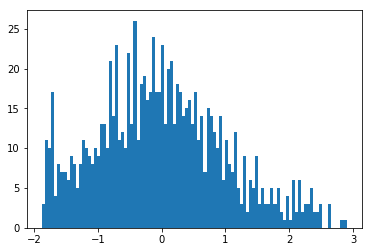

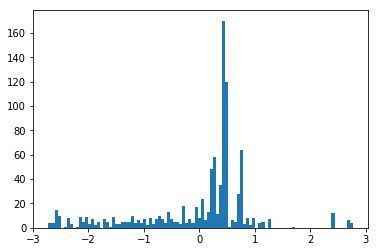

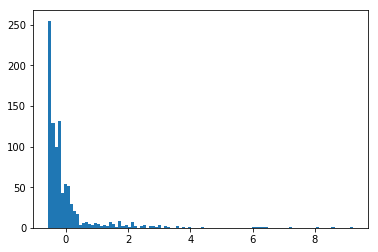

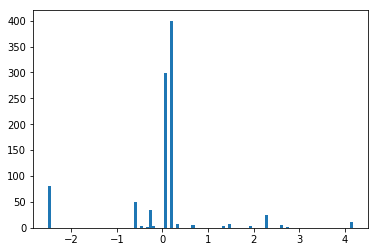

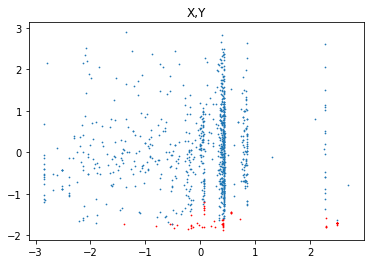

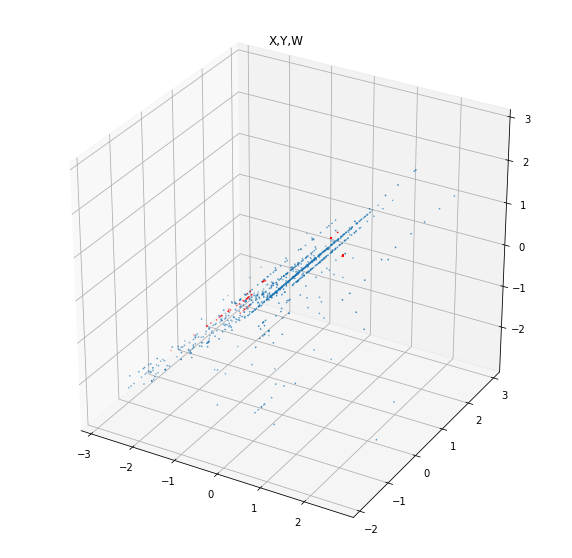

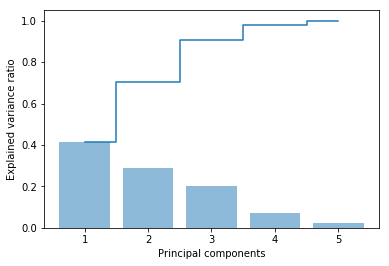

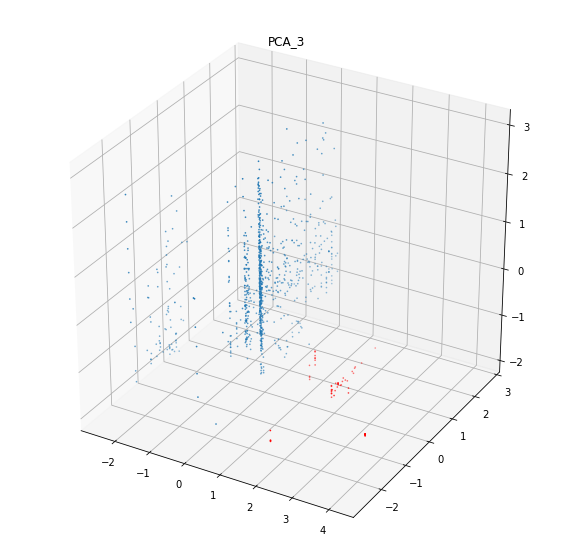

In [6]:
plot(2,"train")

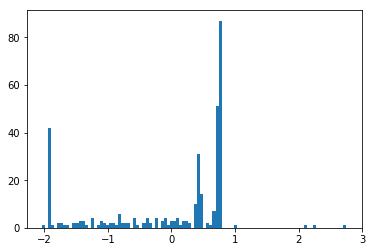

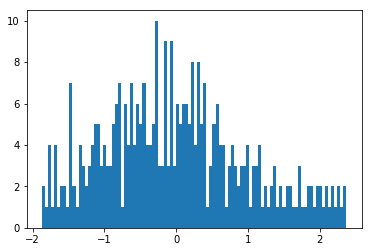

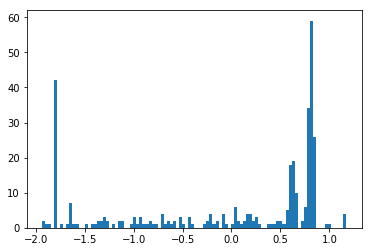

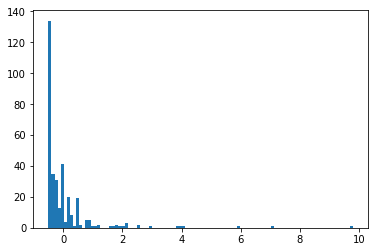

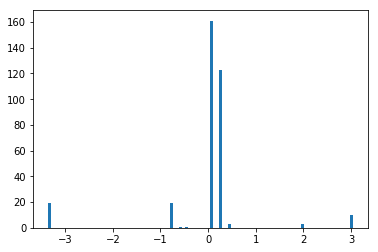

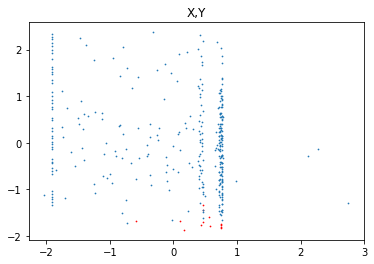

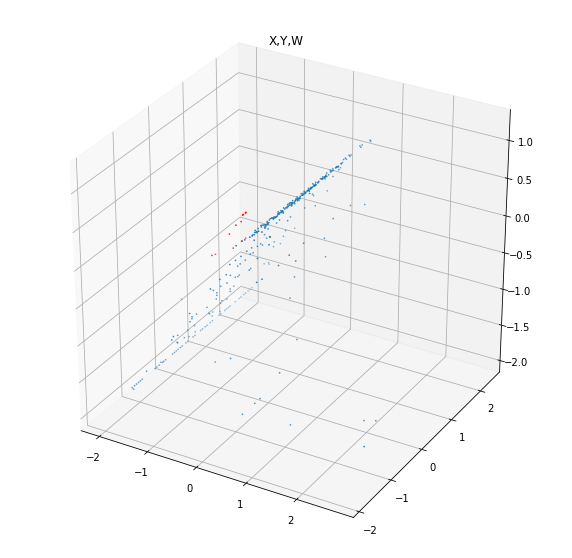

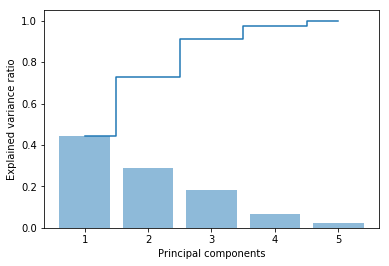

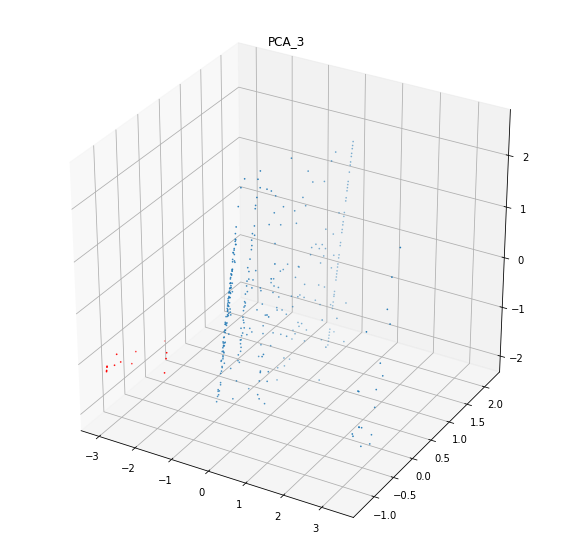

In [7]:
plot(2,"test")

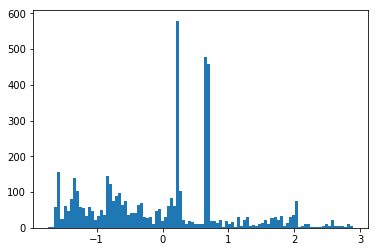

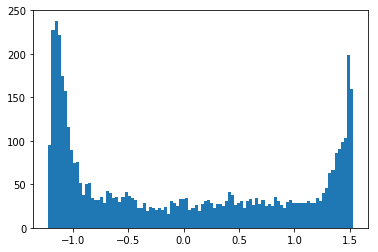

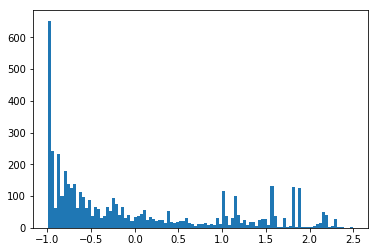

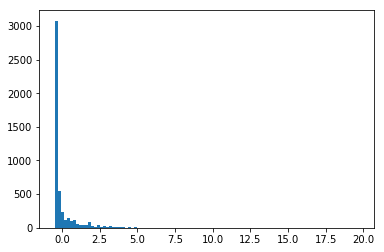

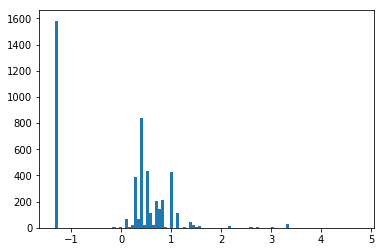

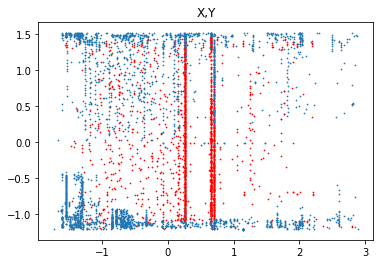

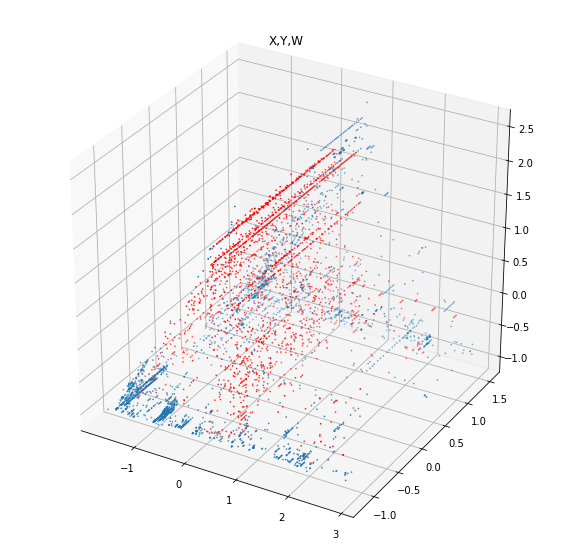

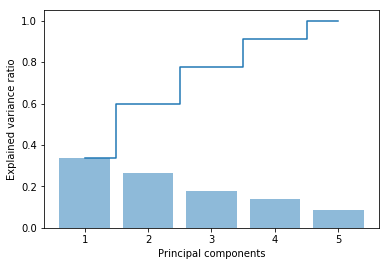

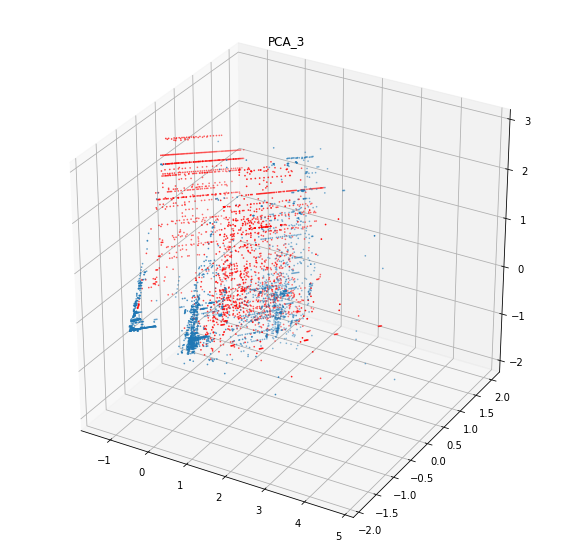

In [8]:
plot(3,"train")

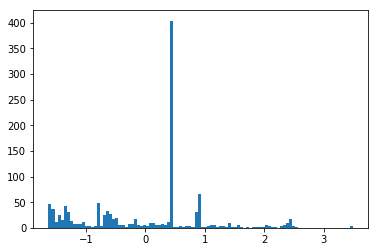

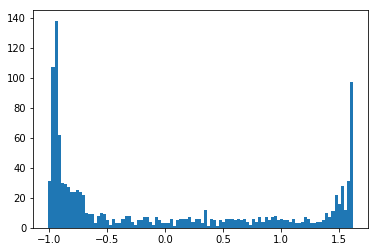

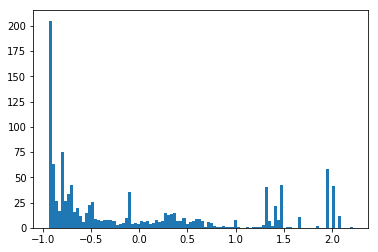

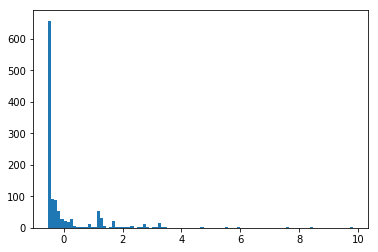

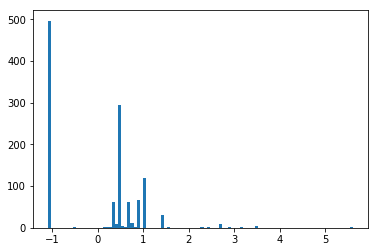

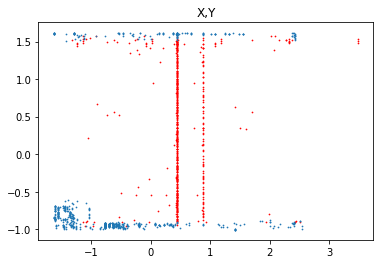

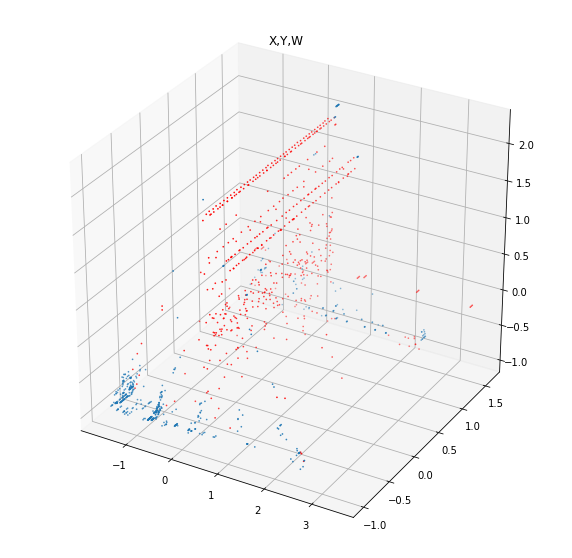

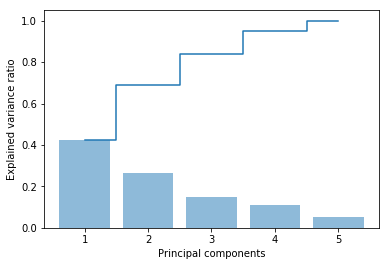

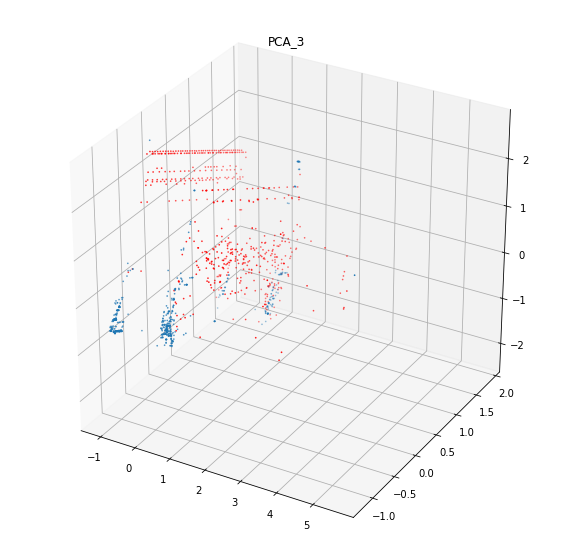

In [9]:
plot(3,"test")

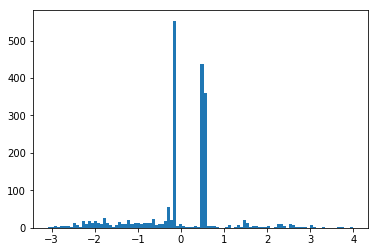

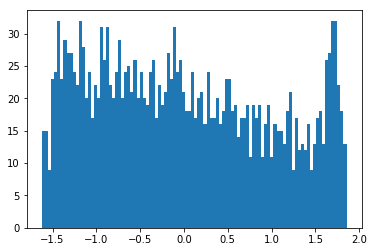

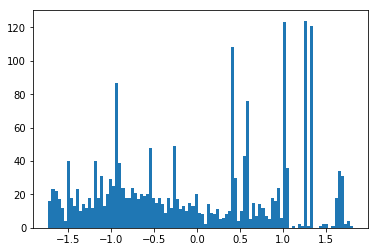

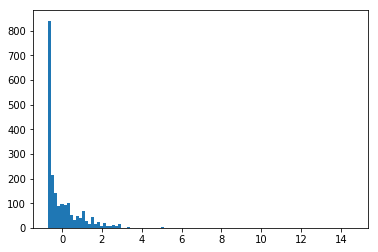

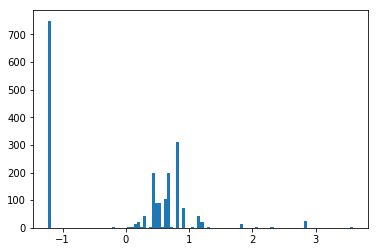

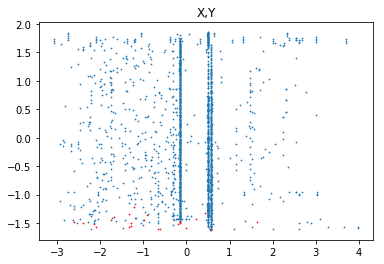

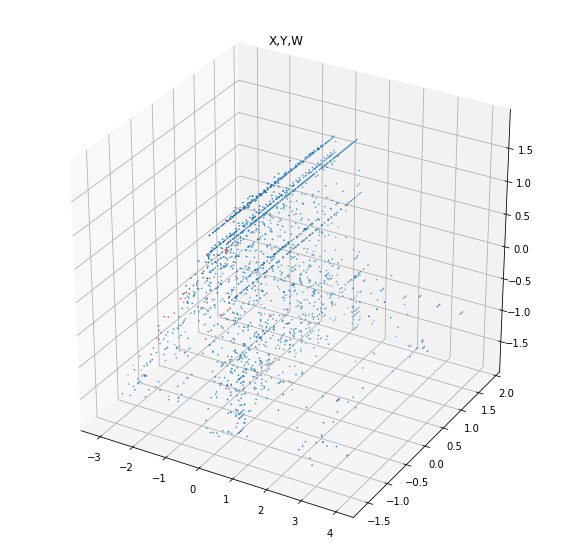

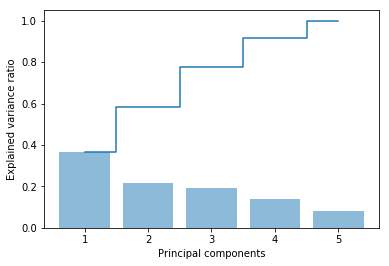

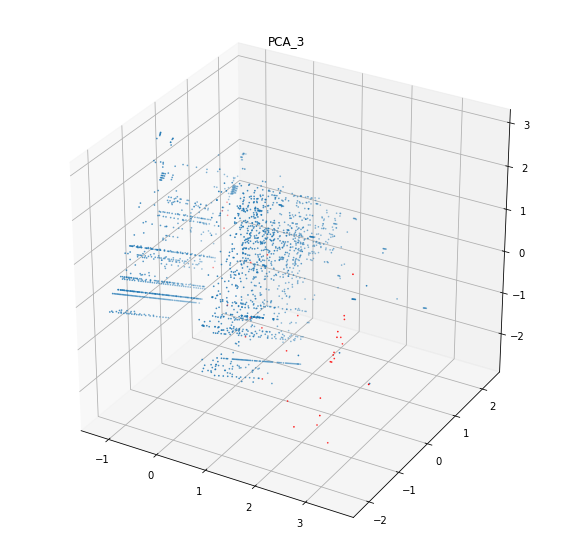

In [10]:
plot(4,"train")

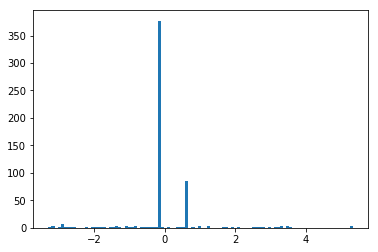

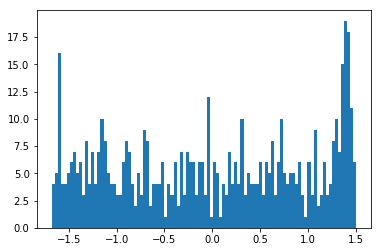

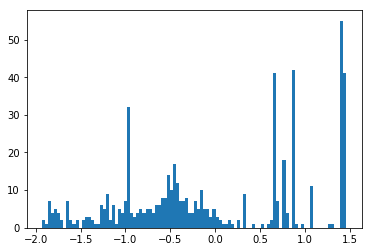

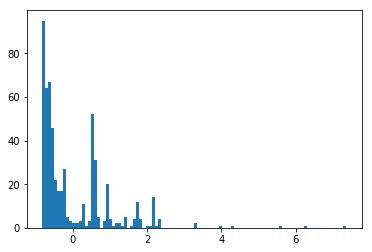

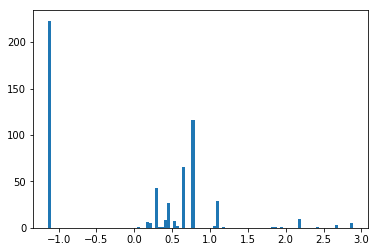

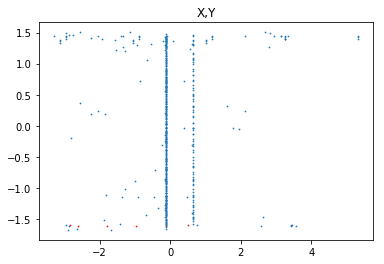

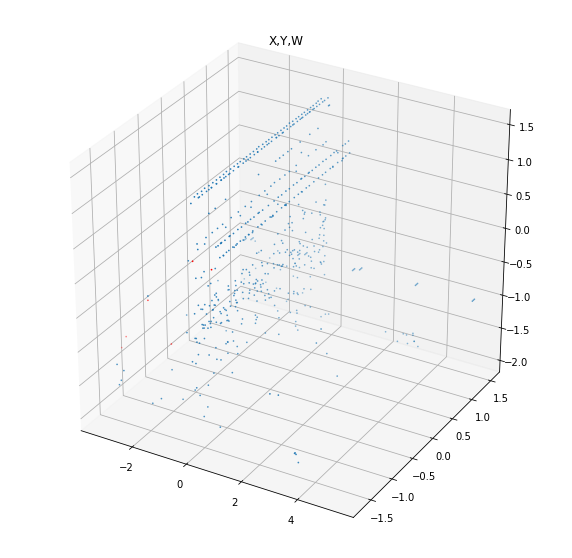

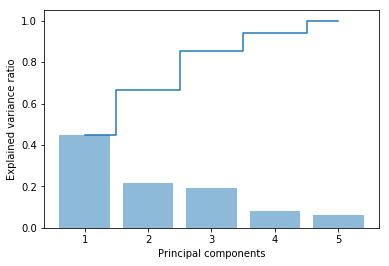

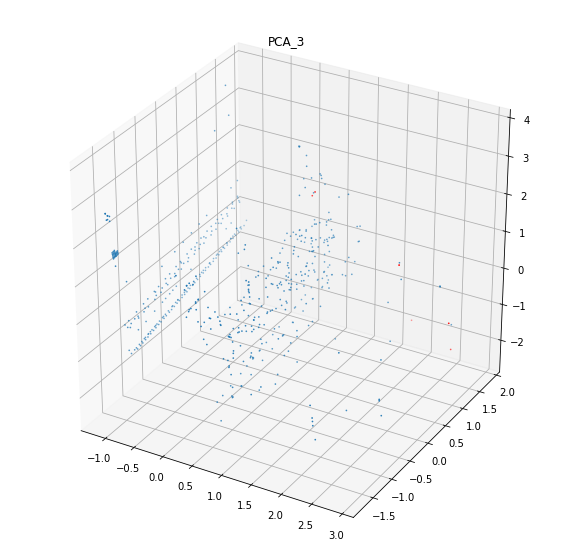

In [11]:
plot(4,"test")

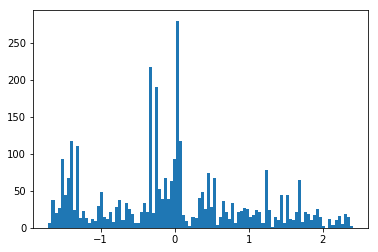

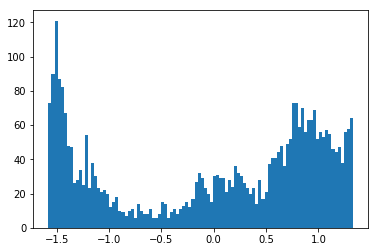

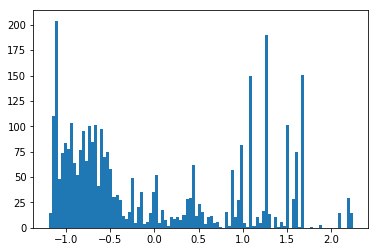

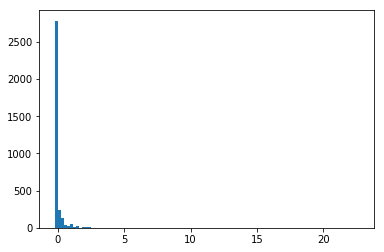

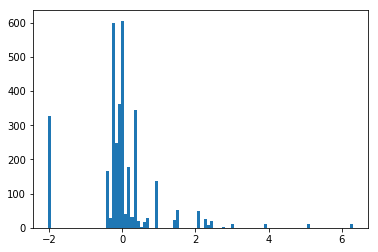

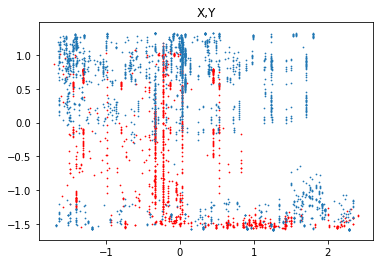

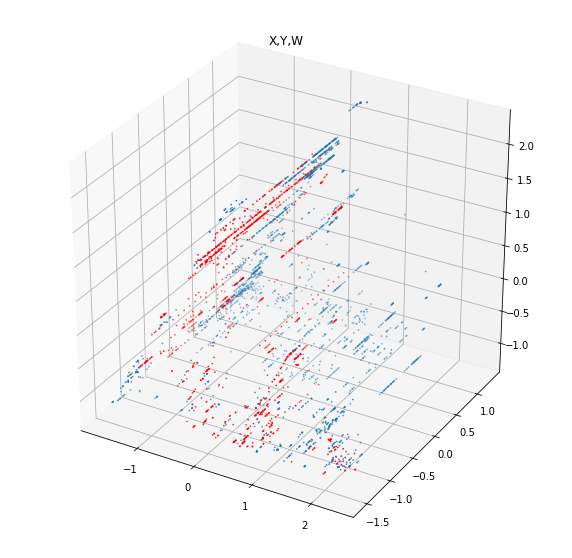

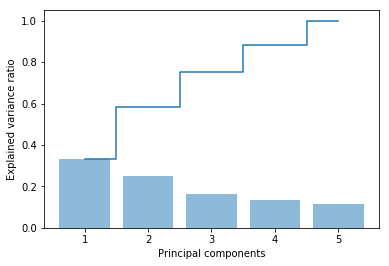

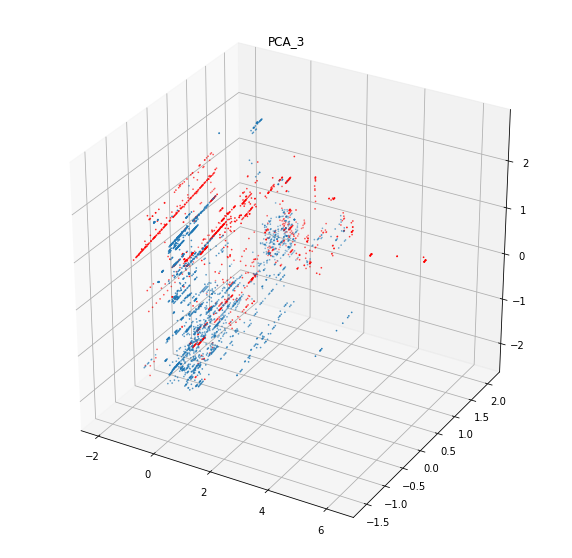

In [12]:
plot(5,"train")

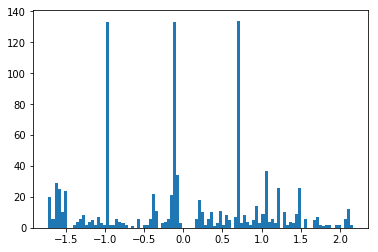

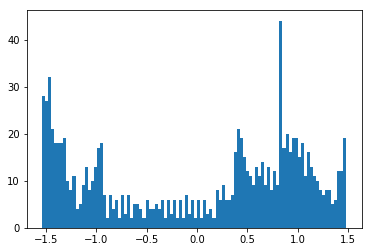

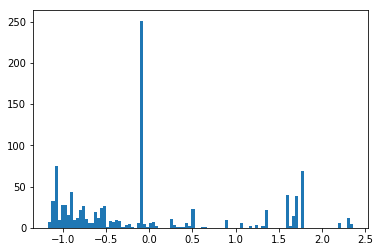

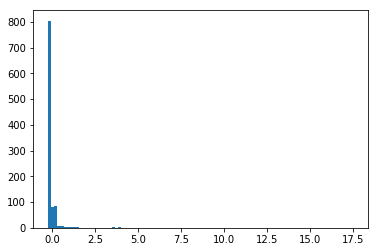

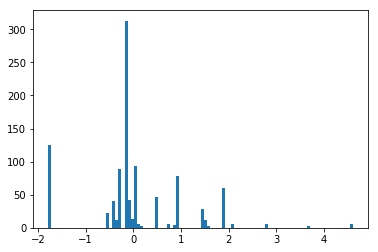

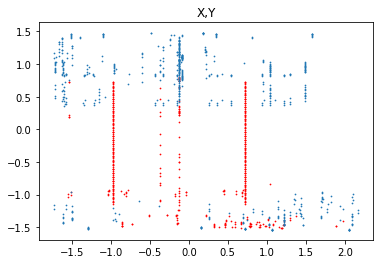

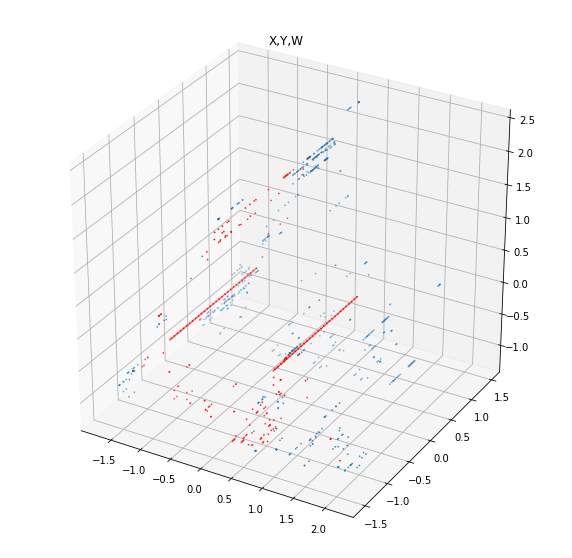

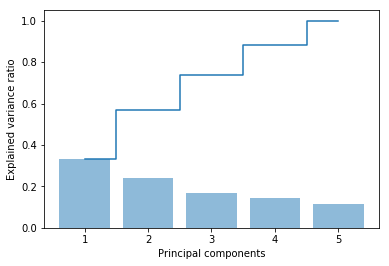

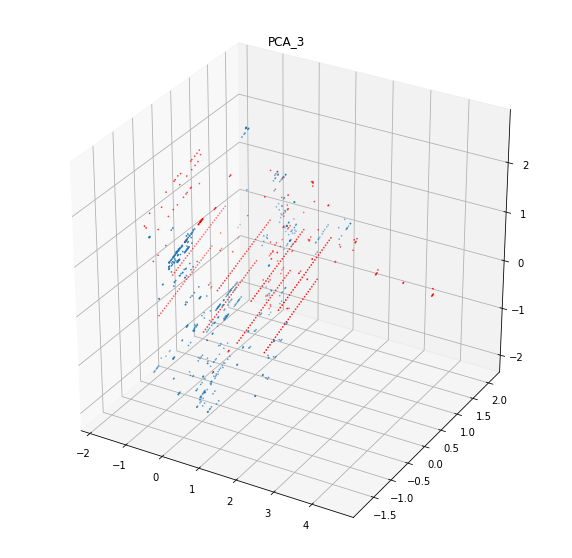

In [13]:
plot(5,"test")

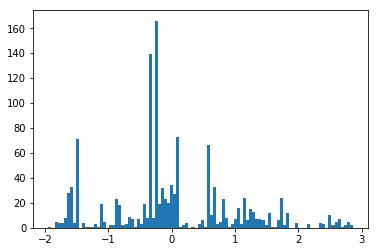

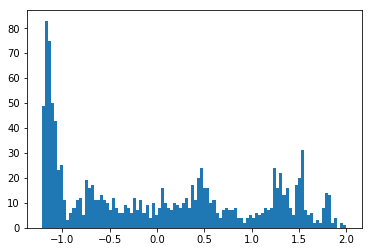

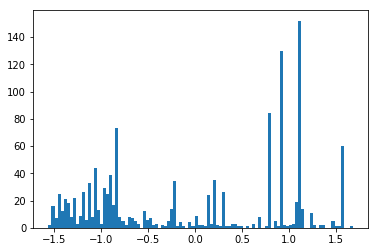

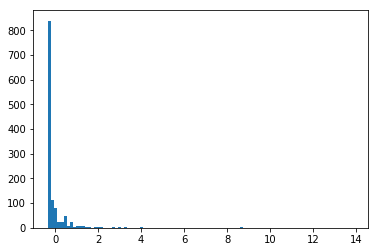

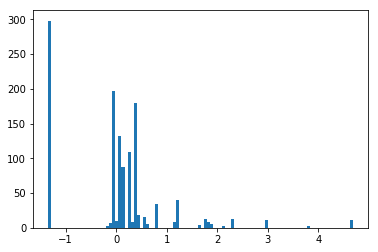

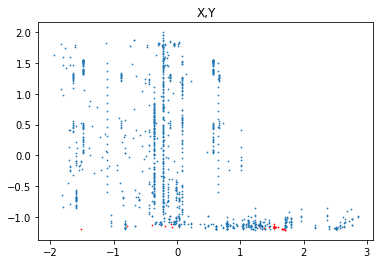

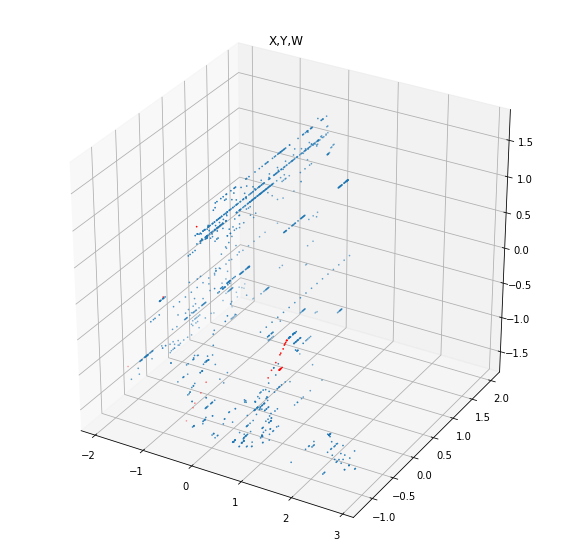

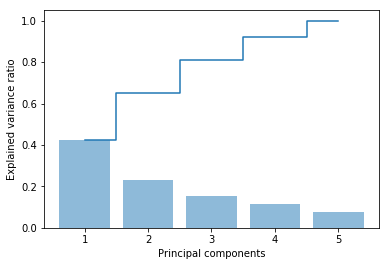

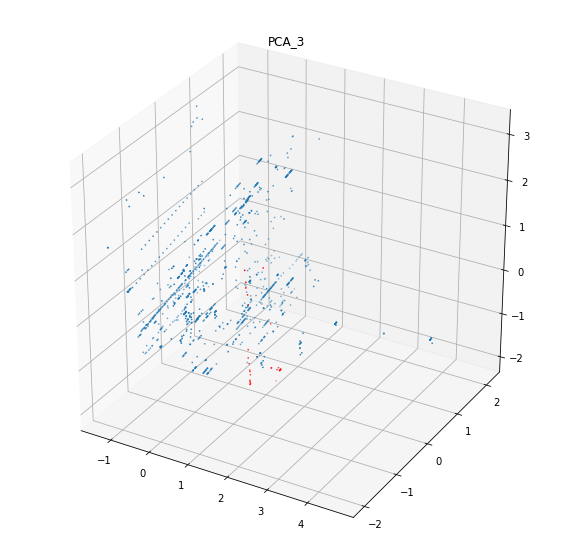

In [14]:
plot(6,"train")

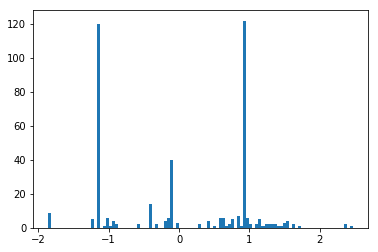

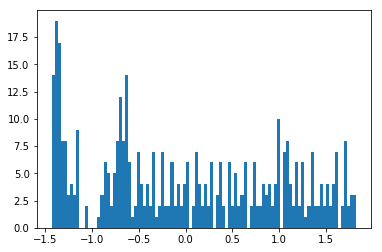

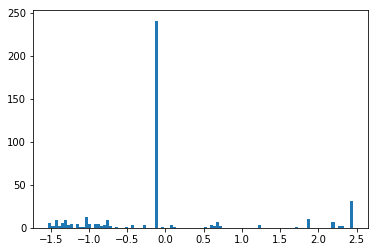

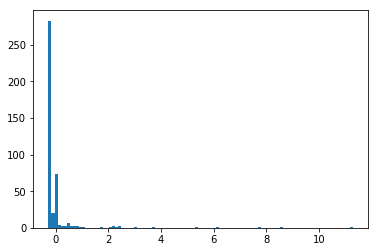

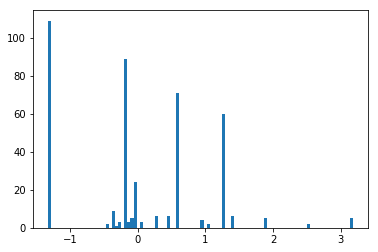

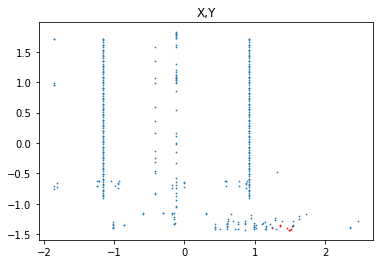

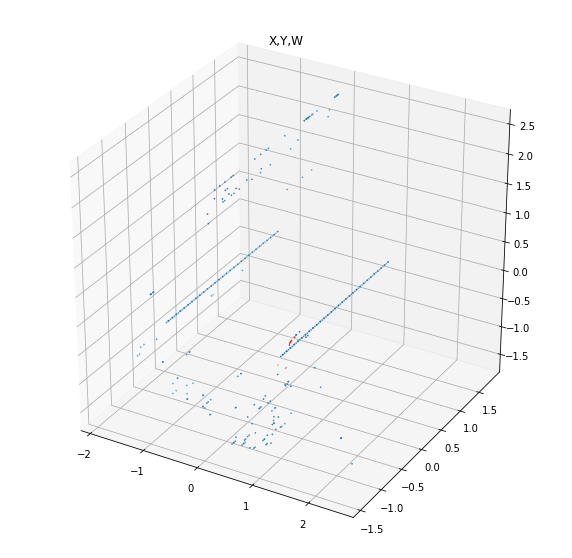

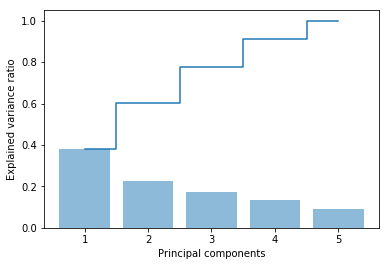

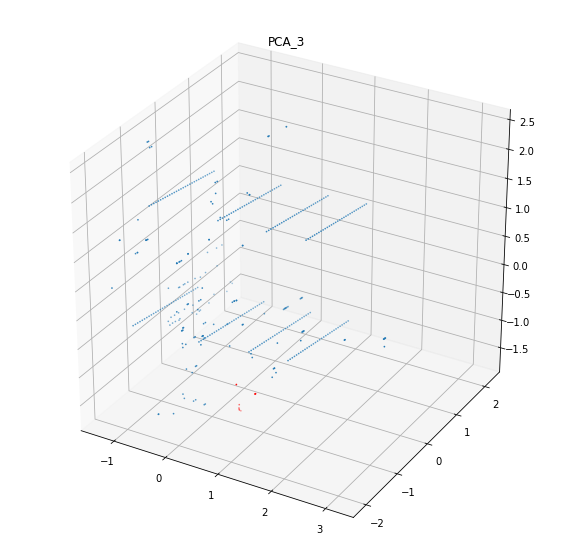

In [15]:
plot(6,"test")

In [16]:
from mlxtend.plotting import plot_decision_regions
from sklearn.svm import SVC
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from matplotlib import pyplot as plt

# params = C, gamma, kernel, max_iter, class_weight
# mode = 1 ~ 6
# score = accuracy or f1
def tuning(mode,params):
    if mode == 1:
        train_path = "dataset/train_news.csv"
        test_path = "dataset/test_news.csv"
    elif mode == 2:
        train_path = "dataset/train_news_title.csv"
        test_path = "dataset/test_news_title.csv"
    elif mode == 3:
        train_path = "dataset/train_blog.csv"
        test_path = "dataset/test_blog.csv"
    elif mode == 4:
        train_path = "dataset/train_blog_title.csv"
        test_path = "dataset/test_blog_title.csv"
    elif mode == 5:
        train_path = "dataset/train_shop.csv"
        test_path = "dataset/test_shop.csv"
    elif mode == 6:
        train_path = "dataset/train_shop_title.csv"
        test_path = "dataset/test_shop_title.csv"
    learningmanager = LearningManager(mode)
    learningmanager.resetmodel()
    learningmanager.readdata(train_path)
    learningmanager.preprocessing()
    
    try:
        svm = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], degree=params["degree"], max_iter=params["max_iter"], class_weight=params["class_weight"])
    except:
        svm = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], max_iter=params["max_iter"], class_weight=params["class_weight"])
    
    pca = PCA(n_components=2)
    sc = StandardScaler()
    x = learningmanager.x_train
    x = pca.fit_transform(x)
    x = sc.fit_transform(x)
    y = learningmanager.y_train
    svm.fit(x,y)
    y = np.array(y)
    y = y.astype(np.integer)
    
    plot_decision_regions(X=x,y=y, clf=svm,legend=2)
    plt.legend(loc='upper left')
    
    try:
        plt.title("C:{} / gamma:{} / kernel:{} / degree:{} / iter:{} / weight:{}".format(params["C"],params["gamma"],params["kernel"],params["degree"],params["max_iter"],params["class_weight"]))
    except:
        plt.title("C:{} / gamma:{} / kernel:{} / iter:{} / weight:{}".format(params["C"],params["gamma"],params["kernel"],params["max_iter"],params["class_weight"]))
    plt.show()
    
    learningmanager.setmodel(params=params)
    learningmanager.eval_train()
    learningmanager.fit()
    learningmanager.readtest(test_path)
    learningmanager.eval_test()

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


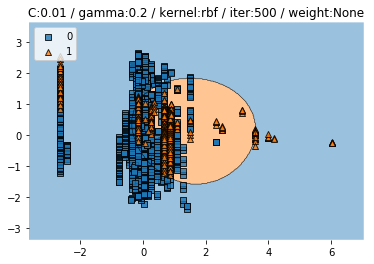

Train CV accuracy scores: [0.89821029 0.93729003 0.89025756 0.91041433 0.91601344]
Train CV accuracy: 0.910 +/- 0.016
Train CV f1 scores: [0.90388335 0.93610876 0.89711379 0.91447889 0.91852059]
Train CV f1: 0.914 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8736162361623616
Test f1 :  0.82230869001297


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


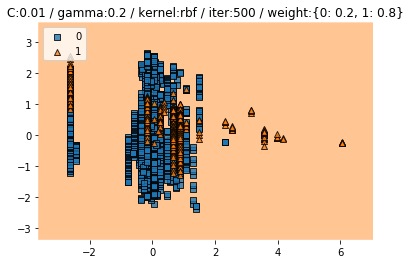

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


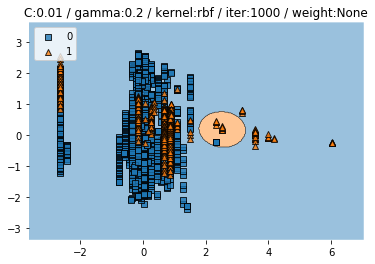

Train CV accuracy scores: [0.901566   0.8868981  0.924972   0.90929451 0.90369541]
Train CV accuracy: 0.905 +/- 0.012
Train CV f1 scores: [0.8983485  0.87316064 0.92504489 0.90619501 0.90099022]
Train CV f1: 0.901 +/- 0.017
Test accuracy :  0.8625461254612546
Test f1 :  0.736283185840708


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


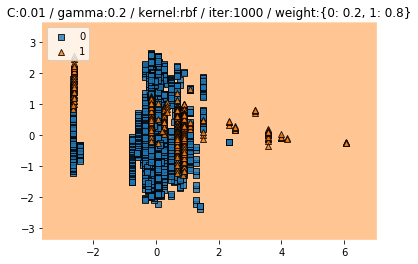

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


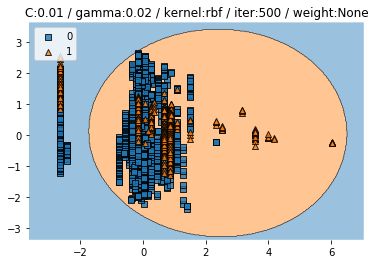

Train CV accuracy scores: [0.45973154 0.66405375 0.39081747 0.35722284 0.56886898]
Train CV accuracy: 0.488 +/- 0.114
Train CV f1 scores: [0.48325211 0.69447613 0.39354481 0.35078882 0.59868297]
Train CV f1: 0.504 +/- 0.128


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47509225092250923
Test f1 :  0.5301403798513625


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


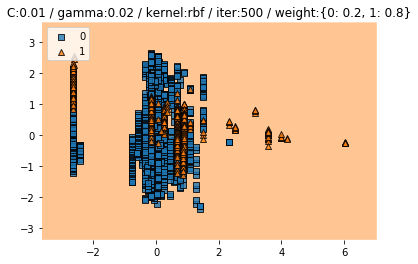

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


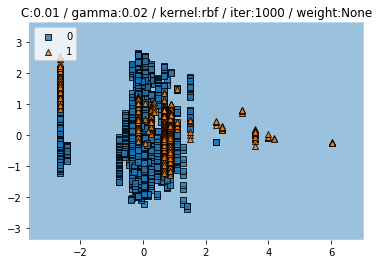

Train CV accuracy scores: [0.7885906  0.78947368 0.78947368 0.78947368 0.78947368]
Train CV accuracy: 0.789 +/- 0.000
Train CV f1 scores: [0.69538008 0.69659443 0.69659443 0.69659443 0.69659443]
Train CV f1: 0.696 +/- 0.000
Test accuracy :  0.6863468634686347
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


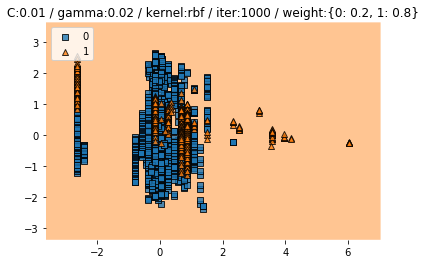

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


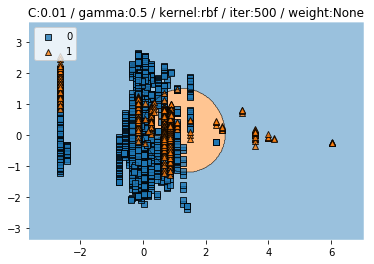

Train CV accuracy scores: [0.91722595 0.90593505 0.93505039 0.90705487 0.92609183]
Train CV accuracy: 0.918 +/- 0.011
Train CV f1 scores: [0.91410986 0.8974005  0.93589048 0.90341059 0.92534239]
Train CV f1: 0.915 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9326568265682657
Test f1 :  0.8940493468795356


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


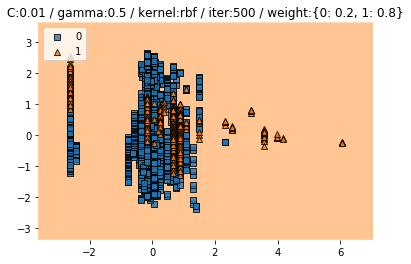

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


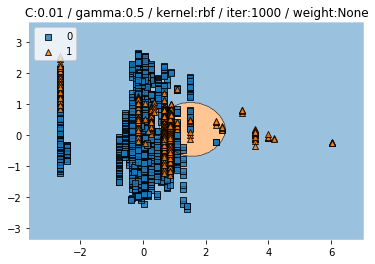

Train CV accuracy scores: [0.901566   0.87905935 0.91825308 0.90033595 0.90593505]
Train CV accuracy: 0.901 +/- 0.013
Train CV f1 scores: [0.89574892 0.86218135 0.9166212  0.89366858 0.90163339]
Train CV f1: 0.894 +/- 0.018
Test accuracy :  0.8459409594095941
Test f1 :  0.692449355432781


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


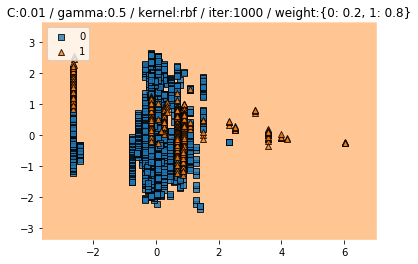

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


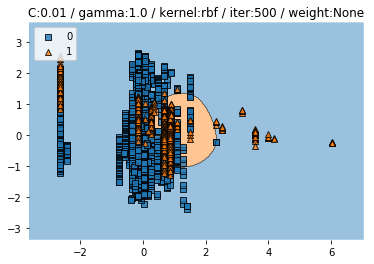

Train CV accuracy scores: [0.91163311 0.90369541 0.94176932 0.9137738  0.92945129]
Train CV accuracy: 0.920 +/- 0.014
Train CV f1 scores: [0.9067846  0.8936159  0.94013362 0.90694002 0.9283569 ]
Train CV f1: 0.915 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9280442804428044
Test f1 :  0.8785046728971962


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


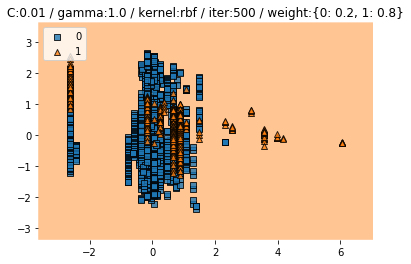

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


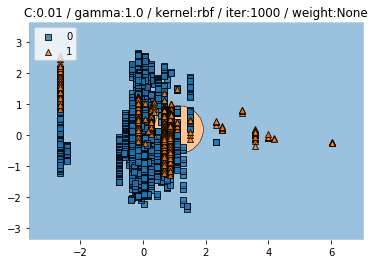

Train CV accuracy scores: [0.89149888 0.8600224  0.92049272 0.8924972  0.91153415]
Train CV accuracy: 0.895 +/- 0.021
Train CV f1 scores: [0.88004343 0.83376843 0.91493403 0.87837714 0.90587854]
Train CV f1: 0.883 +/- 0.028
Test accuracy :  0.8431734317343174
Test f1 :  0.669260700389105


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


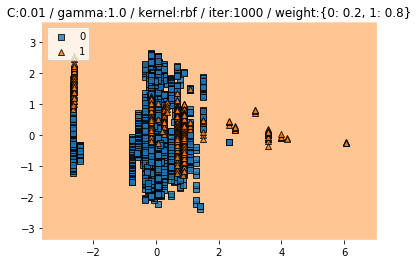

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


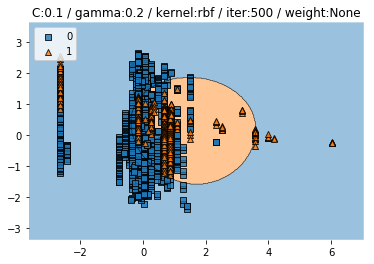

Train CV accuracy scores: [0.94183445 0.93393057 0.9406495  0.93057111 0.93617021]
Train CV accuracy: 0.937 +/- 0.004
Train CV f1 scores: [0.94216458 0.93046114 0.94205832 0.92986709 0.93693979]
Train CV f1: 0.936 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8966789667896679
Test f1 :  0.8139534883720931


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


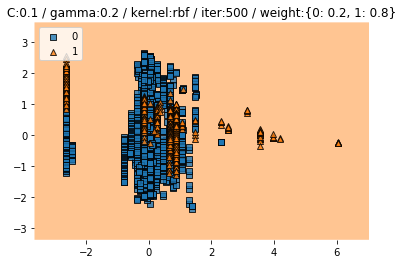

Train CV accuracy scores: [0.23154362 0.21052632 0.21164614 0.28443449 0.21052632]
Train CV accuracy: 0.230 +/- 0.028
Train CV f1 scores: [0.11430137 0.07322654 0.07553082 0.21315088 0.07322654]
Train CV f1: 0.110 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


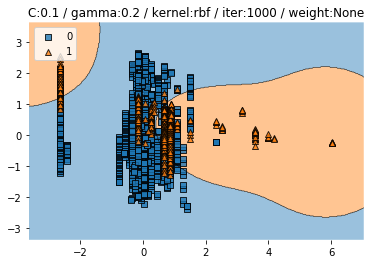

Train CV accuracy scores: [0.94183445 0.93393057 0.9406495  0.93057111 0.93617021]
Train CV accuracy: 0.937 +/- 0.004
Train CV f1 scores: [0.94216458 0.93046114 0.94205832 0.92986709 0.93693979]
Train CV f1: 0.936 +/- 0.005
Test accuracy :  0.8966789667896679
Test f1 :  0.8139534883720931


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


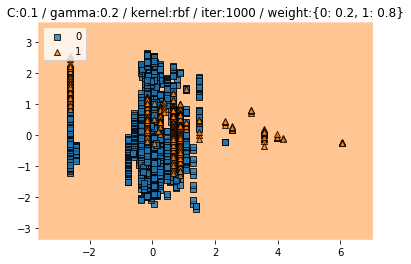

Train CV accuracy scores: [0.87807606 0.95072788 0.86898096 0.89921613 0.92161254]
Train CV accuracy: 0.904 +/- 0.030
Train CV f1 scores: [0.88651932 0.95201272 0.87821522 0.90471163 0.92562921]
Train CV f1: 0.909 +/- 0.027


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8957564575645757
Test f1 :  0.8475033738191632


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


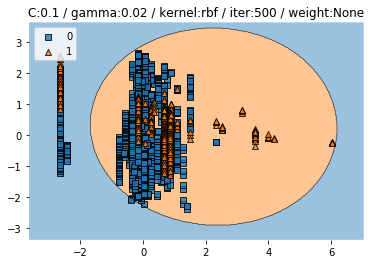

Train CV accuracy scores: [0.58277405 0.84322508 0.63493841 0.61254199 0.80067189]
Train CV accuracy: 0.695 +/- 0.106
Train CV f1 scores: [0.61264193 0.85558909 0.6651221  0.64390024 0.81823419]
Train CV f1: 0.719 +/- 0.098


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5359778597785978
Test f1 :  0.560698689956332


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


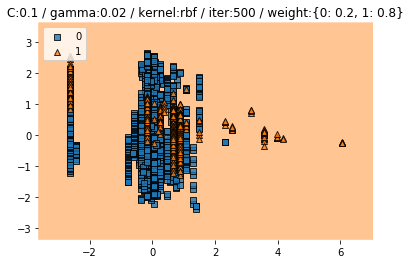

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


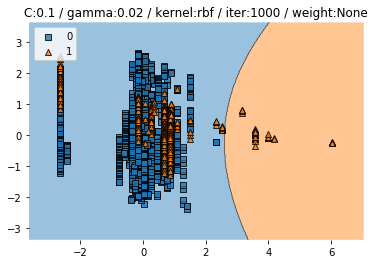

Train CV accuracy scores: [0.92170022 0.90593505 0.90705487 0.91825308 0.91265398]
Train CV accuracy: 0.913 +/- 0.006
Train CV f1 scores: [0.92360702 0.90060064 0.9101002  0.91909348 0.91282301]
Train CV f1: 0.913 +/- 0.008
Test accuracy :  0.8588560885608856
Test f1 :  0.7445742904841403


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


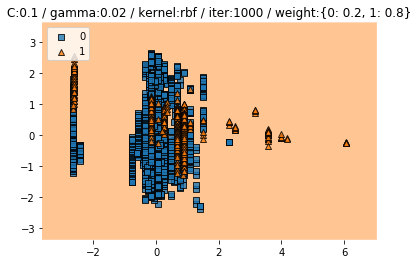

Train CV accuracy scores: [0.39149888 0.45016797 0.32698768 0.32586786 0.40649496]
Train CV accuracy: 0.380 +/- 0.048
Train CV f1 scores: [0.37989056 0.45897745 0.28400102 0.28340204 0.40136596]
Train CV f1: 0.362 +/- 0.069


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3477859778597786
Test f1 :  0.4902667627974045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


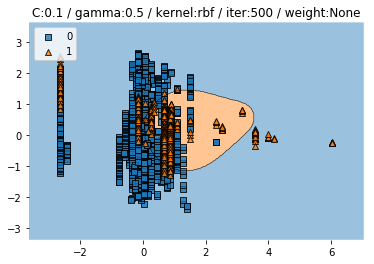

Train CV accuracy scores: [0.95525727 0.93952968 0.95632699 0.94288914 0.94848824]
Train CV accuracy: 0.948 +/- 0.007
Train CV f1 scores: [0.95534324 0.93660222 0.95722363 0.94121651 0.94897152]
Train CV f1: 0.948 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9197416974169742
Test f1 :  0.8594507269789984


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


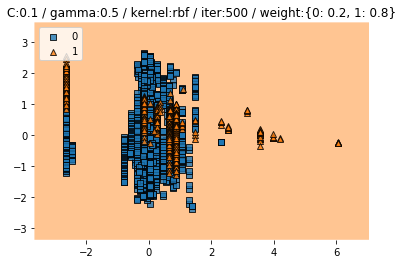

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


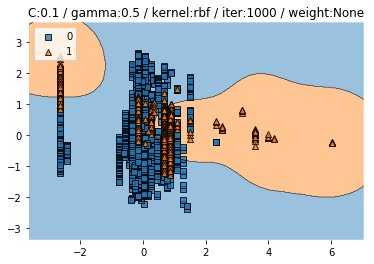

Train CV accuracy scores: [0.95525727 0.93952968 0.95632699 0.94288914 0.94848824]
Train CV accuracy: 0.948 +/- 0.007
Train CV f1 scores: [0.95534324 0.93660222 0.95722363 0.94121651 0.94897152]
Train CV f1: 0.948 +/- 0.008
Test accuracy :  0.9197416974169742
Test f1 :  0.8594507269789984


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


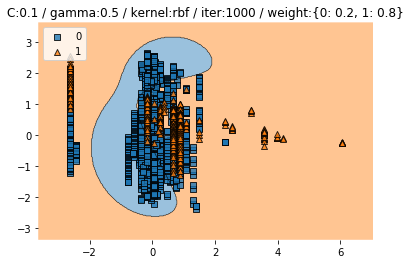

Train CV accuracy scores: [0.89709172 0.95968645 0.88241881 0.91041433 0.93057111]
Train CV accuracy: 0.916 +/- 0.027
Train CV f1 scores: [0.90308684 0.95999137 0.89013198 0.91458769 0.93380546]
Train CV f1: 0.920 +/- 0.024


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9169741697416974
Test f1 :  0.8739495798319328


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


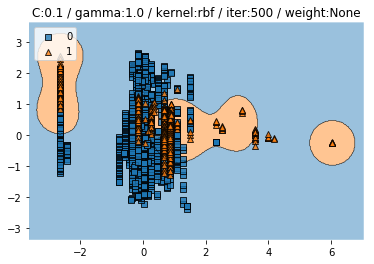

Train CV accuracy scores: [0.95749441 0.94960806 0.96640538 0.94288914 0.94960806]
Train CV accuracy: 0.953 +/- 0.008
Train CV f1 scores: [0.95732723 0.94750232 0.96689818 0.94064988 0.95012612]
Train CV f1: 0.953 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.922509225092251
Test f1 :  0.8627450980392157


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


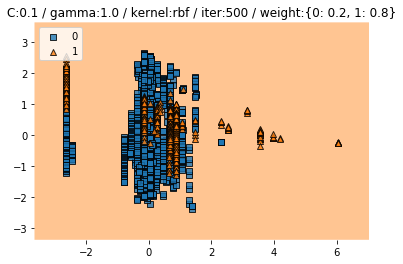

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


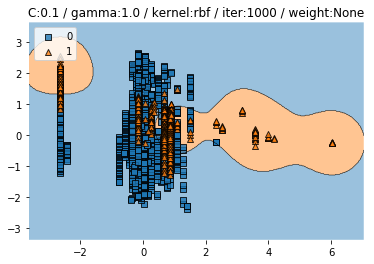

Train CV accuracy scores: [0.95749441 0.94960806 0.96640538 0.94288914 0.94960806]
Train CV accuracy: 0.953 +/- 0.008
Train CV f1 scores: [0.95732723 0.94750232 0.96689818 0.94064988 0.95012612]
Train CV f1: 0.953 +/- 0.009
Test accuracy :  0.9243542435424354
Test f1 :  0.8664495114006515


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


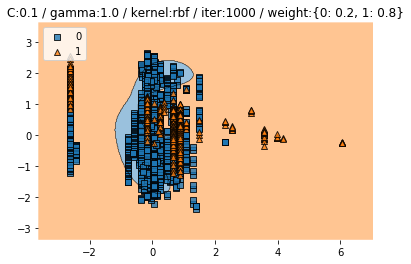

Train CV accuracy scores: [0.89932886 0.97088466 0.8656215  0.92609183 0.924972  ]
Train CV accuracy: 0.917 +/- 0.035
Train CV f1 scores: [0.90509339 0.97120994 0.87543972 0.92877288 0.92877417]
Train CV f1: 0.922 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8865313653136532
Test f1 :  0.8425096030729833


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


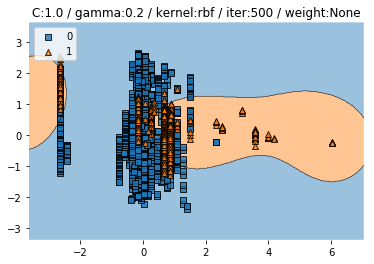

Train CV accuracy scores: [0.95637584 0.96304591 0.95520717 0.94848824 0.95632699]
Train CV accuracy: 0.956 +/- 0.005
Train CV f1 scores: [0.95697382 0.96239107 0.95630563 0.94751791 0.95736367]
Train CV f1: 0.956 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9289667896678967
Test f1 :  0.8791208791208791


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


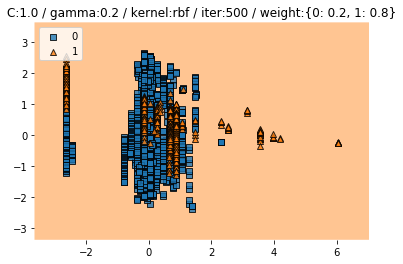

Train CV accuracy scores: [0.88702461 0.97424412 0.89921613 0.92161254 0.93169093]
Train CV accuracy: 0.923 +/- 0.030
Train CV f1 scores: [0.89418935 0.97459969 0.90512671 0.92497373 0.93491407]
Train CV f1: 0.927 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9308118081180812
Test f1 :  0.8951048951048952


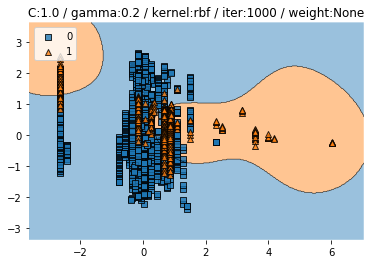

Train CV accuracy scores: [0.95637584 0.96304591 0.95520717 0.94848824 0.95632699]
Train CV accuracy: 0.956 +/- 0.005
Train CV f1 scores: [0.95697382 0.96239107 0.95630563 0.94751791 0.95736367]
Train CV f1: 0.956 +/- 0.005
Test accuracy :  0.9289667896678967
Test f1 :  0.8791208791208791


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


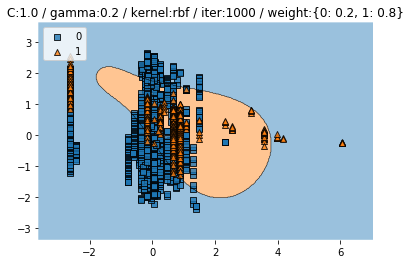

Train CV accuracy scores: [0.90044743 0.96864502 0.91489362 0.92721165 0.93393057]
Train CV accuracy: 0.929 +/- 0.023
Train CV f1 scores: [0.90599581 0.96899532 0.91925457 0.92990195 0.93688755]
Train CV f1: 0.932 +/- 0.021
Test accuracy :  0.9317343173431735
Test f1 :  0.8927536231884058


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


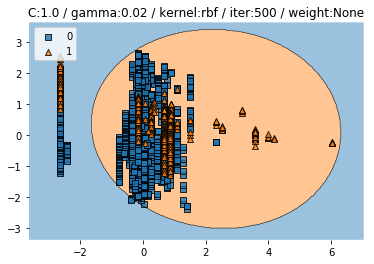

Train CV accuracy scores: [0.92281879 0.93281075 0.91489362 0.91601344 0.9193729 ]
Train CV accuracy: 0.921 +/- 0.006
Train CV f1 scores: [0.92475812 0.93059781 0.91832367 0.91759986 0.92069334]
Train CV f1: 0.922 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8902214022140221
Test f1 :  0.8172043010752688


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


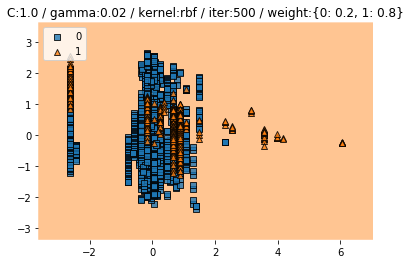

Train CV accuracy scores: [0.27404922 0.20828667 0.24300112 0.30683091 0.24972004]
Train CV accuracy: 0.256 +/- 0.033
Train CV f1 scores: [0.225943   0.078454   0.16529928 0.27660159 0.15202504]
Train CV f1: 0.180 +/- 0.067


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


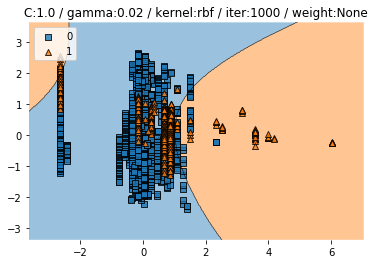

Train CV accuracy scores: [0.92393736 0.93281075 0.91489362 0.91601344 0.9193729 ]
Train CV accuracy: 0.921 +/- 0.007
Train CV f1 scores: [0.92578968 0.93059781 0.91832367 0.91759986 0.92069334]
Train CV f1: 0.923 +/- 0.005
Test accuracy :  0.8892988929889298
Test f1 :  0.8070739549839229


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


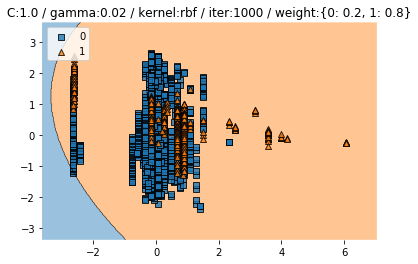

Train CV accuracy scores: [0.86017897 0.94512878 0.85666293 0.89585666 0.91825308]
Train CV accuracy: 0.895 +/- 0.034
Train CV f1 scores: [0.87056863 0.94676678 0.86733525 0.90136647 0.92266675]
Train CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8911439114391144
Test f1 :  0.8418230563002681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


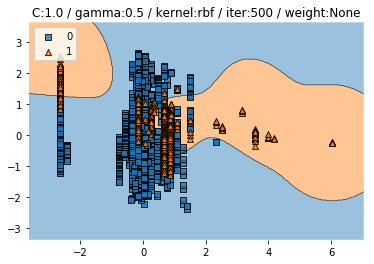

Train CV accuracy scores: [0.96085011 0.95408735 0.96864502 0.95296753 0.95296753]
Train CV accuracy: 0.958 +/- 0.006
Train CV f1 scores: [0.96117959 0.95274268 0.96905057 0.95228926 0.95412091]
Train CV f1: 0.958 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9345018450184502
Test f1 :  0.8871224165341812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


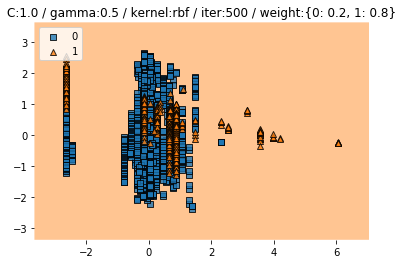

Train CV accuracy scores: [0.91834452 0.97536394 0.924972   0.93505039 0.93617021]
Train CV accuracy: 0.938 +/- 0.020
Train CV f1 scores: [0.92187328 0.97550478 0.92842182 0.93703713 0.93894744]
Train CV f1: 0.940 +/- 0.019


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9455719557195572
Test f1 :  0.9163120567375886


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


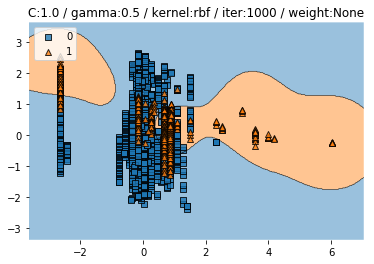

Train CV accuracy scores: [0.96085011 0.95408735 0.96864502 0.95296753 0.95296753]
Train CV accuracy: 0.958 +/- 0.006
Train CV f1 scores: [0.96117959 0.95274268 0.96905057 0.95228926 0.95412091]
Train CV f1: 0.958 +/- 0.006
Test accuracy :  0.9354243542435424
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


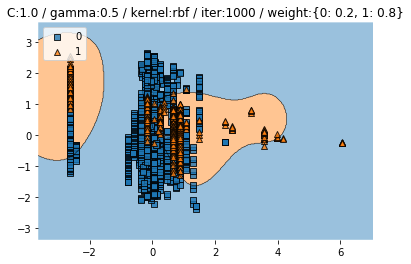

Train CV accuracy scores: [0.92729306 0.9675252  0.92945129 0.93952968 0.93952968]
Train CV accuracy: 0.941 +/- 0.014
Train CV f1 scores: [0.92996199 0.96755674 0.93252086 0.94128989 0.94196682]
Train CV f1: 0.943 +/- 0.013
Test accuracy :  0.9418819188191881
Test f1 :  0.9063893016344725


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


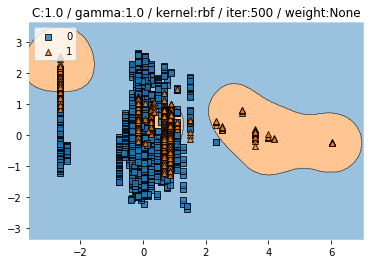

Train CV accuracy scores: [0.95637584 0.95296753 0.97088466 0.96192609 0.95072788]
Train CV accuracy: 0.959 +/- 0.007
Train CV f1 scores: [0.95682113 0.95153331 0.97131176 0.96169805 0.95169919]
Train CV f1: 0.959 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9474169741697417
Test f1 :  0.9107981220657276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


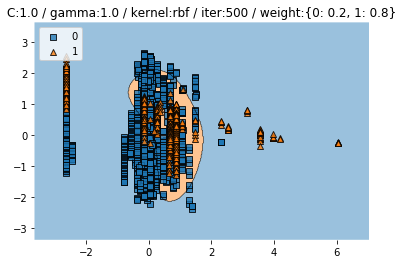

Train CV accuracy scores: [0.9295302  0.9675252  0.93505039 0.95520717 0.9462486 ]
Train CV accuracy: 0.947 +/- 0.014
Train CV f1 scores: [0.93172211 0.96722999 0.93775242 0.95594074 0.94827181]
Train CV f1: 0.948 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9232995658465991


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


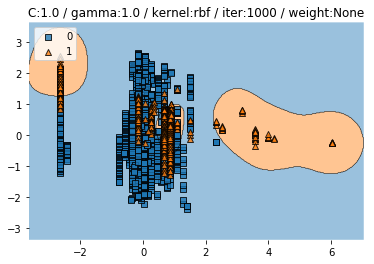

Train CV accuracy scores: [0.95637584 0.95296753 0.97088466 0.96080627 0.95072788]
Train CV accuracy: 0.958 +/- 0.007
Train CV f1 scores: [0.95682113 0.95153331 0.97131176 0.96061141 0.95169919]
Train CV f1: 0.958 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.948339483394834
Test f1 :  0.9122257053291536


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


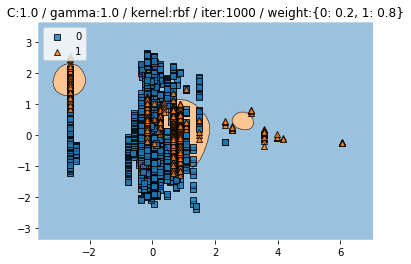

Train CV accuracy scores: [0.93736018 0.96416573 0.9406495  0.95520717 0.94736842]
Train CV accuracy: 0.949 +/- 0.010
Train CV f1 scores: [0.93898225 0.96372626 0.94292346 0.95594074 0.94931372]
Train CV f1: 0.950 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9455719557195572
Test f1 :  0.9125925925925925


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


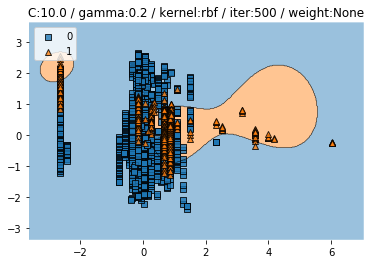

Train CV accuracy scores: [0.95973154 0.95520717 0.96864502 0.95072788 0.95744681]
Train CV accuracy: 0.958 +/- 0.006
Train CV f1 scores: [0.96031808 0.95394894 0.96905057 0.94990937 0.9584232 ]
Train CV f1: 0.958 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9354243542435424
Test f1 :  0.8895899053627759


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


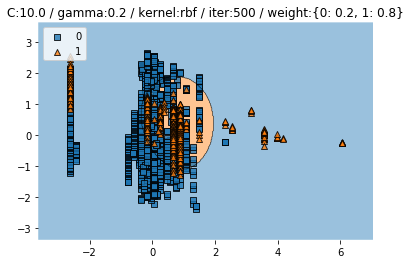

Train CV accuracy scores: [0.93176734 0.97536394 0.94176932 0.95296753 0.94736842]
Train CV accuracy: 0.950 +/- 0.015
Train CV f1 scores: [0.93417875 0.97541162 0.94396113 0.95389468 0.9492413 ]
Train CV f1: 0.951 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9418819188191881
Test f1 :  0.9069423929098965


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


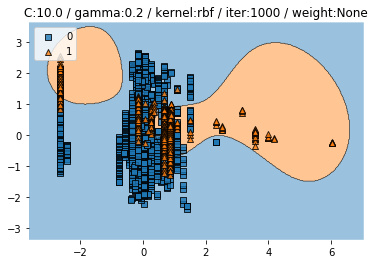

Train CV accuracy scores: [0.95973154 0.95408735 0.96976484 0.95072788 0.95632699]
Train CV accuracy: 0.958 +/- 0.007
Train CV f1 scores: [0.96031808 0.95285222 0.97007567 0.94990937 0.95722363]
Train CV f1: 0.958 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9372693726937269
Test f1 :  0.8927444794952681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


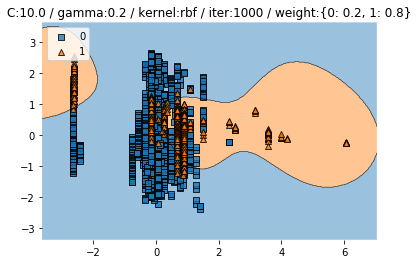

Train CV accuracy scores: [0.93064877 0.97536394 0.94176932 0.9518477  0.94736842]
Train CV accuracy: 0.949 +/- 0.015
Train CV f1 scores: [0.93314731 0.97541162 0.94396113 0.95275725 0.9492413 ]
Train CV f1: 0.951 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9437269372693727
Test f1 :  0.9096296296296297


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


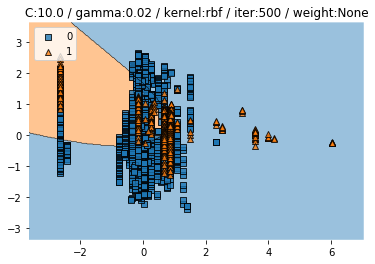

Train CV accuracy scores: [0.94183445 0.95744681 0.93952968 0.94288914 0.94176932]
Train CV accuracy: 0.945 +/- 0.006
Train CV f1 scores: [0.94227125 0.95654907 0.94091718 0.9426052  0.94282086]
Train CV f1: 0.945 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9197416974169742
Test f1 :  0.8612440191387559


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


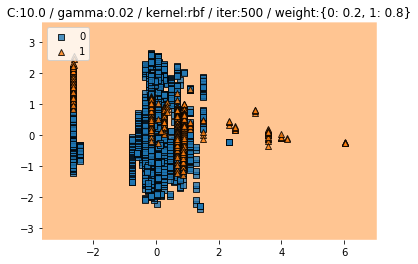

Train CV accuracy scores: [0.87583893 0.96304591 0.86898096 0.8980963  0.92609183]
Train CV accuracy: 0.906 +/- 0.035
Train CV f1 scores: [0.88403556 0.96403789 0.87821522 0.90348762 0.92979515]
Train CV f1: 0.912 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8431734317343174
Test f1 :  0.7941888619854721


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


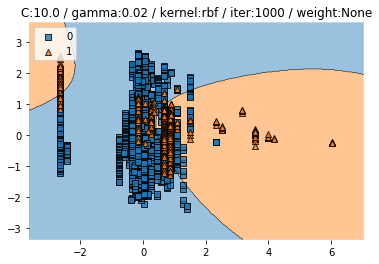

Train CV accuracy scores: [0.94407159 0.95856663 0.9406495  0.94512878 0.94288914]
Train CV accuracy: 0.946 +/- 0.006
Train CV f1 scores: [0.94459257 0.95773951 0.94196392 0.94474385 0.9439679 ]
Train CV f1: 0.947 +/- 0.006
Test accuracy :  0.9215867158671587
Test f1 :  0.8652931854199682


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


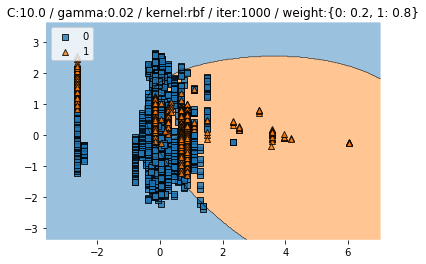

Train CV accuracy scores: [0.88478747 0.95968645 0.87905935 0.88913774 0.92609183]
Train CV accuracy: 0.908 +/- 0.031
Train CV f1 scores: [0.8924893  0.96061145 0.88714714 0.89535786 0.92970986]
Train CV f1: 0.913 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9049815498154982
Test f1 :  0.8567454798331016


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


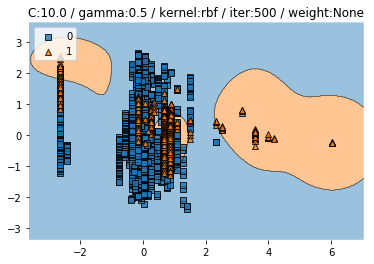

Train CV accuracy scores: [0.96308725 0.95968645 0.97200448 0.96304591 0.94848824]
Train CV accuracy: 0.961 +/- 0.008
Train CV f1 scores: [0.9633979  0.95855405 0.97243915 0.96293653 0.94941846]
Train CV f1: 0.961 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9547970479704797
Test f1 :  0.9242658423493044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


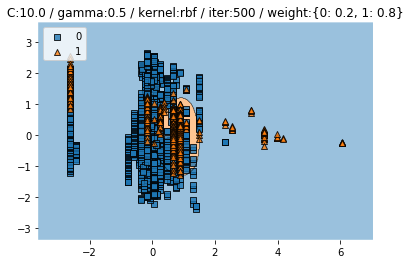

Train CV accuracy scores: [0.93176734 0.96976484 0.95744681 0.95408735 0.94848824]
Train CV accuracy: 0.952 +/- 0.012
Train CV f1 scores: [0.93408394 0.96948999 0.95862147 0.95472118 0.9502854 ]
Train CV f1: 0.953 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9492619926199262
Test f1 :  0.9192364170337738


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


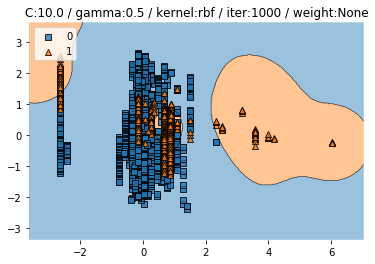

Train CV accuracy scores: [0.96308725 0.95744681 0.97200448 0.96304591 0.94736842]
Train CV accuracy: 0.961 +/- 0.008
Train CV f1 scores: [0.9633979  0.95614919 0.97243915 0.96293653 0.94836258]
Train CV f1: 0.961 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9173166926677068


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


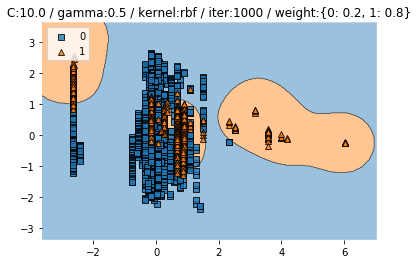

Train CV accuracy scores: [0.93176734 0.96976484 0.95856663 0.95408735 0.95072788]
Train CV accuracy: 0.953 +/- 0.012
Train CV f1 scores: [0.93408394 0.96948999 0.95967885 0.95472118 0.95237743]
Train CV f1: 0.954 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9492619926199262
Test f1 :  0.91899852724595


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


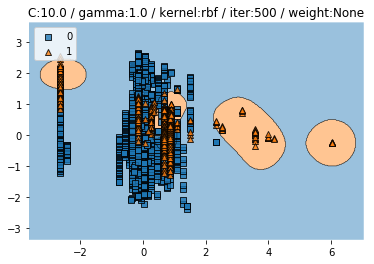

Train CV accuracy scores: [0.94071588 0.95296753 0.97424412 0.96080627 0.96304591]
Train CV accuracy: 0.958 +/- 0.011
Train CV f1 scores: [0.94152853 0.95106304 0.97459969 0.96084434 0.96286219]
Train CV f1: 0.958 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9529520295202952
Test f1 :  0.9196850393700787


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


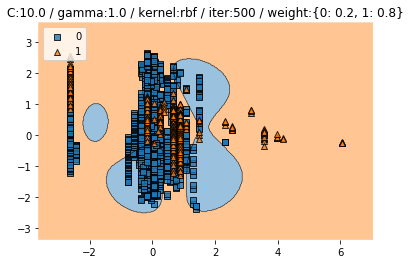

Train CV accuracy scores: [0.93288591 0.9675252  0.96192609 0.95632699 0.95408735]
Train CV accuracy: 0.955 +/- 0.012
Train CV f1 scores: [0.93492469 0.96694973 0.96285979 0.95685354 0.95524907]
Train CV f1: 0.955 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9529520295202952
Test f1 :  0.9244444444444444


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


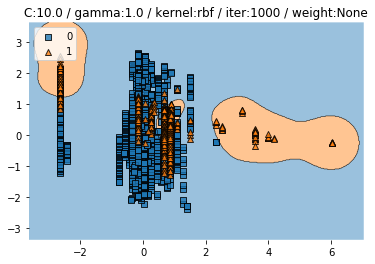

Train CV accuracy scores: [0.93736018 0.95408735 0.97424412 0.96080627 0.96640538]
Train CV accuracy: 0.959 +/- 0.013
Train CV f1 scores: [0.93816465 0.95228716 0.97459969 0.96084434 0.96633934]
Train CV f1: 0.958 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9538745387453874
Test f1 :  0.9216300940438872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


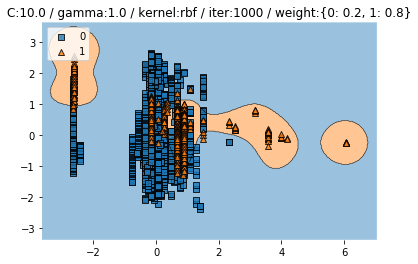

Train CV accuracy scores: [0.93288591 0.96640538 0.96416573 0.95520717 0.95296753]
Train CV accuracy: 0.954 +/- 0.012
Train CV f1 scores: [0.93492469 0.9659209  0.96498796 0.9557076  0.95419396]
Train CV f1: 0.955 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9538745387453874
Test f1 :  0.9258160237388723


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


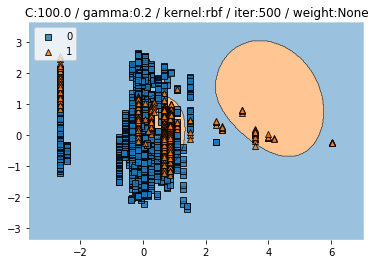

Train CV accuracy scores: [0.93512304 0.95520717 0.92049272 0.93169093 0.96192609]
Train CV accuracy: 0.941 +/- 0.015
Train CV f1 scores: [0.93376452 0.95362079 0.92321078 0.93063129 0.96235146]
Train CV f1: 0.941 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9437269372693727
Test f1 :  0.9062980030721965


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


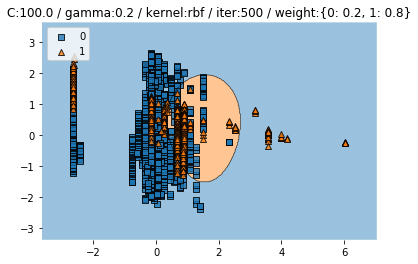

Train CV accuracy scores: [0.91387025 0.9731243  0.94736842 0.94400896 0.9518477 ]
Train CV accuracy: 0.946 +/- 0.019
Train CV f1 scores: [0.91703189 0.97296333 0.9492413  0.94483031 0.9534254 ]
Train CV f1: 0.947 +/- 0.018


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9226277372262772


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


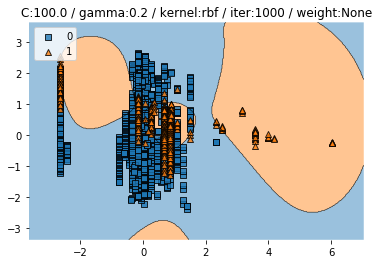

Train CV accuracy scores: [0.94854586 0.96416573 0.96640538 0.95632699 0.94736842]
Train CV accuracy: 0.957 +/- 0.008
Train CV f1 scores: [0.9493826  0.96324398 0.96701204 0.95619772 0.94844899]
Train CV f1: 0.957 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9175738724727838


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


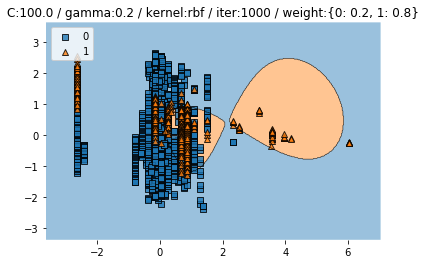

Train CV accuracy scores: [0.93400447 0.9675252  0.95072788 0.9518477  0.94512878]
Train CV accuracy: 0.950 +/- 0.011
Train CV f1 scores: [0.93605721 0.96736374 0.95237743 0.95259534 0.94700462]
Train CV f1: 0.951 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9492619926199262
Test f1 :  0.9192364170337738


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


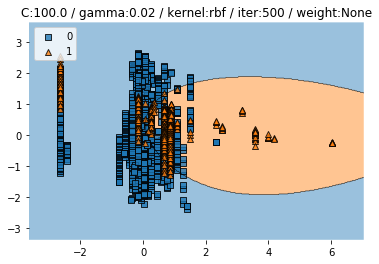

Train CV accuracy scores: [0.95302013 0.96416573 0.94288914 0.95072788 0.94512878]
Train CV accuracy: 0.951 +/- 0.007
Train CV f1 scores: [0.95378411 0.96372626 0.94467785 0.95001732 0.94651718]
Train CV f1: 0.952 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9040590405904059
Test f1 :  0.8395061728395061


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


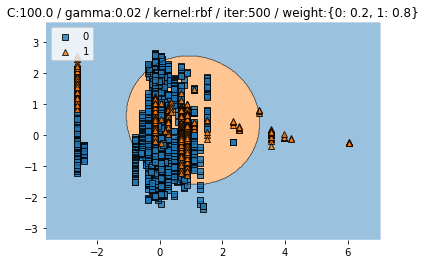

Train CV accuracy scores: [0.90604027 0.96416573 0.89137738 0.91713326 0.9406495 ]
Train CV accuracy: 0.924 +/- 0.026
Train CV f1 scores: [0.9109267  0.96430336 0.8983118  0.92058067 0.94300248]
Train CV f1: 0.927 +/- 0.024


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8846863468634686
Test f1 :  0.826629680998613


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


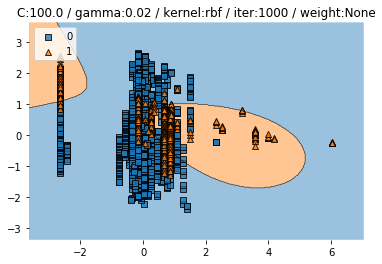

Train CV accuracy scores: [0.94966443 0.9675252  0.95632699 0.94512878 0.96528555]
Train CV accuracy: 0.957 +/- 0.009
Train CV f1 scores: [0.95052516 0.96702143 0.95729421 0.94403341 0.96588337]
Train CV f1: 0.957 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9271217712177122
Test f1 :  0.8759811616954474


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


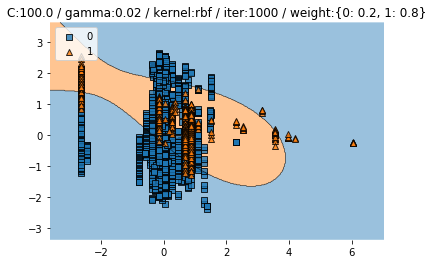

Train CV accuracy scores: [0.90715884 0.97200448 0.91489362 0.92609183 0.94512878]
Train CV accuracy: 0.933 +/- 0.023
Train CV f1 scores: [0.9119359  0.97219047 0.91925457 0.92856615 0.94715686]
Train CV f1: 0.936 +/- 0.022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9326568265682657
Test f1 :  0.8934306569343065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


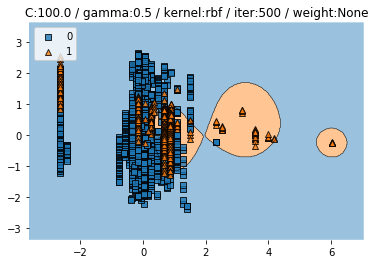

Train CV accuracy scores: [0.93624161 0.94400896 0.9675252  0.95632699 0.96192609]
Train CV accuracy: 0.953 +/- 0.012
Train CV f1 scores: [0.93743749 0.94188495 0.96813861 0.95628423 0.96207232]
Train CV f1: 0.953 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9381918819188192
Test f1 :  0.8958009331259719


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


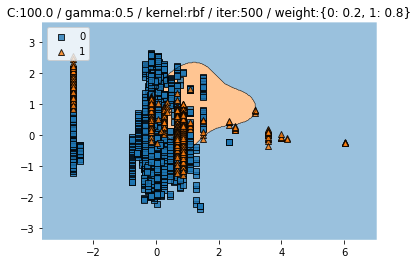

Train CV accuracy scores: [0.9295302  0.97088466 0.95968645 0.95632699 0.95856663]
Train CV accuracy: 0.955 +/- 0.014
Train CV f1 scores: [0.93161932 0.97040099 0.96073768 0.95669717 0.95934926]
Train CV f1: 0.956 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9575645756457565
Test f1 :  0.9303030303030303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


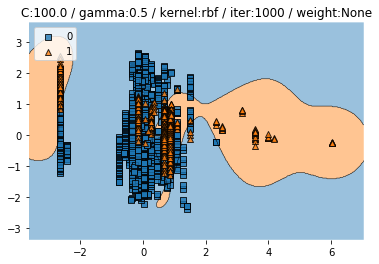

Train CV accuracy scores: [0.93064877 0.9462486  0.97536394 0.95520717 0.9675252 ]
Train CV accuracy: 0.955 +/- 0.016
Train CV f1 scores: [0.93177654 0.94379051 0.97568259 0.95511912 0.9676191 ]
Train CV f1: 0.955 +/- 0.016


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9538745387453874
Test f1 :  0.9221183800623052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


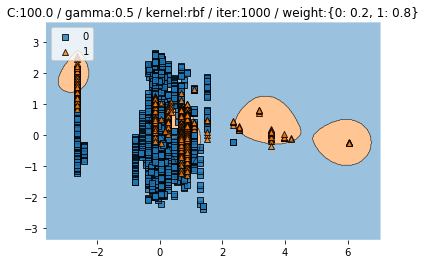

Train CV accuracy scores: [0.9261745  0.96976484 0.95968645 0.95632699 0.94960806]
Train CV accuracy: 0.952 +/- 0.015
Train CV f1 scores: [0.92852397 0.96936155 0.96085993 0.95677597 0.95096076]
Train CV f1: 0.953 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.955719557195572
Test f1 :  0.9281437125748503


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


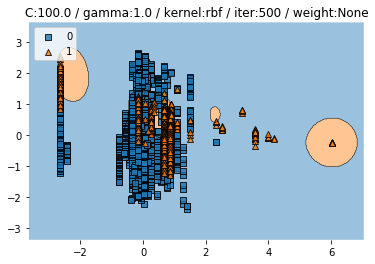

Train CV accuracy scores: [0.9261745  0.93952968 0.95968645 0.96192609 0.95856663]
Train CV accuracy: 0.949 +/- 0.014
Train CV f1 scores: [0.92712262 0.93643756 0.96073768 0.96161965 0.95852607]
Train CV f1: 0.949 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9418819188191881
Test f1 :  0.9023255813953489


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


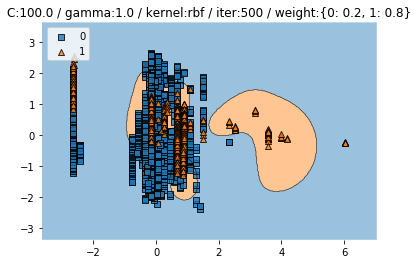

Train CV accuracy scores: [0.93176734 0.95856663 0.9675252  0.95520717 0.96416573]
Train CV accuracy: 0.955 +/- 0.013
Train CV f1 scores: [0.93304714 0.95735315 0.96824441 0.95520717 0.96450193]
Train CV f1: 0.956 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9603321033210332
Test f1 :  0.9355322338830585


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


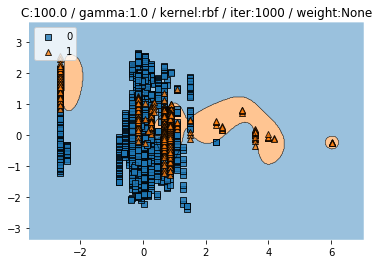

Train CV accuracy scores: [0.92841163 0.94176932 0.96528555 0.96192609 0.95744681]
Train CV accuracy: 0.951 +/- 0.014
Train CV f1 scores: [0.92957579 0.93879173 0.96594127 0.96169805 0.95736317]
Train CV f1: 0.951 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9501845018450185
Test f1 :  0.9153605015673981


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


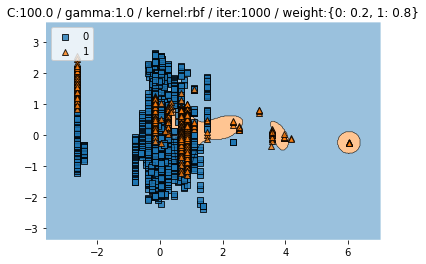

Train CV accuracy scores: [0.92505593 0.96192609 0.96864502 0.95520717 0.96528555]
Train CV accuracy: 0.955 +/- 0.016
Train CV f1 scores: [0.92621134 0.96094673 0.96931419 0.9553792  0.96557981]
Train CV f1: 0.955 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9575645756457565
Test f1 :  0.9309309309309309
627.6891942024231 secs


In [11]:
# news rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(1,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


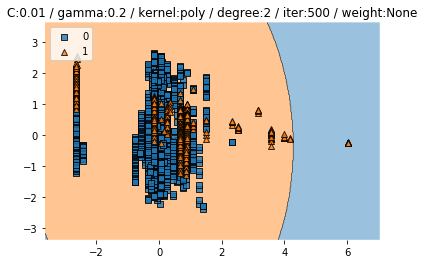

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


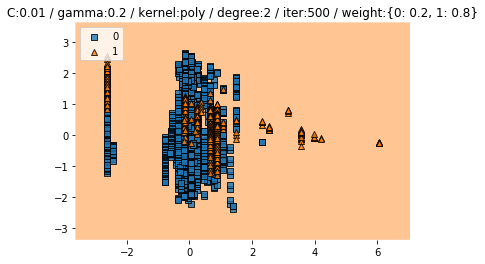

Train CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Train CV accuracy: 0.209 +/- 0.001
Train CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


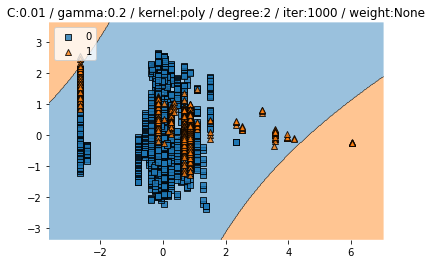

Train CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Train CV accuracy: 0.823 +/- 0.011
Train CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Train CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7472324723247232
Test f1 :  0.36574074074074076


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


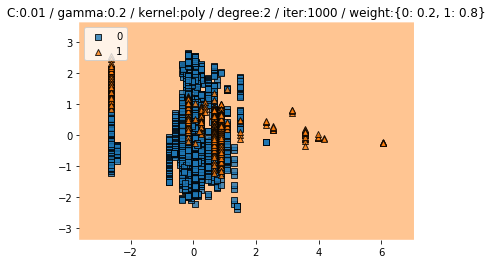

Train CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Train CV accuracy: 0.208 +/- 0.001
Train CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Train CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


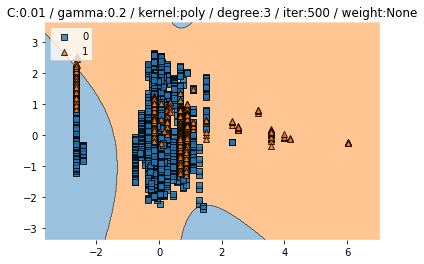

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


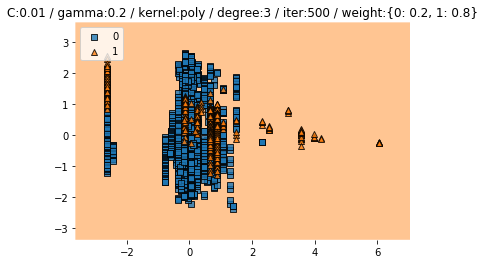

Train CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Train CV accuracy: 0.209 +/- 0.001
Train CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


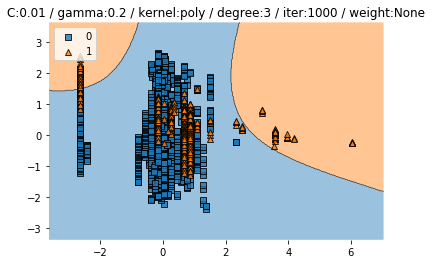

Train CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Train CV accuracy: 0.823 +/- 0.011
Train CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Train CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7472324723247232
Test f1 :  0.36574074074074076


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


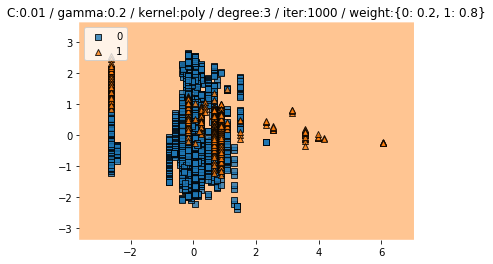

Train CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Train CV accuracy: 0.208 +/- 0.001
Train CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Train CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


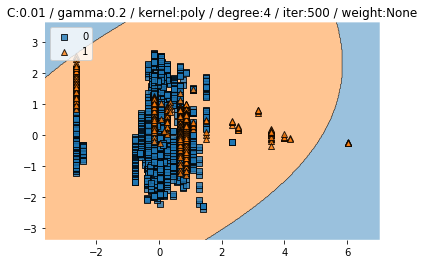

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


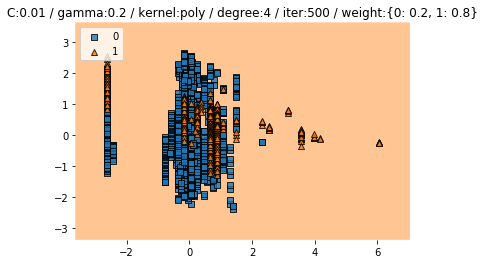

Train CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Train CV accuracy: 0.209 +/- 0.001
Train CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


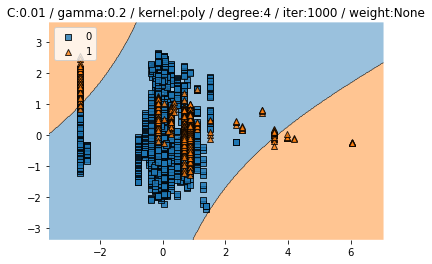

Train CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Train CV accuracy: 0.823 +/- 0.011
Train CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Train CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7472324723247232
Test f1 :  0.36574074074074076


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


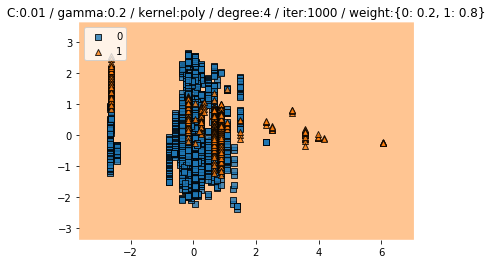

Train CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Train CV accuracy: 0.208 +/- 0.001
Train CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Train CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


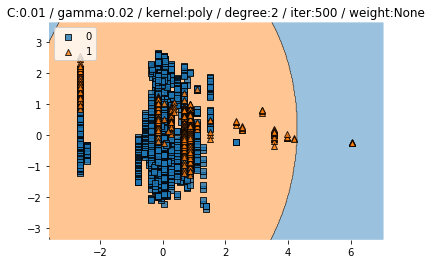

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


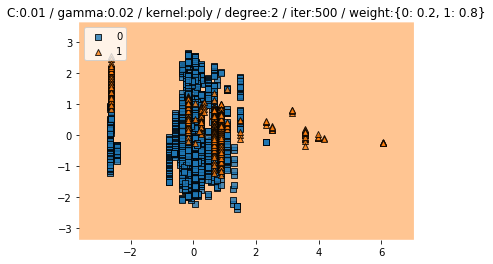

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


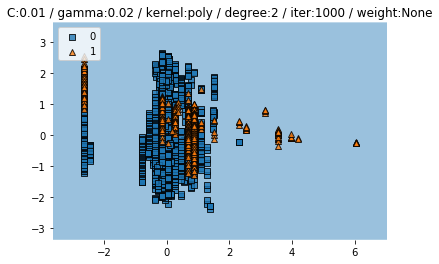

Train CV accuracy scores: [0.79306488 0.79283315 0.78947368 0.79059351 0.79059351]
Train CV accuracy: 0.791 +/- 0.001
Train CV f1 scores: [0.70588707 0.70451803 0.69659443 0.69925841 0.69925841]
Train CV f1: 0.701 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6872693726937269
Test f1 :  0.005865102639296188


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


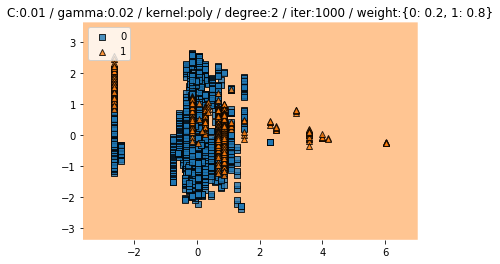

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


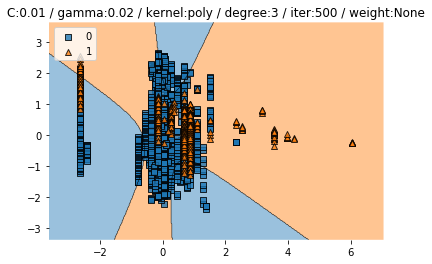

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


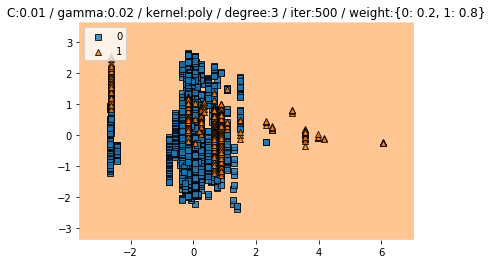

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


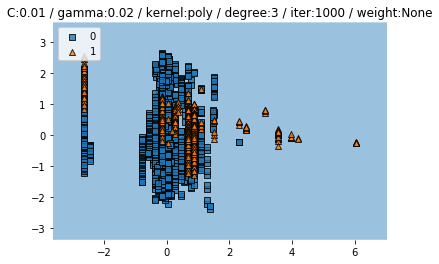

Train CV accuracy scores: [0.79306488 0.79283315 0.78947368 0.79059351 0.79059351]
Train CV accuracy: 0.791 +/- 0.001
Train CV f1 scores: [0.70588707 0.70451803 0.69659443 0.69925841 0.69925841]
Train CV f1: 0.701 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6872693726937269
Test f1 :  0.005865102639296188


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


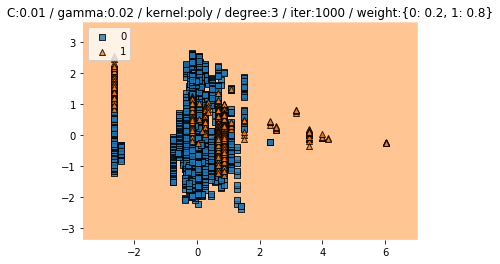

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


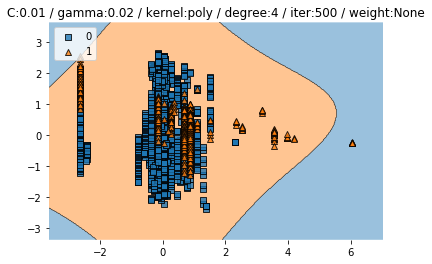

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


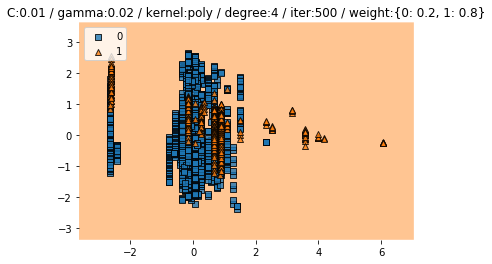

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


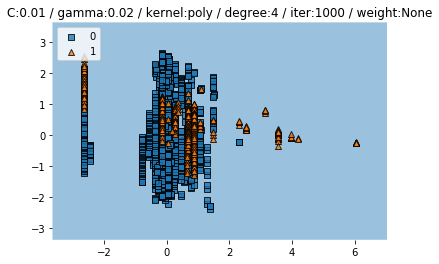

Train CV accuracy scores: [0.79306488 0.79283315 0.78947368 0.79059351 0.79059351]
Train CV accuracy: 0.791 +/- 0.001
Train CV f1 scores: [0.70588707 0.70451803 0.69659443 0.69925841 0.69925841]
Train CV f1: 0.701 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6872693726937269
Test f1 :  0.005865102639296188


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


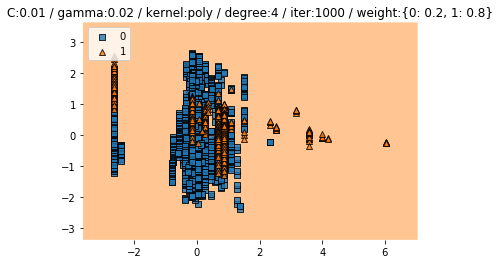

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


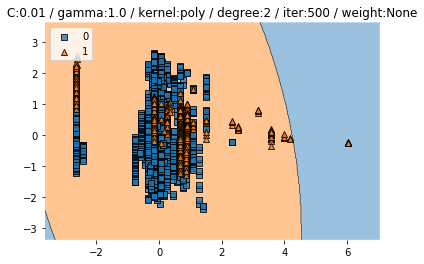

Train CV accuracy scores: [0.27404922 0.22844345 0.21276596 0.20940649 0.23852184]
Train CV accuracy: 0.233 +/- 0.023
Train CV f1 scores: [0.19982003 0.11482047 0.07782889 0.07290448 0.13078572]
Train CV f1: 0.119 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3413284132841328
Test f1 :  0.4870689655172414


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


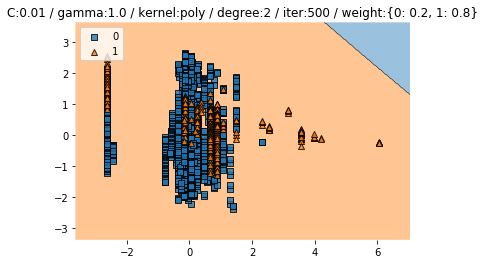

Train CV accuracy scores: [0.34004474 0.32026876 0.28107503 0.20828667 0.24636058]
Train CV accuracy: 0.279 +/- 0.048
Train CV f1 scores: [0.30815288 0.28157333 0.20873408 0.07258183 0.14739167]
Train CV f1: 0.204 +/- 0.086


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3339483394833948
Test f1 :  0.4805755395683453


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


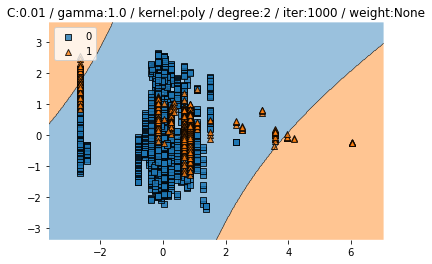

Train CV accuracy scores: [0.94966443 0.93169093 0.9406495  0.93393057 0.93393057]
Train CV accuracy: 0.938 +/- 0.007
Train CV f1 scores: [0.94990343 0.92847591 0.94186801 0.93386589 0.93484268]
Train CV f1: 0.938 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9160516605166051
Test f1 :  0.8548644338118022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


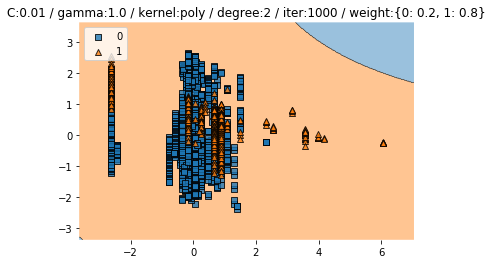

Train CV accuracy scores: [0.70022371 0.7581187  0.85890258 0.93840985 0.76259798]
Train CV accuracy: 0.804 +/- 0.084
Train CV f1 scores: [0.72728242 0.78034543 0.86931099 0.93904303 0.78438943]
Train CV f1: 0.820 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3662361623616236
Test f1 :  0.4967032967032967


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


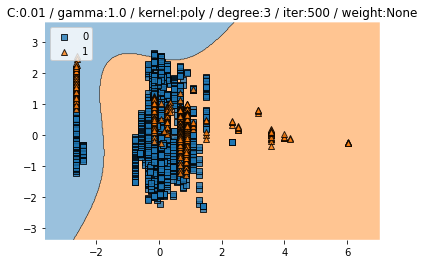

Train CV accuracy scores: [0.27404922 0.22844345 0.21276596 0.20940649 0.23852184]
Train CV accuracy: 0.233 +/- 0.023
Train CV f1 scores: [0.19982003 0.11482047 0.07782889 0.07290448 0.13078572]
Train CV f1: 0.119 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3413284132841328
Test f1 :  0.4870689655172414


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


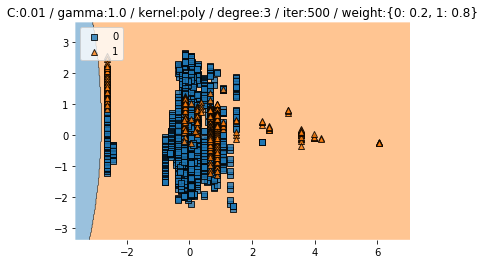

Train CV accuracy scores: [0.34004474 0.32026876 0.28107503 0.20828667 0.24636058]
Train CV accuracy: 0.279 +/- 0.048
Train CV f1 scores: [0.30815288 0.28157333 0.20873408 0.07258183 0.14739167]
Train CV f1: 0.204 +/- 0.086


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3339483394833948
Test f1 :  0.4805755395683453


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


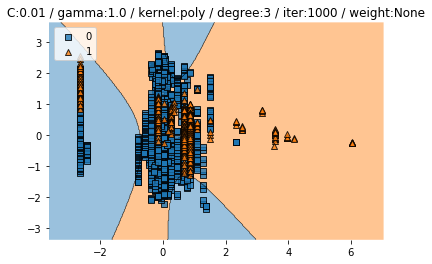

Train CV accuracy scores: [0.94966443 0.93169093 0.9406495  0.93393057 0.93393057]
Train CV accuracy: 0.938 +/- 0.007
Train CV f1 scores: [0.94990343 0.92847591 0.94186801 0.93386589 0.93484268]
Train CV f1: 0.938 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9160516605166051
Test f1 :  0.8548644338118022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


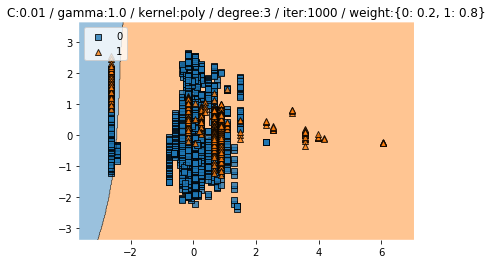

Train CV accuracy scores: [0.70022371 0.7581187  0.85890258 0.93840985 0.76259798]
Train CV accuracy: 0.804 +/- 0.084
Train CV f1 scores: [0.72728242 0.78034543 0.86931099 0.93904303 0.78438943]
Train CV f1: 0.820 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3662361623616236
Test f1 :  0.4967032967032967


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


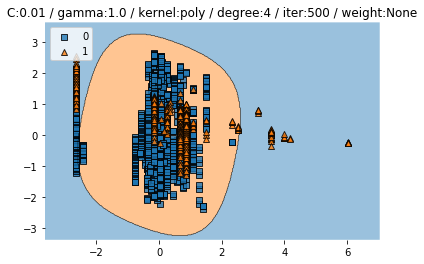

Train CV accuracy scores: [0.27404922 0.22844345 0.21276596 0.20940649 0.23852184]
Train CV accuracy: 0.233 +/- 0.023
Train CV f1 scores: [0.19982003 0.11482047 0.07782889 0.07290448 0.13078572]
Train CV f1: 0.119 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3413284132841328
Test f1 :  0.4870689655172414


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


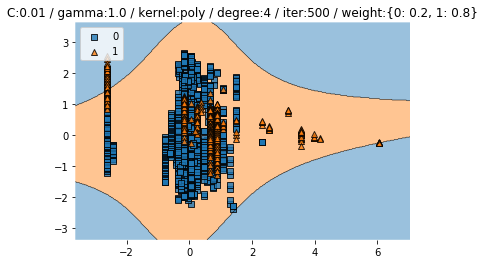

Train CV accuracy scores: [0.34004474 0.32026876 0.28107503 0.20828667 0.24636058]
Train CV accuracy: 0.279 +/- 0.048
Train CV f1 scores: [0.30815288 0.28157333 0.20873408 0.07258183 0.14739167]
Train CV f1: 0.204 +/- 0.086


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3339483394833948
Test f1 :  0.4805755395683453


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


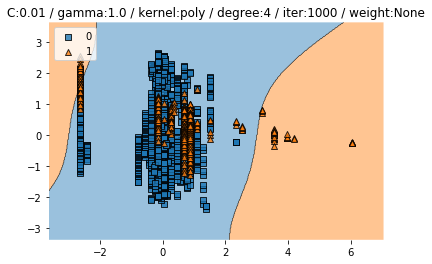

Train CV accuracy scores: [0.94966443 0.93169093 0.9406495  0.93393057 0.93393057]
Train CV accuracy: 0.938 +/- 0.007
Train CV f1 scores: [0.94990343 0.92847591 0.94186801 0.93386589 0.93484268]
Train CV f1: 0.938 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9160516605166051
Test f1 :  0.8548644338118022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


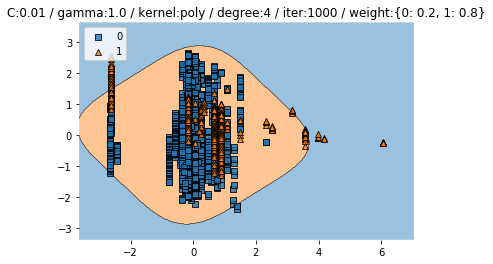

Train CV accuracy scores: [0.70022371 0.7581187  0.85890258 0.93840985 0.76259798]
Train CV accuracy: 0.804 +/- 0.084
Train CV f1 scores: [0.72728242 0.78034543 0.86931099 0.93904303 0.78438943]
Train CV f1: 0.820 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3662361623616236
Test f1 :  0.4967032967032967


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


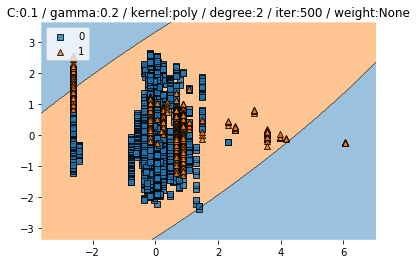

Train CV accuracy scores: [0.21364653 0.33482643 0.21164614 0.20940649 0.74356103]
Train CV accuracy: 0.343 +/- 0.206
Train CV f1 scores: [0.08613488 0.29978177 0.07553082 0.07290448 0.76723149]
Train CV f1: 0.260 +/- 0.268


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


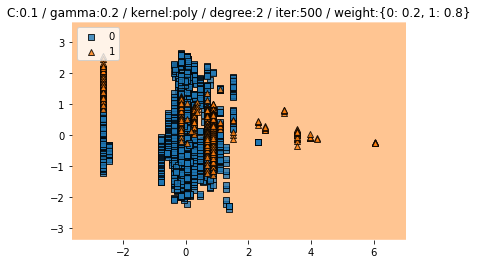

Train CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Train CV accuracy: 0.211 +/- 0.006
Train CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Train CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


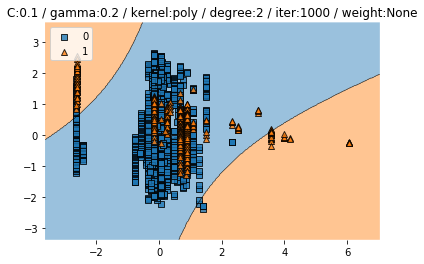

Train CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.89025756]
Train CV accuracy: 0.908 +/- 0.024
Train CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.8855286 ]
Train CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8505535055350554
Test f1 :  0.7


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


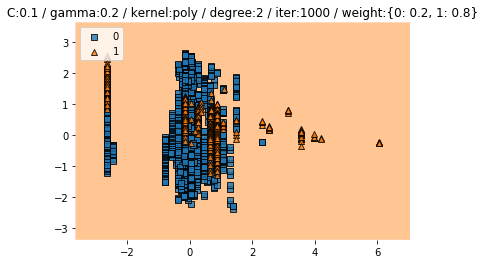

Train CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Train CV accuracy: 0.418 +/- 0.098
Train CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Train CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


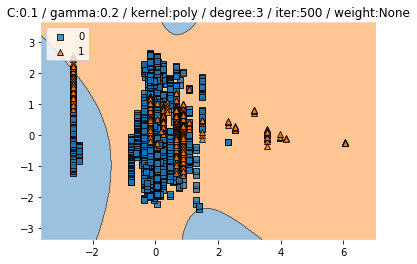

Train CV accuracy scores: [0.21364653 0.33482643 0.21164614 0.20940649 0.74356103]
Train CV accuracy: 0.343 +/- 0.206
Train CV f1 scores: [0.08613488 0.29978177 0.07553082 0.07290448 0.76723149]
Train CV f1: 0.260 +/- 0.268


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


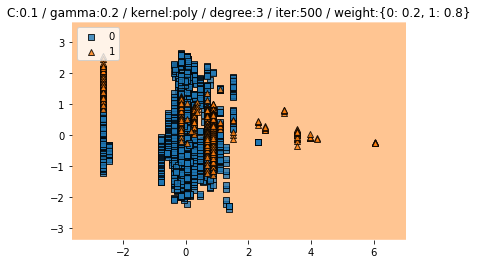

Train CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Train CV accuracy: 0.211 +/- 0.006
Train CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Train CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


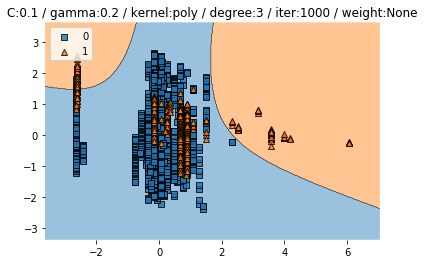

Train CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.89025756]
Train CV accuracy: 0.908 +/- 0.024
Train CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.8855286 ]
Train CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8505535055350554
Test f1 :  0.7


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


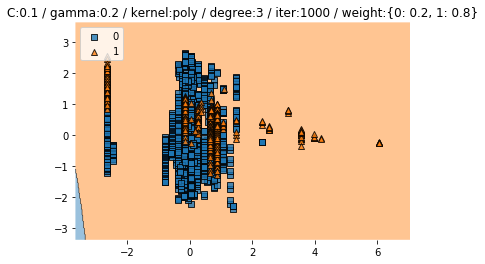

Train CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Train CV accuracy: 0.418 +/- 0.098
Train CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Train CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


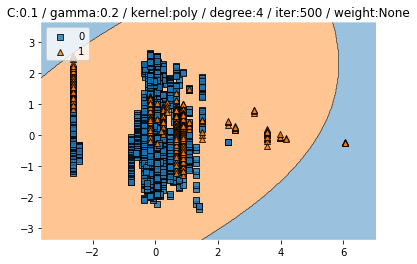

Train CV accuracy scores: [0.21364653 0.33482643 0.21164614 0.20940649 0.74356103]
Train CV accuracy: 0.343 +/- 0.206
Train CV f1 scores: [0.08613488 0.29978177 0.07553082 0.07290448 0.76723149]
Train CV f1: 0.260 +/- 0.268


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


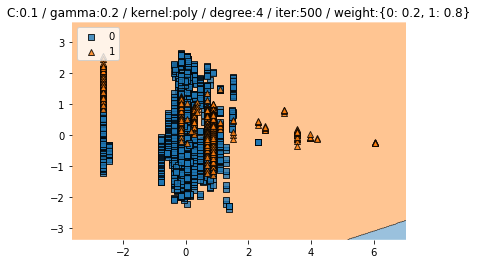

Train CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Train CV accuracy: 0.211 +/- 0.006
Train CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Train CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


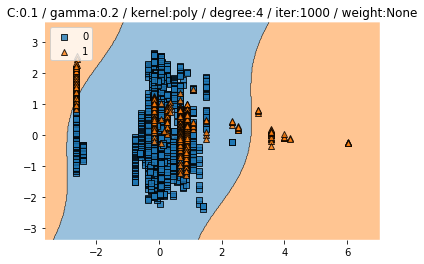

Train CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.89025756]
Train CV accuracy: 0.908 +/- 0.024
Train CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.8855286 ]
Train CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8505535055350554
Test f1 :  0.7


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


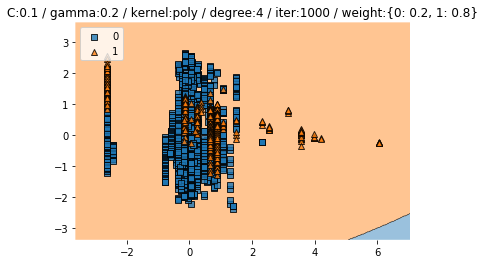

Train CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Train CV accuracy: 0.418 +/- 0.098
Train CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Train CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


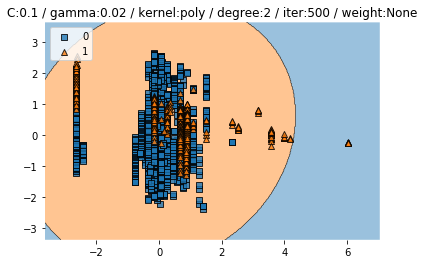

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


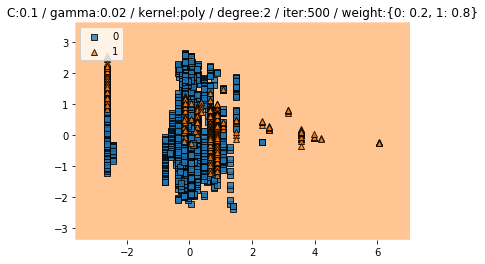

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


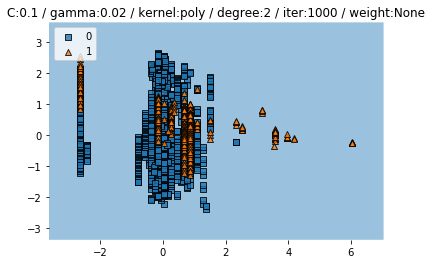

Train CV accuracy scores: [0.79977629 0.79619261 0.79059351 0.79731243 0.79955207]
Train CV accuracy: 0.797 +/- 0.003
Train CV f1 scores: [0.72100347 0.71224203 0.69925841 0.71477398 0.7197758 ]
Train CV f1: 0.713 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.690959409594096
Test f1 :  0.028985507246376812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


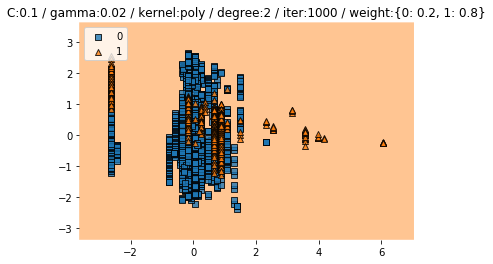

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


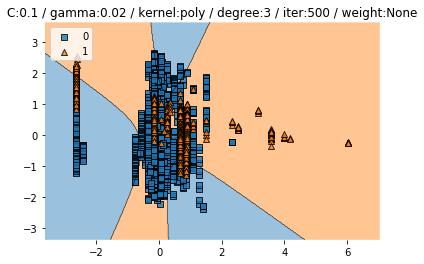

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


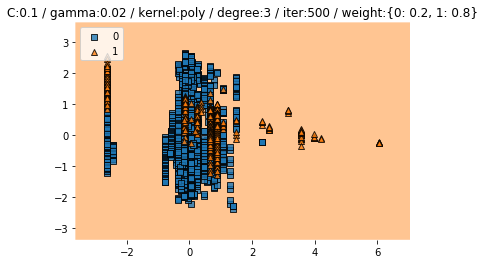

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


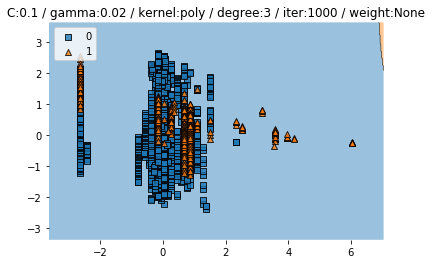

Train CV accuracy scores: [0.79977629 0.79619261 0.79059351 0.79731243 0.79955207]
Train CV accuracy: 0.797 +/- 0.003
Train CV f1 scores: [0.72100347 0.71224203 0.69925841 0.71477398 0.7197758 ]
Train CV f1: 0.713 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.690959409594096
Test f1 :  0.028985507246376812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


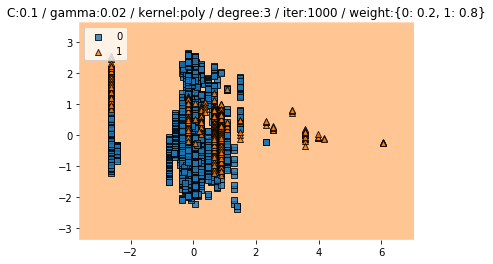

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


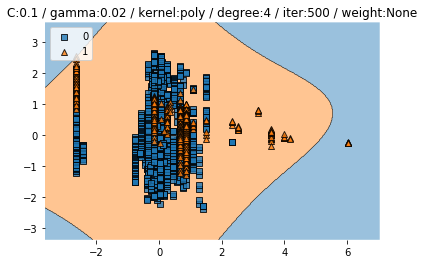

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


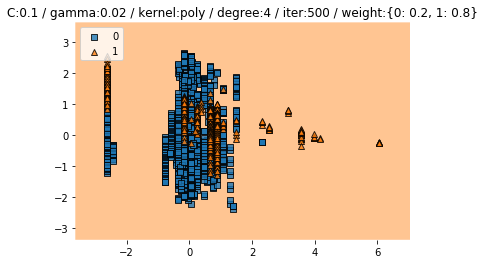

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


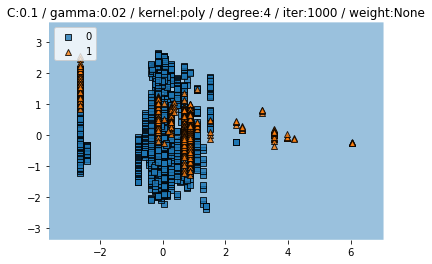

Train CV accuracy scores: [0.79977629 0.79619261 0.79059351 0.79731243 0.79955207]
Train CV accuracy: 0.797 +/- 0.003
Train CV f1 scores: [0.72100347 0.71224203 0.69925841 0.71477398 0.7197758 ]
Train CV f1: 0.713 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.690959409594096
Test f1 :  0.028985507246376812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


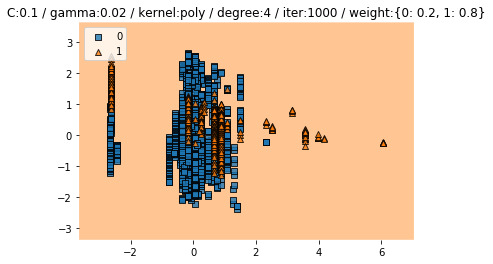

Train CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.211 +/- 0.000
Train CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


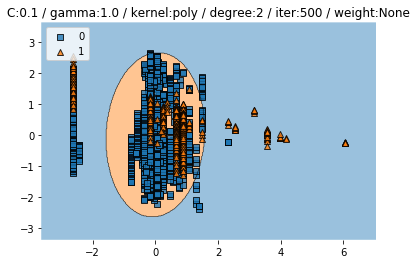

Train CV accuracy scores: [0.89709172 0.21388578 0.22508399 0.28331467 0.26539754]
Train CV accuracy: 0.377 +/- 0.261
Train CV f1 scores: [0.9006574  0.09162388 0.10824107 0.21548487 0.18087127]
Train CV f1: 0.299 +/- 0.304


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


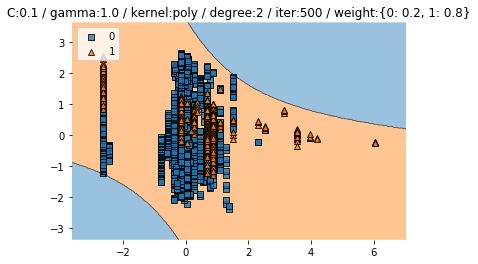

Train CV accuracy scores: [0.42393736 0.86450168 0.23180291 0.2206047  0.30347144]
Train CV accuracy: 0.409 +/- 0.239
Train CV f1 scores: [0.42722655 0.87350596 0.11597309 0.1030864  0.24694113]
Train CV f1: 0.353 +/- 0.285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.48554913294797686


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


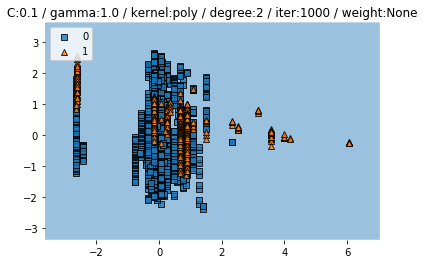

Train CV accuracy scores: [0.69127517 0.67861142 0.31243001 0.23628219 0.32922732]
Train CV accuracy: 0.450 +/- 0.195
Train CV f1 scores: [0.71908891 0.70741906 0.26046527 0.13342937 0.28872907]
Train CV f1: 0.422 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36900369003690037
Test f1 :  0.4955752212389381


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


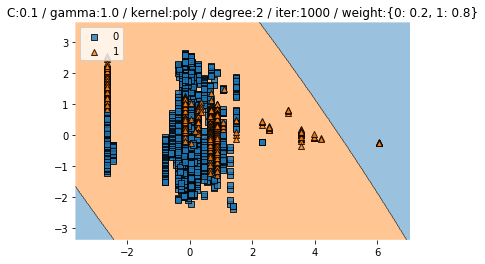

Train CV accuracy scores: [0.61856823 0.71556551 0.39865622 0.51511758 0.76483763]
Train CV accuracy: 0.603 +/- 0.133
Train CV f1 scores: [0.64855945 0.74175598 0.39055329 0.53786625 0.78636903]
Train CV f1: 0.621 +/- 0.143


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4022140221402214
Test f1 :  0.5113122171945701


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


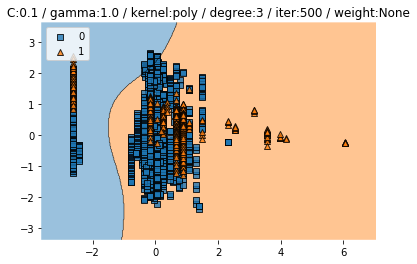

Train CV accuracy scores: [0.89709172 0.21388578 0.22508399 0.28331467 0.26539754]
Train CV accuracy: 0.377 +/- 0.261
Train CV f1 scores: [0.9006574  0.09162388 0.10824107 0.21548487 0.18087127]
Train CV f1: 0.299 +/- 0.304


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


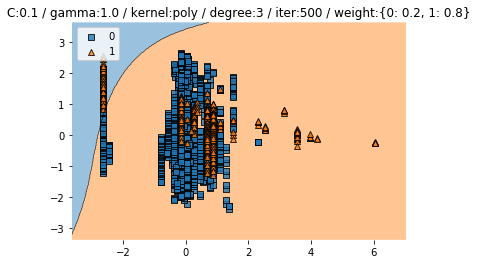

Train CV accuracy scores: [0.42393736 0.86450168 0.23180291 0.2206047  0.30347144]
Train CV accuracy: 0.409 +/- 0.239
Train CV f1 scores: [0.42722655 0.87350596 0.11597309 0.1030864  0.24694113]
Train CV f1: 0.353 +/- 0.285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.48554913294797686


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


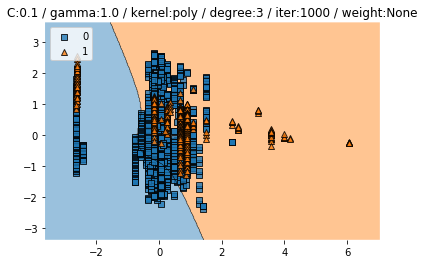

Train CV accuracy scores: [0.69127517 0.67861142 0.31243001 0.23628219 0.32922732]
Train CV accuracy: 0.450 +/- 0.195
Train CV f1 scores: [0.71908891 0.70741906 0.26046527 0.13342937 0.28872907]
Train CV f1: 0.422 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36900369003690037
Test f1 :  0.4955752212389381


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


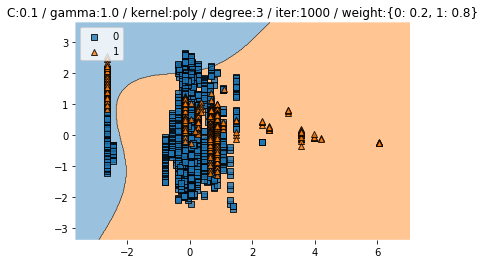

Train CV accuracy scores: [0.61856823 0.71556551 0.39865622 0.51511758 0.76483763]
Train CV accuracy: 0.603 +/- 0.133
Train CV f1 scores: [0.64855945 0.74175598 0.39055329 0.53786625 0.78636903]
Train CV f1: 0.621 +/- 0.143


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4022140221402214
Test f1 :  0.5113122171945701


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


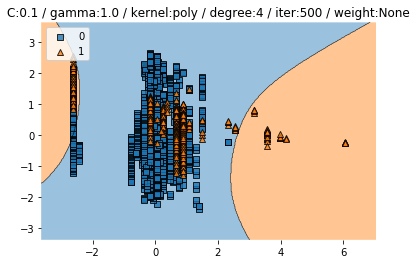

Train CV accuracy scores: [0.89709172 0.21388578 0.22508399 0.28331467 0.26539754]
Train CV accuracy: 0.377 +/- 0.261
Train CV f1 scores: [0.9006574  0.09162388 0.10824107 0.21548487 0.18087127]
Train CV f1: 0.299 +/- 0.304


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


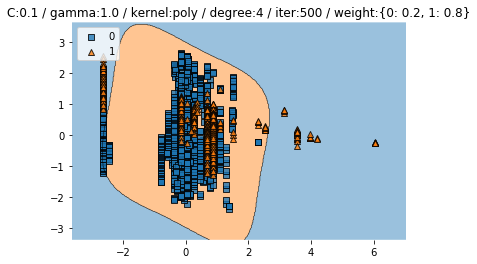

Train CV accuracy scores: [0.42393736 0.86450168 0.23180291 0.2206047  0.30347144]
Train CV accuracy: 0.409 +/- 0.239
Train CV f1 scores: [0.42722655 0.87350596 0.11597309 0.1030864  0.24694113]
Train CV f1: 0.353 +/- 0.285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.48554913294797686


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


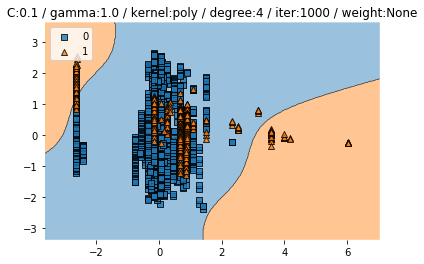

Train CV accuracy scores: [0.69127517 0.67861142 0.31243001 0.23628219 0.32922732]
Train CV accuracy: 0.450 +/- 0.195
Train CV f1 scores: [0.71908891 0.70741906 0.26046527 0.13342937 0.28872907]
Train CV f1: 0.422 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36900369003690037
Test f1 :  0.4955752212389381


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


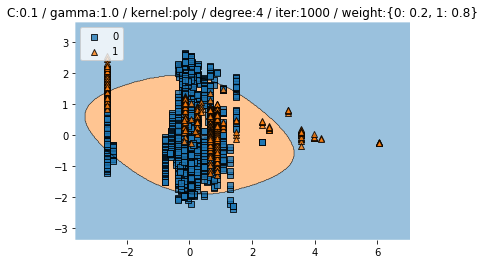

Train CV accuracy scores: [0.61856823 0.71556551 0.39865622 0.51511758 0.76483763]
Train CV accuracy: 0.603 +/- 0.133
Train CV f1 scores: [0.64855945 0.74175598 0.39055329 0.53786625 0.78636903]
Train CV f1: 0.621 +/- 0.143


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4022140221402214
Test f1 :  0.5113122171945701


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


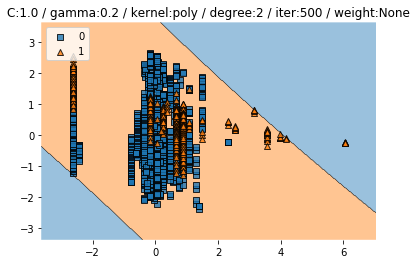

Train CV accuracy scores: [0.22706935 0.22284434 0.22956327 0.9193729  0.43337066]
Train CV accuracy: 0.406 +/- 0.269
Train CV f1 scores: [0.11277417 0.10382605 0.11157395 0.91336388 0.43802719]
Train CV f1: 0.336 +/- 0.316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4749823819591262


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


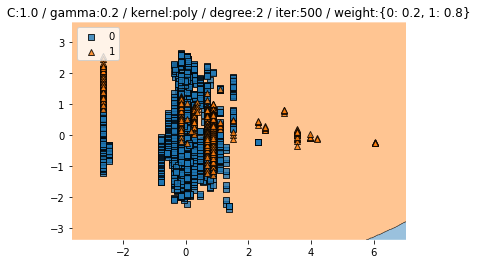

Train CV accuracy scores: [0.21588367 0.40425532 0.31690929 0.23404255 0.27883539]
Train CV accuracy: 0.290 +/- 0.067
Train CV f1 scores: [0.10356666 0.4069225  0.27146562 0.13934654 0.20481174]
Train CV f1: 0.225 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37084870848708484
Test f1 :  0.48952095808383234


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


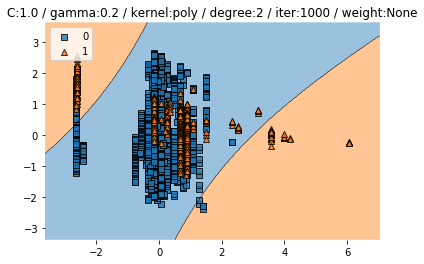

Train CV accuracy scores: [0.950783   0.93729003 0.93952968 0.92833147 0.92161254]
Train CV accuracy: 0.936 +/- 0.010
Train CV f1 scores: [0.95049036 0.93475072 0.94082023 0.92648796 0.9219136 ]
Train CV f1: 0.935 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9031365313653137
Test f1 :  0.8275862068965518


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


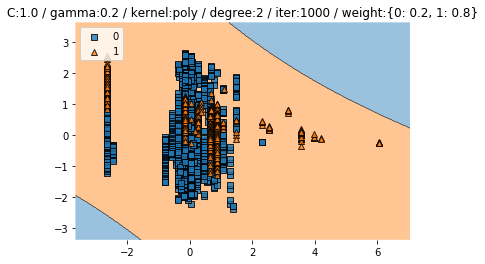

Train CV accuracy scores: [0.5704698  0.76595745 0.5162374  0.26315789 0.92721165]
Train CV accuracy: 0.609 +/- 0.226
Train CV f1 scores: [0.59947111 0.78726707 0.5387168  0.17681193 0.93081704]
Train CV f1: 0.607 +/- 0.256


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5618081180811808
Test f1 :  0.5858761987794245


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


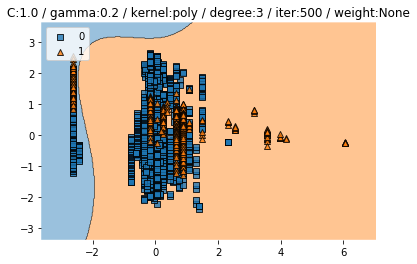

Train CV accuracy scores: [0.22706935 0.22284434 0.22956327 0.9193729  0.43337066]
Train CV accuracy: 0.406 +/- 0.269
Train CV f1 scores: [0.11277417 0.10382605 0.11157395 0.91336388 0.43802719]
Train CV f1: 0.336 +/- 0.316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4749823819591262


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


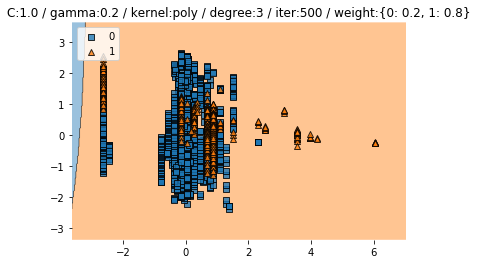

Train CV accuracy scores: [0.21588367 0.40425532 0.31690929 0.23404255 0.27883539]
Train CV accuracy: 0.290 +/- 0.067
Train CV f1 scores: [0.10356666 0.4069225  0.27146562 0.13934654 0.20481174]
Train CV f1: 0.225 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37084870848708484
Test f1 :  0.48952095808383234


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


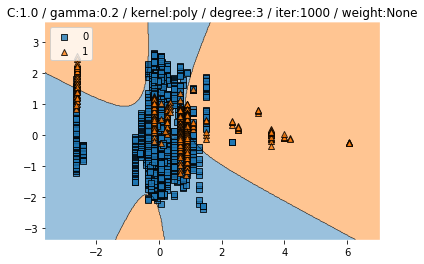

Train CV accuracy scores: [0.950783   0.93729003 0.93952968 0.92833147 0.92161254]
Train CV accuracy: 0.936 +/- 0.010
Train CV f1 scores: [0.95049036 0.93475072 0.94082023 0.92648796 0.9219136 ]
Train CV f1: 0.935 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9031365313653137
Test f1 :  0.8275862068965518


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


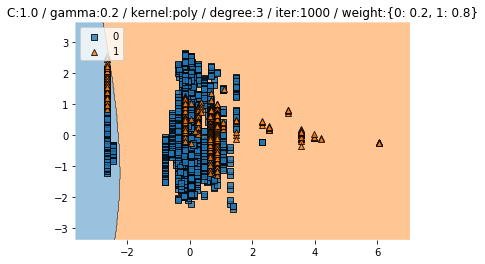

Train CV accuracy scores: [0.5704698  0.76595745 0.5162374  0.26315789 0.92721165]
Train CV accuracy: 0.609 +/- 0.226
Train CV f1 scores: [0.59947111 0.78726707 0.5387168  0.17681193 0.93081704]
Train CV f1: 0.607 +/- 0.256


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5618081180811808
Test f1 :  0.5858761987794245


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


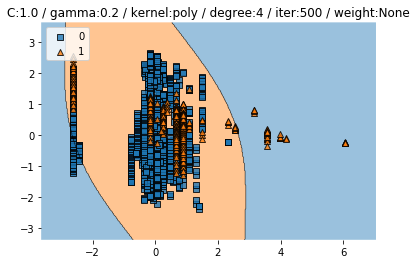

Train CV accuracy scores: [0.22706935 0.22284434 0.22956327 0.9193729  0.43337066]
Train CV accuracy: 0.406 +/- 0.269
Train CV f1 scores: [0.11277417 0.10382605 0.11157395 0.91336388 0.43802719]
Train CV f1: 0.336 +/- 0.316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4749823819591262


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


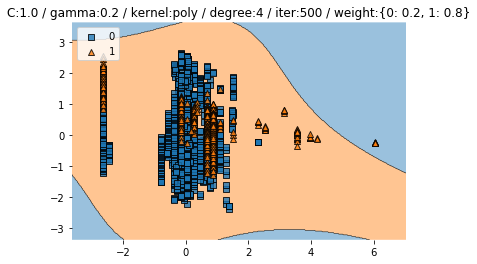

Train CV accuracy scores: [0.21588367 0.40425532 0.31690929 0.23404255 0.27883539]
Train CV accuracy: 0.290 +/- 0.067
Train CV f1 scores: [0.10356666 0.4069225  0.27146562 0.13934654 0.20481174]
Train CV f1: 0.225 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37084870848708484
Test f1 :  0.48952095808383234


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


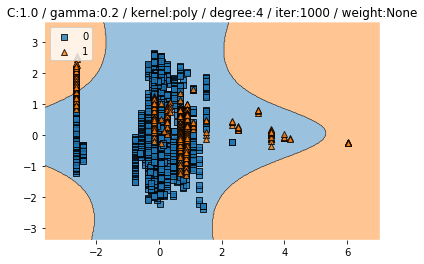

Train CV accuracy scores: [0.950783   0.93729003 0.93952968 0.92833147 0.92161254]
Train CV accuracy: 0.936 +/- 0.010
Train CV f1 scores: [0.95049036 0.93475072 0.94082023 0.92648796 0.9219136 ]
Train CV f1: 0.935 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9031365313653137
Test f1 :  0.8275862068965518


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


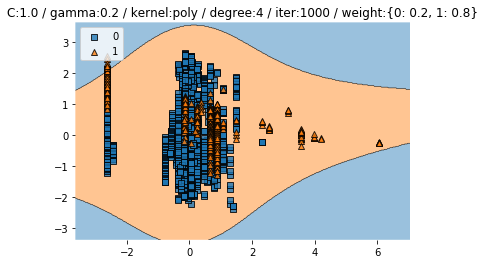

Train CV accuracy scores: [0.5704698  0.76595745 0.5162374  0.26315789 0.92721165]
Train CV accuracy: 0.609 +/- 0.226
Train CV f1 scores: [0.59947111 0.78726707 0.5387168  0.17681193 0.93081704]
Train CV f1: 0.607 +/- 0.256


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5618081180811808
Test f1 :  0.5858761987794245


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


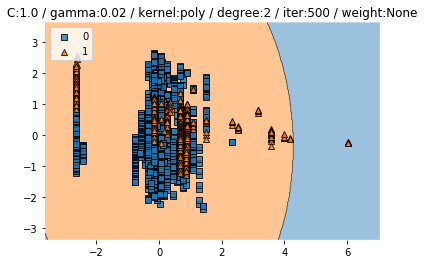

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


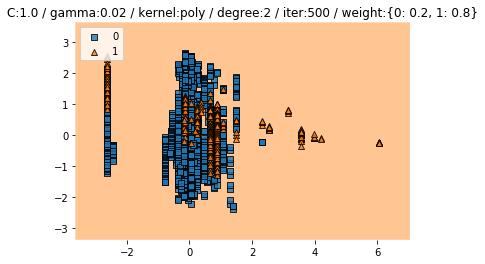

Train CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.000
Train CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


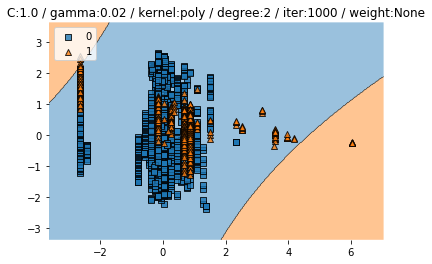

Train CV accuracy scores: [0.82102908 0.81522956 0.81634938 0.81410974 0.80515118]
Train CV accuracy: 0.814 +/- 0.005
Train CV f1 scores: [0.76447122 0.75266365 0.75488228 0.75042874 0.73193306]
Train CV f1: 0.751 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.709409594095941
Test f1 :  0.13698630136986303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


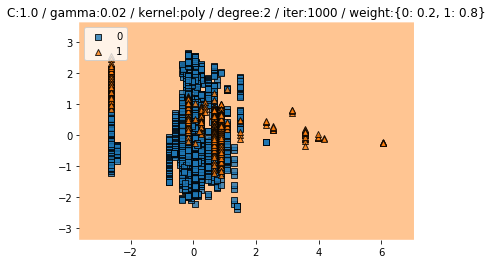

Train CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.000
Train CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


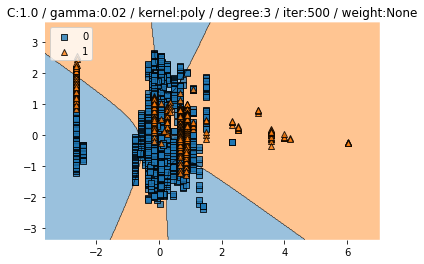

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


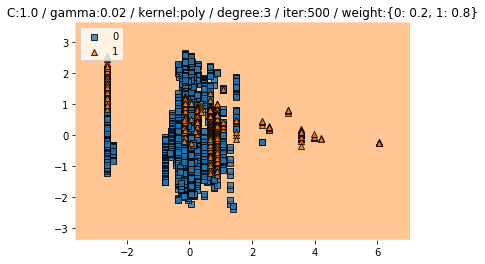

Train CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.000
Train CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


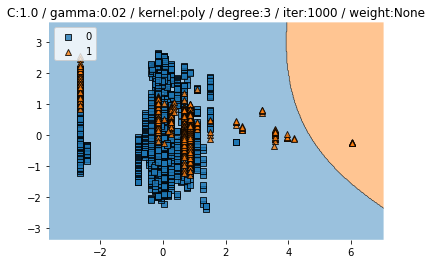

Train CV accuracy scores: [0.82102908 0.81522956 0.81634938 0.81410974 0.80515118]
Train CV accuracy: 0.814 +/- 0.005
Train CV f1 scores: [0.76447122 0.75266365 0.75488228 0.75042874 0.73193306]
Train CV f1: 0.751 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.709409594095941
Test f1 :  0.13698630136986303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


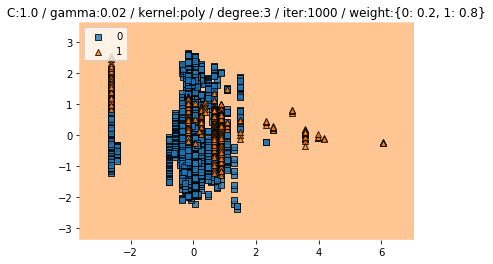

Train CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.000
Train CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


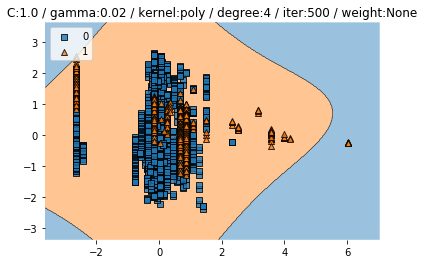

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


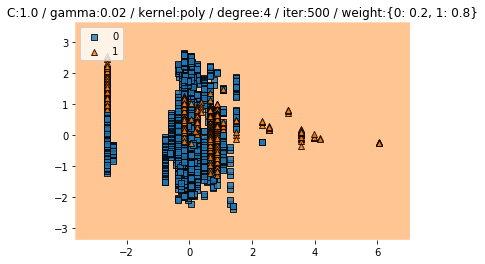

Train CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.000
Train CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


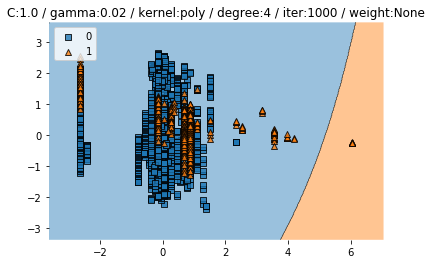

Train CV accuracy scores: [0.82102908 0.81522956 0.81634938 0.81410974 0.80515118]
Train CV accuracy: 0.814 +/- 0.005
Train CV f1 scores: [0.76447122 0.75266365 0.75488228 0.75042874 0.73193306]
Train CV f1: 0.751 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.709409594095941
Test f1 :  0.13698630136986303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


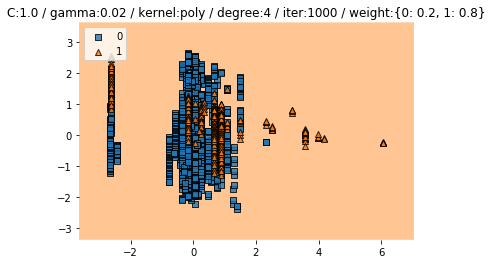

Train CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.000
Train CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


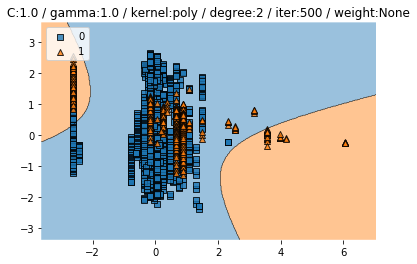

Train CV accuracy scores: [0.3098434  0.20268757 0.90929451 0.20716685 0.4031355 ]
Train CV accuracy: 0.406 +/- 0.262
Train CV f1 scores: [0.26040115 0.08804702 0.9097283  0.07811891 0.39838337]
Train CV f1: 0.347 +/- 0.305


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3284132841328413
Test f1 :  0.4785100286532951


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


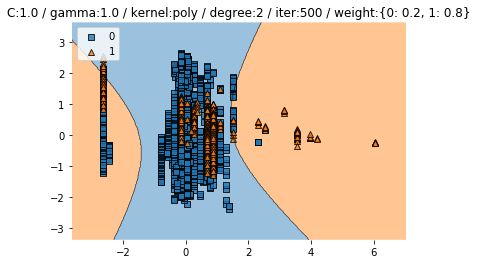

Train CV accuracy scores: [0.21812081 0.21052632 0.21724524 0.22284434 0.26091825]
Train CV accuracy: 0.226 +/- 0.018
Train CV f1 scores: [0.13013811 0.08679728 0.0869597  0.11110201 0.17273236]
Train CV f1: 0.118 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5249077490774908
Test f1 :  0.5661331086773378


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


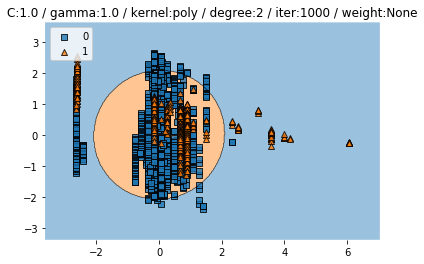

Train CV accuracy scores: [0.46868009 0.40761478 0.52071669 0.268757   0.30907055]
Train CV accuracy: 0.395 +/- 0.095
Train CV f1 scores: [0.48559975 0.40528361 0.54384045 0.19146328 0.25748705]
Train CV f1: 0.377 +/- 0.134


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7481549815498155
Test f1 :  0.6374501992031872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


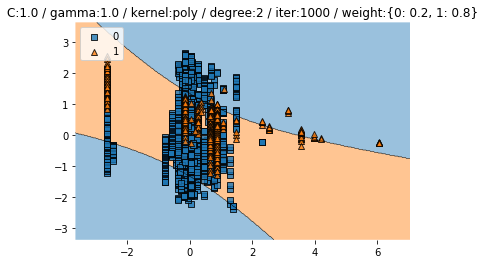

Train CV accuracy scores: [0.24944072 0.31354983 0.62262038 0.60806271 0.30907055]
Train CV accuracy: 0.421 +/- 0.161
Train CV f1 scores: [0.17117373 0.27090914 0.65254245 0.63804187 0.25621457]
Train CV f1: 0.398 +/- 0.205


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.41789667896678967
Test f1 :  0.5157329240214888


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


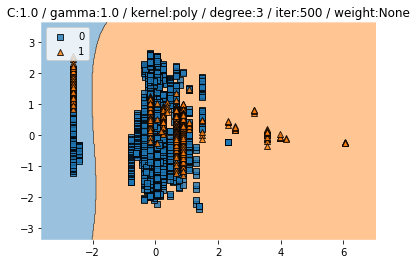

Train CV accuracy scores: [0.3098434  0.20268757 0.90929451 0.20716685 0.4031355 ]
Train CV accuracy: 0.406 +/- 0.262
Train CV f1 scores: [0.26040115 0.08804702 0.9097283  0.07811891 0.39838337]
Train CV f1: 0.347 +/- 0.305


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3284132841328413
Test f1 :  0.4785100286532951


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


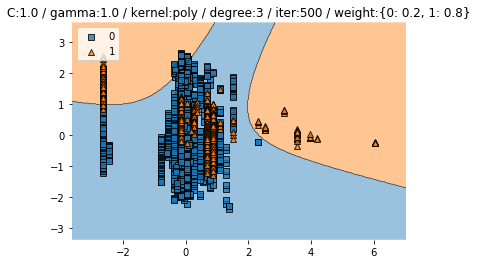

Train CV accuracy scores: [0.21812081 0.21052632 0.21724524 0.22284434 0.26091825]
Train CV accuracy: 0.226 +/- 0.018
Train CV f1 scores: [0.13013811 0.08679728 0.0869597  0.11110201 0.17273236]
Train CV f1: 0.118 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5249077490774908
Test f1 :  0.5661331086773378


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


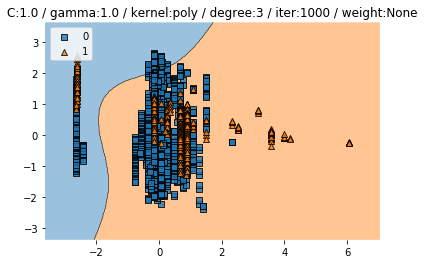

Train CV accuracy scores: [0.46868009 0.40761478 0.52071669 0.268757   0.30907055]
Train CV accuracy: 0.395 +/- 0.095
Train CV f1 scores: [0.48559975 0.40528361 0.54384045 0.19146328 0.25748705]
Train CV f1: 0.377 +/- 0.134


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7481549815498155
Test f1 :  0.6374501992031872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


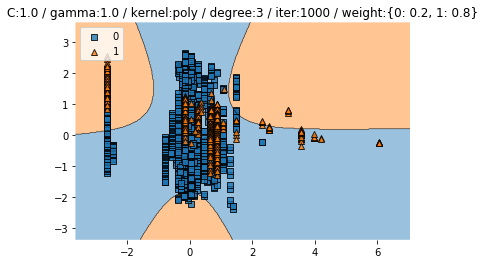

Train CV accuracy scores: [0.24944072 0.31354983 0.62262038 0.60806271 0.30907055]
Train CV accuracy: 0.421 +/- 0.161
Train CV f1 scores: [0.17117373 0.27090914 0.65254245 0.63804187 0.25621457]
Train CV f1: 0.398 +/- 0.205


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.41789667896678967
Test f1 :  0.5157329240214888


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


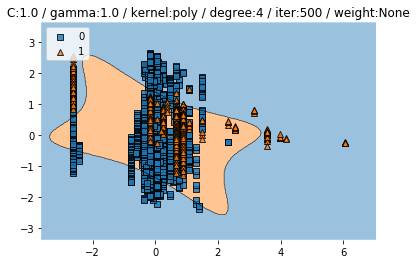

Train CV accuracy scores: [0.3098434  0.20268757 0.90929451 0.20716685 0.4031355 ]
Train CV accuracy: 0.406 +/- 0.262
Train CV f1 scores: [0.26040115 0.08804702 0.9097283  0.07811891 0.39838337]
Train CV f1: 0.347 +/- 0.305


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3284132841328413
Test f1 :  0.4785100286532951


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


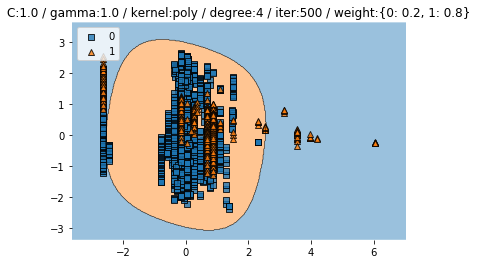

Train CV accuracy scores: [0.21812081 0.21052632 0.21724524 0.22284434 0.26091825]
Train CV accuracy: 0.226 +/- 0.018
Train CV f1 scores: [0.13013811 0.08679728 0.0869597  0.11110201 0.17273236]
Train CV f1: 0.118 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5249077490774908
Test f1 :  0.5661331086773378


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


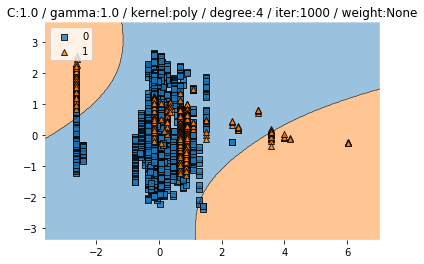

Train CV accuracy scores: [0.46868009 0.40761478 0.52071669 0.268757   0.30907055]
Train CV accuracy: 0.395 +/- 0.095
Train CV f1 scores: [0.48559975 0.40528361 0.54384045 0.19146328 0.25748705]
Train CV f1: 0.377 +/- 0.134


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7481549815498155
Test f1 :  0.6374501992031872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


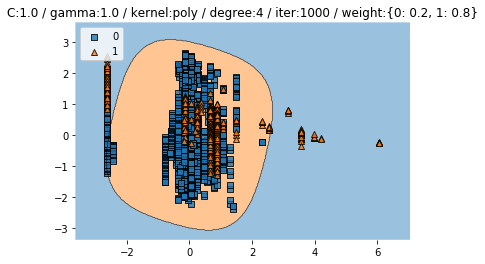

Train CV accuracy scores: [0.24944072 0.31354983 0.62262038 0.60806271 0.30907055]
Train CV accuracy: 0.421 +/- 0.161
Train CV f1 scores: [0.17117373 0.27090914 0.65254245 0.63804187 0.25621457]
Train CV f1: 0.398 +/- 0.205


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.41789667896678967
Test f1 :  0.5157329240214888


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


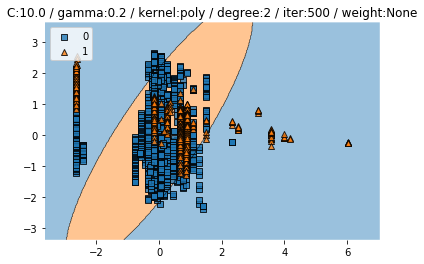

Train CV accuracy scores: [0.24608501 0.27883539 0.23740202 0.20380739 0.54983203]
Train CV accuracy: 0.303 +/- 0.126
Train CV f1 scores: [0.15241549 0.21199958 0.12687102 0.07128519 0.57671253]
Train CV f1: 0.228 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3219557195571956
Test f1 :  0.47761194029850745


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


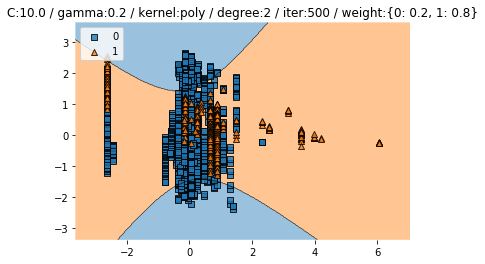

Train CV accuracy scores: [0.34228188 0.21388578 0.33034714 0.26763718 0.89137738]
Train CV accuracy: 0.409 +/- 0.246
Train CV f1 scores: [0.31157723 0.09162388 0.2893342  0.18491055 0.89840826]
Train CV f1: 0.355 +/- 0.283


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40313653136531363
Test f1 :  0.5094768764215316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


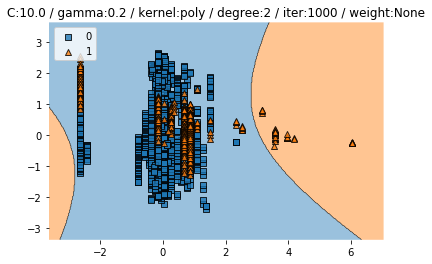

Train CV accuracy scores: [0.3590604  0.40985442 0.9462486  0.59014558 0.55767077]
Train CV accuracy: 0.573 +/- 0.206
Train CV f1 scores: [0.33679179 0.40985442 0.94635262 0.61963451 0.58490921]
Train CV f1: 0.580 +/- 0.212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3865313653136531
Test f1 :  0.5033607169529499


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


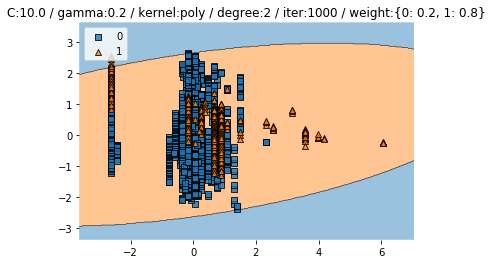

Train CV accuracy scores: [0.8557047  0.52631579 0.45128779 0.3225084  0.35386338]
Train CV accuracy: 0.502 +/- 0.191
Train CV f1 scores: [0.86661578 0.55218005 0.46039948 0.27803878 0.32672692]
Train CV f1: 0.497 +/- 0.209


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.518450184501845
Test f1 :  0.5650000000000001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


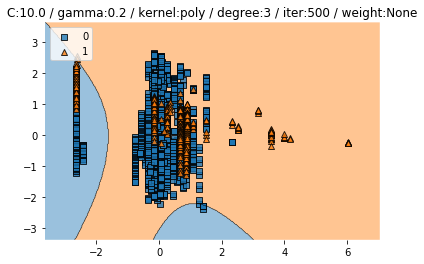

Train CV accuracy scores: [0.24608501 0.27883539 0.23740202 0.20380739 0.54983203]
Train CV accuracy: 0.303 +/- 0.126
Train CV f1 scores: [0.15241549 0.21199958 0.12687102 0.07128519 0.57671253]
Train CV f1: 0.228 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3219557195571956
Test f1 :  0.47761194029850745


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


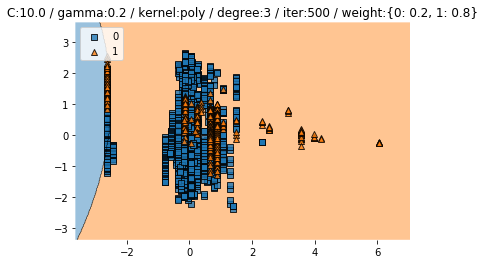

Train CV accuracy scores: [0.34228188 0.21388578 0.33034714 0.26763718 0.89137738]
Train CV accuracy: 0.409 +/- 0.246
Train CV f1 scores: [0.31157723 0.09162388 0.2893342  0.18491055 0.89840826]
Train CV f1: 0.355 +/- 0.283


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40313653136531363
Test f1 :  0.5094768764215316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


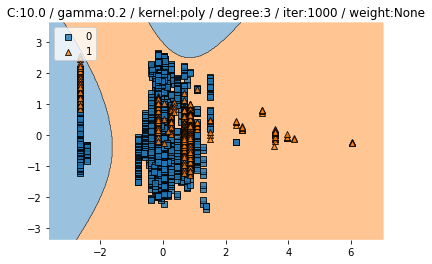

Train CV accuracy scores: [0.3590604  0.40985442 0.9462486  0.59014558 0.55767077]
Train CV accuracy: 0.573 +/- 0.206
Train CV f1 scores: [0.33679179 0.40985442 0.94635262 0.61963451 0.58490921]
Train CV f1: 0.580 +/- 0.212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3865313653136531
Test f1 :  0.5033607169529499


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


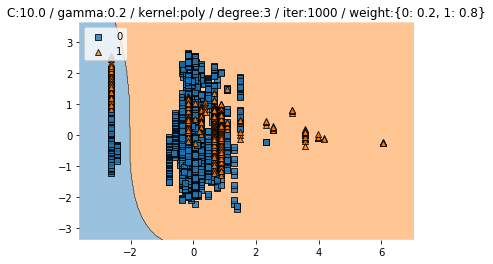

Train CV accuracy scores: [0.8557047  0.52631579 0.45128779 0.3225084  0.35386338]
Train CV accuracy: 0.502 +/- 0.191
Train CV f1 scores: [0.86661578 0.55218005 0.46039948 0.27803878 0.32672692]
Train CV f1: 0.497 +/- 0.209


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.518450184501845
Test f1 :  0.5650000000000001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


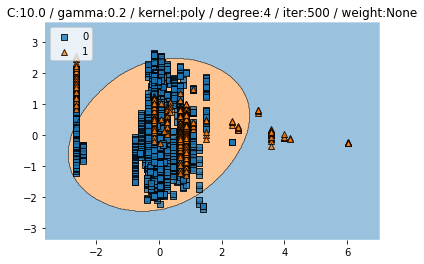

Train CV accuracy scores: [0.24608501 0.27883539 0.23740202 0.20380739 0.54983203]
Train CV accuracy: 0.303 +/- 0.126
Train CV f1 scores: [0.15241549 0.21199958 0.12687102 0.07128519 0.57671253]
Train CV f1: 0.228 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3219557195571956
Test f1 :  0.47761194029850745


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


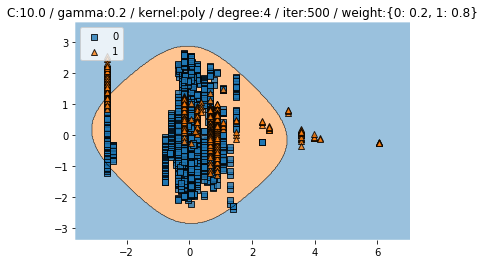

Train CV accuracy scores: [0.34228188 0.21388578 0.33034714 0.26763718 0.89137738]
Train CV accuracy: 0.409 +/- 0.246
Train CV f1 scores: [0.31157723 0.09162388 0.2893342  0.18491055 0.89840826]
Train CV f1: 0.355 +/- 0.283


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40313653136531363
Test f1 :  0.5094768764215316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


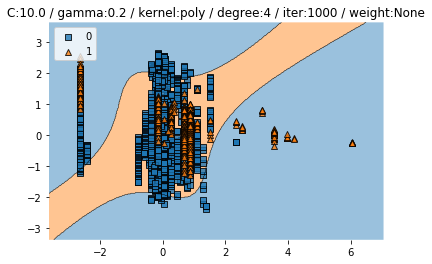

Train CV accuracy scores: [0.3590604  0.40985442 0.9462486  0.59014558 0.55767077]
Train CV accuracy: 0.573 +/- 0.206
Train CV f1 scores: [0.33679179 0.40985442 0.94635262 0.61963451 0.58490921]
Train CV f1: 0.580 +/- 0.212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3865313653136531
Test f1 :  0.5033607169529499


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


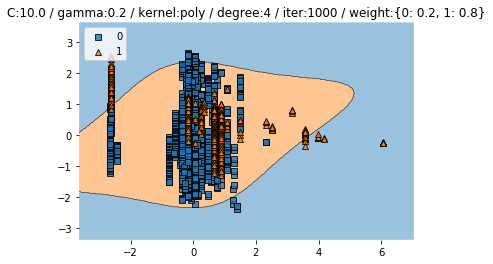

Train CV accuracy scores: [0.8557047  0.52631579 0.45128779 0.3225084  0.35386338]
Train CV accuracy: 0.502 +/- 0.191
Train CV f1 scores: [0.86661578 0.55218005 0.46039948 0.27803878 0.32672692]
Train CV f1: 0.497 +/- 0.209


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.518450184501845
Test f1 :  0.5650000000000001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


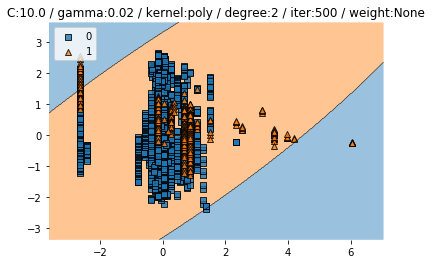

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


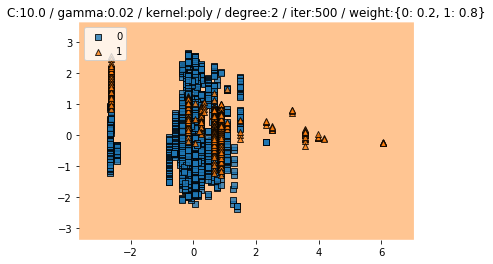

Train CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Train CV accuracy: 0.209 +/- 0.001
Train CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


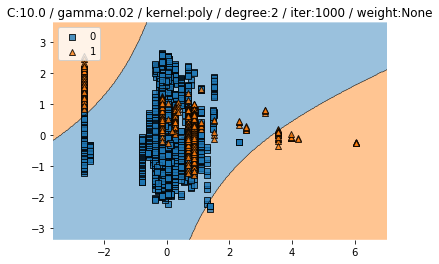

Train CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Train CV accuracy: 0.823 +/- 0.011
Train CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Train CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7435424354243543
Test f1 :  0.35046728971962615


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


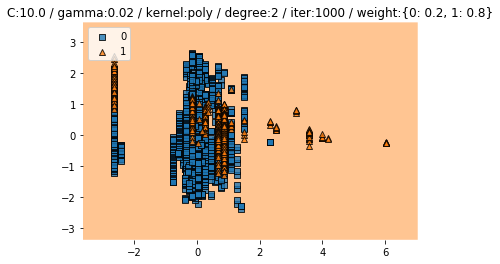

Train CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Train CV accuracy: 0.208 +/- 0.001
Train CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Train CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


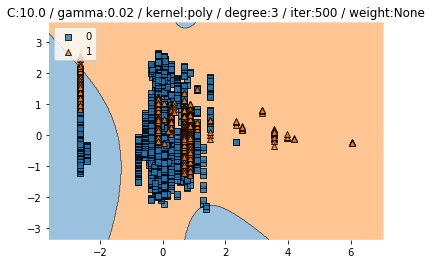

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


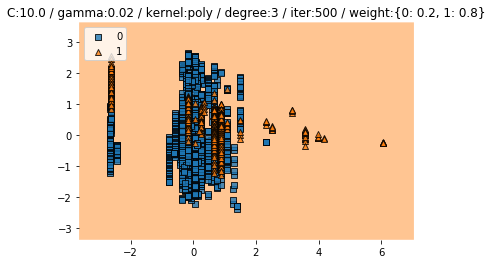

Train CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Train CV accuracy: 0.209 +/- 0.001
Train CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


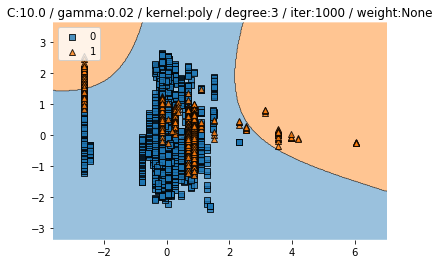

Train CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Train CV accuracy: 0.823 +/- 0.011
Train CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Train CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7435424354243543
Test f1 :  0.35046728971962615


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


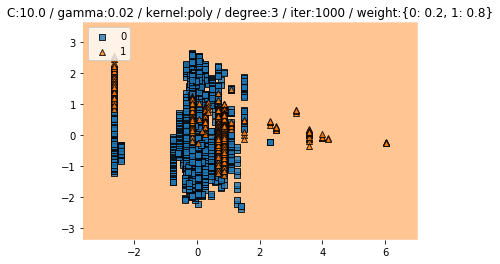

Train CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Train CV accuracy: 0.208 +/- 0.001
Train CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Train CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


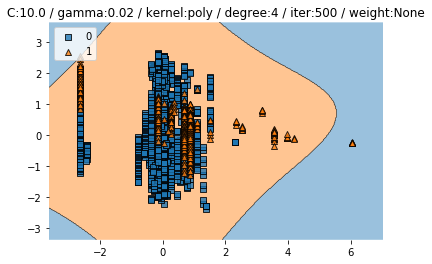

Train CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Train CV accuracy: 0.210 +/- 0.001
Train CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


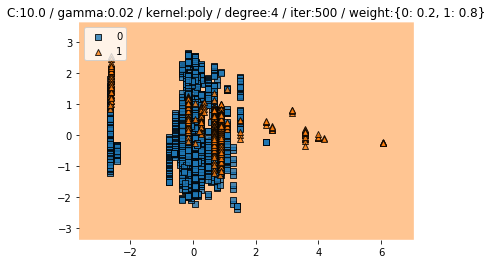

Train CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Train CV accuracy: 0.209 +/- 0.001
Train CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Train CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


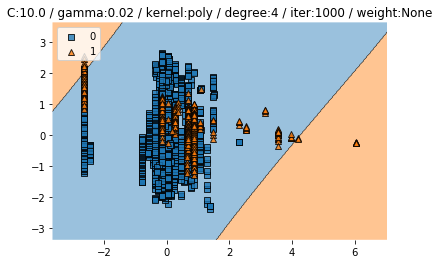

Train CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Train CV accuracy: 0.823 +/- 0.011
Train CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Train CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7435424354243543
Test f1 :  0.35046728971962615


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


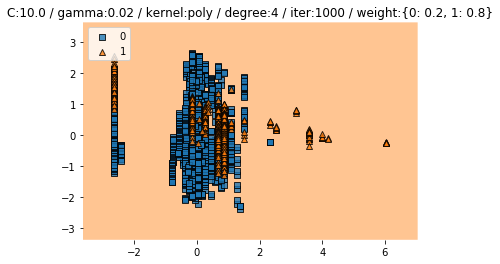

Train CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Train CV accuracy: 0.208 +/- 0.001
Train CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Train CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


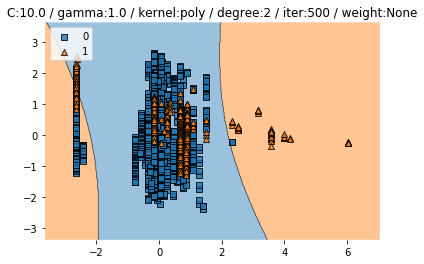

Train CV accuracy scores: [0.35011186 0.79507279 0.2743561  0.27771557 0.84546473]
Train CV accuracy: 0.509 +/- 0.256
Train CV f1 scores: [0.34274136 0.7429095  0.20567843 0.20284343 0.81369003]
Train CV f1: 0.462 +/- 0.264


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.4818049490538573


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


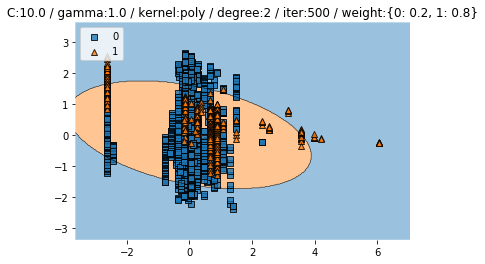

Train CV accuracy scores: [0.401566   0.39753639 0.31802912 0.20604703 0.21948488]
Train CV accuracy: 0.309 +/- 0.084
Train CV f1 scores: [0.40863971 0.39232997 0.26960048 0.07778324 0.09339199]
Train CV f1: 0.248 +/- 0.141


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5212177121771218
Test f1 :  0.5475152571926766


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


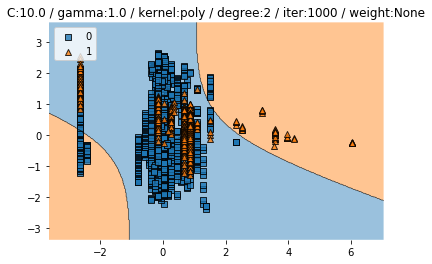

Train CV accuracy scores: [0.22595078 0.57446809 0.62486002 0.22732363 0.26427772]
Train CV accuracy: 0.383 +/- 0.178
Train CV f1 scores: [0.14444569 0.60583707 0.65411323 0.12152256 0.17884412]
Train CV f1: 0.341 +/- 0.237


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6964944649446494
Test f1 :  0.10354223433242507


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


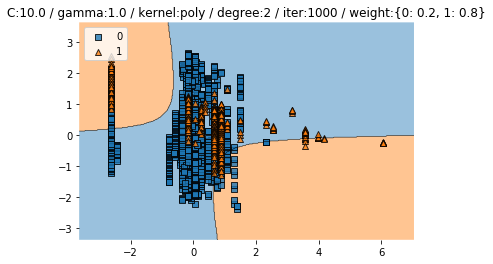

Train CV accuracy scores: [0.33668904 0.20156775 0.81634938 0.29227324 0.68645017]
Train CV accuracy: 0.467 +/- 0.240
Train CV f1 scores: [0.31669372 0.07063325 0.82674838 0.2387851  0.71484439]
Train CV f1: 0.434 +/- 0.289


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3459409594095941
Test f1 :  0.48511256354393606


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


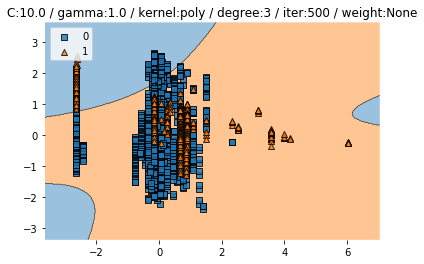

Train CV accuracy scores: [0.35011186 0.79507279 0.2743561  0.27771557 0.84546473]
Train CV accuracy: 0.509 +/- 0.256
Train CV f1 scores: [0.34274136 0.7429095  0.20567843 0.20284343 0.81369003]
Train CV f1: 0.462 +/- 0.264


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.4818049490538573


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


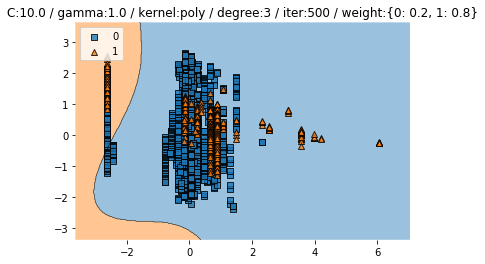

Train CV accuracy scores: [0.401566   0.39753639 0.31802912 0.20604703 0.21948488]
Train CV accuracy: 0.309 +/- 0.084
Train CV f1 scores: [0.40863971 0.39232997 0.26960048 0.07778324 0.09339199]
Train CV f1: 0.248 +/- 0.141


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5212177121771218
Test f1 :  0.5475152571926766


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


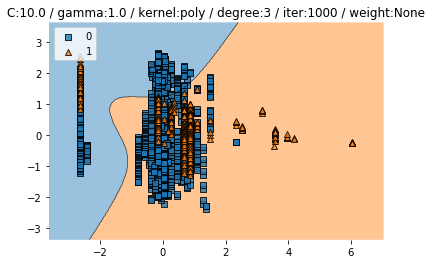

Train CV accuracy scores: [0.22595078 0.57446809 0.62486002 0.22732363 0.26427772]
Train CV accuracy: 0.383 +/- 0.178
Train CV f1 scores: [0.14444569 0.60583707 0.65411323 0.12152256 0.17884412]
Train CV f1: 0.341 +/- 0.237


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6964944649446494
Test f1 :  0.10354223433242507


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


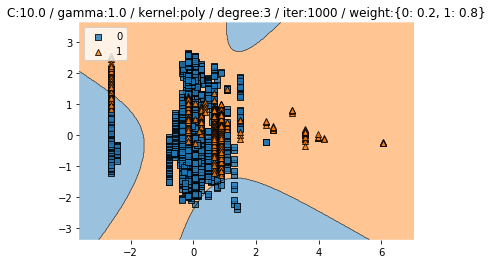

Train CV accuracy scores: [0.33668904 0.20156775 0.81634938 0.29227324 0.68645017]
Train CV accuracy: 0.467 +/- 0.240
Train CV f1 scores: [0.31669372 0.07063325 0.82674838 0.2387851  0.71484439]
Train CV f1: 0.434 +/- 0.289


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3459409594095941
Test f1 :  0.48511256354393606


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


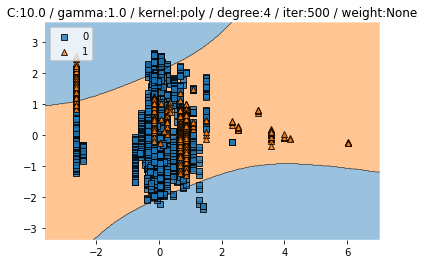

Train CV accuracy scores: [0.35011186 0.79507279 0.2743561  0.27771557 0.84546473]
Train CV accuracy: 0.509 +/- 0.256
Train CV f1 scores: [0.34274136 0.7429095  0.20567843 0.20284343 0.81369003]
Train CV f1: 0.462 +/- 0.264


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.4818049490538573


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


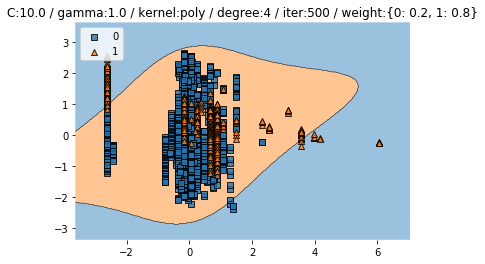

Train CV accuracy scores: [0.401566   0.39753639 0.31802912 0.20604703 0.21948488]
Train CV accuracy: 0.309 +/- 0.084
Train CV f1 scores: [0.40863971 0.39232997 0.26960048 0.07778324 0.09339199]
Train CV f1: 0.248 +/- 0.141


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5212177121771218
Test f1 :  0.5475152571926766


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


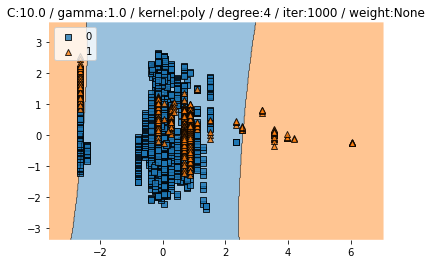

Train CV accuracy scores: [0.22595078 0.57446809 0.62486002 0.22732363 0.26427772]
Train CV accuracy: 0.383 +/- 0.178
Train CV f1 scores: [0.14444569 0.60583707 0.65411323 0.12152256 0.17884412]
Train CV f1: 0.341 +/- 0.237


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6964944649446494
Test f1 :  0.10354223433242507


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


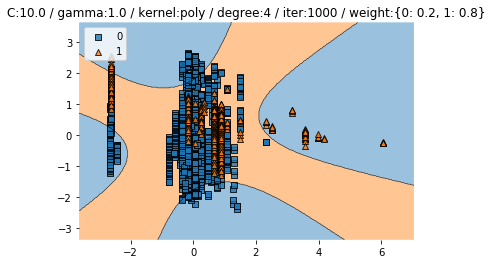

Train CV accuracy scores: [0.33668904 0.20156775 0.81634938 0.29227324 0.68645017]
Train CV accuracy: 0.467 +/- 0.240
Train CV f1 scores: [0.31669372 0.07063325 0.82674838 0.2387851  0.71484439]
Train CV f1: 0.434 +/- 0.289


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3459409594095941
Test f1 :  0.48511256354393606


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


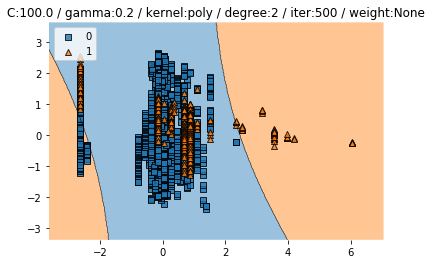

Train CV accuracy scores: [0.31991051 0.33146697 0.33930571 0.25419933 0.85106383]
Train CV accuracy: 0.419 +/- 0.218
Train CV f1 scores: [0.27664193 0.29792332 0.30995717 0.16521175 0.82869141]
Train CV f1: 0.376 +/- 0.232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8468634686346863
Test f1 :  0.7688022284122563


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


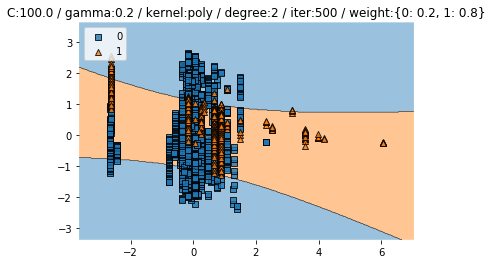

Train CV accuracy scores: [0.84228188 0.21052632 0.34378499 0.20156775 0.25083987]
Train CV accuracy: 0.370 +/- 0.242
Train CV f1 scores: [0.81297351 0.08679728 0.31140457 0.07063325 0.15411934]
Train CV f1: 0.287 +/- 0.276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.47424135497529996


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


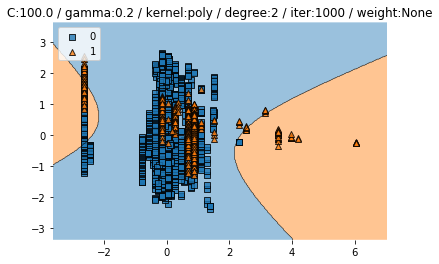

Train CV accuracy scores: [0.38926174 0.28443449 0.36618141 0.55879059 0.20380739]
Train CV accuracy: 0.360 +/- 0.119
Train CV f1 scores: [0.38106593 0.24613203 0.34407165 0.58828841 0.07128519]
Train CV f1: 0.326 +/- 0.169


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4474169741697417
Test f1 :  0.5242255758538522


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


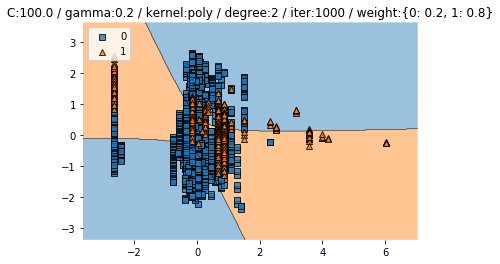

Train CV accuracy scores: [0.75391499 0.28555431 0.2743561  0.24636058 0.20940649]
Train CV accuracy: 0.354 +/- 0.202
Train CV f1 scores: [0.77639877 0.2248646  0.19839624 0.15562929 0.07290448]
Train CV f1: 0.286 +/- 0.251


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39114391143911437
Test f1 :  0.5030120481927711


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


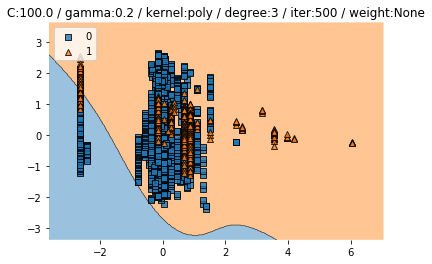

Train CV accuracy scores: [0.31991051 0.33146697 0.33930571 0.25419933 0.85106383]
Train CV accuracy: 0.419 +/- 0.218
Train CV f1 scores: [0.27664193 0.29792332 0.30995717 0.16521175 0.82869141]
Train CV f1: 0.376 +/- 0.232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8468634686346863
Test f1 :  0.7688022284122563


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


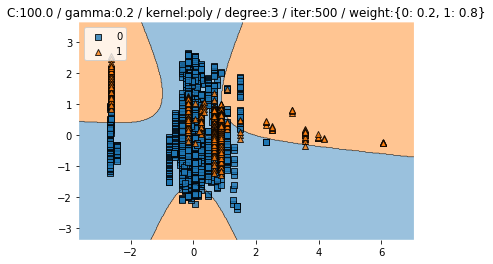

Train CV accuracy scores: [0.84228188 0.21052632 0.34378499 0.20156775 0.25083987]
Train CV accuracy: 0.370 +/- 0.242
Train CV f1 scores: [0.81297351 0.08679728 0.31140457 0.07063325 0.15411934]
Train CV f1: 0.287 +/- 0.276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.47424135497529996


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


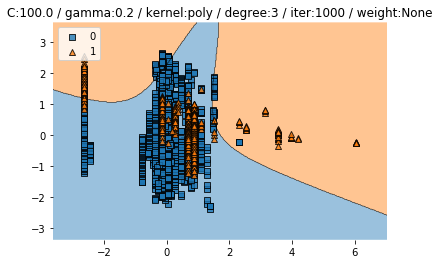

Train CV accuracy scores: [0.38926174 0.28443449 0.36618141 0.55879059 0.20380739]
Train CV accuracy: 0.360 +/- 0.119
Train CV f1 scores: [0.38106593 0.24613203 0.34407165 0.58828841 0.07128519]
Train CV f1: 0.326 +/- 0.169


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4474169741697417
Test f1 :  0.5242255758538522


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


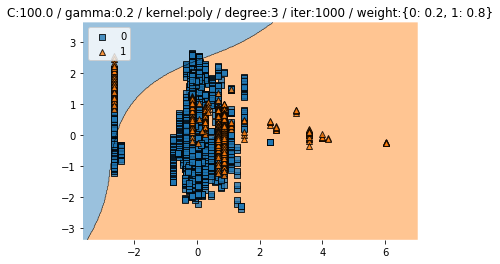

Train CV accuracy scores: [0.75391499 0.28555431 0.2743561  0.24636058 0.20940649]
Train CV accuracy: 0.354 +/- 0.202
Train CV f1 scores: [0.77639877 0.2248646  0.19839624 0.15562929 0.07290448]
Train CV f1: 0.286 +/- 0.251


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39114391143911437
Test f1 :  0.5030120481927711


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


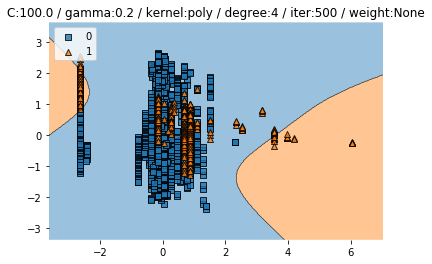

Train CV accuracy scores: [0.31991051 0.33146697 0.33930571 0.25419933 0.85106383]
Train CV accuracy: 0.419 +/- 0.218
Train CV f1 scores: [0.27664193 0.29792332 0.30995717 0.16521175 0.82869141]
Train CV f1: 0.376 +/- 0.232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8468634686346863
Test f1 :  0.7688022284122563


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


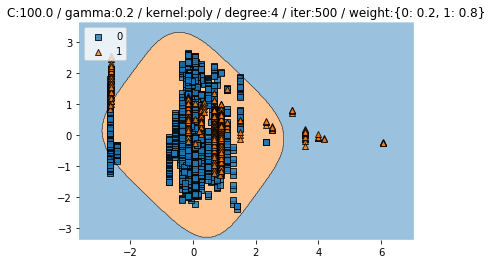

Train CV accuracy scores: [0.84228188 0.21052632 0.34378499 0.20156775 0.25083987]
Train CV accuracy: 0.370 +/- 0.242
Train CV f1 scores: [0.81297351 0.08679728 0.31140457 0.07063325 0.15411934]
Train CV f1: 0.287 +/- 0.276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.47424135497529996


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


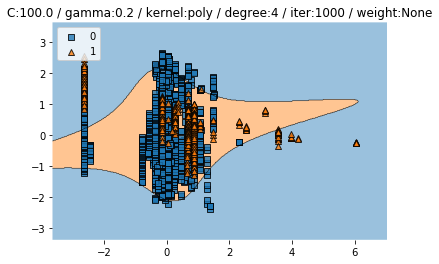

Train CV accuracy scores: [0.38926174 0.28443449 0.36618141 0.55879059 0.20380739]
Train CV accuracy: 0.360 +/- 0.119
Train CV f1 scores: [0.38106593 0.24613203 0.34407165 0.58828841 0.07128519]
Train CV f1: 0.326 +/- 0.169


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4474169741697417
Test f1 :  0.5242255758538522


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


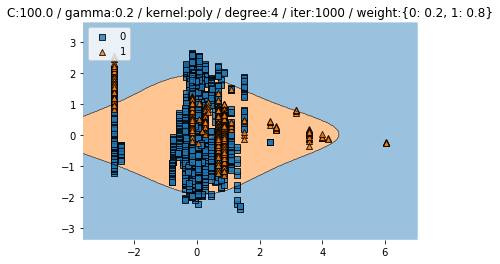

Train CV accuracy scores: [0.75391499 0.28555431 0.2743561  0.24636058 0.20940649]
Train CV accuracy: 0.354 +/- 0.202
Train CV f1 scores: [0.77639877 0.2248646  0.19839624 0.15562929 0.07290448]
Train CV f1: 0.286 +/- 0.251


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39114391143911437
Test f1 :  0.5030120481927711


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


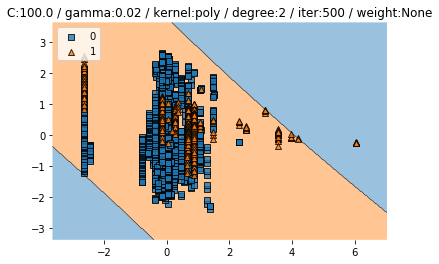

Train CV accuracy scores: [0.2147651  0.33482643 0.21164614 0.20940649 0.74356103]
Train CV accuracy: 0.343 +/- 0.206
Train CV f1 scores: [0.08838716 0.29978177 0.07553082 0.07290448 0.76723149]
Train CV f1: 0.261 +/- 0.267


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


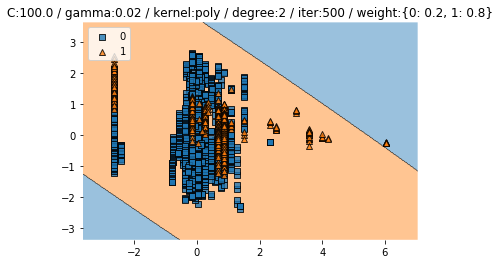

Train CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Train CV accuracy: 0.211 +/- 0.006
Train CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Train CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


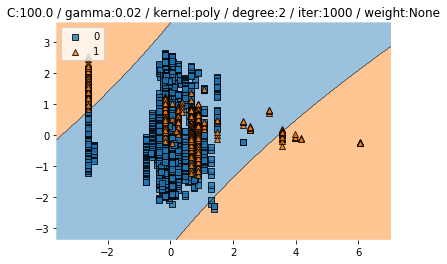

Train CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.88913774]
Train CV accuracy: 0.908 +/- 0.025
Train CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.88421479]
Train CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8477859778597786
Test f1 :  0.6927374301675977


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


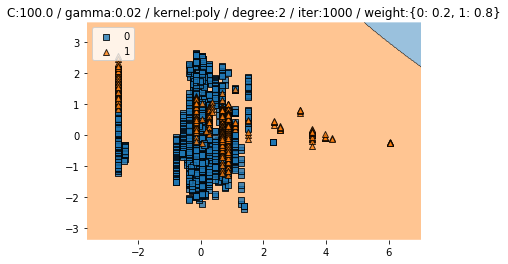

Train CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Train CV accuracy: 0.418 +/- 0.098
Train CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Train CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


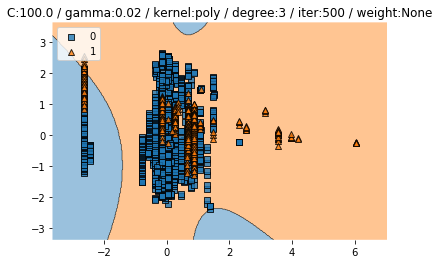

Train CV accuracy scores: [0.2147651  0.33482643 0.21164614 0.20940649 0.74356103]
Train CV accuracy: 0.343 +/- 0.206
Train CV f1 scores: [0.08838716 0.29978177 0.07553082 0.07290448 0.76723149]
Train CV f1: 0.261 +/- 0.267


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


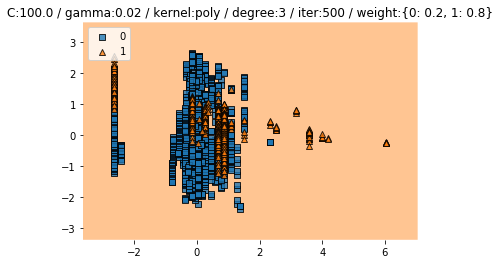

Train CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Train CV accuracy: 0.211 +/- 0.006
Train CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Train CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


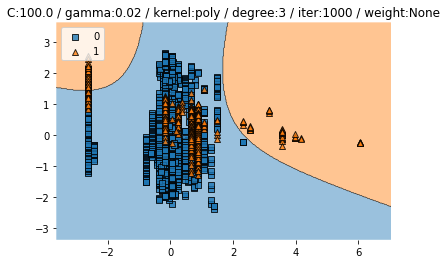

Train CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.88913774]
Train CV accuracy: 0.908 +/- 0.025
Train CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.88421479]
Train CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8477859778597786
Test f1 :  0.6927374301675977


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


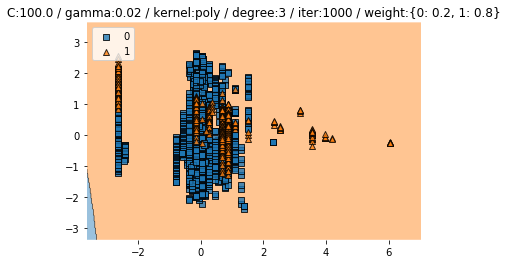

Train CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Train CV accuracy: 0.418 +/- 0.098
Train CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Train CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


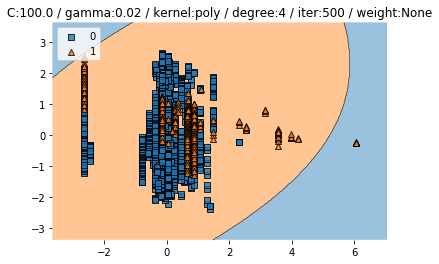

Train CV accuracy scores: [0.2147651  0.33482643 0.21164614 0.20940649 0.74356103]
Train CV accuracy: 0.343 +/- 0.206
Train CV f1 scores: [0.08838716 0.29978177 0.07553082 0.07290448 0.76723149]
Train CV f1: 0.261 +/- 0.267


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


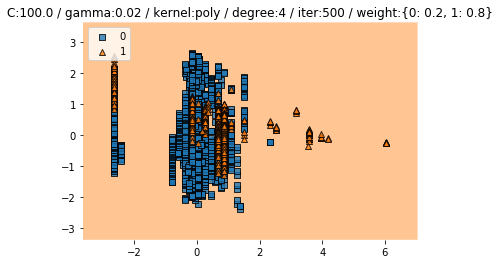

Train CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Train CV accuracy: 0.211 +/- 0.006
Train CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Train CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


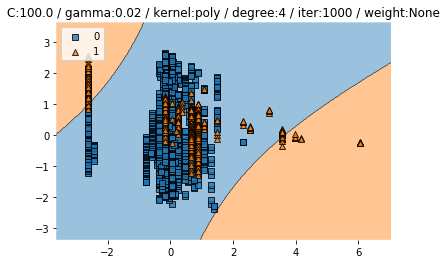

Train CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.88913774]
Train CV accuracy: 0.908 +/- 0.025
Train CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.88421479]
Train CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8477859778597786
Test f1 :  0.6927374301675977


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


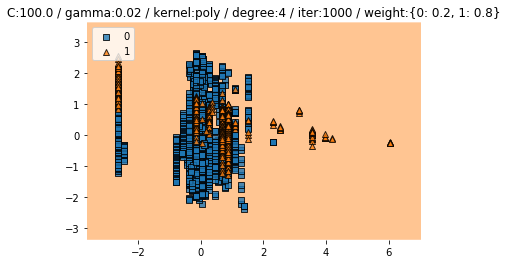

Train CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Train CV accuracy: 0.418 +/- 0.098
Train CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Train CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


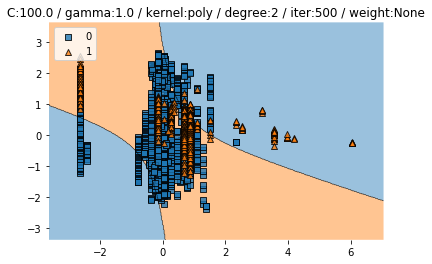

Train CV accuracy scores: [0.35011186 0.79507279 0.24300112 0.27995521 0.84546473]
Train CV accuracy: 0.503 +/- 0.262
Train CV f1 scores: [0.34274136 0.7429095  0.13934674 0.20966558 0.81369003]
Train CV f1: 0.450 +/- 0.277


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4769372693726937
Test f1 :  0.5317919075144508


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


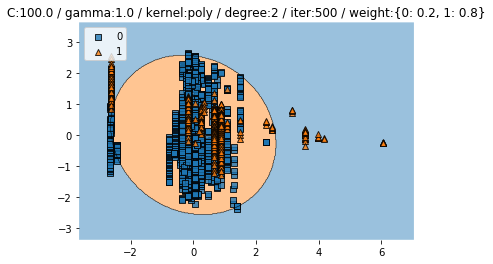

Train CV accuracy scores: [0.35011186 0.79507279 0.22284434 0.23068309 0.84546473]
Train CV accuracy: 0.489 +/- 0.275
Train CV f1 scores: [0.34274136 0.7429095  0.10011273 0.1262106  0.81369003]
Train CV f1: 0.425 +/- 0.301


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6042435424354243
Test f1 :  0.6096451319381255


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


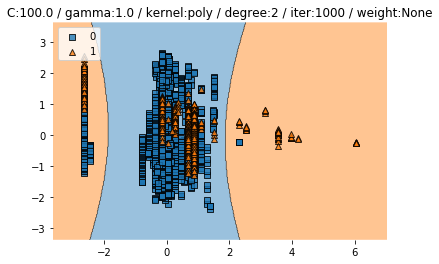

Train CV accuracy scores: [0.25391499 0.57446809 0.81075028 0.20604703 0.28219485]
Train CV accuracy: 0.425 +/- 0.232
Train CV f1 scores: [0.17762706 0.60583707 0.82604319 0.09097144 0.21068813]
Train CV f1: 0.382 +/- 0.284


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


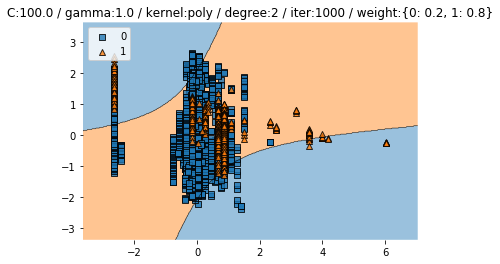

Train CV accuracy scores: [0.25391499 0.57446809 0.28331467 0.20492721 0.28219485]
Train CV accuracy: 0.320 +/- 0.130
Train CV f1 scores: [0.17762706 0.60583707 0.21119908 0.08127201 0.21068813]
Train CV f1: 0.257 +/- 0.181


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7795202952029521
Test f1 :  0.6900129701686123


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


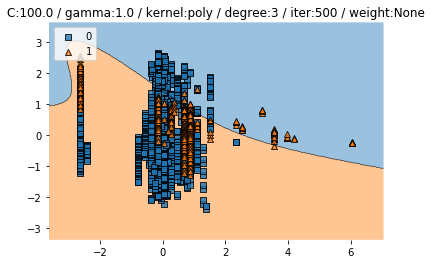

Train CV accuracy scores: [0.35011186 0.79507279 0.24300112 0.27995521 0.84546473]
Train CV accuracy: 0.503 +/- 0.262
Train CV f1 scores: [0.34274136 0.7429095  0.13934674 0.20966558 0.81369003]
Train CV f1: 0.450 +/- 0.277


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4769372693726937
Test f1 :  0.5317919075144508


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


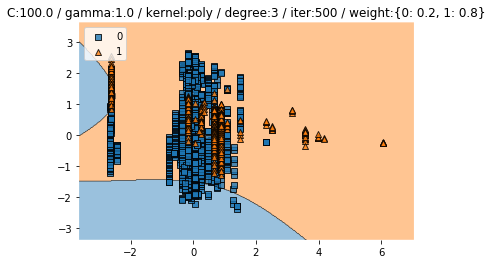

Train CV accuracy scores: [0.35011186 0.79507279 0.22284434 0.23068309 0.84546473]
Train CV accuracy: 0.489 +/- 0.275
Train CV f1 scores: [0.34274136 0.7429095  0.10011273 0.1262106  0.81369003]
Train CV f1: 0.425 +/- 0.301


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6042435424354243
Test f1 :  0.6096451319381255


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


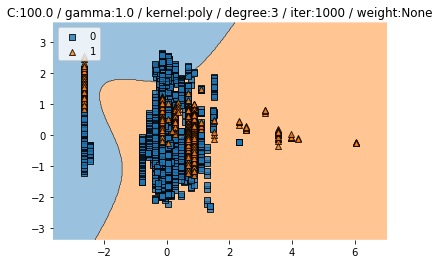

Train CV accuracy scores: [0.25391499 0.57446809 0.81075028 0.20604703 0.28219485]
Train CV accuracy: 0.425 +/- 0.232
Train CV f1 scores: [0.17762706 0.60583707 0.82604319 0.09097144 0.21068813]
Train CV f1: 0.382 +/- 0.284


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


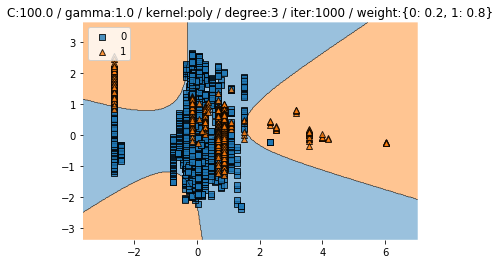

Train CV accuracy scores: [0.25391499 0.57446809 0.28331467 0.20492721 0.28219485]
Train CV accuracy: 0.320 +/- 0.130
Train CV f1 scores: [0.17762706 0.60583707 0.21119908 0.08127201 0.21068813]
Train CV f1: 0.257 +/- 0.181


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7795202952029521
Test f1 :  0.6900129701686123


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


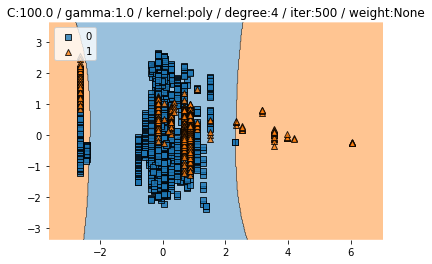

Train CV accuracy scores: [0.35011186 0.79507279 0.24300112 0.27995521 0.84546473]
Train CV accuracy: 0.503 +/- 0.262
Train CV f1 scores: [0.34274136 0.7429095  0.13934674 0.20966558 0.81369003]
Train CV f1: 0.450 +/- 0.277


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4769372693726937
Test f1 :  0.5317919075144508


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


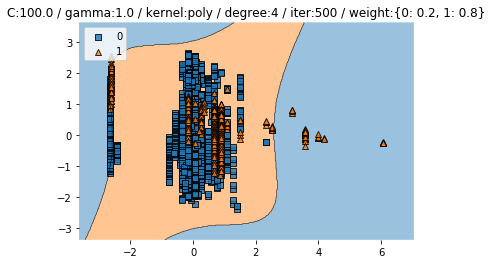

Train CV accuracy scores: [0.35011186 0.79507279 0.22284434 0.23068309 0.84546473]
Train CV accuracy: 0.489 +/- 0.275
Train CV f1 scores: [0.34274136 0.7429095  0.10011273 0.1262106  0.81369003]
Train CV f1: 0.425 +/- 0.301


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6042435424354243
Test f1 :  0.6096451319381255


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


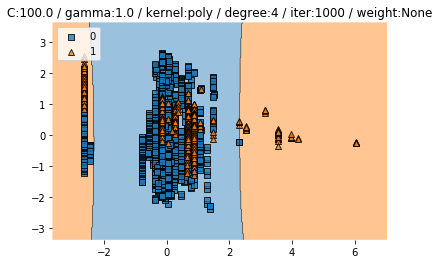

Train CV accuracy scores: [0.25391499 0.57446809 0.81075028 0.20604703 0.28219485]
Train CV accuracy: 0.425 +/- 0.232
Train CV f1 scores: [0.17762706 0.60583707 0.82604319 0.09097144 0.21068813]
Train CV f1: 0.382 +/- 0.284


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


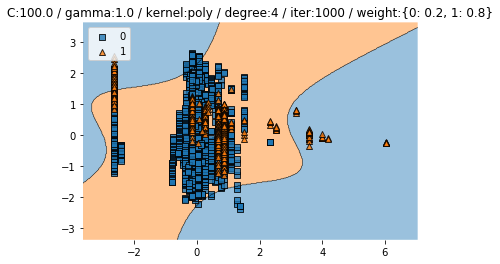

Train CV accuracy scores: [0.25391499 0.57446809 0.28331467 0.20492721 0.28219485]
Train CV accuracy: 0.320 +/- 0.130
Train CV f1 scores: [0.17762706 0.60583707 0.21119908 0.08127201 0.21068813]
Train CV f1: 0.257 +/- 0.181


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7795202952029521
Test f1 :  0.6900129701686123
938.7239911556244 secs


In [12]:
# news poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
degree_range = [2, 3, 4]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "degree":degree, "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for degree in degree_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(1,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


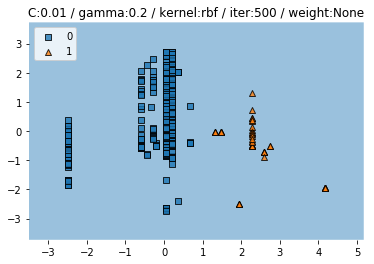

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


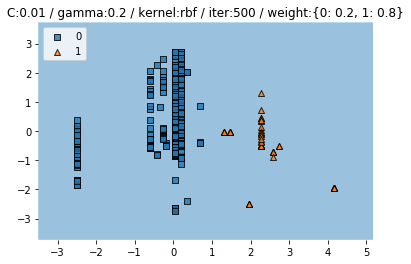

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


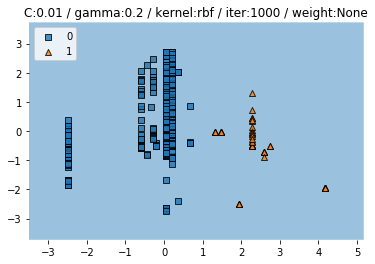

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


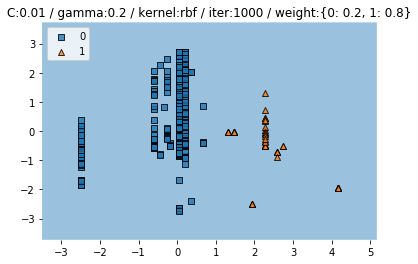

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


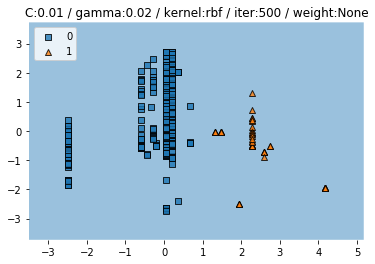

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


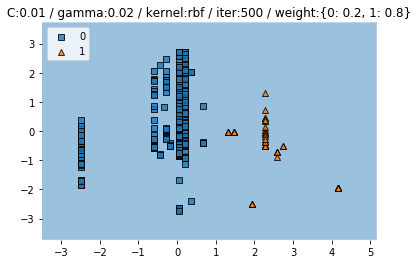

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


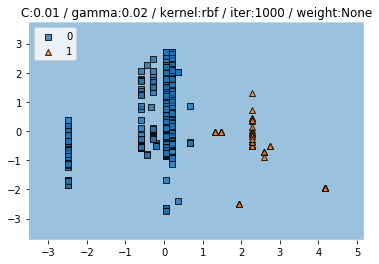

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


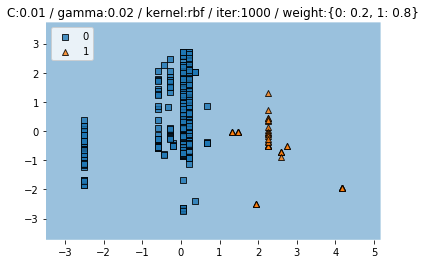

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


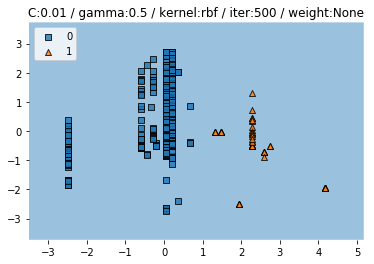

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


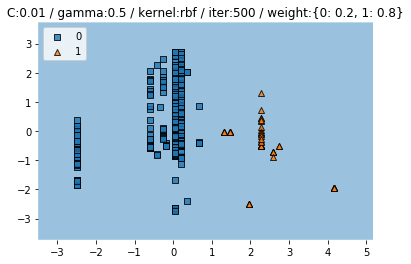

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


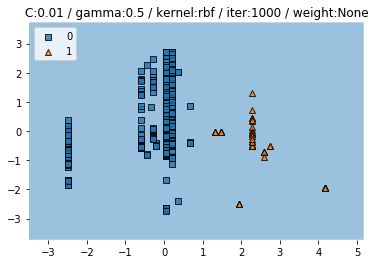

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


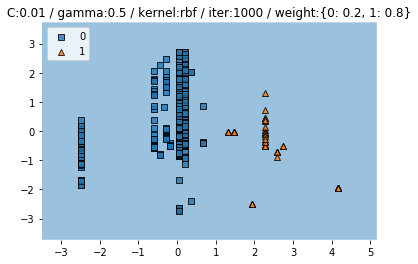

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


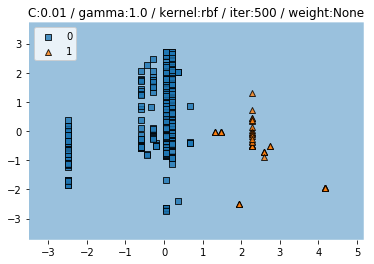

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


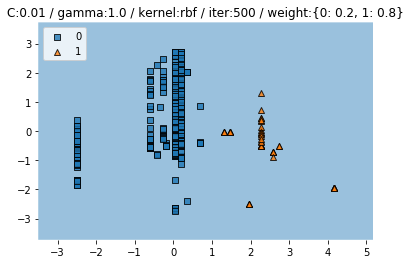

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


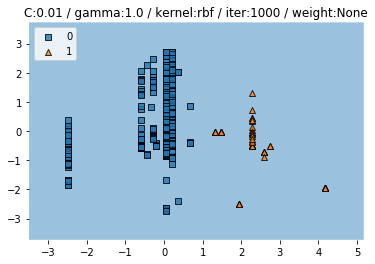

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


Test f1 :  0.0


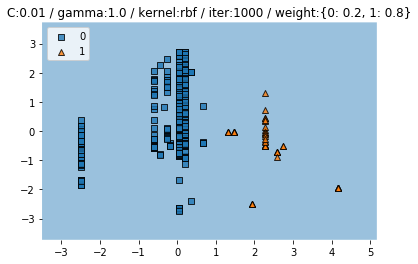

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


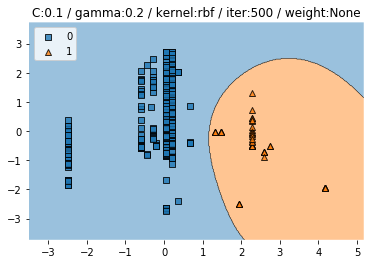

Train CV accuracy scores: [1.         0.97883598 1.         1.         0.95721925]
Train CV accuracy: 0.987 +/- 0.017
Train CV f1 scores: [1.         0.97683781 1.         1.         0.94547152]
Train CV f1: 0.984 +/- 0.021
Test accuracy :  1.0
Test f1 :  1.0


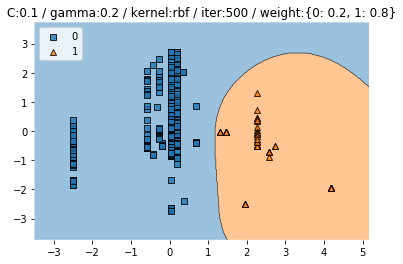

Train CV accuracy scores: [1.         0.97883598 1.         1.         0.95721925]
Train CV accuracy: 0.987 +/- 0.017
Train CV f1 scores: [1.         0.97683781 1.         1.         0.94547152]
Train CV f1: 0.984 +/- 0.021
Test accuracy :  1.0
Test f1 :  1.0


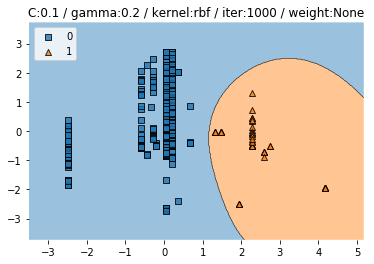

Train CV accuracy scores: [1.         0.97883598 1.         1.         0.95721925]
Train CV accuracy: 0.987 +/- 0.017
Train CV f1 scores: [1.         0.97683781 1.         1.         0.94547152]
Train CV f1: 0.984 +/- 0.021
Test accuracy :  1.0
Test f1 :  1.0


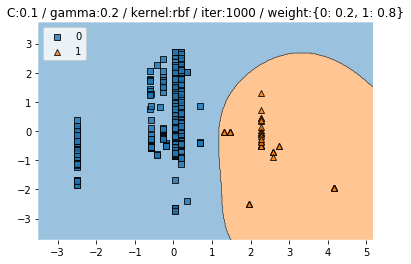

Train CV accuracy scores: [1.         0.97883598 1.         1.         0.95721925]
Train CV accuracy: 0.987 +/- 0.017
Train CV f1 scores: [1.         0.97683781 1.         1.         0.94547152]
Train CV f1: 0.984 +/- 0.021
Test accuracy :  1.0
Test f1 :  1.0


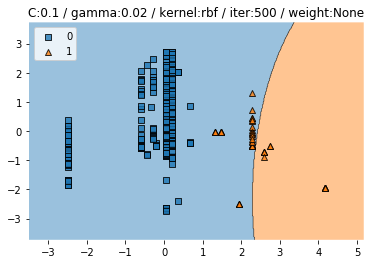

Train CV accuracy scores: [0.94179894 0.94708995 0.95212766 0.94680851 0.98395722]
Train CV accuracy: 0.954 +/- 0.015
Train CV f1 scores: [0.91805242 0.92892029 0.93614992 0.92537604 0.98275847]
Train CV f1: 0.938 +/- 0.023
Test accuracy :  0.9823529411764705
Test f1 :  0.7000000000000001


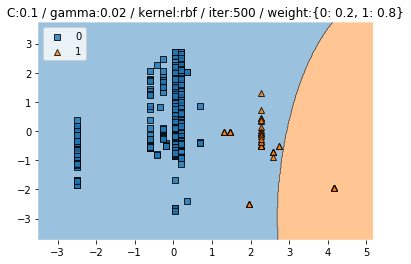

Train CV accuracy scores: [0.93650794 0.94708995 0.95212766 0.94680851 0.98395722]
Train CV accuracy: 0.953 +/- 0.016
Train CV f1 scores: [0.90580276 0.92892029 0.93614992 0.92537604 0.98275847]
Train CV f1: 0.936 +/- 0.026
Test accuracy :  0.9823529411764705
Test f1 :  0.7000000000000001


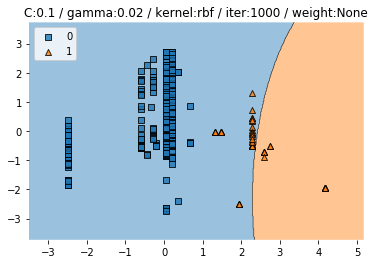

Train CV accuracy scores: [0.94179894 0.94708995 0.95212766 0.94680851 0.98395722]
Train CV accuracy: 0.954 +/- 0.015
Train CV f1 scores: [0.91805242 0.92892029 0.93614992 0.92537604 0.98275847]
Train CV f1: 0.938 +/- 0.023
Test accuracy :  0.9823529411764705
Test f1 :  0.7000000000000001


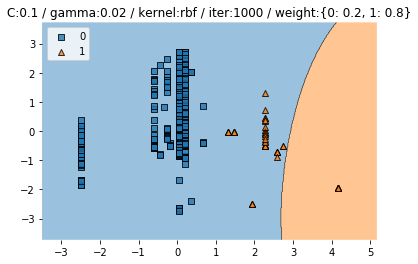

Train CV accuracy scores: [0.93650794 0.94708995 0.95212766 0.94680851 0.98395722]
Train CV accuracy: 0.953 +/- 0.016
Train CV f1 scores: [0.90580276 0.92892029 0.93614992 0.92537604 0.98275847]
Train CV f1: 0.936 +/- 0.026
Test accuracy :  0.9823529411764705
Test f1 :  0.7000000000000001


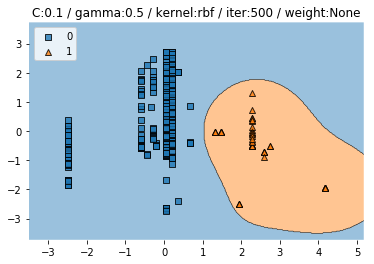

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 0.95721925]
Train CV accuracy: 0.986 +/- 0.016
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  0.94547152]
Train CV f1: 0.983 +/- 0.021
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


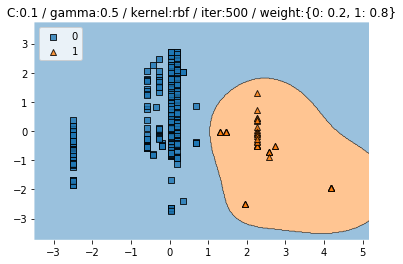

Train CV accuracy scores: [1.         0.96825397 1.         0.99468085 0.95721925]
Train CV accuracy: 0.984 +/- 0.018
Train CV f1 scores: [1.         0.96322751 1.         0.9945617  0.94547152]
Train CV f1: 0.981 +/- 0.022
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


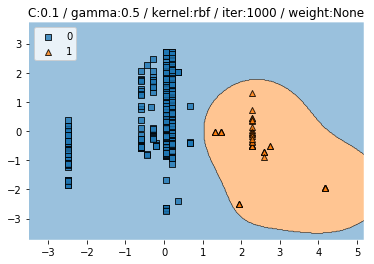

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 0.95721925]
Train CV accuracy: 0.986 +/- 0.016
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  0.94547152]
Train CV f1: 0.983 +/- 0.021
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


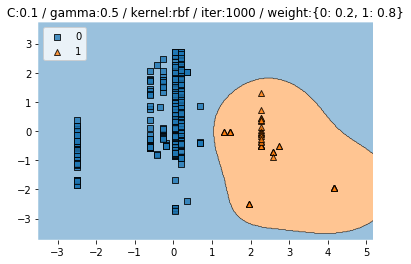

Train CV accuracy scores: [1.         0.96825397 1.         0.99468085 0.95721925]
Train CV accuracy: 0.984 +/- 0.018
Train CV f1 scores: [1.         0.96322751 1.         0.9945617  0.94547152]
Train CV f1: 0.981 +/- 0.022
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


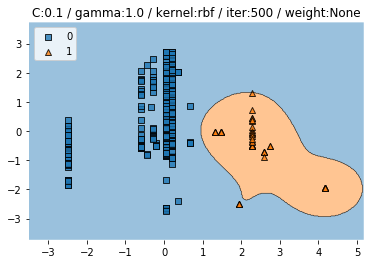

Train CV accuracy scores: [1.         0.97354497 0.99468085 0.99468085 0.95721925]
Train CV accuracy: 0.984 +/- 0.016
Train CV f1 scores: [1.         0.97024828 0.9945617  0.9945617  0.94547152]
Train CV f1: 0.981 +/- 0.021
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


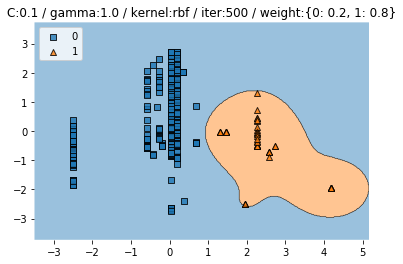

Train CV accuracy scores: [0.97354497 0.95767196 0.9893617  0.9893617  0.95721925]
Train CV accuracy: 0.973 +/- 0.014
Train CV f1 scores: [0.97024828 0.94755766 0.98885967 0.98885967 0.94547152]
Train CV f1: 0.968 +/- 0.019
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


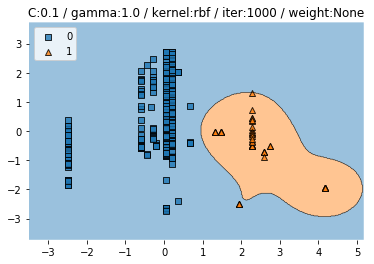

Train CV accuracy scores: [1.         0.97354497 0.99468085 0.99468085 0.95721925]
Train CV accuracy: 0.984 +/- 0.016
Train CV f1 scores: [1.         0.97024828 0.9945617  0.9945617  0.94547152]
Train CV f1: 0.981 +/- 0.021
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


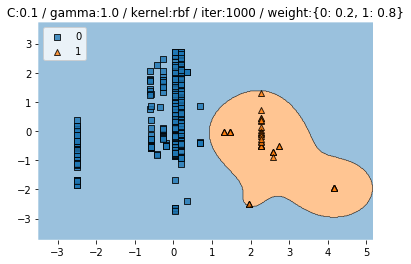

Train CV accuracy scores: [0.97354497 0.95767196 0.9893617  0.9893617  0.95721925]
Train CV accuracy: 0.973 +/- 0.014
Train CV f1 scores: [0.97024828 0.94755766 0.98885967 0.98885967 0.94547152]
Train CV f1: 0.968 +/- 0.019
Test accuracy :  0.9970588235294118
Test f1 :  0.9600000000000001


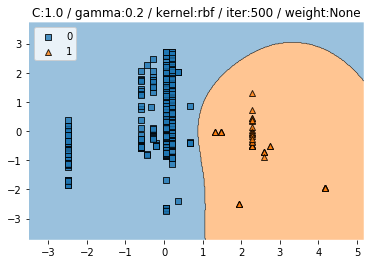

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


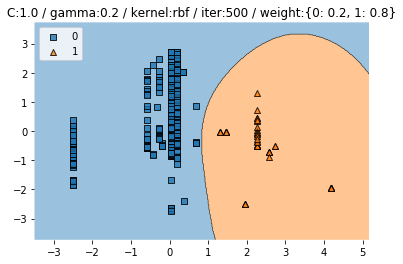

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


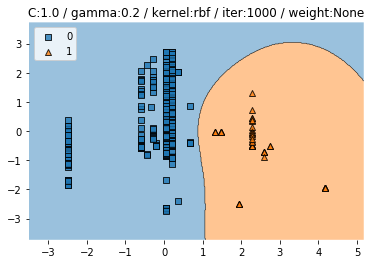

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


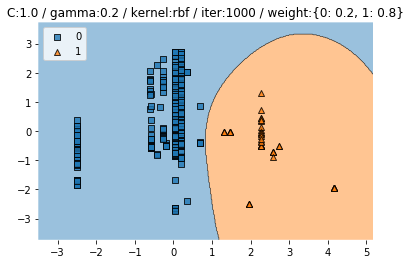

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


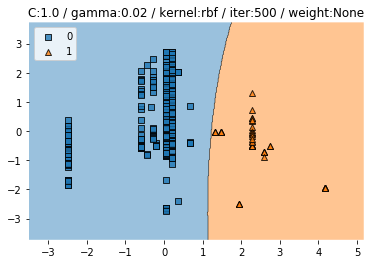

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


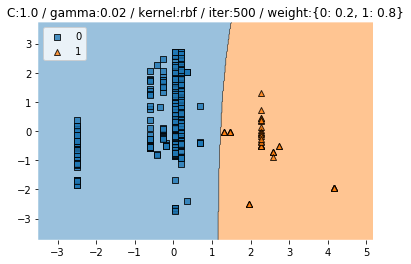

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


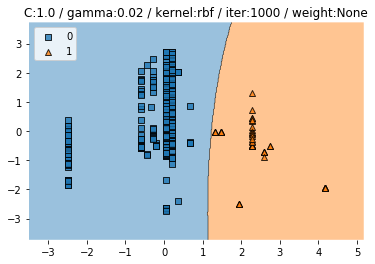

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


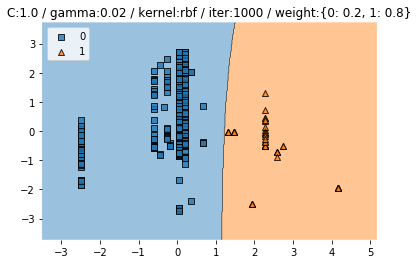

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


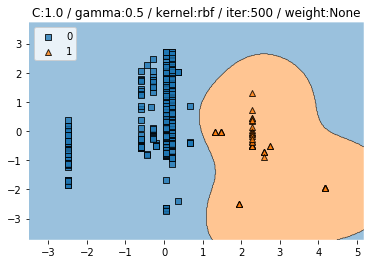

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


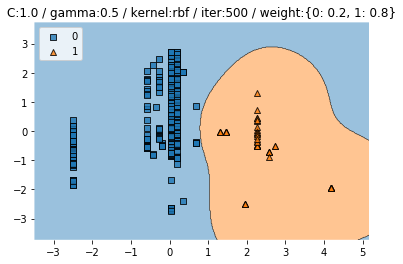

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


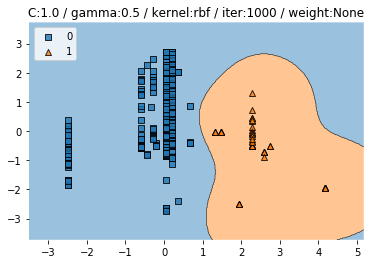

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


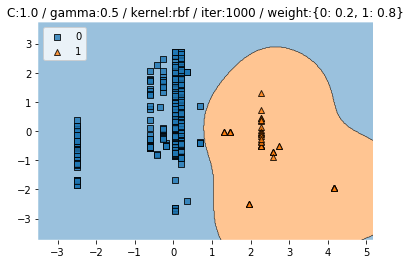

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


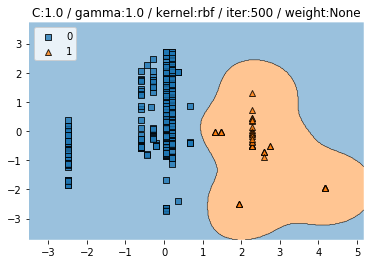

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


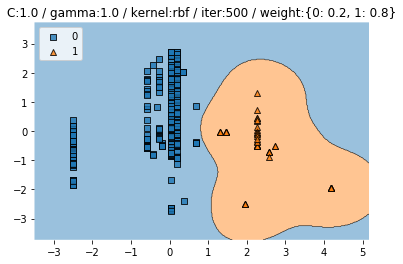

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


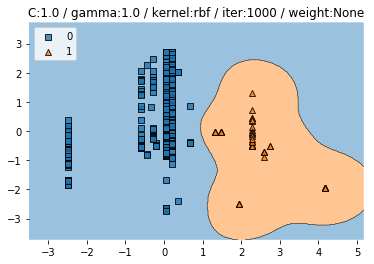

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


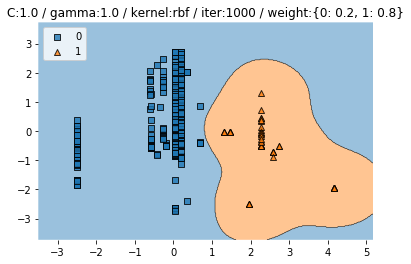

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


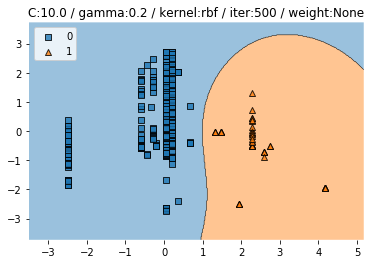

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


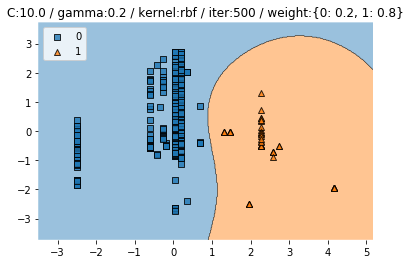

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


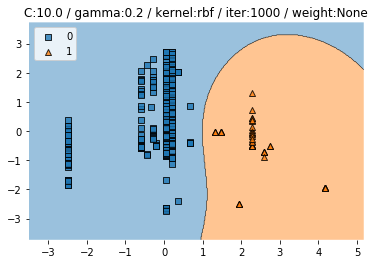

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


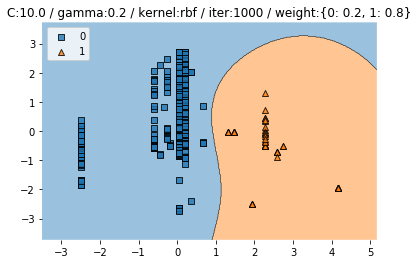

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


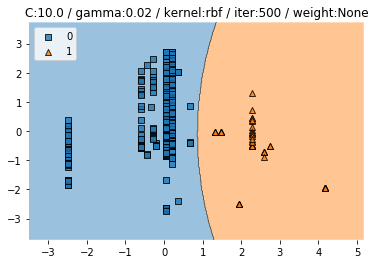

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


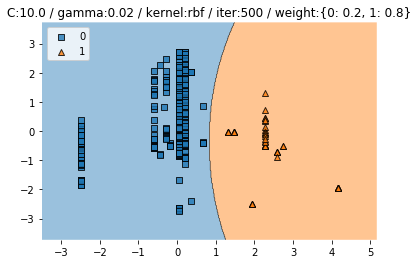

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


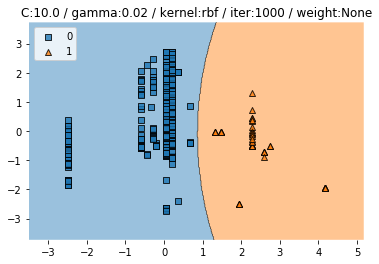

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


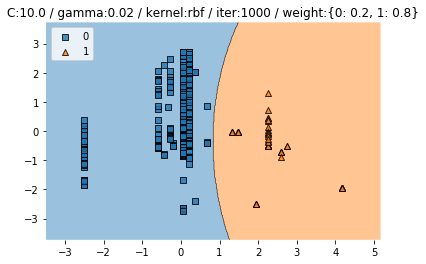

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


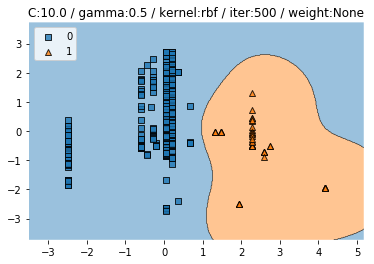

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


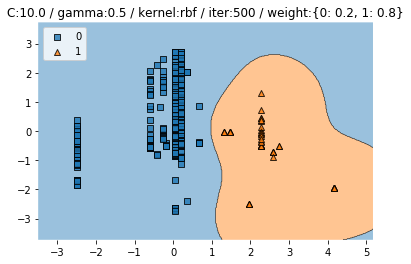

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


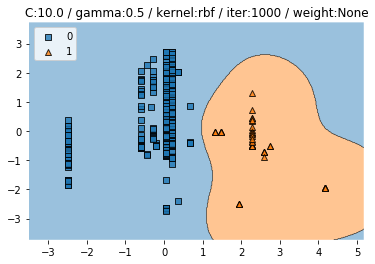

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


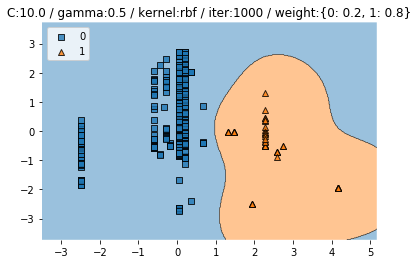

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


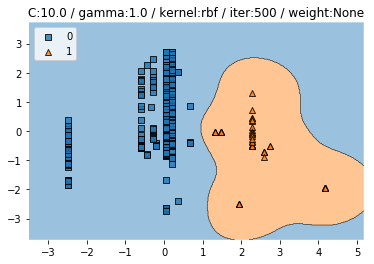

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


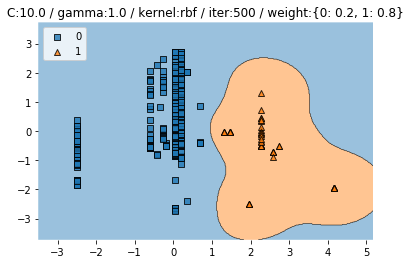

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


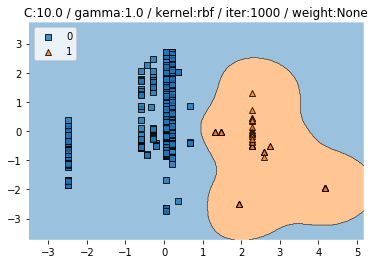

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


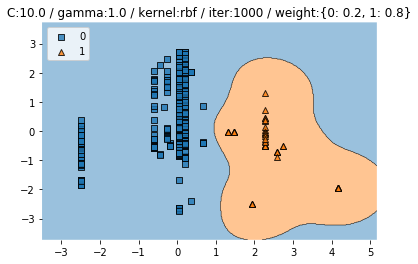

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


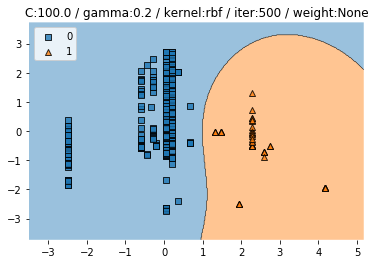

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


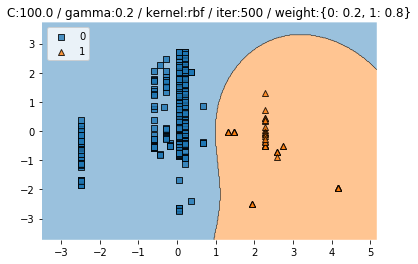

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


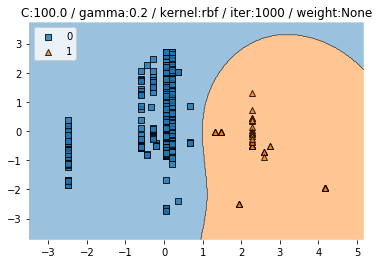

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


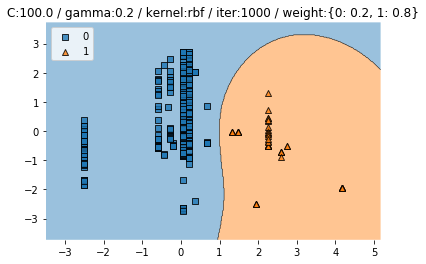

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


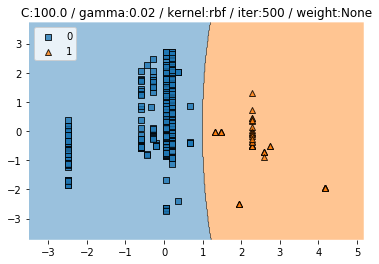

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


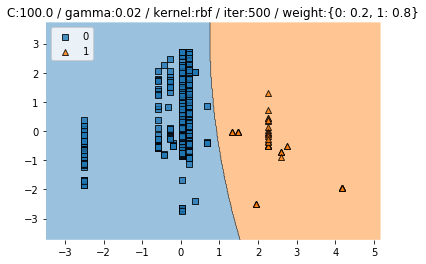

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


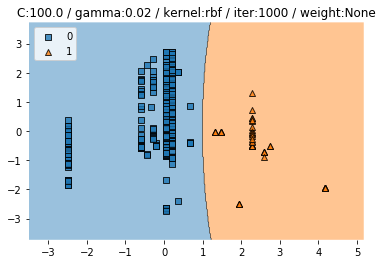

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


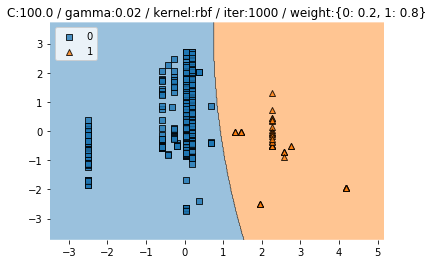

Train CV accuracy scores: [1. 1. 1. 1. 1.]
Train CV accuracy: 1.000 +/- 0.000
Train CV f1 scores: [1. 1. 1. 1. 1.]
Train CV f1: 1.000 +/- 0.000
Test accuracy :  1.0
Test f1 :  1.0


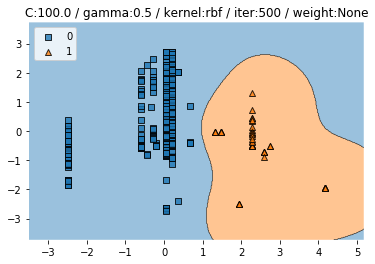

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


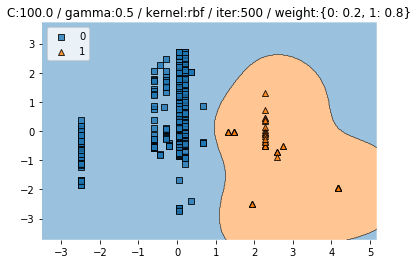

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


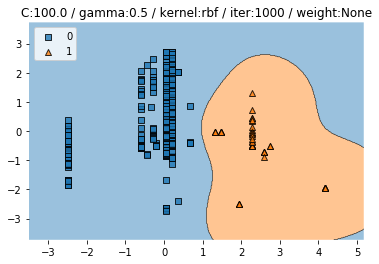

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


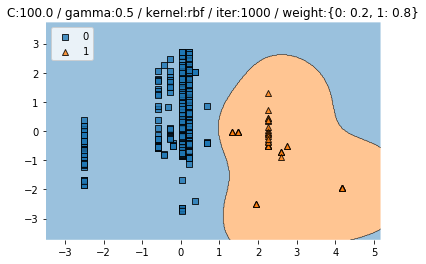

Train CV accuracy scores: [1.         0.97883598 1.         1.         1.        ]
Train CV accuracy: 0.996 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         1.         1.        ]
Train CV f1: 0.995 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


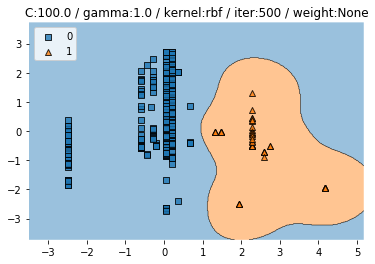

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


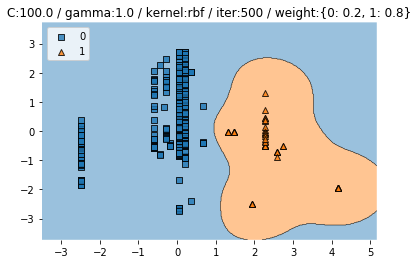

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


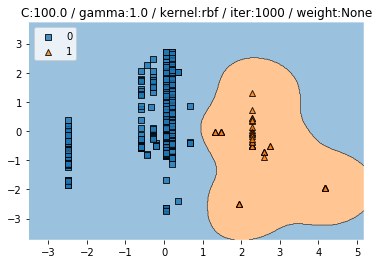

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


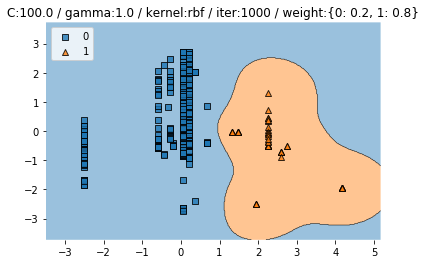

Train CV accuracy scores: [1.         0.97883598 1.         0.99468085 1.        ]
Train CV accuracy: 0.995 +/- 0.008
Train CV f1 scores: [1.         0.97683781 1.         0.9945617  1.        ]
Train CV f1: 0.994 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0
127.45387744903564 secs


In [17]:
# news title rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(2,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

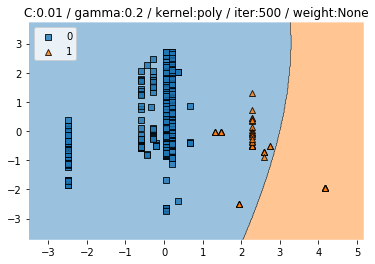

Train CV accuracy scores: [0.98941799 0.96825397 0.99468085 0.99468085 0.98395722]
Train CV accuracy: 0.986 +/- 0.010
Train CV f1 scores: [0.98896671 0.96322751 0.9945617  0.9945617  0.98275847]
Train CV f1: 0.985 +/- 0.012
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


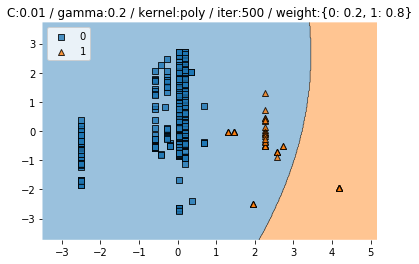

Train CV accuracy scores: [0.98412698 0.96825397 0.9787234  0.9893617  0.98395722]
Train CV accuracy: 0.981 +/- 0.007
Train CV f1 scores: [0.98305989 0.96322751 0.9764782  0.98885967 0.98275847]
Train CV f1: 0.979 +/- 0.009
Test accuracy :  0.9882352941176471
Test f1 :  0.8181818181818181


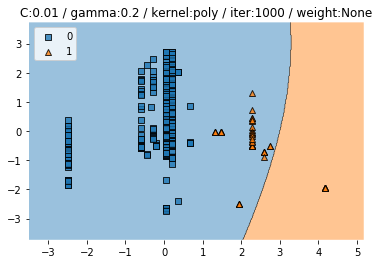

Train CV accuracy scores: [0.98941799 0.96825397 0.99468085 0.99468085 0.98395722]
Train CV accuracy: 0.986 +/- 0.010
Train CV f1 scores: [0.98896671 0.96322751 0.9945617  0.9945617  0.98275847]
Train CV f1: 0.985 +/- 0.012
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


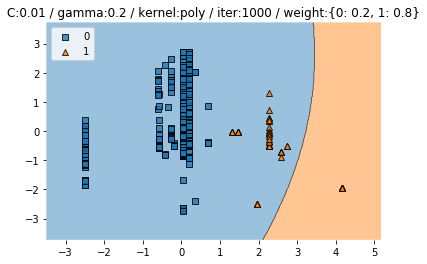

Train CV accuracy scores: [0.98412698 0.96825397 0.9787234  0.9893617  0.98395722]
Train CV accuracy: 0.981 +/- 0.007
Train CV f1 scores: [0.98305989 0.96322751 0.9764782  0.98885967 0.98275847]
Train CV f1: 0.979 +/- 0.009
Test accuracy :  0.9882352941176471
Test f1 :  0.8181818181818181


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


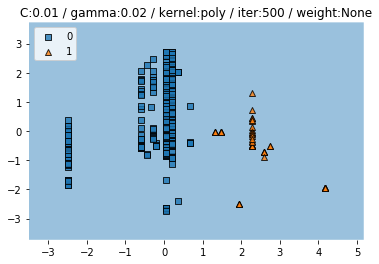

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


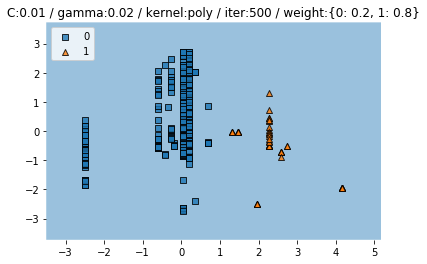

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


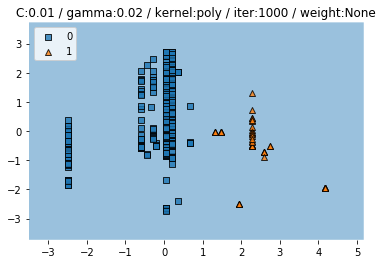

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


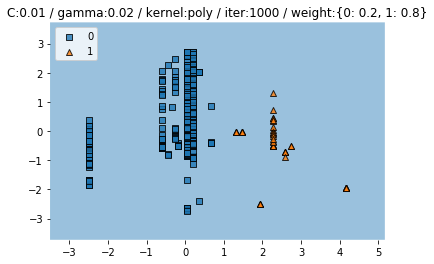

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


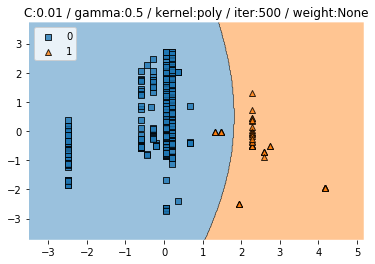

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  0.8695652173913044


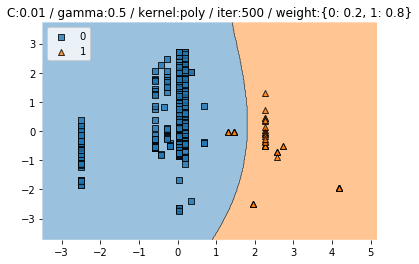

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


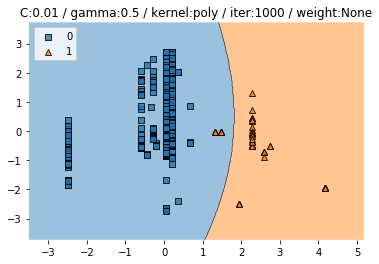

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


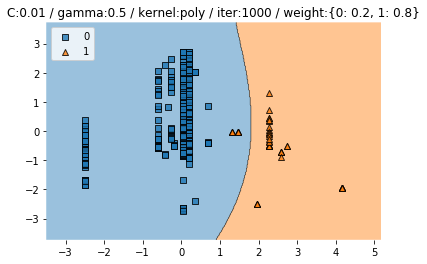

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


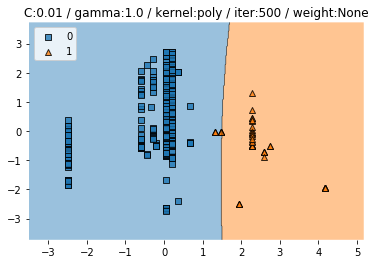

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


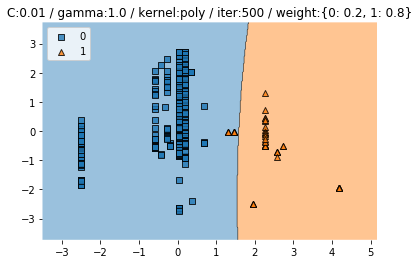

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


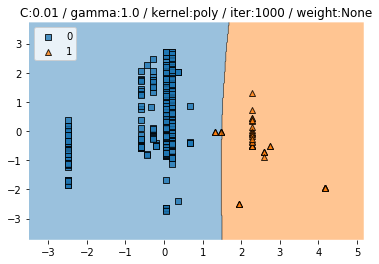

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


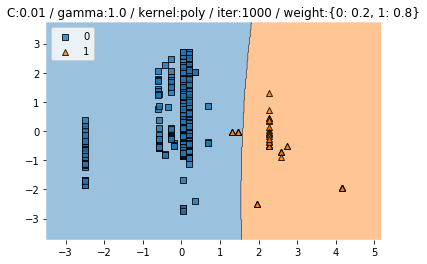

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


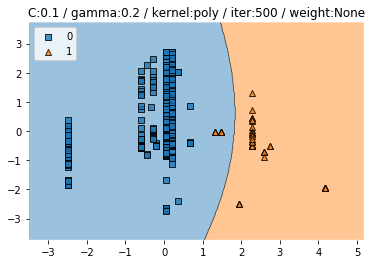

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


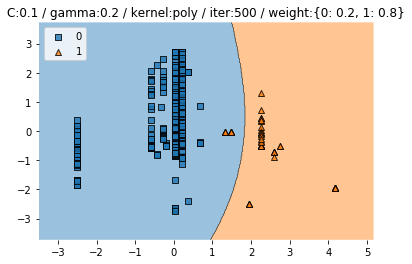

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


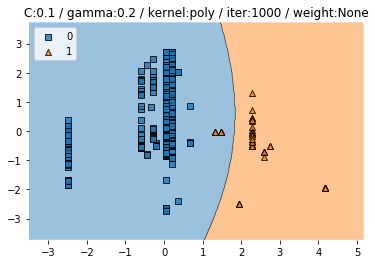

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


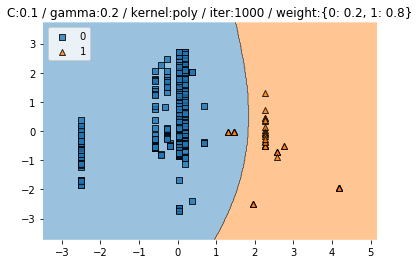

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


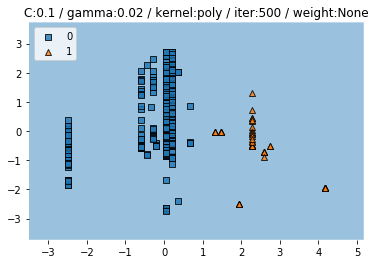

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


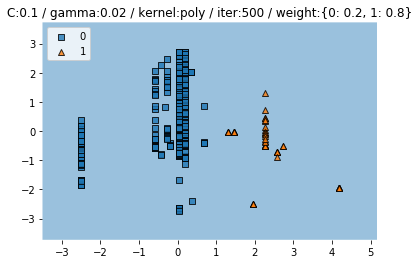

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


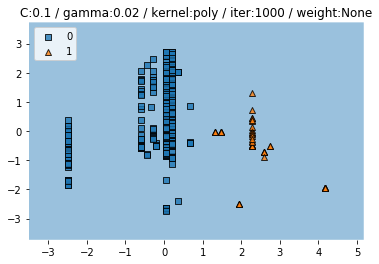

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


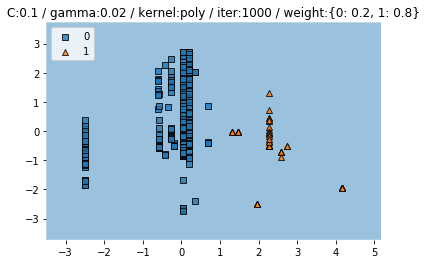

Train CV accuracy scores: [0.93650794 0.93650794 0.94148936 0.94148936 0.94117647]
Train CV accuracy: 0.939 +/- 0.002
Train CV f1 scores: [0.90580276 0.90580276 0.91311571 0.91311571 0.91265597]
Train CV f1: 0.910 +/- 0.004
Test accuracy :  0.961764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


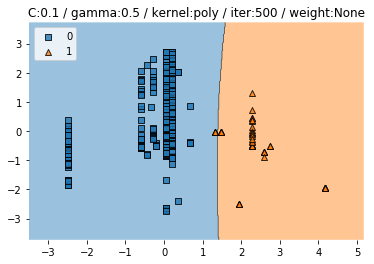

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


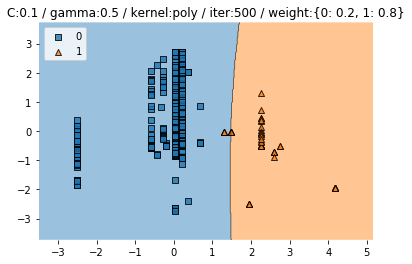

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


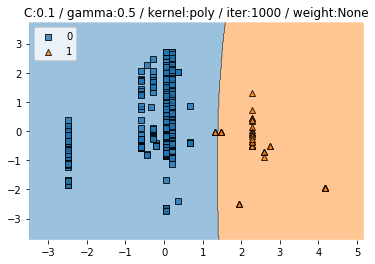

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


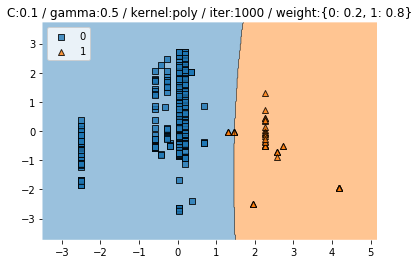

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


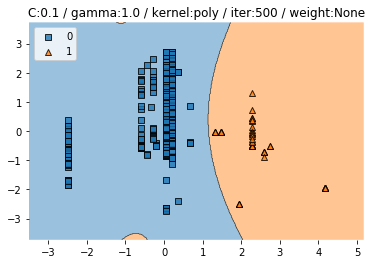

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


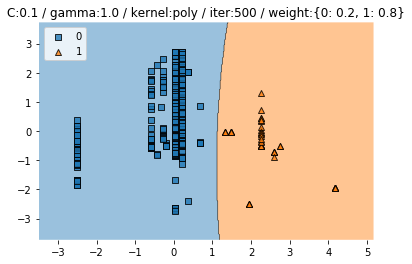

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


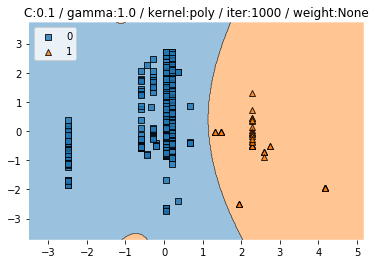

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


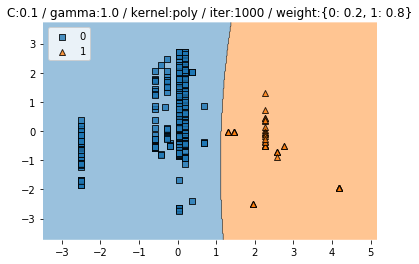

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


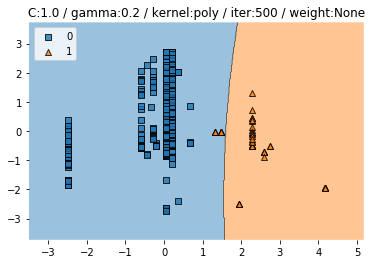

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


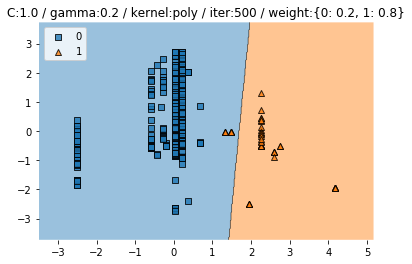

Train CV accuracy scores: [1.         0.98941799 1.         1.         1.        ]
Train CV accuracy: 0.998 +/- 0.004
Train CV f1 scores: [1.         0.98979493 1.         1.         1.        ]
Train CV f1: 0.998 +/- 0.004
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


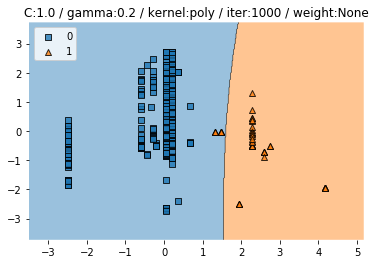

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


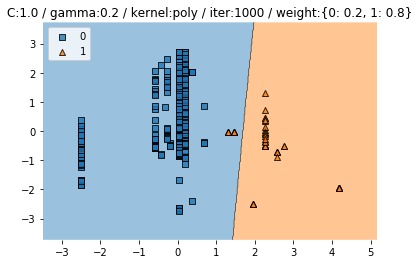

Train CV accuracy scores: [1.         0.98941799 1.         1.         1.        ]
Train CV accuracy: 0.998 +/- 0.004
Train CV f1 scores: [1.         0.98979493 1.         1.         1.        ]
Train CV f1: 0.998 +/- 0.004
Test accuracy :  1.0
Test f1 :  1.0


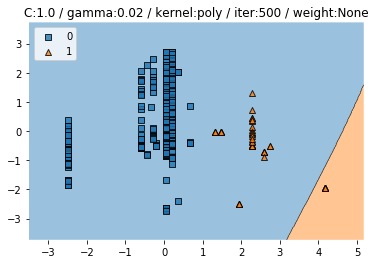

Train CV accuracy scores: [0.93650794 0.94708995 0.94148936 0.94680851 0.98395722]
Train CV accuracy: 0.951 +/- 0.017
Train CV f1 scores: [0.90580276 0.92892029 0.91311571 0.92537604 0.98275847]
Train CV f1: 0.931 +/- 0.027
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


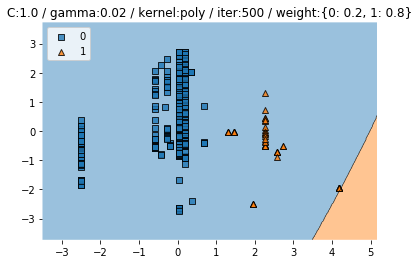

Train CV accuracy scores: [0.93650794 0.94708995 0.94148936 0.94680851 0.98395722]
Train CV accuracy: 0.951 +/- 0.017
Train CV f1 scores: [0.90580276 0.92892029 0.91311571 0.92537604 0.98275847]
Train CV f1: 0.931 +/- 0.027
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


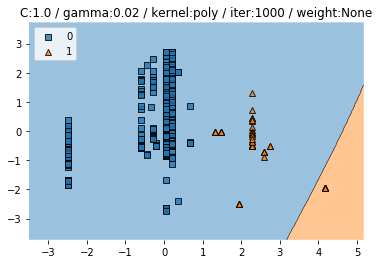

Train CV accuracy scores: [0.93650794 0.94708995 0.94148936 0.94680851 0.98395722]
Train CV accuracy: 0.951 +/- 0.017
Train CV f1 scores: [0.90580276 0.92892029 0.91311571 0.92537604 0.98275847]
Train CV f1: 0.931 +/- 0.027
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


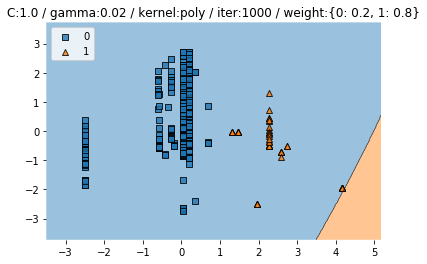

Train CV accuracy scores: [0.93650794 0.94708995 0.94148936 0.94680851 0.98395722]
Train CV accuracy: 0.951 +/- 0.017
Train CV f1 scores: [0.90580276 0.92892029 0.91311571 0.92537604 0.98275847]
Train CV f1: 0.931 +/- 0.027
Test accuracy :  0.961764705882353
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


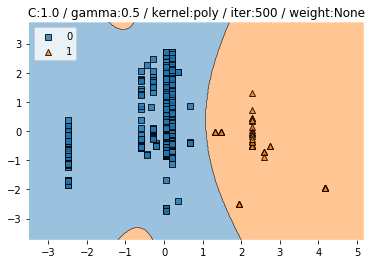

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


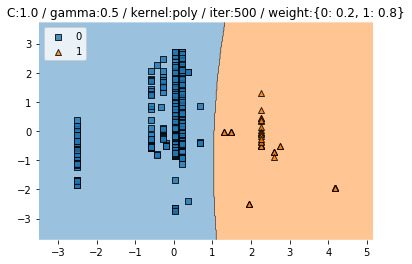

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


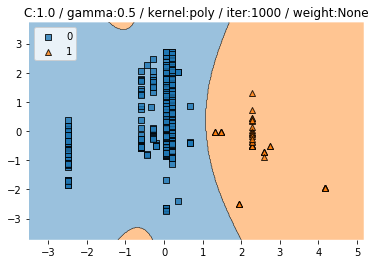

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


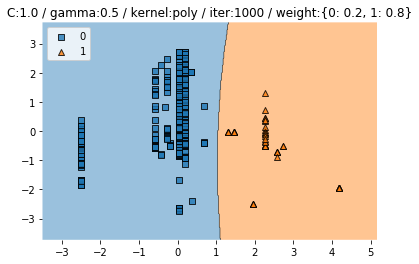

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


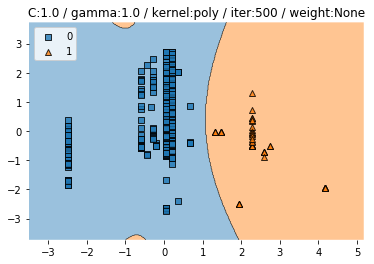

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


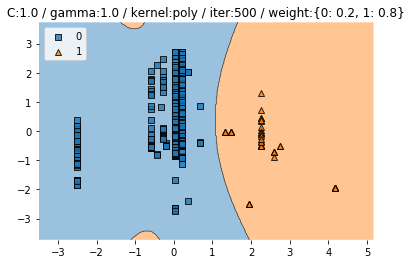

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


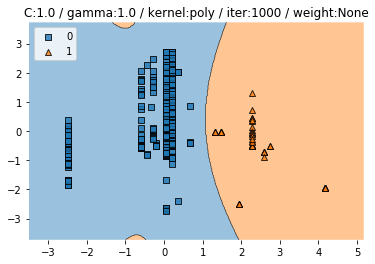

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


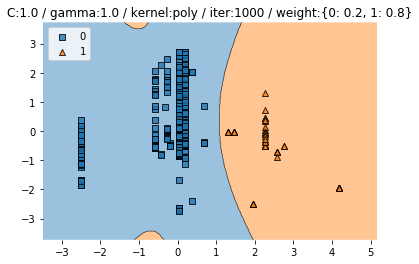

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


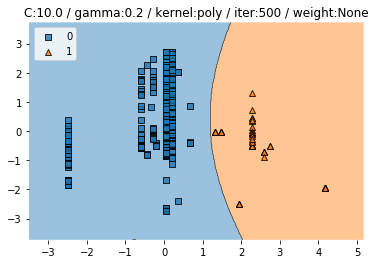

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


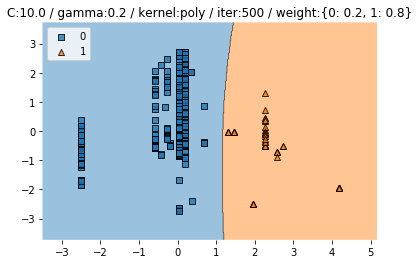

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


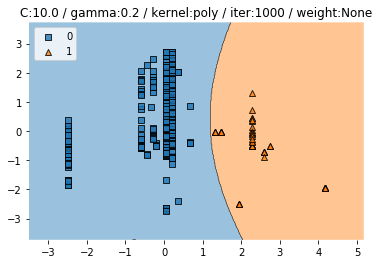

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


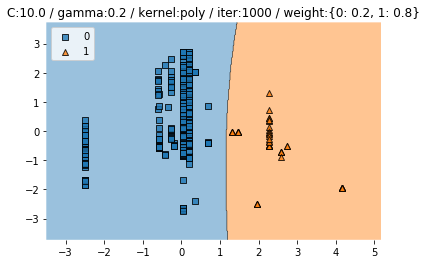

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


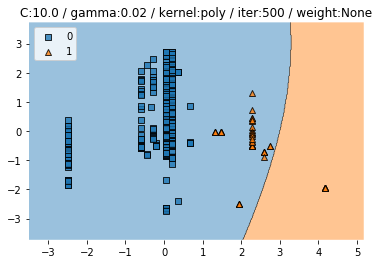

Train CV accuracy scores: [0.98941799 0.96825397 0.99468085 0.99468085 0.98395722]
Train CV accuracy: 0.986 +/- 0.010
Train CV f1 scores: [0.98896671 0.96322751 0.9945617  0.9945617  0.98275847]
Train CV f1: 0.985 +/- 0.012
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


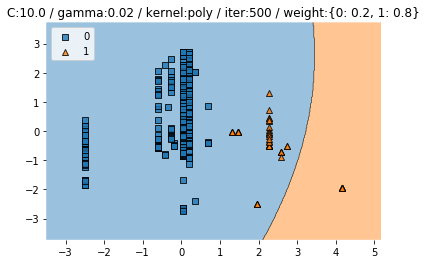

Train CV accuracy scores: [0.98412698 0.96825397 0.9787234  0.9893617  0.98395722]
Train CV accuracy: 0.981 +/- 0.007
Train CV f1 scores: [0.98305989 0.96322751 0.9764782  0.98885967 0.98275847]
Train CV f1: 0.979 +/- 0.009
Test accuracy :  0.9882352941176471
Test f1 :  0.8181818181818181


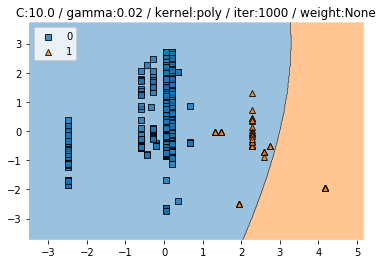

Train CV accuracy scores: [0.98941799 0.96825397 0.99468085 0.99468085 0.98395722]
Train CV accuracy: 0.986 +/- 0.010
Train CV f1 scores: [0.98896671 0.96322751 0.9945617  0.9945617  0.98275847]
Train CV f1: 0.985 +/- 0.012
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


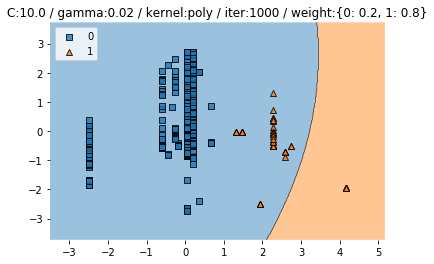

Train CV accuracy scores: [0.98412698 0.96825397 0.9787234  0.9893617  0.98395722]
Train CV accuracy: 0.981 +/- 0.007
Train CV f1 scores: [0.98305989 0.96322751 0.9764782  0.98885967 0.98275847]
Train CV f1: 0.979 +/- 0.009
Test accuracy :  0.9882352941176471
Test f1 :  0.8181818181818181


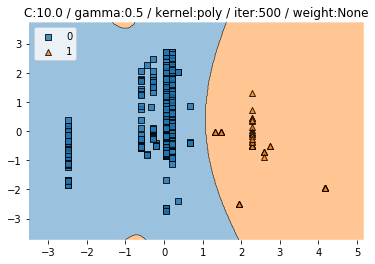

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


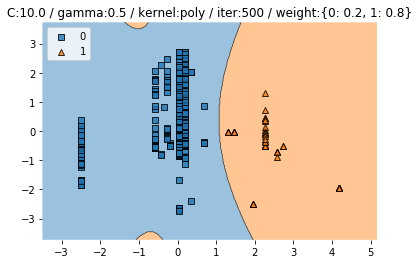

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


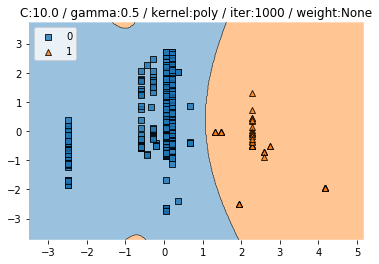

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


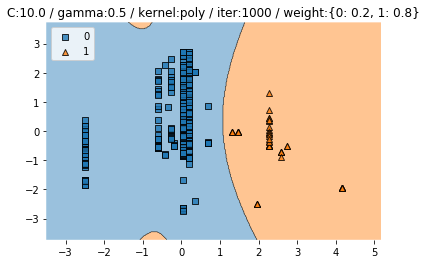

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


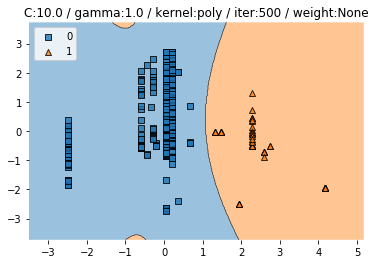

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


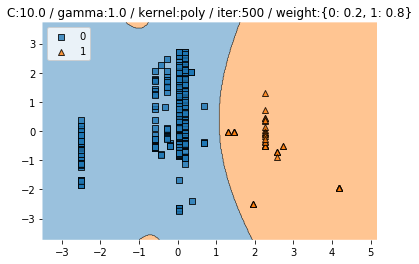

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


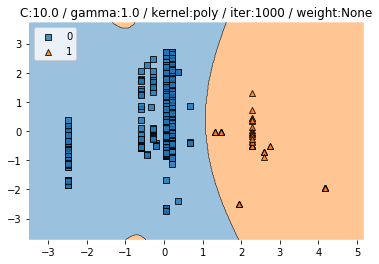

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


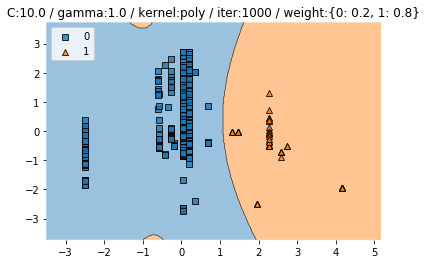

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


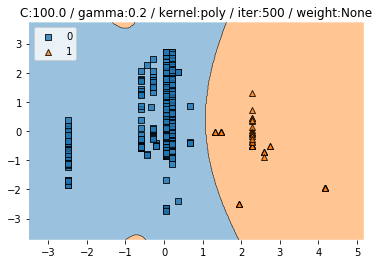

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


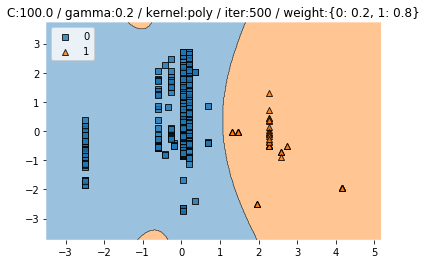

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


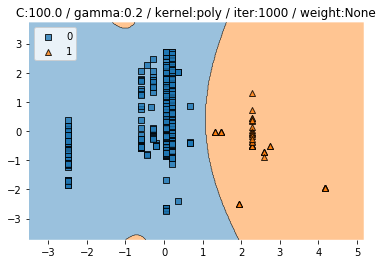

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


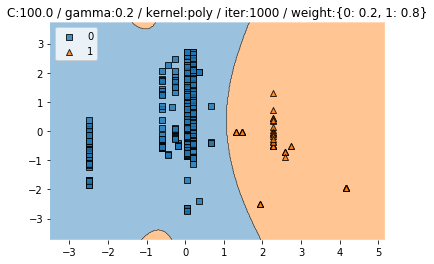

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


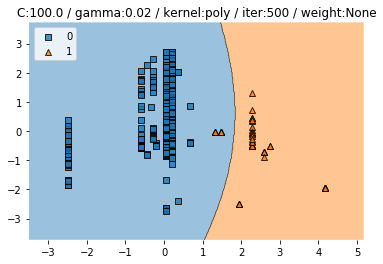

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


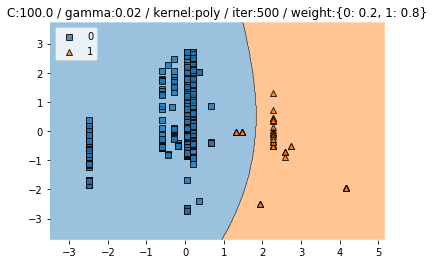

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


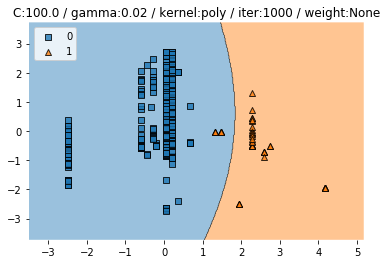

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


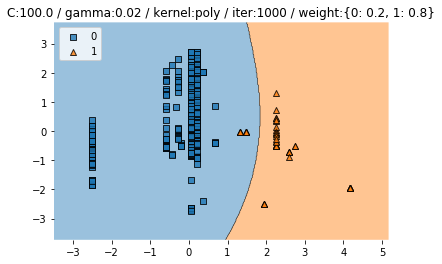

Train CV accuracy scores: [0.98941799 0.96825397 1.         1.         0.98395722]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [0.98896671 0.96322751 1.         1.         0.98275847]
Train CV f1: 0.987 +/- 0.014
Test accuracy :  0.9911764705882353
Test f1 :  0.8695652173913044


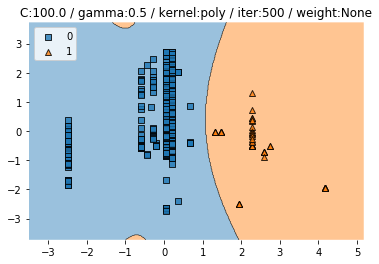

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


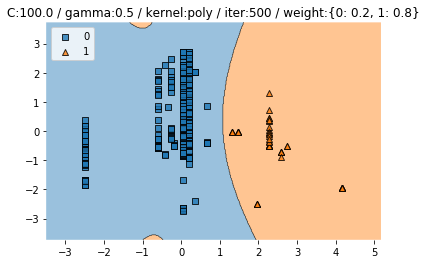

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


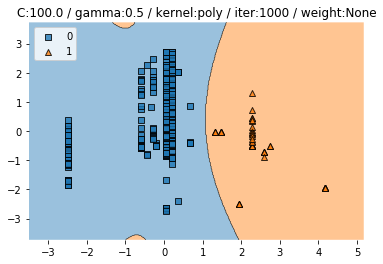

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


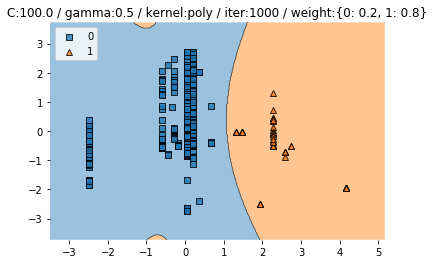

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


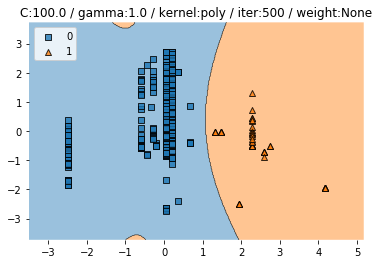

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


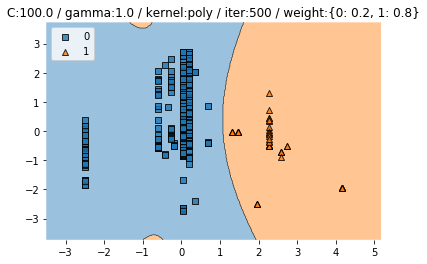

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


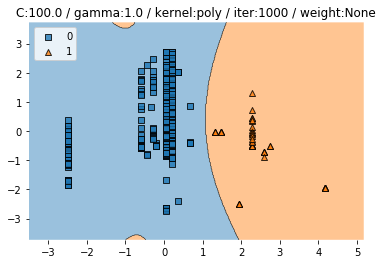

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0


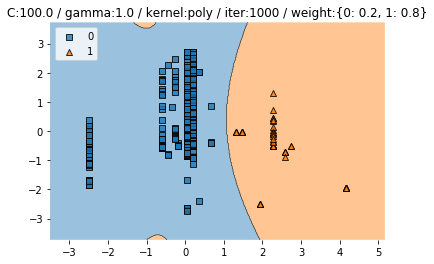

Train CV accuracy scores: [1.         0.98412698 1.         1.         1.        ]
Train CV accuracy: 0.997 +/- 0.006
Train CV f1 scores: [1.         0.98494098 1.         1.         1.        ]
Train CV f1: 0.997 +/- 0.006
Test accuracy :  1.0
Test f1 :  1.0
94.46206402778625 secs


In [18]:
# news title poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(2,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


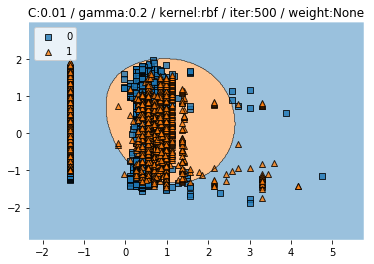

Train CV accuracy scores: [0.53312629 0.5320911  0.63316062 0.39107884 0.46473029]
Train CV accuracy: 0.511 +/- 0.080
Train CV f1 scores: [0.52947153 0.48304915 0.62720465 0.34990459 0.46761405]
Train CV f1: 0.491 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5411764705882353
Test f1 :  0.553921568627451


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


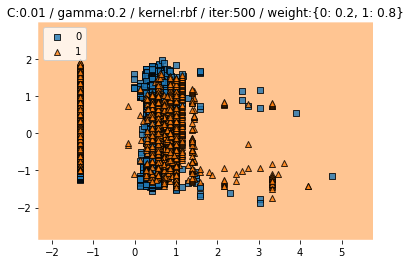

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


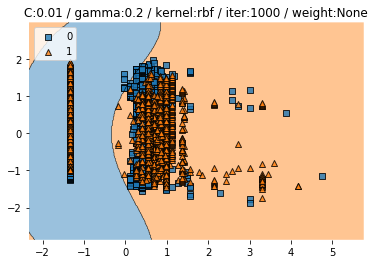

Train CV accuracy scores: [0.87060041 0.73188406 0.90569948 0.73340249 0.90767635]
Train CV accuracy: 0.830 +/- 0.080
Train CV f1 scores: [0.86738786 0.73344121 0.90610925 0.73470034 0.90763021]
Train CV f1: 0.830 +/- 0.080


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9092436974789916
Test f1 :  0.9078498293515358


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


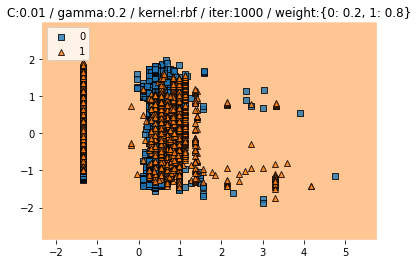

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


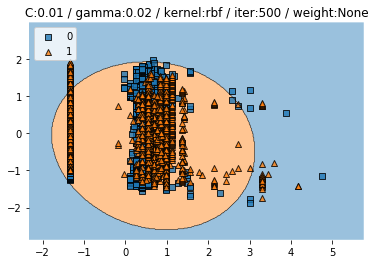

Train CV accuracy scores: [0.4689441  0.51242236 0.56787565 0.33921162 0.54149378]
Train CV accuracy: 0.486 +/- 0.080
Train CV f1 scores: [0.45148433 0.43223705 0.53232024 0.31212139 0.49935411]
Train CV f1: 0.446 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4722689075630252
Test f1 :  0.6357308584686775


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


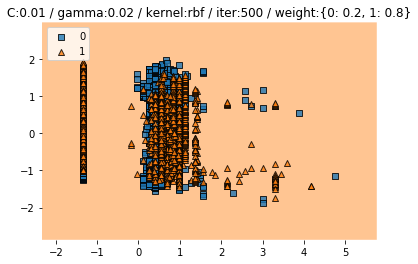

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


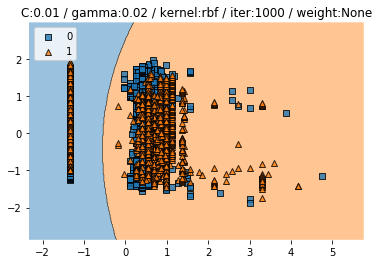

Train CV accuracy scores: [0.47412008 0.56418219 0.44248705 0.48340249 0.57261411]
Train CV accuracy: 0.507 +/- 0.052
Train CV f1 scores: [0.3557809  0.51681001 0.29610252 0.37558818 0.51853557]
Train CV f1: 0.413 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6630252100840336
Test f1 :  0.7232574189095928


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


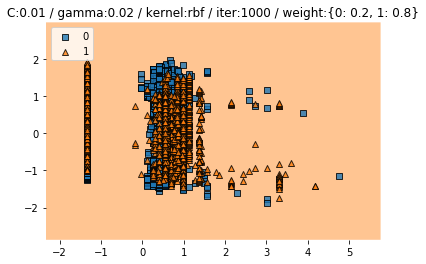

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


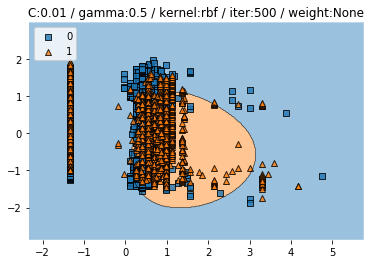

Train CV accuracy scores: [0.80331263 0.67287785 0.71917098 0.53630705 0.64834025]
Train CV accuracy: 0.676 +/- 0.088
Train CV f1 scores: [0.80409589 0.65546336 0.71742237 0.49335915 0.64964734]
Train CV f1: 0.664 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6512605042016807
Test f1 :  0.6677341873498799


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


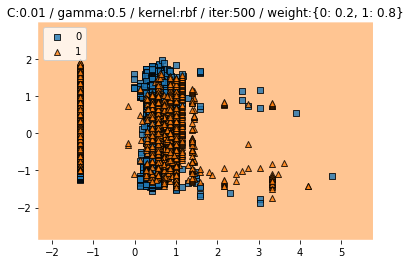

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


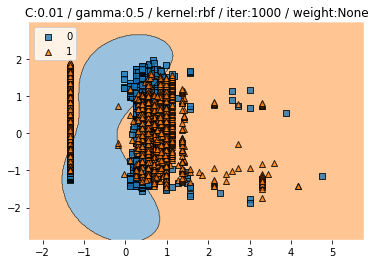

Train CV accuracy scores: [0.85196687 0.80848861 0.90880829 0.79460581 0.90145228]
Train CV accuracy: 0.853 +/- 0.047
Train CV f1 scores: [0.84691975 0.80958667 0.90830607 0.79540013 0.90009454]
Train CV f1: 0.852 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9411764705882353
Test f1 :  0.9360146252285192


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


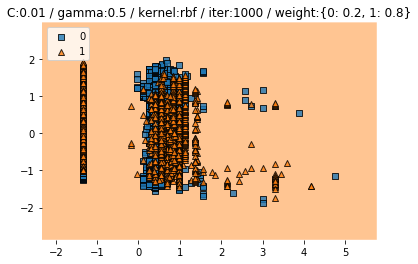

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


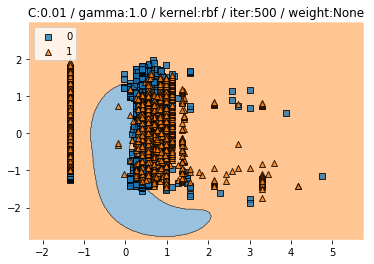

Train CV accuracy scores: [0.91511387 0.80331263 0.89119171 0.66182573 0.85165975]
Train CV accuracy: 0.825 +/- 0.090
Train CV f1 scores: [0.91457106 0.80235839 0.89166452 0.64811884 0.8524193 ]
Train CV f1: 0.822 +/- 0.095


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8277310924369747
Test f1 :  0.8358686949559647


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


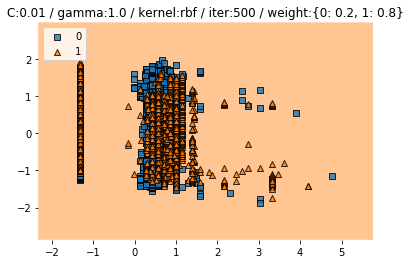

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


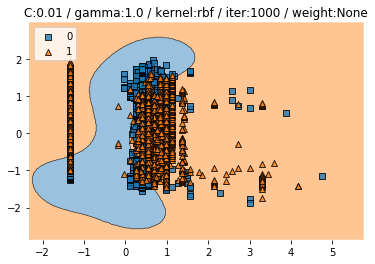

Train CV accuracy scores: [0.86438923 0.80538302 0.90673575 0.78838174 0.91390041]
Train CV accuracy: 0.856 +/- 0.051
Train CV f1 scores: [0.86047434 0.80650917 0.90626456 0.7895942  0.91306215]
Train CV f1: 0.855 +/- 0.050


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9420168067226891
Test f1 :  0.9362880886426594


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


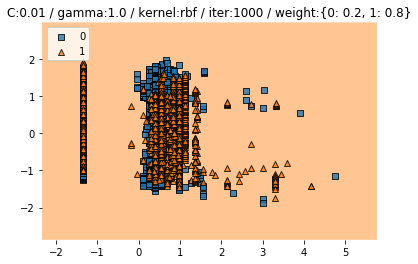

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


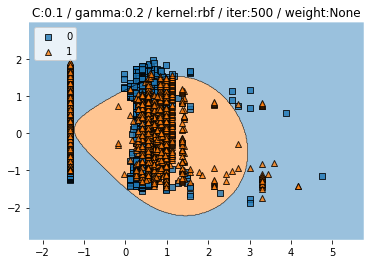

Train CV accuracy scores: [0.77329193 0.61801242 0.69740933 0.61721992 0.65352697]
Train CV accuracy: 0.672 +/- 0.059
Train CV f1 scores: [0.77204375 0.58749742 0.69736059 0.59572475 0.65374662]
Train CV f1: 0.661 +/- 0.068


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5378151260504201
Test f1 :  0.5542949756888168


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


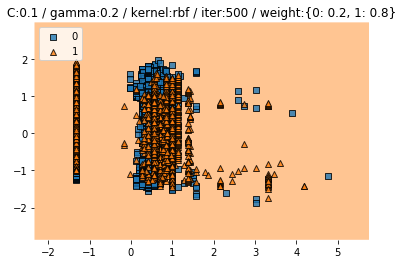

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


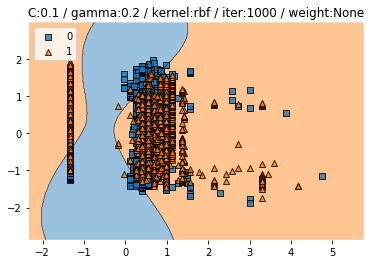

Train CV accuracy scores: [0.8447205  0.81055901 0.90466321 0.7873444  0.89315353]
Train CV accuracy: 0.848 +/- 0.045
Train CV f1 scores: [0.8387747  0.81143314 0.90380845 0.78796548 0.89119573]
Train CV f1: 0.847 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.915126050420168
Test f1 :  0.9026036644165863


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


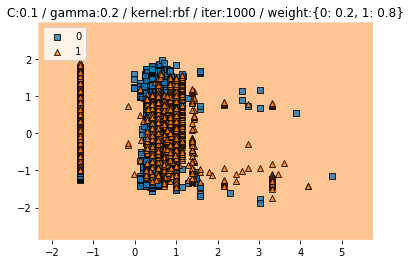

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


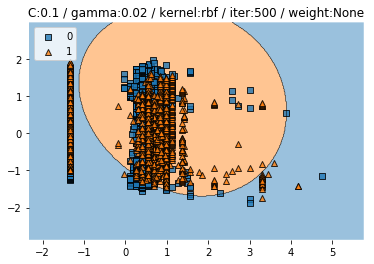

Train CV accuracy scores: [0.48136646 0.51345756 0.54818653 0.33921162 0.52178423]
Train CV accuracy: 0.481 +/- 0.074
Train CV f1 scores: [0.46207734 0.42888396 0.5050113  0.31212139 0.44663935]
Train CV f1: 0.431 +/- 0.065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5394957983193277
Test f1 :  0.6600496277915633


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


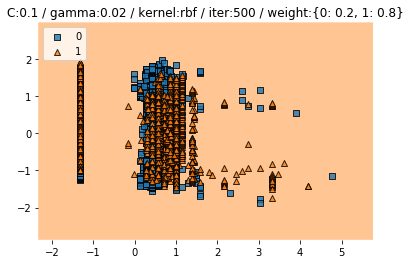

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


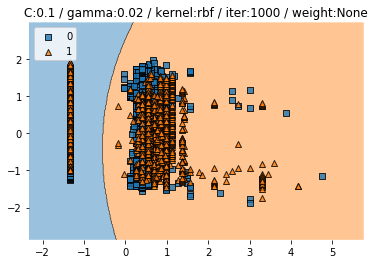

Train CV accuracy scores: [0.49585921 0.61697723 0.49222798 0.4253112  0.42323651]
Train CV accuracy: 0.491 +/- 0.070
Train CV f1 scores: [0.39532164 0.61452794 0.39051783 0.25622282 0.25172084]
Train CV f1: 0.382 +/- 0.132


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


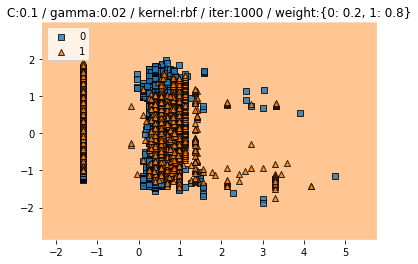

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


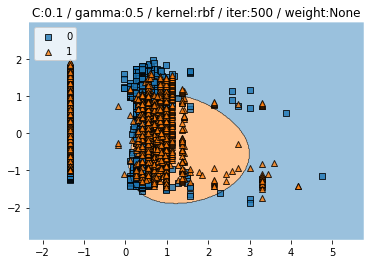

Train CV accuracy scores: [0.90993789 0.79296066 0.90984456 0.68568465 0.90975104]
Train CV accuracy: 0.842 +/- 0.090
Train CV f1 scores: [0.90934044 0.79168129 0.9100192  0.68019652 0.90976565]
Train CV f1: 0.840 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6369747899159663
Test f1 :  0.6717325227963526


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


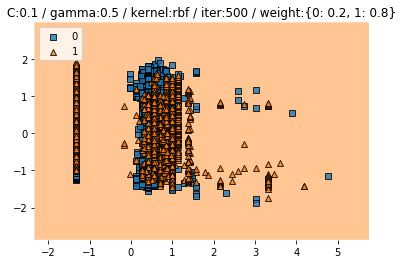

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


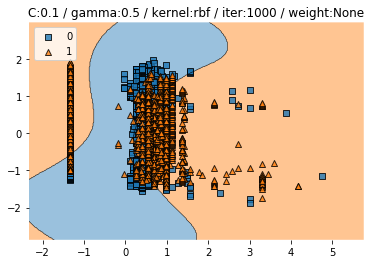

Train CV accuracy scores: [0.85093168 0.82815735 0.90673575 0.78112033 0.906639  ]
Train CV accuracy: 0.855 +/- 0.048
Train CV f1 scores: [0.84578152 0.82906908 0.90584982 0.78235303 0.90526579]
Train CV f1: 0.854 +/- 0.047


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.934453781512605
Test f1 :  0.9261363636363636


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


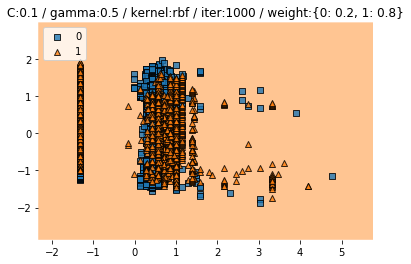

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


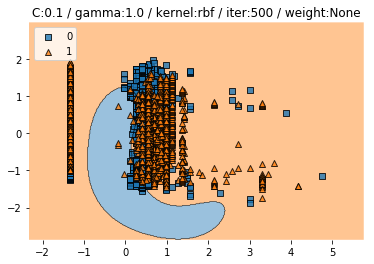

Train CV accuracy scores: [0.9068323  0.81573499 0.92331606 0.74792531 0.87863071]
Train CV accuracy: 0.854 +/- 0.065
Train CV f1 scores: [0.90563847 0.81573499 0.92323745 0.74852958 0.87922746]
Train CV f1: 0.854 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9512605042016806
Test f1 :  0.946886446886447


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


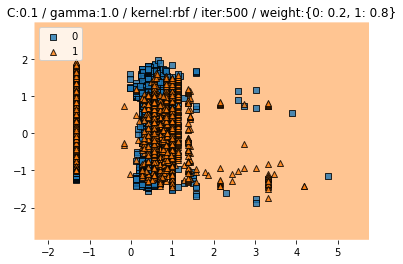

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


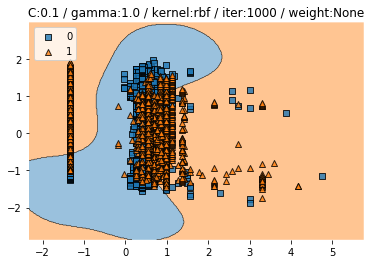

Train CV accuracy scores: [0.86749482 0.82194617 0.91088083 0.80186722 0.90975104]
Train CV accuracy: 0.862 +/- 0.045
Train CV f1 scores: [0.86383417 0.82299482 0.91017424 0.8029964  0.9085625 ]
Train CV f1: 0.862 +/- 0.044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9378151260504202
Test f1 :  0.9303201506591338


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


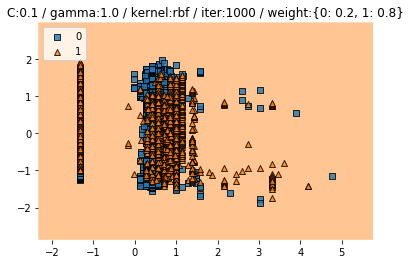

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


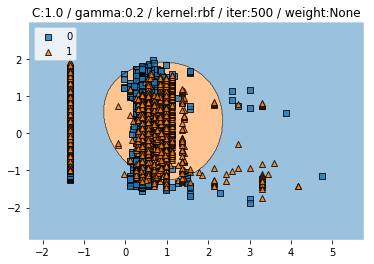

Train CV accuracy scores: [0.87888199 0.80538302 0.90984456 0.73651452 0.9253112 ]
Train CV accuracy: 0.851 +/- 0.071
Train CV f1 scores: [0.87606143 0.80649342 0.90915258 0.737468   0.92500097]
Train CV f1: 0.851 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6949579831932773
Test f1 :  0.7405289492494639


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


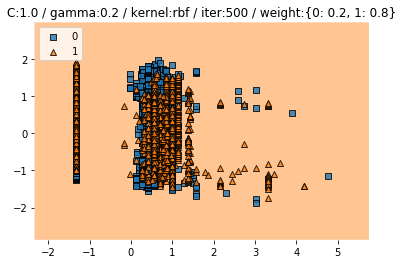

Train CV accuracy scores: [0.48240166 0.44513458 0.39896373 0.36307054 0.40041494]
Train CV accuracy: 0.418 +/- 0.041
Train CV f1 scores: [0.44139295 0.30243452 0.24115141 0.32833775 0.25048519]
Train CV f1: 0.313 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3798319327731092
Test f1 :  0.5505481120584653


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


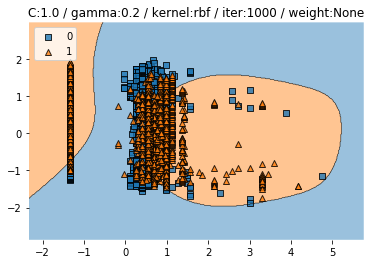

Train CV accuracy scores: [0.86542443 0.82401656 0.90984456 0.74688797 0.92634855]
Train CV accuracy: 0.855 +/- 0.065
Train CV f1 scores: [0.86136884 0.82505495 0.90896378 0.74802824 0.92550838]
Train CV f1: 0.854 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9378151260504202
Test f1 :  0.9300567107750473


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


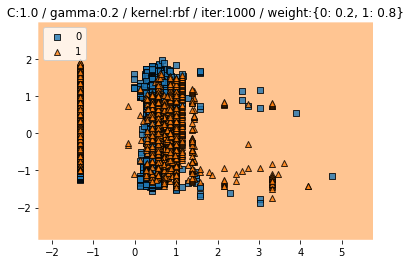

Train CV accuracy scores: [0.61076605 0.58178054 0.64974093 0.59128631 0.62759336]
Train CV accuracy: 0.612 +/- 0.025
Train CV f1 scores: [0.58963077 0.53466025 0.65183954 0.56190016 0.62051203]
Train CV f1: 0.592 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5596638655462185
Test f1 :  0.5618729096989966


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


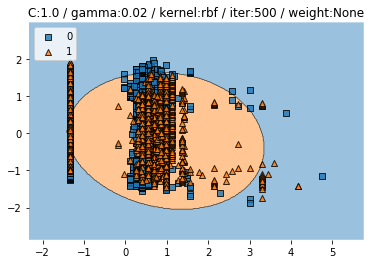

Train CV accuracy scores: [0.41511387 0.42339545 0.47979275 0.4253112  0.4346473 ]
Train CV accuracy: 0.436 +/- 0.023
Train CV f1 scores: [0.24840025 0.25369495 0.38616267 0.25622282 0.27951818]
Train CV f1: 0.285 +/- 0.052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4722689075630252
Test f1 :  0.636574074074074


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


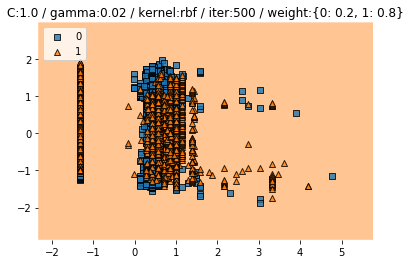

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


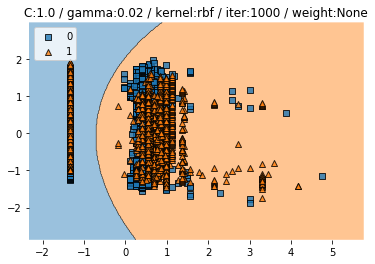

Train CV accuracy scores: [0.83436853 0.73291925 0.89948187 0.80290456 0.89107884]
Train CV accuracy: 0.832 +/- 0.061
Train CV f1 scores: [0.82669006 0.733896   0.89895128 0.80308927 0.8893728 ]
Train CV f1: 0.830 +/- 0.060


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7840336134453781
Test f1 :  0.8106116433308769


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


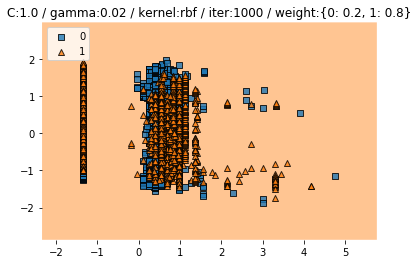

Train CV accuracy scores: [0.41718427 0.44409938 0.42176166 0.33921162 0.42323651]
Train CV accuracy: 0.409 +/- 0.036
Train CV f1 scores: [0.24927445 0.29717781 0.25265408 0.31212139 0.25172084]
Train CV f1: 0.273 +/- 0.027


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


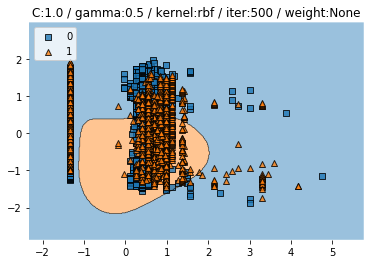

Train CV accuracy scores: [0.87163561 0.83436853 0.90673575 0.79149378 0.9346473 ]
Train CV accuracy: 0.868 +/- 0.051
Train CV f1 scores: [0.86808935 0.83522974 0.90530055 0.79271734 0.93404612]
Train CV f1: 0.867 +/- 0.050


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9470588235294117
Test f1 :  0.9407337723424272


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


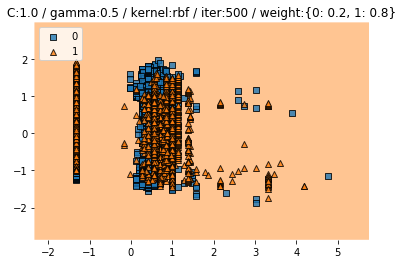

Train CV accuracy scores: [0.41925466 0.42546584 0.42279793 0.39626556 0.42427386]
Train CV accuracy: 0.418 +/- 0.011
Train CV f1 scores: [0.25194133 0.25637468 0.25127685 0.38704643 0.25397541]
Train CV f1: 0.280 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5588235294117647
Test f1 :  0.680073126142596


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


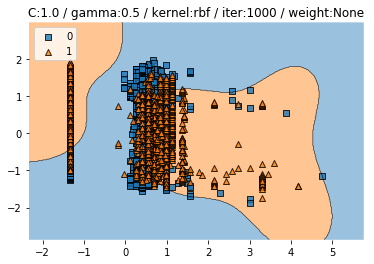

Train CV accuracy scores: [0.87784679 0.83643892 0.8984456  0.79045643 0.92842324]
Train CV accuracy: 0.866 +/- 0.048
Train CV f1 scores: [0.87466961 0.8372706  0.89681728 0.79169411 0.92752338]
Train CV f1: 0.866 +/- 0.047


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9478991596638655
Test f1 :  0.9417293233082706


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


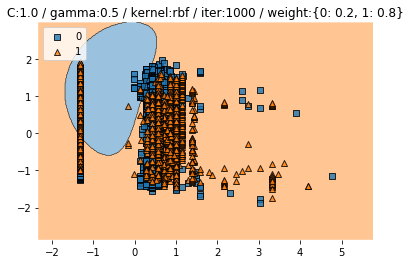

Train CV accuracy scores: [0.86231884 0.67908903 0.81243523 0.64315353 0.71058091]
Train CV accuracy: 0.742 +/- 0.083
Train CV f1 scores: [0.86312852 0.66166366 0.81218224 0.62628391 0.70332083]
Train CV f1: 0.733 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8563025210084033
Test f1 :  0.8547153780798641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


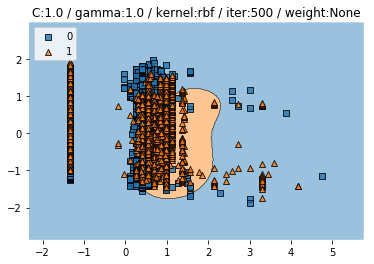

Train CV accuracy scores: [0.89440994 0.85403727 0.90673575 0.8153527  0.9253112 ]
Train CV accuracy: 0.879 +/- 0.040
Train CV f1 scores: [0.89214761 0.85475194 0.90530055 0.81638579 0.92460418]
Train CV f1: 0.879 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9470588235294117
Test f1 :  0.9408450704225352


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


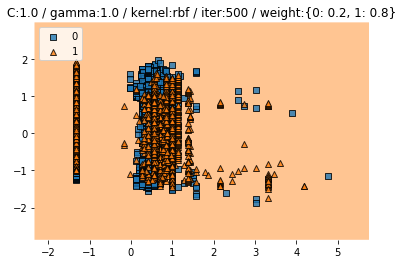

Train CV accuracy scores: [0.43478261 0.46480331 0.42279793 0.42427386 0.42323651]
Train CV accuracy: 0.434 +/- 0.016
Train CV f1 scores: [0.27624638 0.33669576 0.25127685 0.25934691 0.25172084]
Train CV f1: 0.275 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


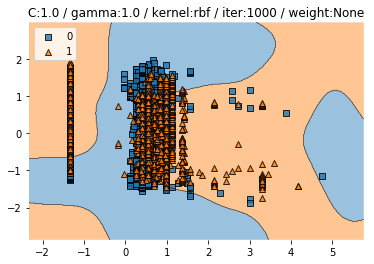

Train CV accuracy scores: [0.89026915 0.85403727 0.90466321 0.81639004 0.9253112 ]
Train CV accuracy: 0.878 +/- 0.039
Train CV f1 scores: [0.88775524 0.854732   0.90313459 0.81741016 0.9245637 ]
Train CV f1: 0.878 +/- 0.038


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9478991596638655
Test f1 :  0.9418386491557225


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


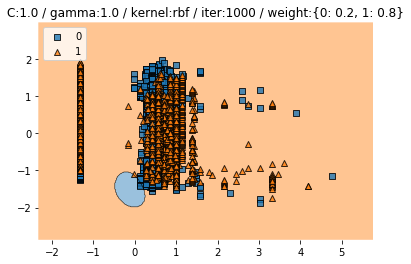

Train CV accuracy scores: [0.89440994 0.73395445 0.90362694 0.6473029  0.85165975]
Train CV accuracy: 0.806 +/- 0.100
Train CV f1 scores: [0.89479609 0.72710997 0.90419214 0.63365418 0.8524361 ]
Train CV f1: 0.802 +/- 0.105


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8596638655462185
Test f1 :  0.868607395751377


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


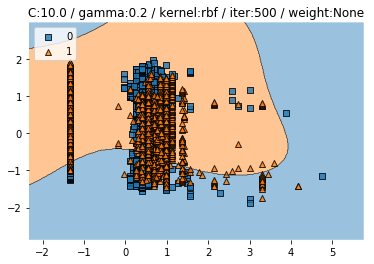

Train CV accuracy scores: [0.87060041 0.81469979 0.87875648 0.73547718 0.90352697]
Train CV accuracy: 0.841 +/- 0.060
Train CV f1 scores: [0.86768443 0.81558176 0.8761848  0.7362367  0.90314686]
Train CV f1: 0.840 +/- 0.059


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9369747899159664
Test f1 :  0.9291784702549574


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


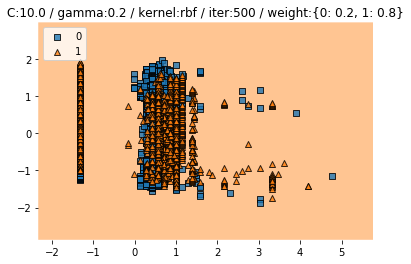

Train CV accuracy scores: [0.62318841 0.5931677  0.5119171  0.50829876 0.50829876]
Train CV accuracy: 0.549 +/- 0.049
Train CV f1 scores: [0.5975922  0.56429389 0.47917792 0.44349999 0.51053962]
Train CV f1: 0.519 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7445378151260504
Test f1 :  0.6813417190775681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


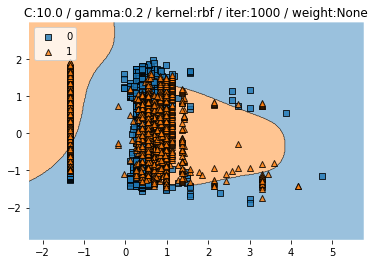

Train CV accuracy scores: [0.89440994 0.8447205  0.90984456 0.78423237 0.93568465]
Train CV accuracy: 0.874 +/- 0.054
Train CV f1 scores: [0.89229976 0.84563198 0.90842823 0.78549486 0.93500546]
Train CV f1: 0.873 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9470588235294117
Test f1 :  0.9406220546654099


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


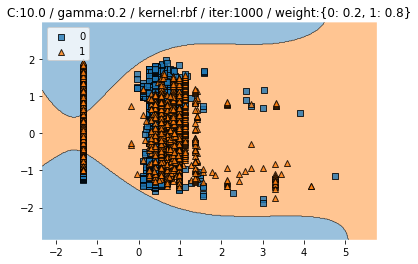

Train CV accuracy scores: [0.93064182 0.77950311 0.92849741 0.67427386 0.88070539]
Train CV accuracy: 0.839 +/- 0.099
Train CV f1 scores: [0.93050821 0.77828913 0.92846151 0.66573556 0.88136818]
Train CV f1: 0.837 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9420168067226891
Test f1 :  0.9389920424403183


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


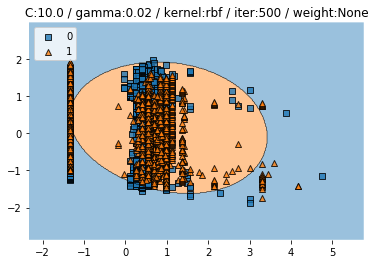

Train CV accuracy scores: [0.89958592 0.51242236 0.41968912 0.41908714 0.52074689]
Train CV accuracy: 0.554 +/- 0.178
Train CV f1 scores: [0.8986125  0.42505606 0.28172344 0.25533266 0.43705327]
Train CV f1: 0.460 +/- 0.231


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.44201680672268906
Test f1 :  0.5875776397515529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


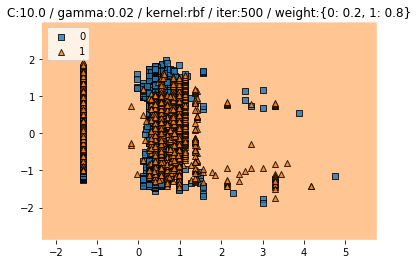

Train CV accuracy scores: [0.30538302 0.50310559 0.49637306 0.35062241 0.42116183]
Train CV accuracy: 0.415 +/- 0.078
Train CV f1 scores: [0.2243024  0.41567412 0.48588137 0.32835532 0.25085259]
Train CV f1: 0.341 +/- 0.098


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.44789915966386556
Test f1 :  0.6182452062754211


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


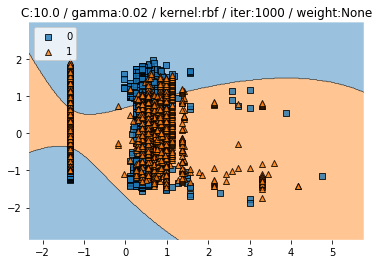

Train CV accuracy scores: [0.86749482 0.76708075 0.91295337 0.76659751 0.90248963]
Train CV accuracy: 0.843 +/- 0.064
Train CV f1 scores: [0.86372482 0.76834129 0.91251359 0.76797809 0.90099359]
Train CV f1: 0.843 +/- 0.063


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9193277310924369
Test f1 :  0.9102803738317758


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


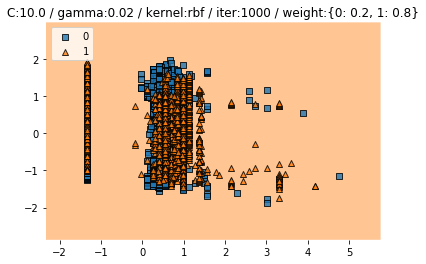

Train CV accuracy scores: [0.56418219 0.56004141 0.6        0.5653527  0.47614108]
Train CV accuracy: 0.553 +/- 0.041
Train CV f1 scores: [0.53535872 0.50270897 0.59053464 0.51789819 0.47893761]
Train CV f1: 0.525 +/- 0.038


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5159663865546219
Test f1 :  0.5534883720930233


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


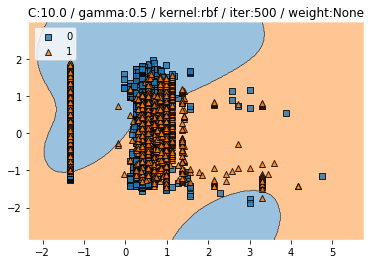

Train CV accuracy scores: [0.90062112 0.85196687 0.90569948 0.82883817 0.90145228]
Train CV accuracy: 0.878 +/- 0.031
Train CV f1 scores: [0.89884191 0.85275964 0.904031   0.82984895 0.8993676 ]
Train CV f1: 0.877 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9008403361344538
Test f1 :  0.8931159420289855


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


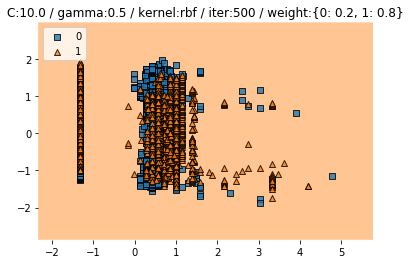

Train CV accuracy scores: [0.80641822 0.71635611 0.79585492 0.66701245 0.81950207]
Train CV accuracy: 0.761 +/- 0.059
Train CV f1 scores: [0.80756052 0.71254797 0.79495922 0.65684477 0.82011862]
Train CV f1: 0.758 +/- 0.063


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8428571428571429
Test f1 :  0.8316831683168318


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


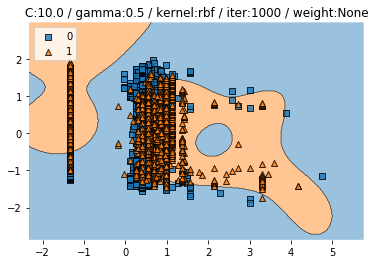

Train CV accuracy scores: [0.9047619  0.88302277 0.90051813 0.82780083 0.90560166]
Train CV accuracy: 0.884 +/- 0.029
Train CV f1 scores: [0.90299177 0.88356254 0.89844424 0.82879678 0.90552194]
Train CV f1: 0.884 +/- 0.029


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.946218487394958
Test f1 :  0.9397363465160075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


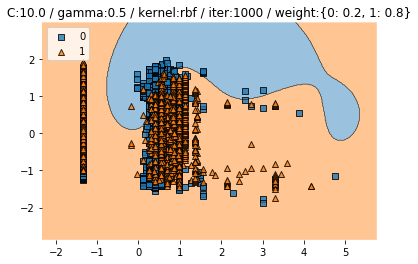

Train CV accuracy scores: [0.91925466 0.82401656 0.91606218 0.6659751  0.90975104]
Train CV accuracy: 0.847 +/- 0.097
Train CV f1 scores: [0.91885007 0.82441497 0.91573008 0.65591103 0.90997138]
Train CV f1: 0.845 +/- 0.101


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9563025210084034
Test f1 :  0.9523809523809524


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


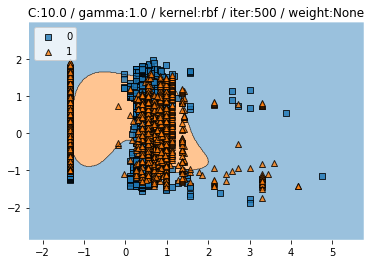

Train CV accuracy scores: [0.89648033 0.86024845 0.89637306 0.81846473 0.87863071]
Train CV accuracy: 0.870 +/- 0.029
Train CV f1 scores: [0.89395054 0.86091362 0.89421275 0.81953002 0.87830198]
Train CV f1: 0.869 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9294117647058824
Test f1 :  0.9192307692307693


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


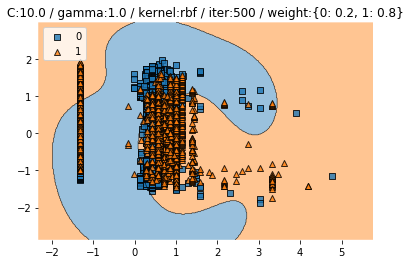

Train CV accuracy scores: [0.84989648 0.80227743 0.81761658 0.74585062 0.86721992]
Train CV accuracy: 0.817 +/- 0.042
Train CV f1 scores: [0.85061092 0.80152509 0.81749363 0.74409663 0.86799684]
Train CV f1: 0.816 +/- 0.043


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7747899159663866
Test f1 :  0.7372549019607842


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


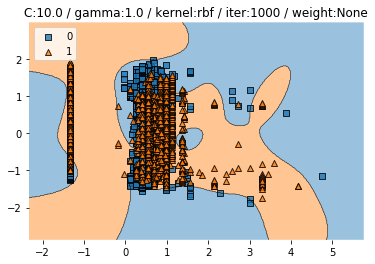

Train CV accuracy scores: [0.89958592 0.8747412  0.88601036 0.81120332 0.88589212]
Train CV accuracy: 0.871 +/- 0.031
Train CV f1 scores: [0.89754342 0.87545208 0.88283962 0.81232242 0.88573475]
Train CV f1: 0.871 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9403361344537815
Test f1 :  0.9327014218009478


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


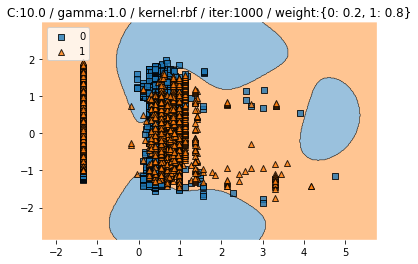

Train CV accuracy scores: [0.9047619  0.81987578 0.9119171  0.73547718 0.88589212]
Train CV accuracy: 0.852 +/- 0.067
Train CV f1 scores: [0.9042847  0.82023797 0.91137027 0.7331347  0.88631118]
Train CV f1: 0.851 +/- 0.067


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9487394957983193
Test f1 :  0.9440879926672777


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


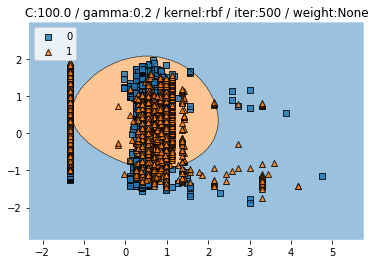

Train CV accuracy scores: [0.75879917 0.7805383  0.64974093 0.71473029 0.68360996]
Train CV accuracy: 0.717 +/- 0.048
Train CV f1 scores: [0.75764421 0.78170268 0.62500809 0.71561334 0.64429431]
Train CV f1: 0.705 +/- 0.061


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6554621848739496
Test f1 :  0.6611570247933884


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


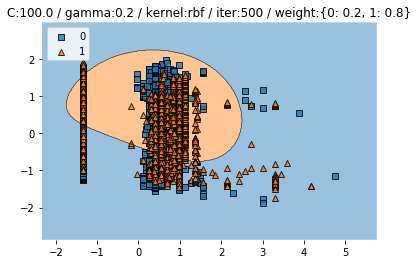

Train CV accuracy scores: [0.72463768 0.59006211 0.74611399 0.53215768 0.75311203]
Train CV accuracy: 0.669 +/- 0.091
Train CV f1 scores: [0.72361526 0.5850266  0.74571562 0.52428703 0.74408587]
Train CV f1: 0.665 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7025210084033613
Test f1 :  0.6304801670146137


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


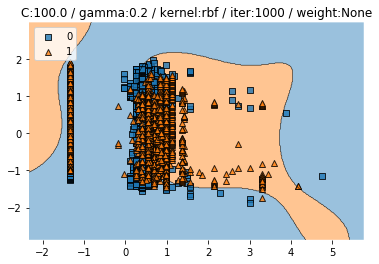

Train CV accuracy scores: [0.83643892 0.81055901 0.84041451 0.81327801 0.85373444]
Train CV accuracy: 0.831 +/- 0.017
Train CV f1 scores: [0.83659156 0.81167596 0.83515313 0.81409924 0.84997159]
Train CV f1: 0.829 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8126050420168067
Test f1 :  0.7948482060717571


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


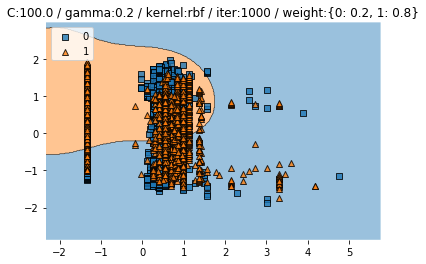

Train CV accuracy scores: [0.88405797 0.77122153 0.77409326 0.61929461 0.90248963]
Train CV accuracy: 0.790 +/- 0.101
Train CV f1 scores: [0.88381269 0.7698597  0.76581658 0.60607672 0.90171931]
Train CV f1: 0.785 +/- 0.106


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8714285714285714
Test f1 :  0.8668407310704961


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


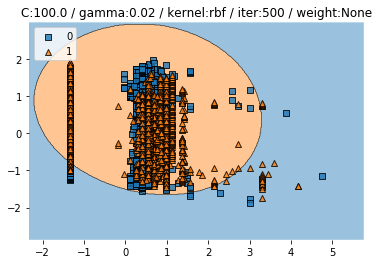

Train CV accuracy scores: [0.72567288 0.65113872 0.76683938 0.57365145 0.68879668]
Train CV accuracy: 0.681 +/- 0.066
Train CV f1 scores: [0.72604842 0.63657123 0.76796672 0.55063043 0.6818693 ]
Train CV f1: 0.673 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36554621848739494
Test f1 :  0.4694307800421645


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


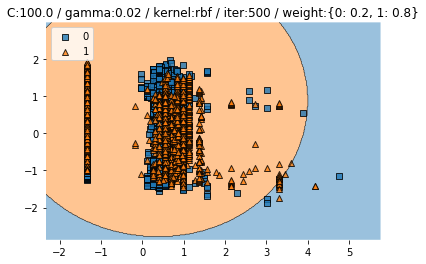

Train CV accuracy scores: [0.46480331 0.52484472 0.59792746 0.3973029  0.49481328]
Train CV accuracy: 0.496 +/- 0.066
Train CV f1 scores: [0.46161749 0.5017623  0.60000228 0.39102621 0.49769238]
Train CV f1: 0.490 +/- 0.068


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6327731092436975
Test f1 :  0.6641045349730975


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


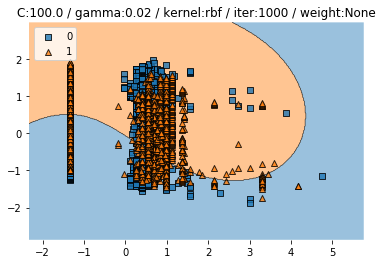

Train CV accuracy scores: [0.78778468 0.75258799 0.81865285 0.68049793 0.81742739]
Train CV accuracy: 0.771 +/- 0.051
Train CV f1 scores: [0.78111484 0.75323809 0.81777726 0.67655693 0.81833699]
Train CV f1: 0.769 +/- 0.052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9
Test f1 :  0.898550724637681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


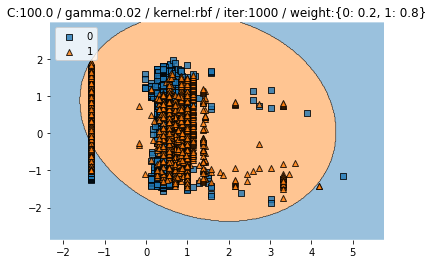

Train CV accuracy scores: [0.74223602 0.6863354  0.55854922 0.62448133 0.73340249]
Train CV accuracy: 0.669 +/- 0.069
Train CV f1 scores: [0.73983177 0.67466953 0.54357561 0.60318862 0.72675448]
Train CV f1: 0.658 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7
Test f1 :  0.7433501078360892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


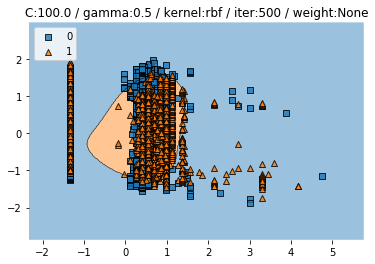

Train CV accuracy scores: [0.74120083 0.72360248 0.79896373 0.6473029  0.82987552]
Train CV accuracy: 0.748 +/- 0.063
Train CV f1 scores: [0.72438575 0.72149783 0.79082218 0.6492479  0.82487068]
Train CV f1: 0.742 +/- 0.061


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7453781512605042
Test f1 :  0.7282511210762331


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


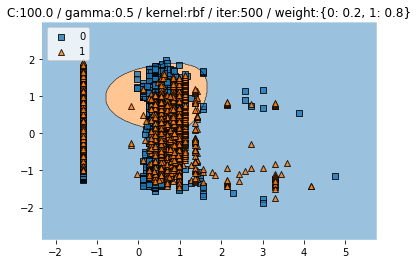

Train CV accuracy scores: [0.78571429 0.70496894 0.82176166 0.6939834  0.6846473 ]
Train CV accuracy: 0.738 +/- 0.055
Train CV f1 scores: [0.78005504 0.70653738 0.82176166 0.68940343 0.66485984]
Train CV f1: 0.733 +/- 0.059


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6243697478991597
Test f1 :  0.6068601583113455


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


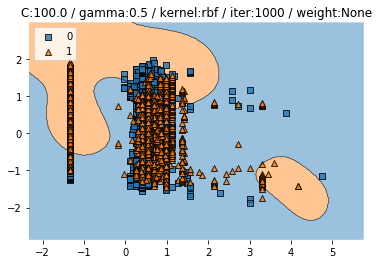

Train CV accuracy scores: [0.86438923 0.8436853  0.8611399  0.69294606 0.81431535]
Train CV accuracy: 0.815 +/- 0.064
Train CV f1 scores: [0.85988769 0.84458156 0.85966854 0.69340208 0.81358373]
Train CV f1: 0.814 +/- 0.063


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9033613445378151
Test f1 :  0.886025768087215


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


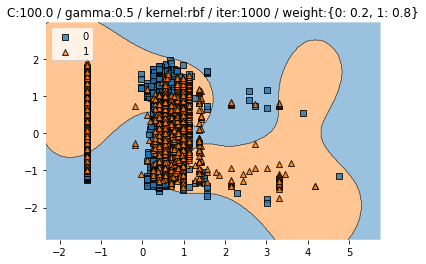

Train CV accuracy scores: [0.90062112 0.83540373 0.89948187 0.72406639 0.85580913]
Train CV accuracy: 0.843 +/- 0.065
Train CV f1 scores: [0.90033337 0.83634356 0.89855397 0.71933667 0.85663933]
Train CV f1: 0.842 +/- 0.066


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8899159663865546
Test f1 :  0.8833481745325021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


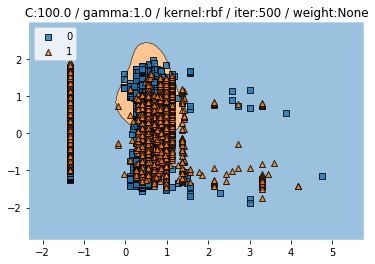

Train CV accuracy scores: [0.69875776 0.79296066 0.75336788 0.64522822 0.62448133]
Train CV accuracy: 0.703 +/- 0.063
Train CV f1 scores: [0.66793448 0.78939324 0.73847781 0.64499019 0.61496947]
Train CV f1: 0.691 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7403361344537815
Test f1 :  0.6236297198538368


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


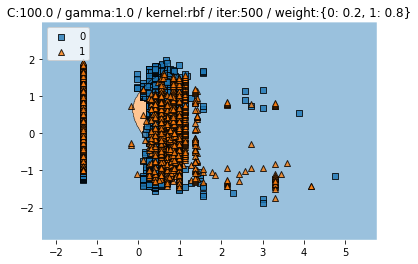

Train CV accuracy scores: [0.76501035 0.76501035 0.79481865 0.70124481 0.6939834 ]
Train CV accuracy: 0.744 +/- 0.039
Train CV f1 scores: [0.74573733 0.76552245 0.78710701 0.70295652 0.69013617]
Train CV f1: 0.738 +/- 0.037


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7739495798319328
Test f1 :  0.7365328109696375


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


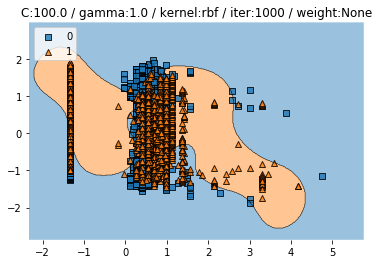

Train CV accuracy scores: [0.86749482 0.8426501  0.88704663 0.76763485 0.87136929]
Train CV accuracy: 0.847 +/- 0.042
Train CV f1 scores: [0.86638497 0.84308949 0.88413356 0.76777888 0.8695575 ]
Train CV f1: 0.846 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8571428571428571
Test f1 :  0.8471223021582733


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


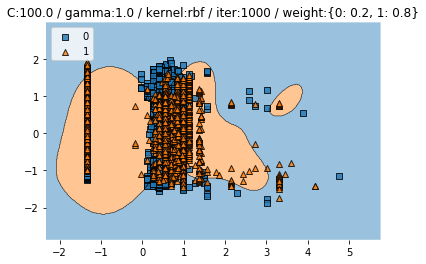

Train CV accuracy scores: [0.9047619  0.84886128 0.89015544 0.79045643 0.86825726]
Train CV accuracy: 0.860 +/- 0.040
Train CV f1 scores: [0.90386424 0.84975028 0.88832216 0.79010012 0.86861107]
Train CV f1: 0.860 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9361344537815126
Test f1 :  0.9284369114877589
780.5824074745178 secs


In [13]:
# blog rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(3,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


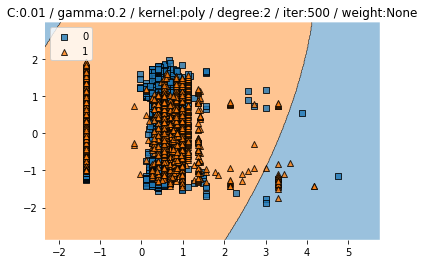

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


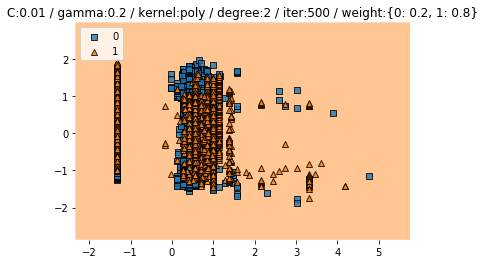

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


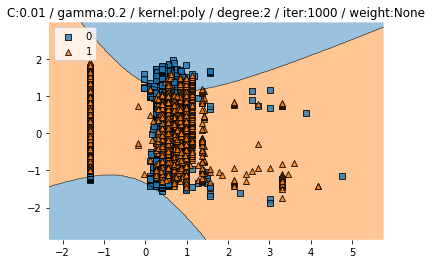

Train CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Train CV accuracy: 0.469 +/- 0.095
Train CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Train CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


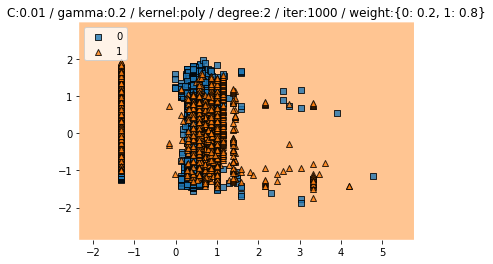

Train CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


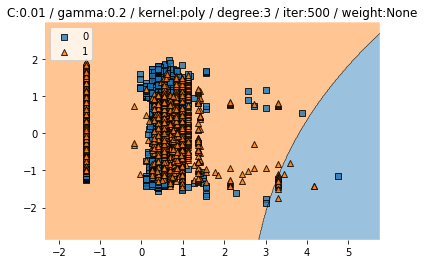

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


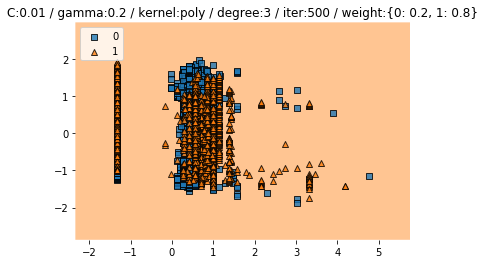

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


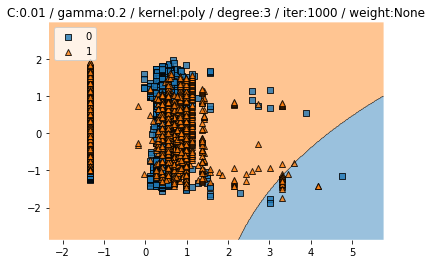

Train CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Train CV accuracy: 0.469 +/- 0.095
Train CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Train CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


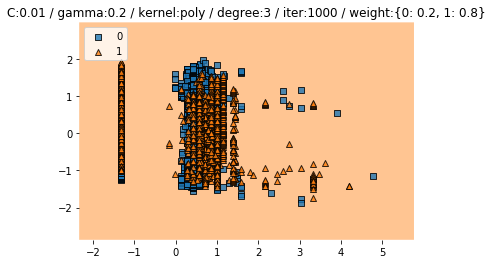

Train CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


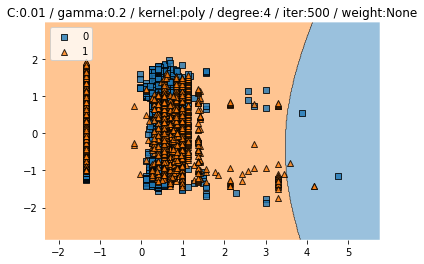

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


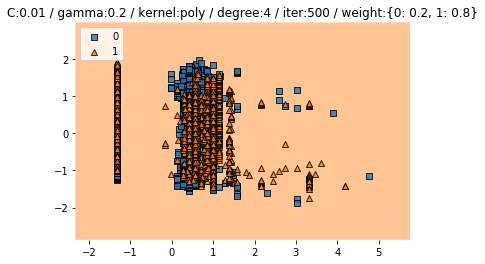

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


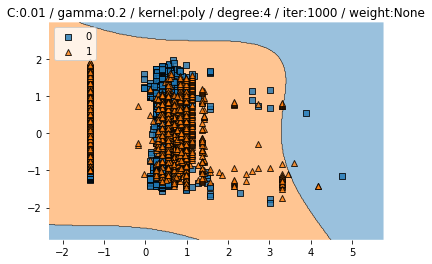

Train CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Train CV accuracy: 0.469 +/- 0.095
Train CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Train CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


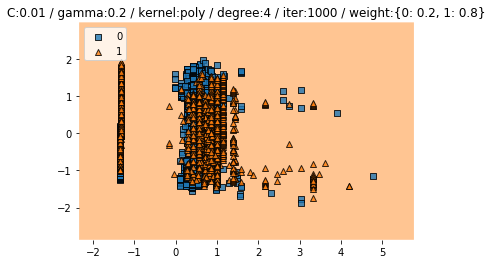

Train CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


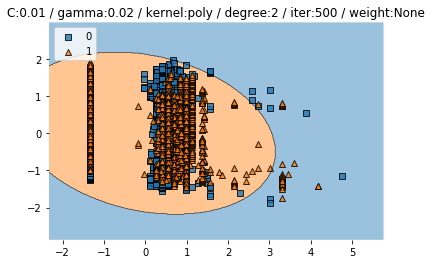

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


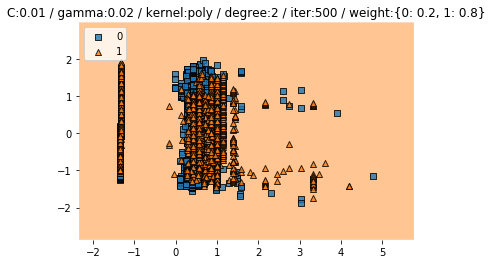

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


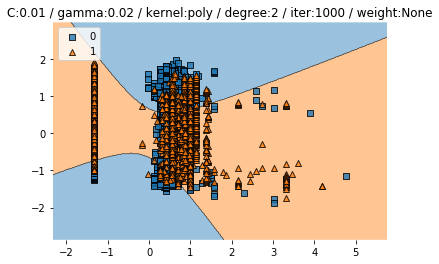

Train CV accuracy scores: [0.42339545 0.53519669 0.42279793 0.42323651 0.43568465]
Train CV accuracy: 0.448 +/- 0.044
Train CV f1 scores: [0.2518818  0.48170095 0.25127685 0.25172084 0.28167569]
Train CV f1: 0.304 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


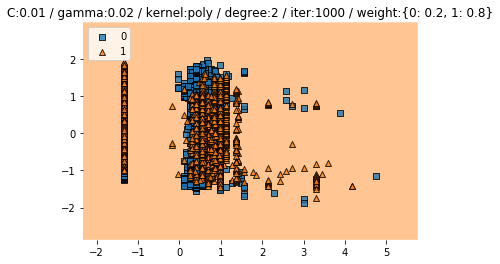

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


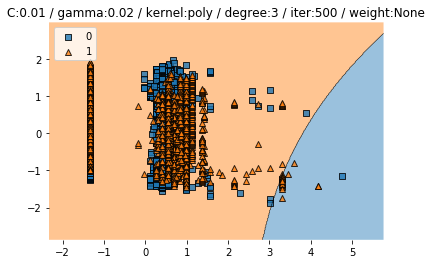

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


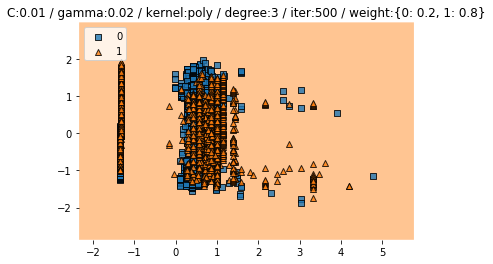

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


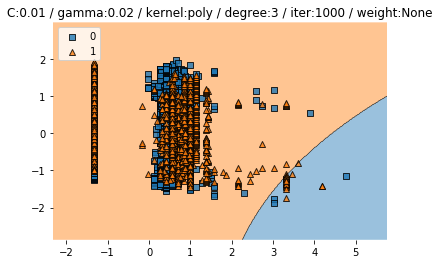

Train CV accuracy scores: [0.42339545 0.53519669 0.42279793 0.42323651 0.43568465]
Train CV accuracy: 0.448 +/- 0.044
Train CV f1 scores: [0.2518818  0.48170095 0.25127685 0.25172084 0.28167569]
Train CV f1: 0.304 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


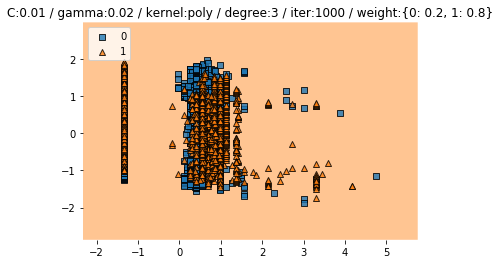

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


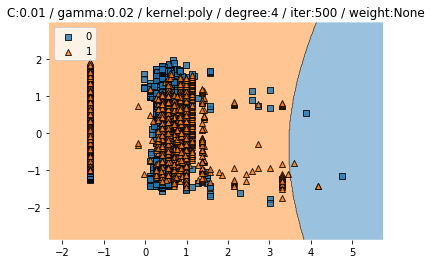

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


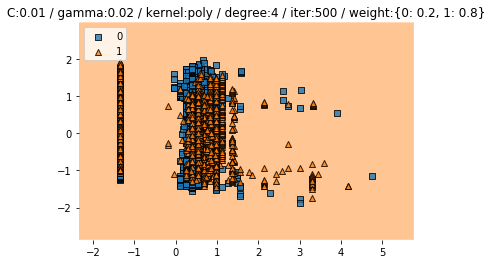

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


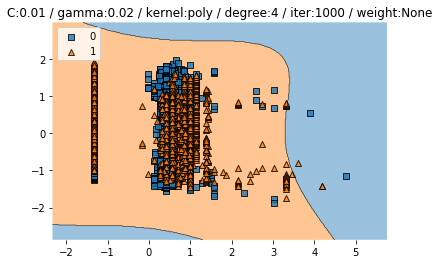

Train CV accuracy scores: [0.42339545 0.53519669 0.42279793 0.42323651 0.43568465]
Train CV accuracy: 0.448 +/- 0.044
Train CV f1 scores: [0.2518818  0.48170095 0.25127685 0.25172084 0.28167569]
Train CV f1: 0.304 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


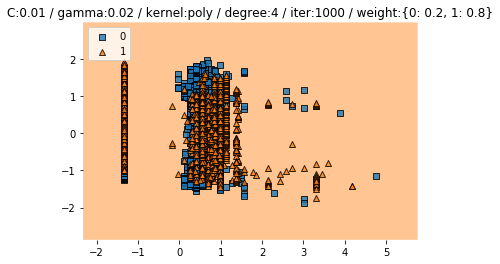

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


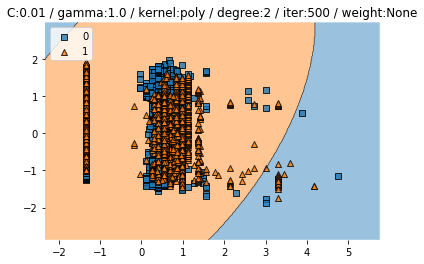

Train CV accuracy scores: [0.42339545 0.42443064 0.4134715  0.42323651 0.42323651]
Train CV accuracy: 0.422 +/- 0.004
Train CV f1 scores: [0.2518818  0.25593397 0.24913016 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4689075630252101
Test f1 :  0.6384439359267735


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


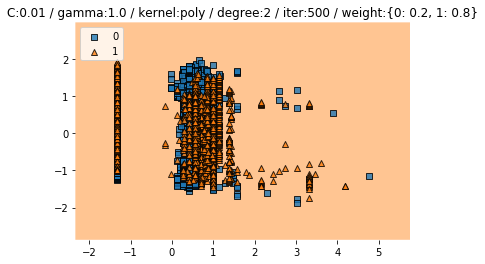

Train CV accuracy scores: [0.42236025 0.43271222 0.40310881 0.41493776 0.42116183]
Train CV accuracy: 0.419 +/- 0.010
Train CV f1 scores: [0.25144882 0.27187859 0.24466824 0.24823256 0.25085259]
Train CV f1: 0.253 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


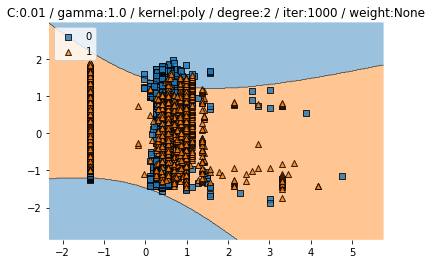

Train CV accuracy scores: [0.42339545 0.66977226 0.41761658 0.43983402 0.42842324]
Train CV accuracy: 0.476 +/- 0.097
Train CV f1 scores: [0.2518818  0.66718718 0.25089713 0.29506091 0.26292254]
Train CV f1: 0.346 +/- 0.162


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4781512605042017
Test f1 :  0.6428982173663025


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


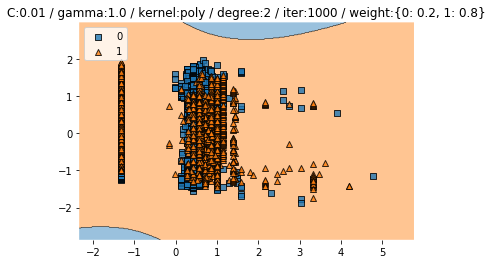

Train CV accuracy scores: [0.42132505 0.54451346 0.40414508 0.41804979 0.4159751 ]
Train CV accuracy: 0.441 +/- 0.052
Train CV f1 scores: [0.25101522 0.47896186 0.24511732 0.24954545 0.25045632]
Train CV f1: 0.295 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6372492836676217


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


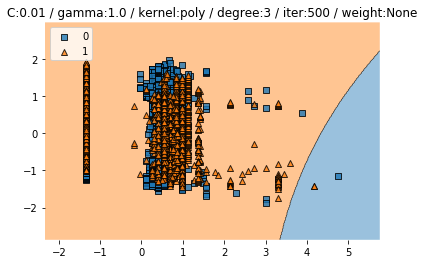

Train CV accuracy scores: [0.42339545 0.42443064 0.4134715  0.42323651 0.42323651]
Train CV accuracy: 0.422 +/- 0.004
Train CV f1 scores: [0.2518818  0.25593397 0.24913016 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4689075630252101
Test f1 :  0.6384439359267735


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


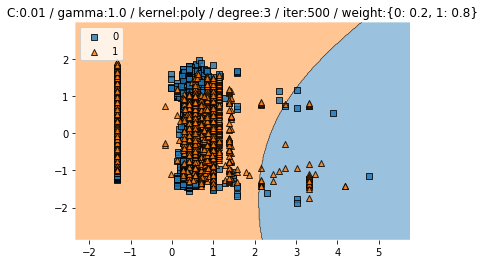

Train CV accuracy scores: [0.42236025 0.43271222 0.40310881 0.41493776 0.42116183]
Train CV accuracy: 0.419 +/- 0.010
Train CV f1 scores: [0.25144882 0.27187859 0.24466824 0.24823256 0.25085259]
Train CV f1: 0.253 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


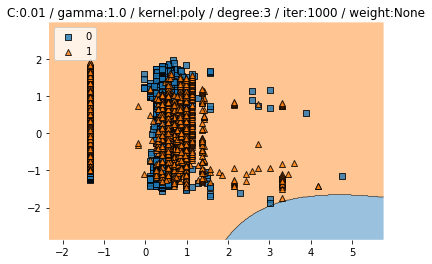

Train CV accuracy scores: [0.42339545 0.66977226 0.41761658 0.43983402 0.42842324]
Train CV accuracy: 0.476 +/- 0.097
Train CV f1 scores: [0.2518818  0.66718718 0.25089713 0.29506091 0.26292254]
Train CV f1: 0.346 +/- 0.162


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4781512605042017
Test f1 :  0.6428982173663025


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


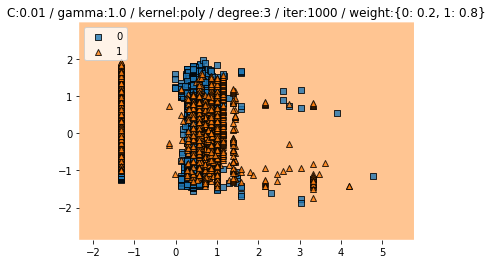

Train CV accuracy scores: [0.42132505 0.54451346 0.40414508 0.41804979 0.4159751 ]
Train CV accuracy: 0.441 +/- 0.052
Train CV f1 scores: [0.25101522 0.47896186 0.24511732 0.24954545 0.25045632]
Train CV f1: 0.295 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6372492836676217


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


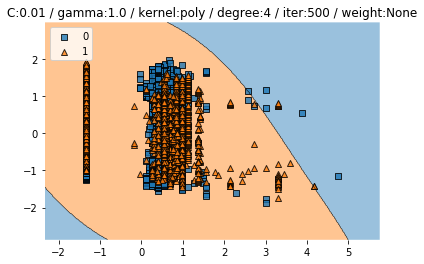

Train CV accuracy scores: [0.42339545 0.42443064 0.4134715  0.42323651 0.42323651]
Train CV accuracy: 0.422 +/- 0.004
Train CV f1 scores: [0.2518818  0.25593397 0.24913016 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4689075630252101
Test f1 :  0.6384439359267735


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


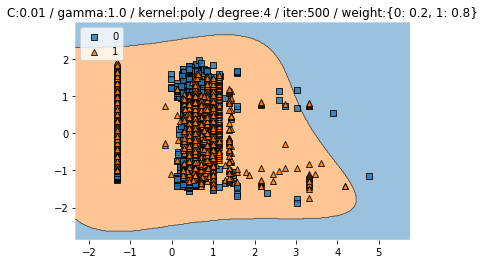

Train CV accuracy scores: [0.42236025 0.43271222 0.40310881 0.41493776 0.42116183]
Train CV accuracy: 0.419 +/- 0.010
Train CV f1 scores: [0.25144882 0.27187859 0.24466824 0.24823256 0.25085259]
Train CV f1: 0.253 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


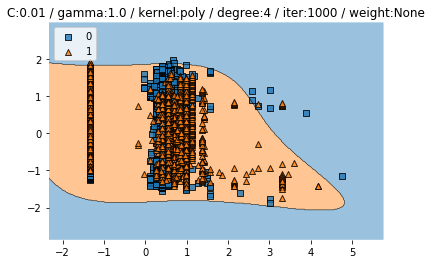

Train CV accuracy scores: [0.42339545 0.66977226 0.41761658 0.43983402 0.42842324]
Train CV accuracy: 0.476 +/- 0.097
Train CV f1 scores: [0.2518818  0.66718718 0.25089713 0.29506091 0.26292254]
Train CV f1: 0.346 +/- 0.162


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4781512605042017
Test f1 :  0.6428982173663025


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


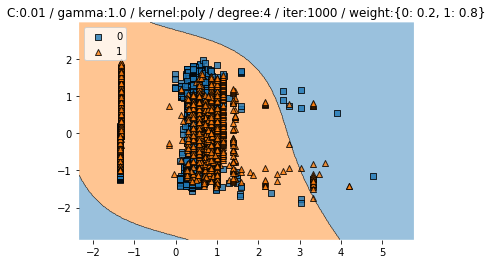

Train CV accuracy scores: [0.42132505 0.54451346 0.40414508 0.41804979 0.4159751 ]
Train CV accuracy: 0.441 +/- 0.052
Train CV f1 scores: [0.25101522 0.47896186 0.24511732 0.24954545 0.25045632]
Train CV f1: 0.295 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6372492836676217


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


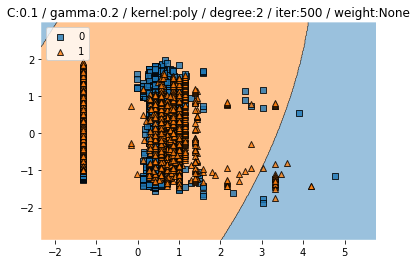

Train CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Train CV accuracy: 0.427 +/- 0.041
Train CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Train CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


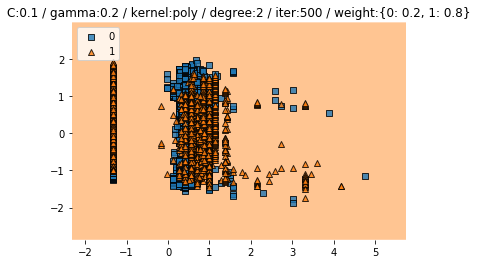

Train CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.005
Train CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


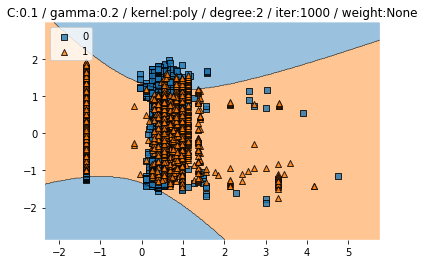

Train CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Train CV accuracy: 0.550 +/- 0.161
Train CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Train CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


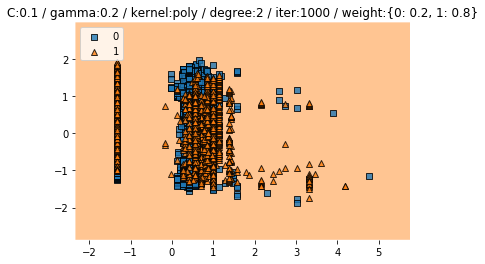

Train CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Train CV accuracy: 0.420 +/- 0.005
Train CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Train CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


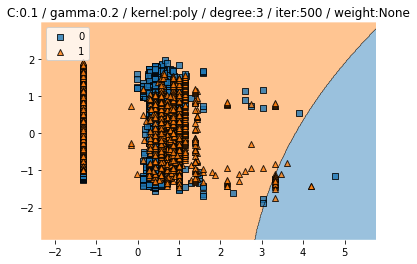

Train CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Train CV accuracy: 0.427 +/- 0.041
Train CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Train CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


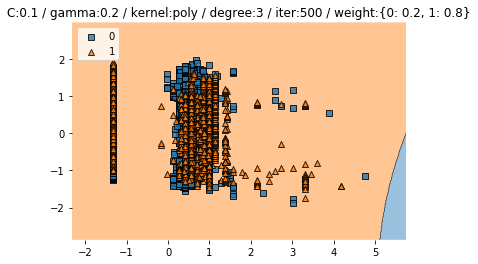

Train CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.005
Train CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


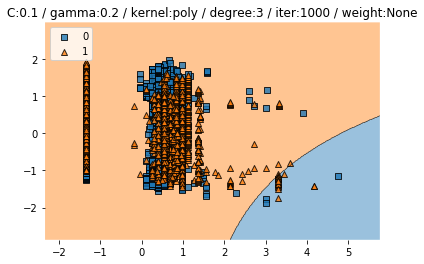

Train CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Train CV accuracy: 0.550 +/- 0.161
Train CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Train CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


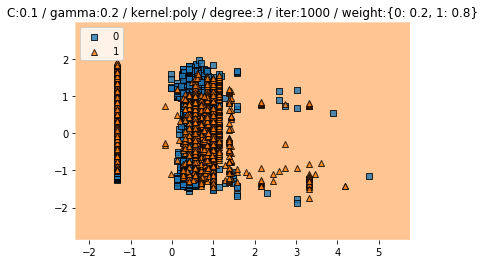

Train CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Train CV accuracy: 0.420 +/- 0.005
Train CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Train CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


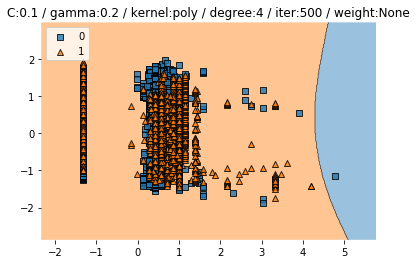

Train CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Train CV accuracy: 0.427 +/- 0.041
Train CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Train CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


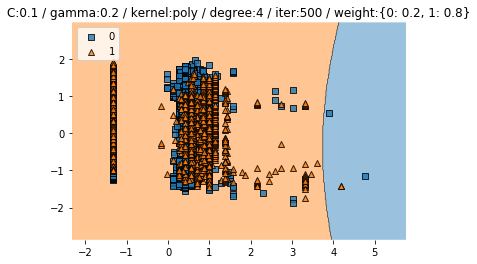

Train CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.005
Train CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


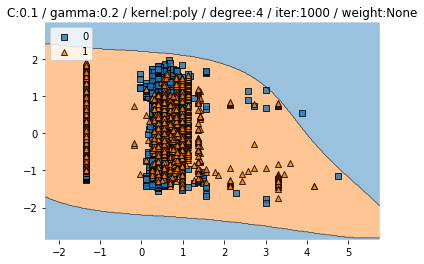

Train CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Train CV accuracy: 0.550 +/- 0.161
Train CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Train CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


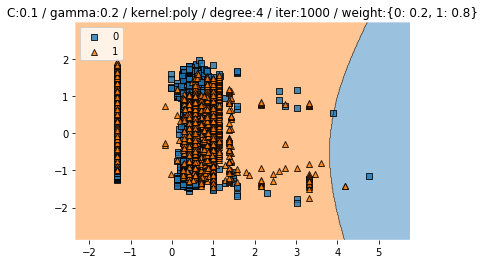

Train CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Train CV accuracy: 0.420 +/- 0.005
Train CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Train CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


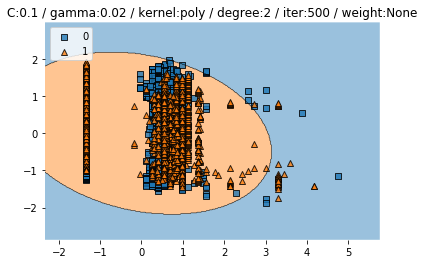

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


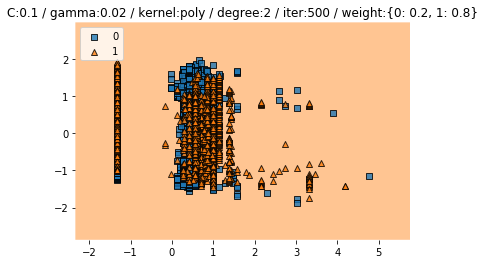

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


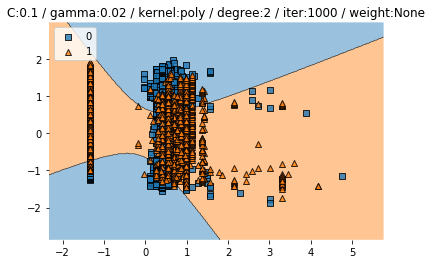

Train CV accuracy scores: [0.42339545 0.53416149 0.42279793 0.42323651 0.43568465]
Train CV accuracy: 0.448 +/- 0.043
Train CV f1 scores: [0.2518818  0.4809247  0.25127685 0.25172084 0.28167569]
Train CV f1: 0.303 +/- 0.089


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


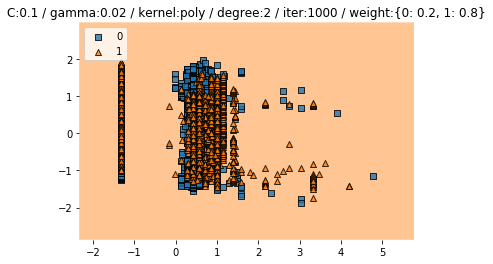

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


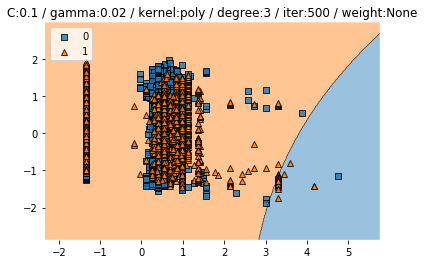

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


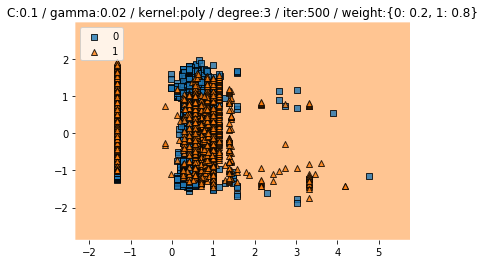

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


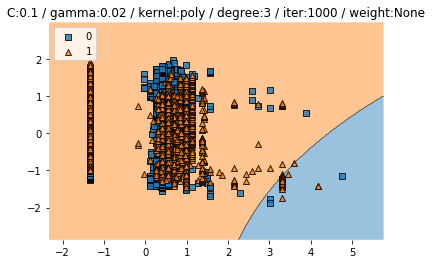

Train CV accuracy scores: [0.42339545 0.53416149 0.42279793 0.42323651 0.43568465]
Train CV accuracy: 0.448 +/- 0.043
Train CV f1 scores: [0.2518818  0.4809247  0.25127685 0.25172084 0.28167569]
Train CV f1: 0.303 +/- 0.089


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


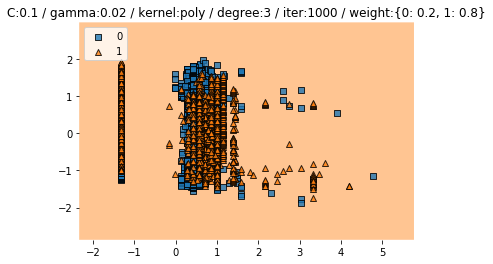

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


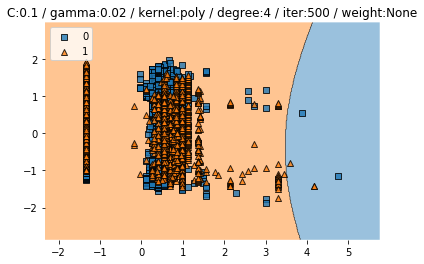

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


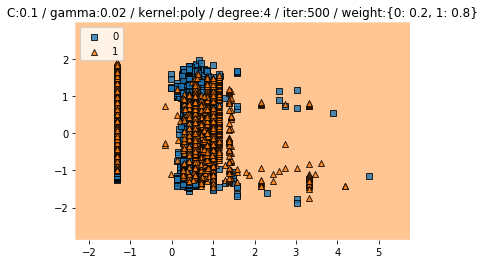

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


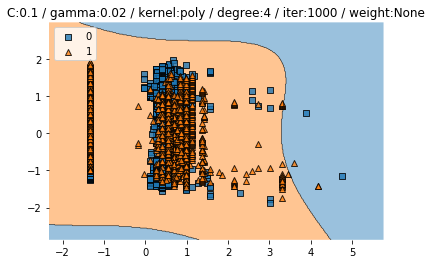

Train CV accuracy scores: [0.42339545 0.53416149 0.42279793 0.42323651 0.43568465]
Train CV accuracy: 0.448 +/- 0.043
Train CV f1 scores: [0.2518818  0.4809247  0.25127685 0.25172084 0.28167569]
Train CV f1: 0.303 +/- 0.089


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


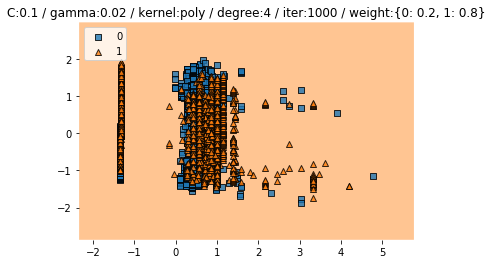

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


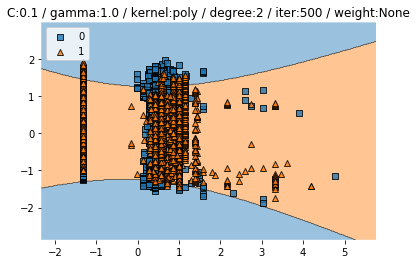

Train CV accuracy scores: [0.41511387 0.42236025 0.48601036 0.42323651 0.42219917]
Train CV accuracy: 0.434 +/- 0.026
Train CV f1 scores: [0.24840025 0.2585917  0.39237704 0.25172084 0.25309938]
Train CV f1: 0.281 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6249261665682221


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


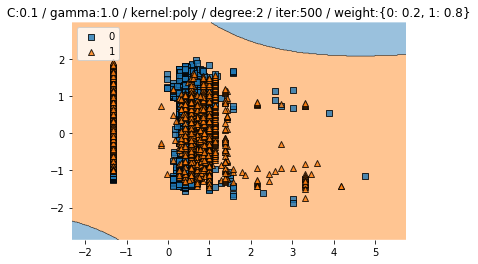

Train CV accuracy scores: [0.41614907 0.5610766  0.40725389 0.4253112  0.60165975]
Train CV accuracy: 0.482 +/- 0.082
Train CV f1 scores: [0.24883767 0.50349271 0.27554234 0.25622282 0.5754382 ]
Train CV f1: 0.372 +/- 0.139


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


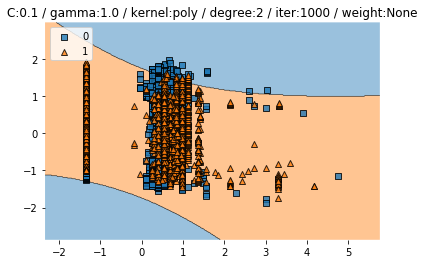

Train CV accuracy scores: [0.42339545 0.49585921 0.40932642 0.41908714 0.62136929]
Train CV accuracy: 0.474 +/- 0.080
Train CV f1 scores: [0.25369495 0.4066124  0.24735307 0.2499818  0.59099099]
Train CV f1: 0.350 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6345381526104418


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


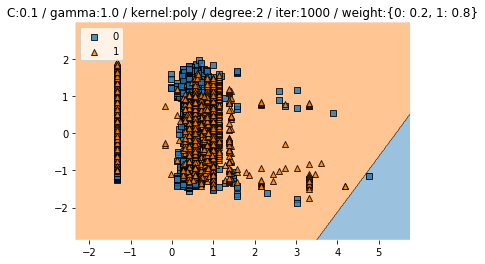

Train CV accuracy scores: [0.58385093 0.50517598 0.43108808 0.42323651 0.41804979]
Train CV accuracy: 0.472 +/- 0.064
Train CV f1 scores: [0.54087109 0.41159737 0.31376351 0.28373242 0.26846907]
Train CV f1: 0.364 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6277030976037405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


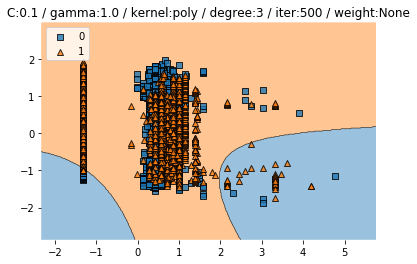

Train CV accuracy scores: [0.41511387 0.42236025 0.48601036 0.42323651 0.42219917]
Train CV accuracy: 0.434 +/- 0.026
Train CV f1 scores: [0.24840025 0.2585917  0.39237704 0.25172084 0.25309938]
Train CV f1: 0.281 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6249261665682221


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


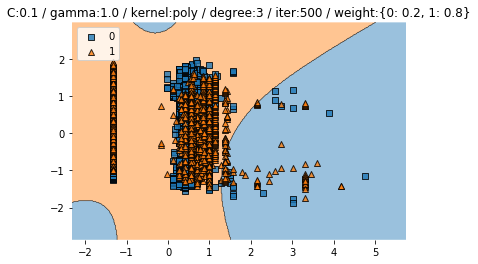

Train CV accuracy scores: [0.41614907 0.5610766  0.40725389 0.4253112  0.60165975]
Train CV accuracy: 0.482 +/- 0.082
Train CV f1 scores: [0.24883767 0.50349271 0.27554234 0.25622282 0.5754382 ]
Train CV f1: 0.372 +/- 0.139


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


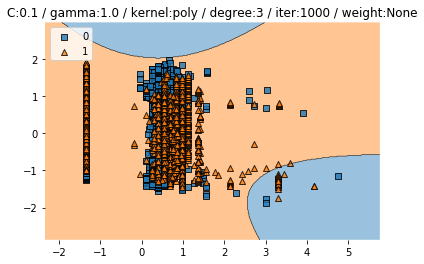

Train CV accuracy scores: [0.42339545 0.49585921 0.40932642 0.41908714 0.62136929]
Train CV accuracy: 0.474 +/- 0.080
Train CV f1 scores: [0.25369495 0.4066124  0.24735307 0.2499818  0.59099099]
Train CV f1: 0.350 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6345381526104418


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


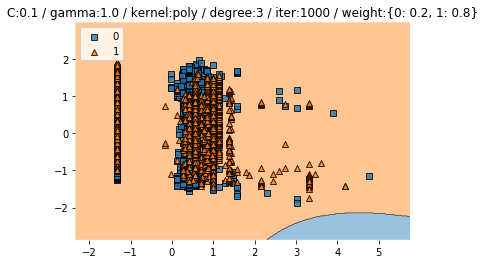

Train CV accuracy scores: [0.58385093 0.50517598 0.43108808 0.42323651 0.41804979]
Train CV accuracy: 0.472 +/- 0.064
Train CV f1 scores: [0.54087109 0.41159737 0.31376351 0.28373242 0.26846907]
Train CV f1: 0.364 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6277030976037405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


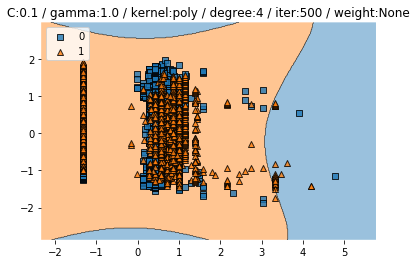

Train CV accuracy scores: [0.41511387 0.42236025 0.48601036 0.42323651 0.42219917]
Train CV accuracy: 0.434 +/- 0.026
Train CV f1 scores: [0.24840025 0.2585917  0.39237704 0.25172084 0.25309938]
Train CV f1: 0.281 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6249261665682221


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


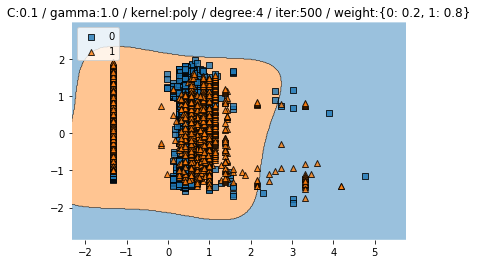

Train CV accuracy scores: [0.41614907 0.5610766  0.40725389 0.4253112  0.60165975]
Train CV accuracy: 0.482 +/- 0.082
Train CV f1 scores: [0.24883767 0.50349271 0.27554234 0.25622282 0.5754382 ]
Train CV f1: 0.372 +/- 0.139


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


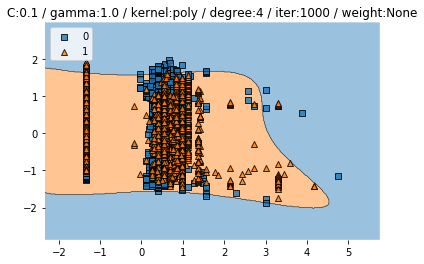

Train CV accuracy scores: [0.42339545 0.49585921 0.40932642 0.41908714 0.62136929]
Train CV accuracy: 0.474 +/- 0.080
Train CV f1 scores: [0.25369495 0.4066124  0.24735307 0.2499818  0.59099099]
Train CV f1: 0.350 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6345381526104418


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


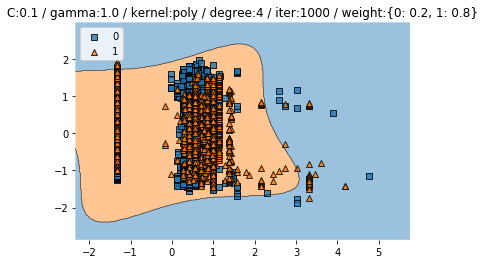

Train CV accuracy scores: [0.58385093 0.50517598 0.43108808 0.42323651 0.41804979]
Train CV accuracy: 0.472 +/- 0.064
Train CV f1 scores: [0.54087109 0.41159737 0.31376351 0.28373242 0.26846907]
Train CV f1: 0.364 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6277030976037405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


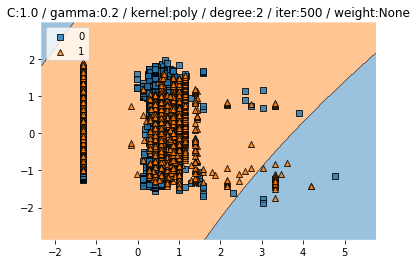

Train CV accuracy scores: [0.42236025 0.42443064 0.4134715  0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.004
Train CV f1 scores: [0.25144882 0.25593397 0.24913016 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6340057636887608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


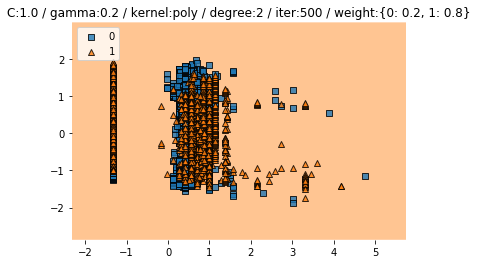

Train CV accuracy scores: [0.41304348 0.42236025 0.3865285  0.42323651 0.42323651]
Train CV accuracy: 0.414 +/- 0.014
Train CV f1 scores: [0.25104586 0.25682876 0.24550506 0.25172084 0.25353771]
Train CV f1: 0.252 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6356855995410212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


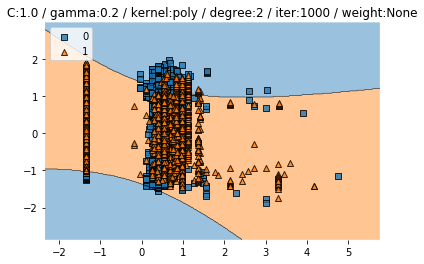

Train CV accuracy scores: [0.4389234  0.6563147  0.41761658 0.45539419 0.4253112 ]
Train CV accuracy: 0.479 +/- 0.090
Train CV f1 scores: [0.28490141 0.65387166 0.25089713 0.33570148 0.25622282]
Train CV f1: 0.356 +/- 0.152


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5134453781512605
Test f1 :  0.6551518761167361


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


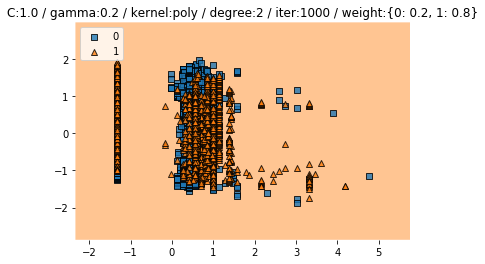

Train CV accuracy scores: [0.42028986 0.46376812 0.39481865 0.39107884 0.42116183]
Train CV accuracy: 0.418 +/- 0.026
Train CV f1 scores: [0.25238067 0.34034504 0.26487226 0.24132129 0.25266044]
Train CV f1: 0.270 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


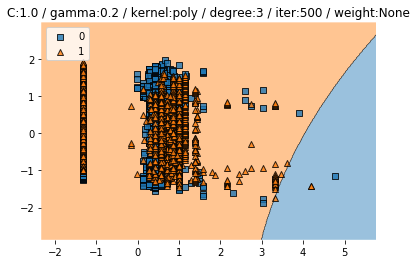

Train CV accuracy scores: [0.42236025 0.42443064 0.4134715  0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.004
Train CV f1 scores: [0.25144882 0.25593397 0.24913016 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6340057636887608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


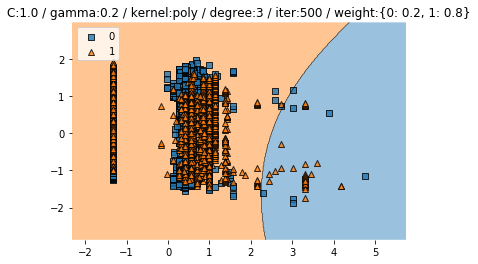

Train CV accuracy scores: [0.41304348 0.42236025 0.3865285  0.42323651 0.42323651]
Train CV accuracy: 0.414 +/- 0.014
Train CV f1 scores: [0.25104586 0.25682876 0.24550506 0.25172084 0.25353771]
Train CV f1: 0.252 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6356855995410212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


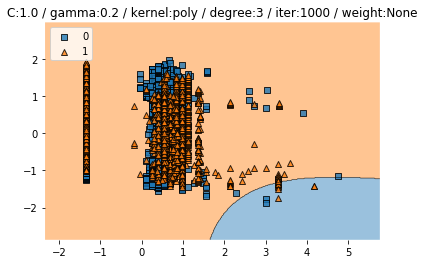

Train CV accuracy scores: [0.4389234  0.6563147  0.41761658 0.45539419 0.4253112 ]
Train CV accuracy: 0.479 +/- 0.090
Train CV f1 scores: [0.28490141 0.65387166 0.25089713 0.33570148 0.25622282]
Train CV f1: 0.356 +/- 0.152


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5134453781512605
Test f1 :  0.6551518761167361


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


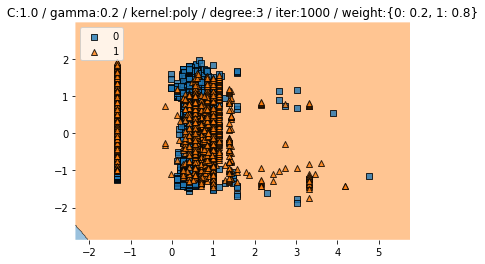

Train CV accuracy scores: [0.42028986 0.46376812 0.39481865 0.39107884 0.42116183]
Train CV accuracy: 0.418 +/- 0.026
Train CV f1 scores: [0.25238067 0.34034504 0.26487226 0.24132129 0.25266044]
Train CV f1: 0.270 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


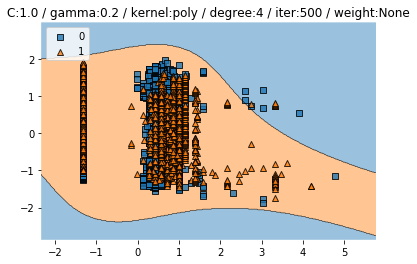

Train CV accuracy scores: [0.42236025 0.42443064 0.4134715  0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.004
Train CV f1 scores: [0.25144882 0.25593397 0.24913016 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6340057636887608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


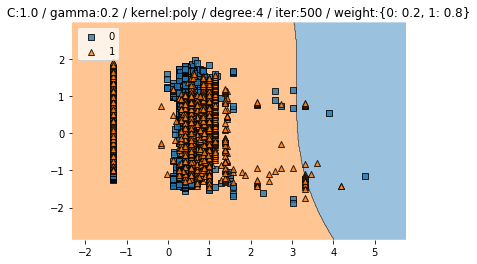

Train CV accuracy scores: [0.41304348 0.42236025 0.3865285  0.42323651 0.42323651]
Train CV accuracy: 0.414 +/- 0.014
Train CV f1 scores: [0.25104586 0.25682876 0.24550506 0.25172084 0.25353771]
Train CV f1: 0.252 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6356855995410212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


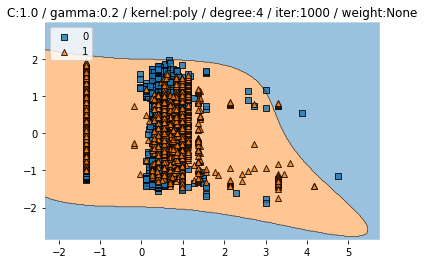

Train CV accuracy scores: [0.4389234  0.6563147  0.41761658 0.45539419 0.4253112 ]
Train CV accuracy: 0.479 +/- 0.090
Train CV f1 scores: [0.28490141 0.65387166 0.25089713 0.33570148 0.25622282]
Train CV f1: 0.356 +/- 0.152


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5134453781512605
Test f1 :  0.6551518761167361


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


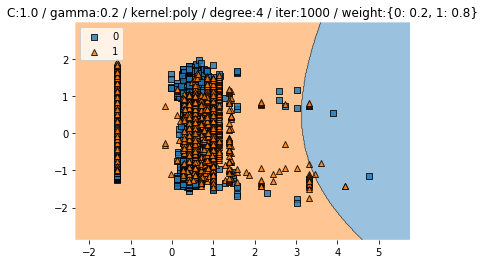

Train CV accuracy scores: [0.42028986 0.46376812 0.39481865 0.39107884 0.42116183]
Train CV accuracy: 0.418 +/- 0.026
Train CV f1 scores: [0.25238067 0.34034504 0.26487226 0.24132129 0.25266044]
Train CV f1: 0.270 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


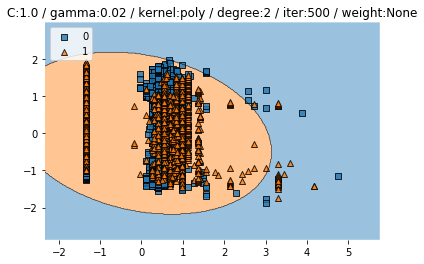

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


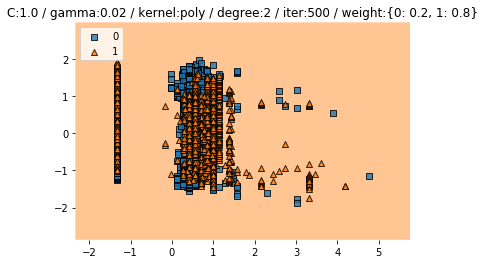

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


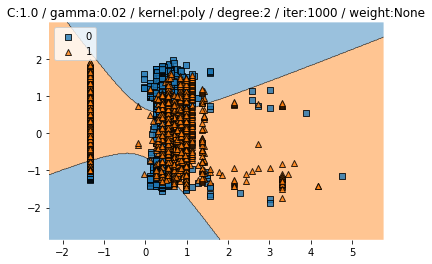

Train CV accuracy scores: [0.42339545 0.42443064 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.2541318  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


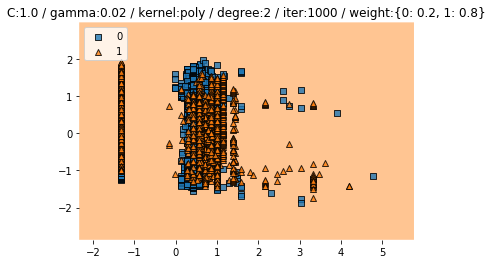

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


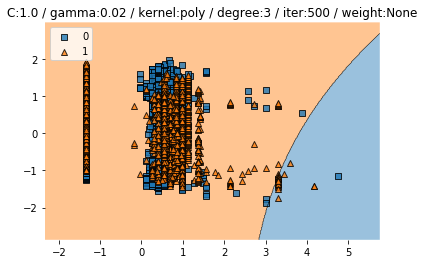

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


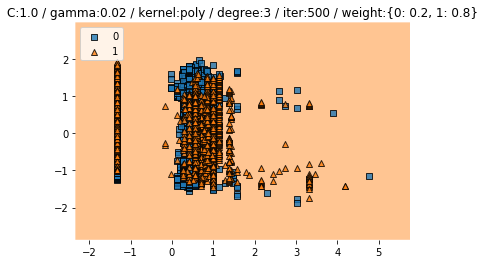

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


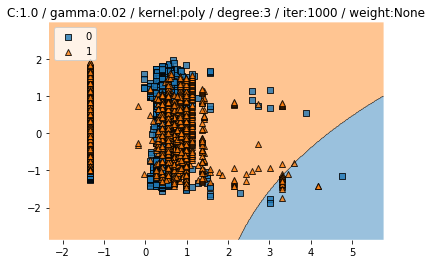

Train CV accuracy scores: [0.42339545 0.42443064 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.2541318  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


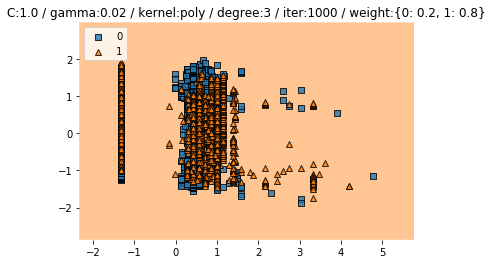

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


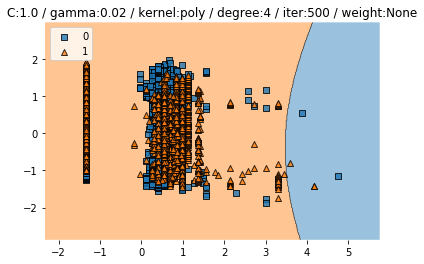

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


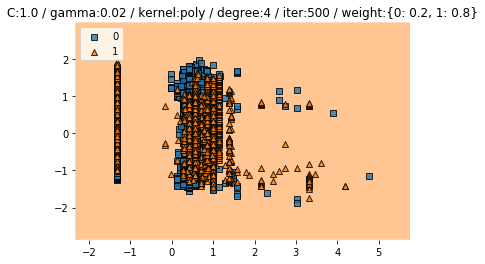

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


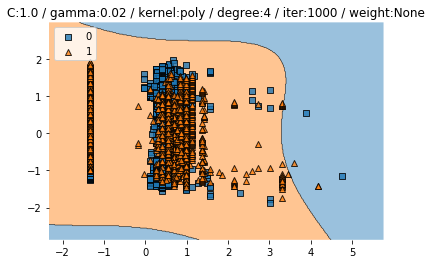

Train CV accuracy scores: [0.42339545 0.42443064 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.2541318  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


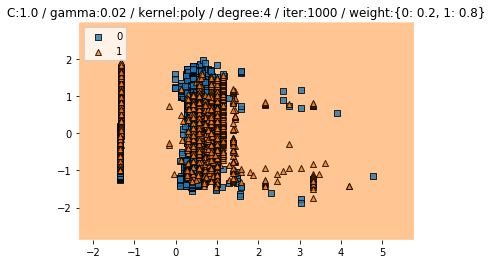

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


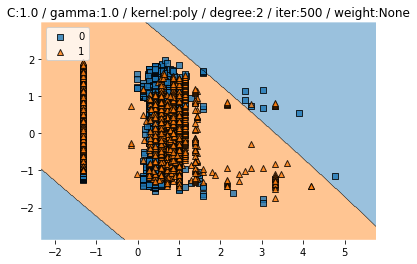

Train CV accuracy scores: [0.46273292 0.45859213 0.54818653 0.39004149 0.42738589]
Train CV accuracy: 0.457 +/- 0.052
Train CV f1 scores: [0.35048922 0.36619352 0.54904449 0.23751781 0.26941287]
Train CV f1: 0.355 +/- 0.109


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47394957983193275
Test f1 :  0.6317647058823529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


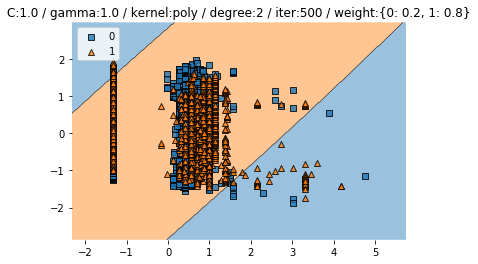

Train CV accuracy scores: [0.41614907 0.44616977 0.4238342  0.4159751  0.39419087]
Train CV accuracy: 0.419 +/- 0.017
Train CV f1 scores: [0.24883767 0.36490039 0.33556941 0.25572245 0.32063698]
Train CV f1: 0.305 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47983193277310926
Test f1 :  0.639067055393586


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


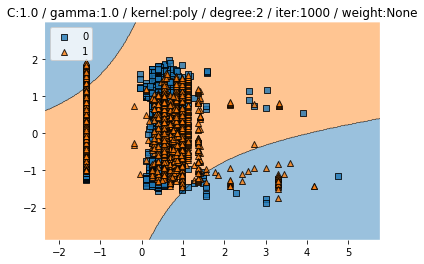

Train CV accuracy scores: [0.41097308 0.58902692 0.3761658  0.44190871 0.37655602]
Train CV accuracy: 0.439 +/- 0.079
Train CV f1 scores: [0.25014908 0.55171182 0.23596423 0.31855081 0.24109358]
Train CV f1: 0.319 +/- 0.120


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4512605042016807
Test f1 :  0.5996321275291232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


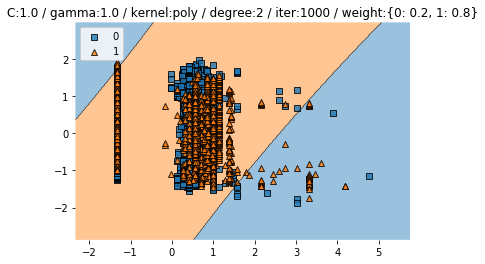

Train CV accuracy scores: [0.41614907 0.45031056 0.43419689 0.40871369 0.43360996]
Train CV accuracy: 0.429 +/- 0.015
Train CV f1 scores: [0.24883767 0.35061932 0.31130643 0.24908383 0.29813387]
Train CV f1: 0.292 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6206088992974239


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


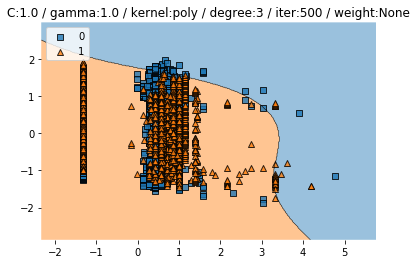

Train CV accuracy scores: [0.46273292 0.45859213 0.54818653 0.39004149 0.42738589]
Train CV accuracy: 0.457 +/- 0.052
Train CV f1 scores: [0.35048922 0.36619352 0.54904449 0.23751781 0.26941287]
Train CV f1: 0.355 +/- 0.109


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47394957983193275
Test f1 :  0.6317647058823529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


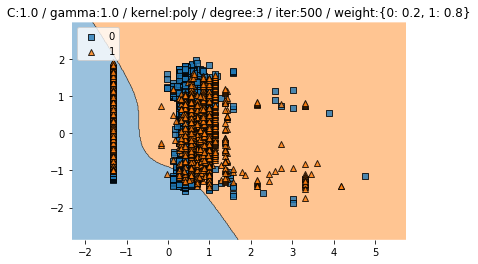

Train CV accuracy scores: [0.41614907 0.44616977 0.4238342  0.4159751  0.39419087]
Train CV accuracy: 0.419 +/- 0.017
Train CV f1 scores: [0.24883767 0.36490039 0.33556941 0.25572245 0.32063698]
Train CV f1: 0.305 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47983193277310926
Test f1 :  0.639067055393586


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


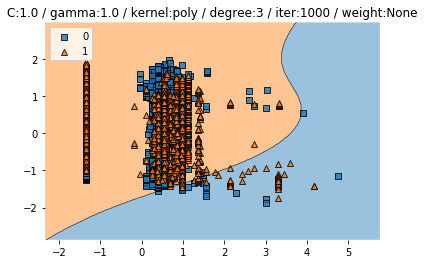

Train CV accuracy scores: [0.41097308 0.58902692 0.3761658  0.44190871 0.37655602]
Train CV accuracy: 0.439 +/- 0.079
Train CV f1 scores: [0.25014908 0.55171182 0.23596423 0.31855081 0.24109358]
Train CV f1: 0.319 +/- 0.120


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4512605042016807
Test f1 :  0.5996321275291232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


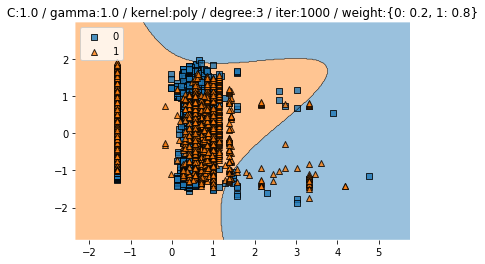

Train CV accuracy scores: [0.41614907 0.45031056 0.43419689 0.40871369 0.43360996]
Train CV accuracy: 0.429 +/- 0.015
Train CV f1 scores: [0.24883767 0.35061932 0.31130643 0.24908383 0.29813387]
Train CV f1: 0.292 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6206088992974239


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


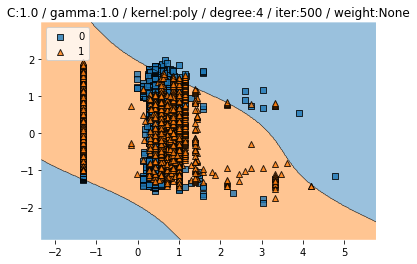

Train CV accuracy scores: [0.46273292 0.45859213 0.54818653 0.39004149 0.42738589]
Train CV accuracy: 0.457 +/- 0.052
Train CV f1 scores: [0.35048922 0.36619352 0.54904449 0.23751781 0.26941287]
Train CV f1: 0.355 +/- 0.109


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47394957983193275
Test f1 :  0.6317647058823529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


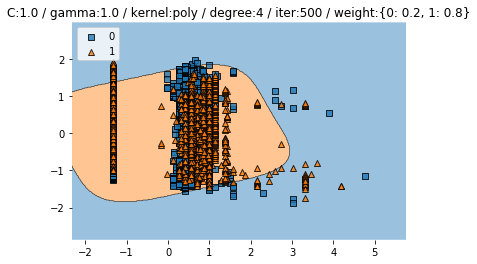

Train CV accuracy scores: [0.41614907 0.44616977 0.4238342  0.4159751  0.39419087]
Train CV accuracy: 0.419 +/- 0.017
Train CV f1 scores: [0.24883767 0.36490039 0.33556941 0.25572245 0.32063698]
Train CV f1: 0.305 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47983193277310926
Test f1 :  0.639067055393586


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


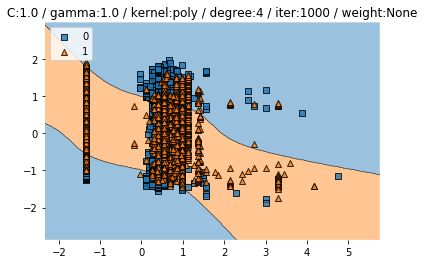

Train CV accuracy scores: [0.41097308 0.58902692 0.3761658  0.44190871 0.37655602]
Train CV accuracy: 0.439 +/- 0.079
Train CV f1 scores: [0.25014908 0.55171182 0.23596423 0.31855081 0.24109358]
Train CV f1: 0.319 +/- 0.120


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4512605042016807
Test f1 :  0.5996321275291232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


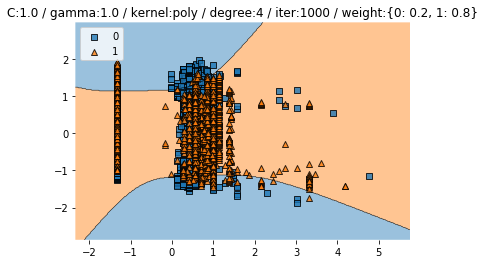

Train CV accuracy scores: [0.41614907 0.45031056 0.43419689 0.40871369 0.43360996]
Train CV accuracy: 0.429 +/- 0.015
Train CV f1 scores: [0.24883767 0.35061932 0.31130643 0.24908383 0.29813387]
Train CV f1: 0.292 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6206088992974239


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


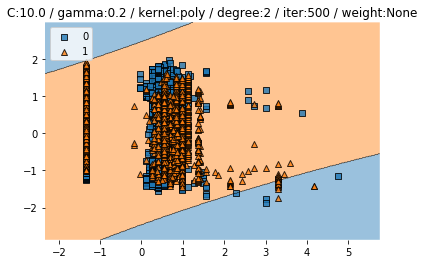

Train CV accuracy scores: [0.61801242 0.46583851 0.40414508 0.41286307 0.42323651]
Train CV accuracy: 0.465 +/- 0.079
Train CV f1 scores: [0.51388479 0.34010203 0.24511732 0.24912629 0.25172084]
Train CV f1: 0.320 +/- 0.103


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


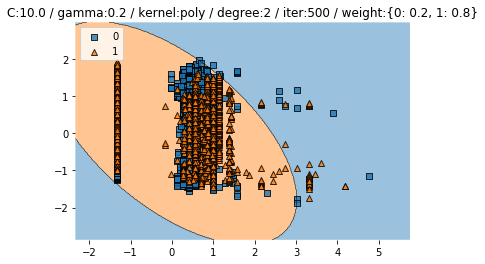

Train CV accuracy scores: [0.41925466 0.45341615 0.41036269 0.42323651 0.56639004]
Train CV accuracy: 0.455 +/- 0.058
Train CV f1 scores: [0.25014611 0.32185261 0.26299984 0.25172084 0.54717136]
Train CV f1: 0.327 +/- 0.113


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


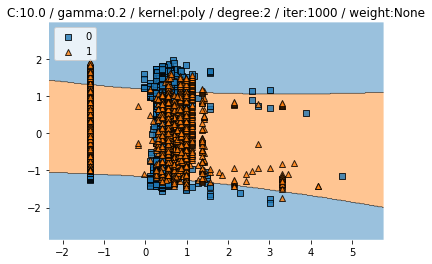

Train CV accuracy scores: [0.42132505 0.46066253 0.4642487  0.41286307 0.52385892]
Train CV accuracy: 0.457 +/- 0.039
Train CV f1 scores: [0.25101522 0.34134262 0.3684022  0.25262581 0.46236897]
Train CV f1: 0.335 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4823529411764706
Test f1 :  0.6376470588235293


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


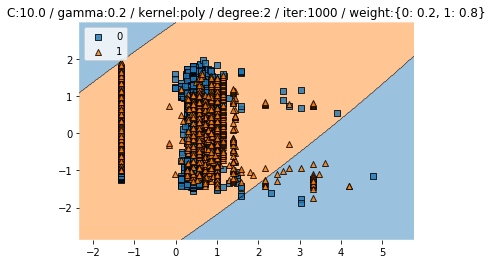

Train CV accuracy scores: [0.41718427 0.52795031 0.40621762 0.40975104 0.41493776]
Train CV accuracy: 0.435 +/- 0.047
Train CV f1 scores: [0.25106078 0.45364578 0.32900251 0.26618869 0.24823256]
Train CV f1: 0.310 +/- 0.078


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4613445378151261
Test f1 :  0.630972941853771


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


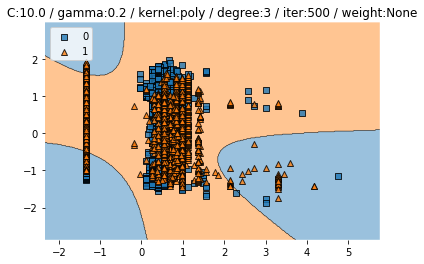

Train CV accuracy scores: [0.61801242 0.46583851 0.40414508 0.41286307 0.42323651]
Train CV accuracy: 0.465 +/- 0.079
Train CV f1 scores: [0.51388479 0.34010203 0.24511732 0.24912629 0.25172084]
Train CV f1: 0.320 +/- 0.103


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


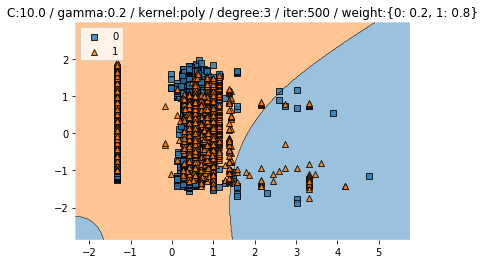

Train CV accuracy scores: [0.41925466 0.45341615 0.41036269 0.42323651 0.56639004]
Train CV accuracy: 0.455 +/- 0.058
Train CV f1 scores: [0.25014611 0.32185261 0.26299984 0.25172084 0.54717136]
Train CV f1: 0.327 +/- 0.113


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


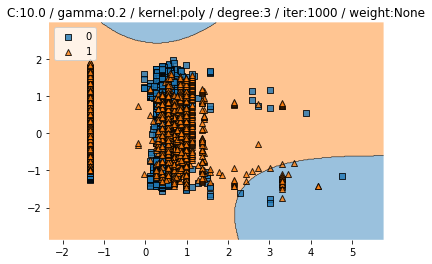

Train CV accuracy scores: [0.42132505 0.46066253 0.4642487  0.41286307 0.52385892]
Train CV accuracy: 0.457 +/- 0.039
Train CV f1 scores: [0.25101522 0.34134262 0.3684022  0.25262581 0.46236897]
Train CV f1: 0.335 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4823529411764706
Test f1 :  0.6376470588235293


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


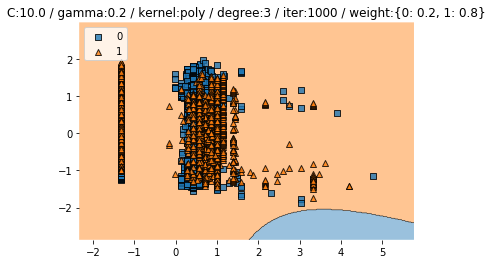

Train CV accuracy scores: [0.41718427 0.52795031 0.40621762 0.40975104 0.41493776]
Train CV accuracy: 0.435 +/- 0.047
Train CV f1 scores: [0.25106078 0.45364578 0.32900251 0.26618869 0.24823256]
Train CV f1: 0.310 +/- 0.078


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4613445378151261
Test f1 :  0.630972941853771


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


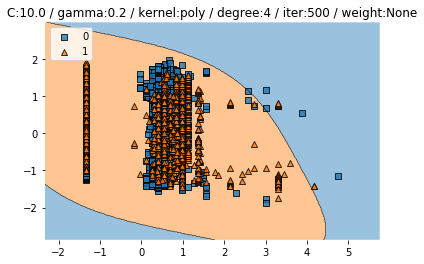

Train CV accuracy scores: [0.61801242 0.46583851 0.40414508 0.41286307 0.42323651]
Train CV accuracy: 0.465 +/- 0.079
Train CV f1 scores: [0.51388479 0.34010203 0.24511732 0.24912629 0.25172084]
Train CV f1: 0.320 +/- 0.103


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


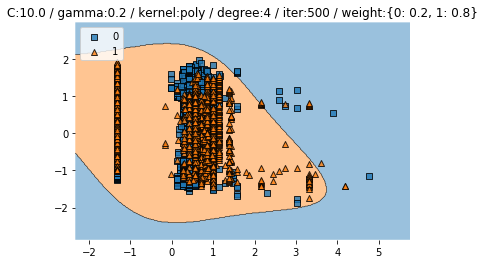

Train CV accuracy scores: [0.41925466 0.45341615 0.41036269 0.42323651 0.56639004]
Train CV accuracy: 0.455 +/- 0.058
Train CV f1 scores: [0.25014611 0.32185261 0.26299984 0.25172084 0.54717136]
Train CV f1: 0.327 +/- 0.113


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


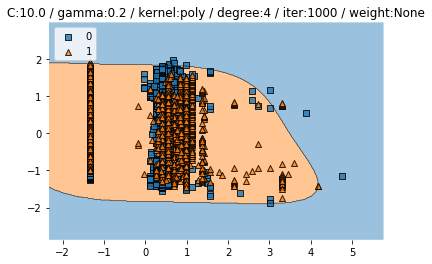

Train CV accuracy scores: [0.42132505 0.46066253 0.4642487  0.41286307 0.52385892]
Train CV accuracy: 0.457 +/- 0.039
Train CV f1 scores: [0.25101522 0.34134262 0.3684022  0.25262581 0.46236897]
Train CV f1: 0.335 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4823529411764706
Test f1 :  0.6376470588235293


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


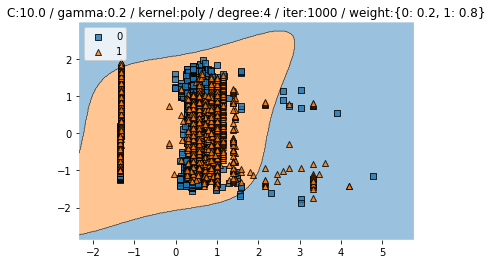

Train CV accuracy scores: [0.41718427 0.52795031 0.40621762 0.40975104 0.41493776]
Train CV accuracy: 0.435 +/- 0.047
Train CV f1 scores: [0.25106078 0.45364578 0.32900251 0.26618869 0.24823256]
Train CV f1: 0.310 +/- 0.078


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4613445378151261
Test f1 :  0.630972941853771


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


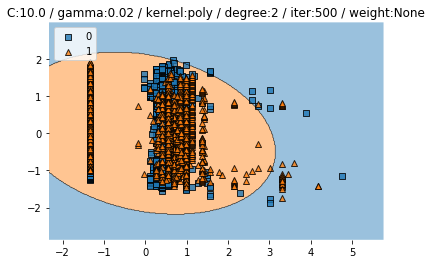

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


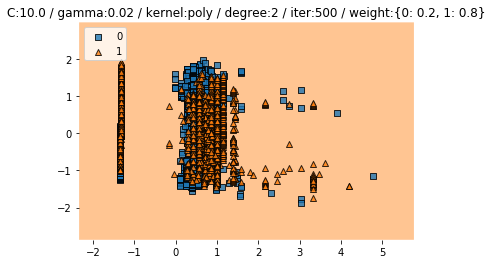

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


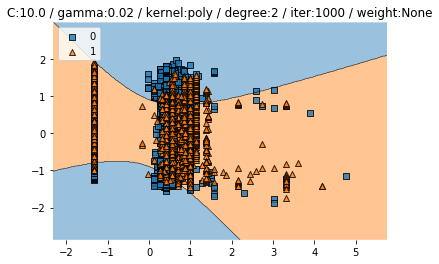

Train CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Train CV accuracy: 0.469 +/- 0.095
Train CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Train CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


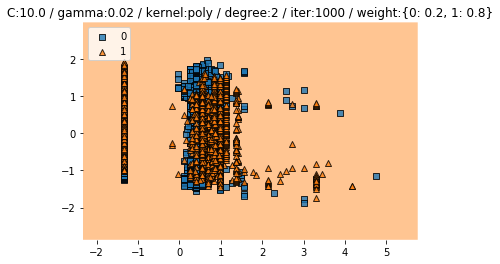

Train CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


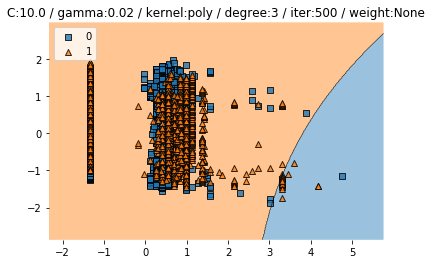

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


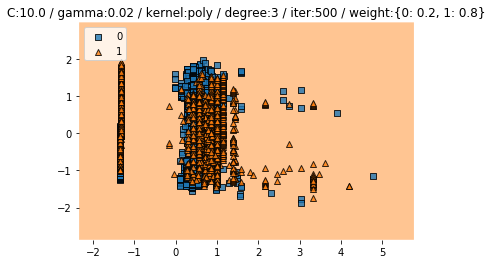

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


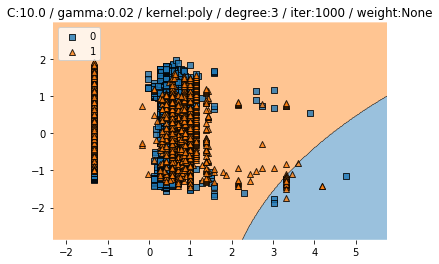

Train CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Train CV accuracy: 0.469 +/- 0.095
Train CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Train CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


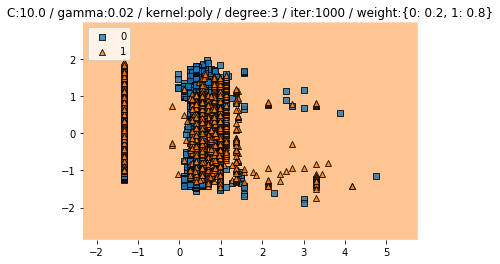

Train CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


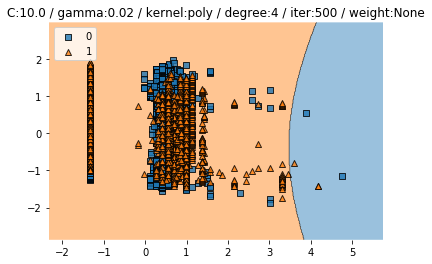

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


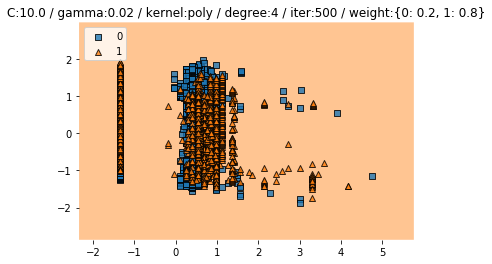

Train CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.000
Train CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


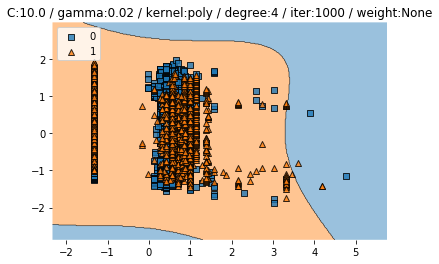

Train CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Train CV accuracy: 0.469 +/- 0.095
Train CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Train CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


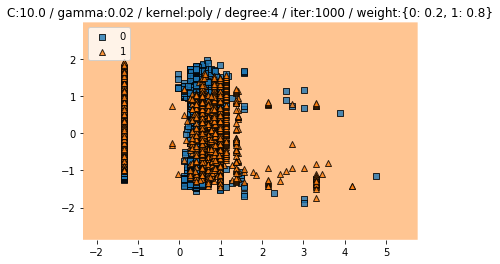

Train CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Train CV accuracy: 0.423 +/- 0.001
Train CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


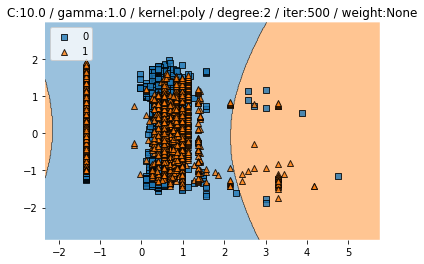

Train CV accuracy scores: [0.42132505 0.53623188 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.445 +/- 0.053
Train CV f1 scores: [0.25460821 0.4770111  0.28538097 0.2738725  0.37280571]
Train CV f1: 0.333 +/- 0.083


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


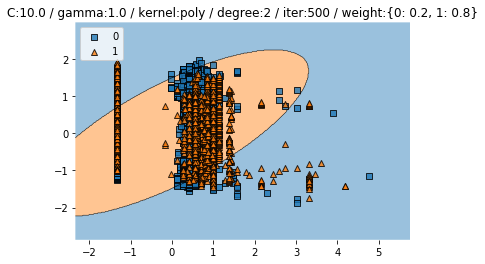

Train CV accuracy scores: [0.38509317 0.41718427 0.49740933 0.40871369 0.42323651]
Train CV accuracy: 0.426 +/- 0.038
Train CV f1 scores: [0.27820654 0.26811488 0.48099874 0.25080895 0.34200528]
Train CV f1: 0.324 +/- 0.084


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3420168067226891
Test f1 :  0.49775497113534317


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


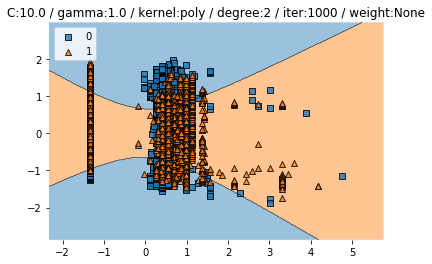

Train CV accuracy scores: [0.41097308 0.51345756 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.431 +/- 0.044
Train CV f1 scores: [0.28359876 0.46018862 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.325 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


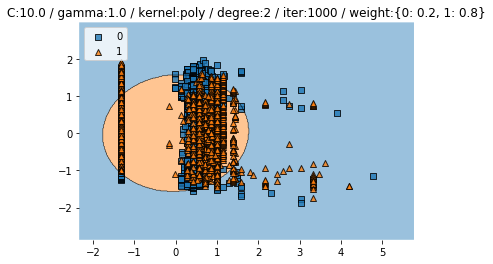

Train CV accuracy scores: [0.39544513 0.47308489 0.39067358 0.43360996 0.49377593]
Train CV accuracy: 0.437 +/- 0.041
Train CV f1 scores: [0.24334252 0.38856571 0.30541197 0.29813387 0.44505456]
Train CV f1: 0.336 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3521008403361345
Test f1 :  0.4433212996389892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


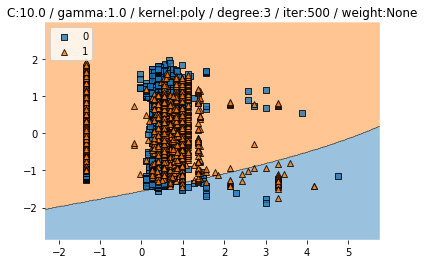

Train CV accuracy scores: [0.42132505 0.53623188 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.445 +/- 0.053
Train CV f1 scores: [0.25460821 0.4770111  0.28538097 0.2738725  0.37280571]
Train CV f1: 0.333 +/- 0.083


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


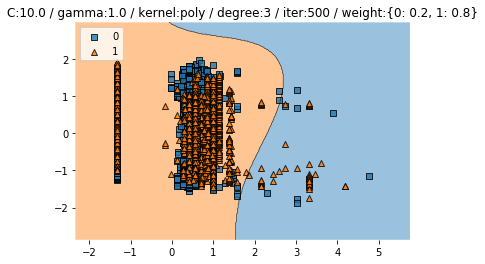

Train CV accuracy scores: [0.38509317 0.41718427 0.49740933 0.40871369 0.42323651]
Train CV accuracy: 0.426 +/- 0.038
Train CV f1 scores: [0.27820654 0.26811488 0.48099874 0.25080895 0.34200528]
Train CV f1: 0.324 +/- 0.084


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3420168067226891
Test f1 :  0.49775497113534317


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


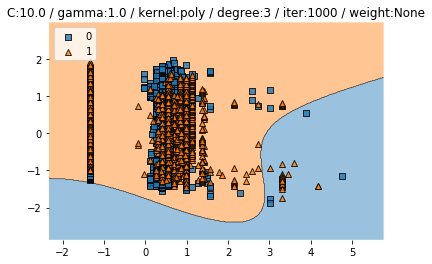

Train CV accuracy scores: [0.41097308 0.51345756 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.431 +/- 0.044
Train CV f1 scores: [0.28359876 0.46018862 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.325 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


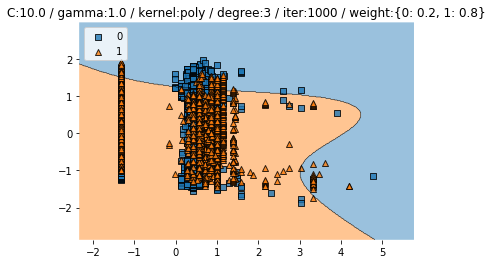

Train CV accuracy scores: [0.39544513 0.47308489 0.39067358 0.43360996 0.49377593]
Train CV accuracy: 0.437 +/- 0.041
Train CV f1 scores: [0.24334252 0.38856571 0.30541197 0.29813387 0.44505456]
Train CV f1: 0.336 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3521008403361345
Test f1 :  0.4433212996389892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


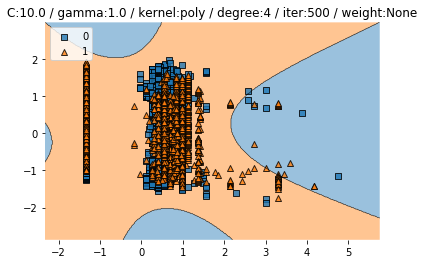

Train CV accuracy scores: [0.42132505 0.53623188 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.445 +/- 0.053
Train CV f1 scores: [0.25460821 0.4770111  0.28538097 0.2738725  0.37280571]
Train CV f1: 0.333 +/- 0.083


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


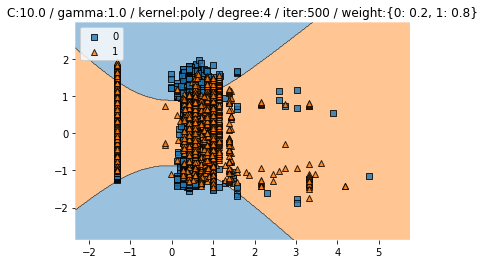

Train CV accuracy scores: [0.38509317 0.41718427 0.49740933 0.40871369 0.42323651]
Train CV accuracy: 0.426 +/- 0.038
Train CV f1 scores: [0.27820654 0.26811488 0.48099874 0.25080895 0.34200528]
Train CV f1: 0.324 +/- 0.084


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3420168067226891
Test f1 :  0.49775497113534317


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


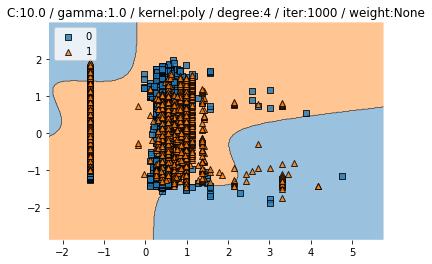

Train CV accuracy scores: [0.41097308 0.51345756 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.431 +/- 0.044
Train CV f1 scores: [0.28359876 0.46018862 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.325 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


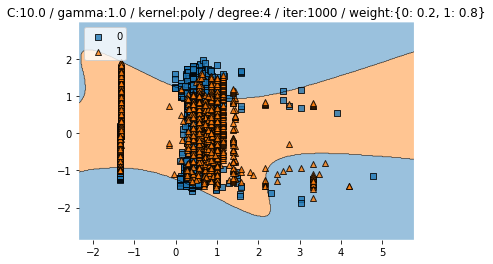

Train CV accuracy scores: [0.39544513 0.47308489 0.39067358 0.43360996 0.49377593]
Train CV accuracy: 0.437 +/- 0.041
Train CV f1 scores: [0.24334252 0.38856571 0.30541197 0.29813387 0.44505456]
Train CV f1: 0.336 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3521008403361345
Test f1 :  0.4433212996389892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


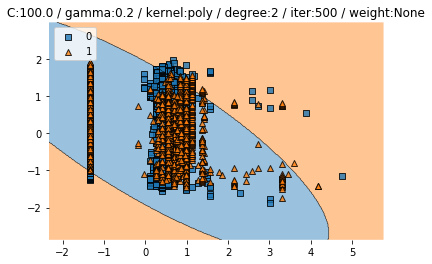

Train CV accuracy scores: [0.54037267 0.48240166 0.38341969 0.41908714 0.42012448]
Train CV accuracy: 0.449 +/- 0.056
Train CV f1 scores: [0.53688592 0.40195029 0.25919058 0.30606377 0.25400887]
Train CV f1: 0.352 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.49831932773109244
Test f1 :  0.6335174953959484


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


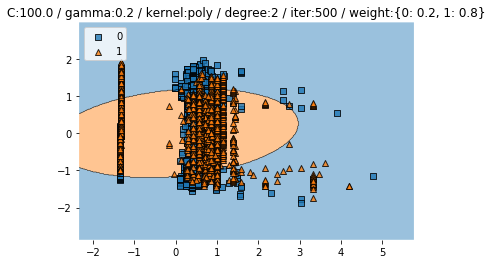

Train CV accuracy scores: [0.40890269 0.51035197 0.46735751 0.44502075 0.42427386]
Train CV accuracy: 0.451 +/- 0.036
Train CV f1 scores: [0.2475134  0.45712859 0.37264269 0.31003682 0.25397541]
Train CV f1: 0.328 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4857142857142857
Test f1 :  0.6101910828025477


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


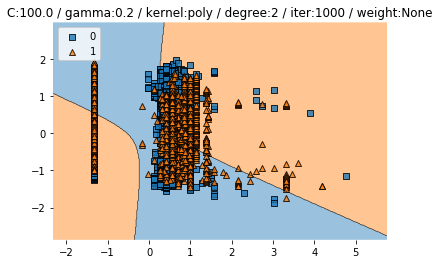

Train CV accuracy scores: [0.48136646 0.44306418 0.40518135 0.42219917 0.38381743]
Train CV accuracy: 0.427 +/- 0.033
Train CV f1 scores: [0.3754976  0.3090089  0.27450525 0.25309938 0.25221746]
Train CV f1: 0.293 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6907563025210084
Test f1 :  0.7363896848137537


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


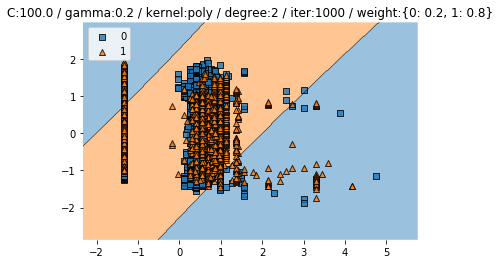

Train CV accuracy scores: [0.45755694 0.55486542 0.4        0.44190871 0.42634855]
Train CV accuracy: 0.456 +/- 0.053
Train CV f1 scores: [0.34357614 0.49802405 0.28737486 0.3569551  0.27890088]
Train CV f1: 0.353 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6254335260115608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


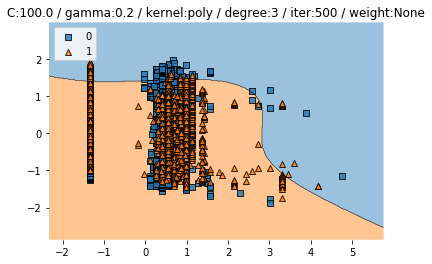

Train CV accuracy scores: [0.54037267 0.48240166 0.38341969 0.41908714 0.42012448]
Train CV accuracy: 0.449 +/- 0.056
Train CV f1 scores: [0.53688592 0.40195029 0.25919058 0.30606377 0.25400887]
Train CV f1: 0.352 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.49831932773109244
Test f1 :  0.6335174953959484


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


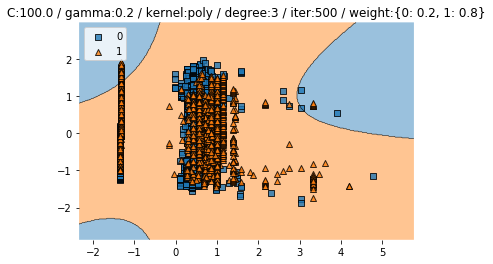

Train CV accuracy scores: [0.40890269 0.51035197 0.46735751 0.44502075 0.42427386]
Train CV accuracy: 0.451 +/- 0.036
Train CV f1 scores: [0.2475134  0.45712859 0.37264269 0.31003682 0.25397541]
Train CV f1: 0.328 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4857142857142857
Test f1 :  0.6101910828025477


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


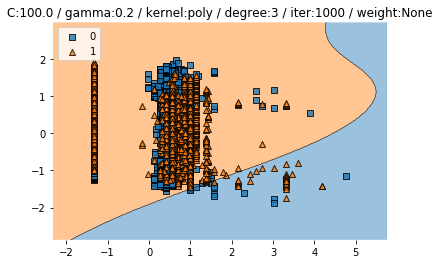

Train CV accuracy scores: [0.48136646 0.44306418 0.40518135 0.42219917 0.38381743]
Train CV accuracy: 0.427 +/- 0.033
Train CV f1 scores: [0.3754976  0.3090089  0.27450525 0.25309938 0.25221746]
Train CV f1: 0.293 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6907563025210084
Test f1 :  0.7363896848137537


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


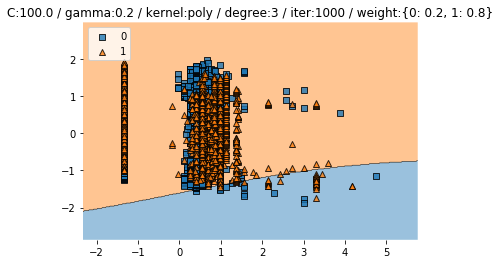

Train CV accuracy scores: [0.45755694 0.55486542 0.4        0.44190871 0.42634855]
Train CV accuracy: 0.456 +/- 0.053
Train CV f1 scores: [0.34357614 0.49802405 0.28737486 0.3569551  0.27890088]
Train CV f1: 0.353 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6254335260115608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


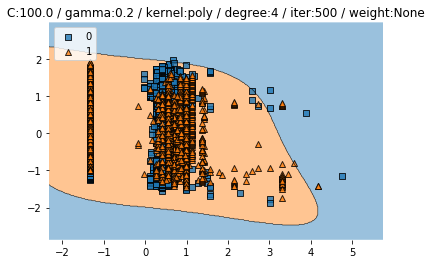

Train CV accuracy scores: [0.54037267 0.48240166 0.38341969 0.41908714 0.42012448]
Train CV accuracy: 0.449 +/- 0.056
Train CV f1 scores: [0.53688592 0.40195029 0.25919058 0.30606377 0.25400887]
Train CV f1: 0.352 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.49831932773109244
Test f1 :  0.6335174953959484


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


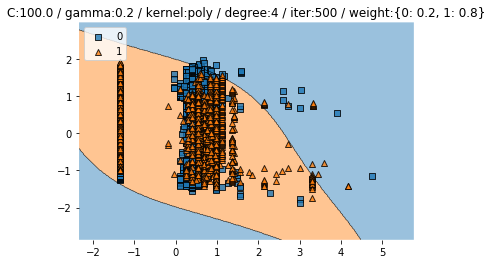

Train CV accuracy scores: [0.40890269 0.51035197 0.46735751 0.44502075 0.42427386]
Train CV accuracy: 0.451 +/- 0.036
Train CV f1 scores: [0.2475134  0.45712859 0.37264269 0.31003682 0.25397541]
Train CV f1: 0.328 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4857142857142857
Test f1 :  0.6101910828025477


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


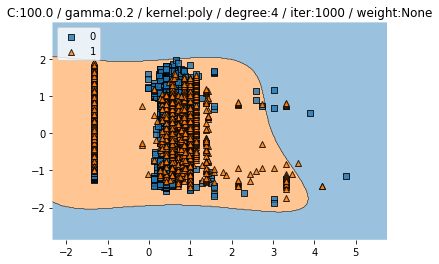

Train CV accuracy scores: [0.48136646 0.44306418 0.40518135 0.42219917 0.38381743]
Train CV accuracy: 0.427 +/- 0.033
Train CV f1 scores: [0.3754976  0.3090089  0.27450525 0.25309938 0.25221746]
Train CV f1: 0.293 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6907563025210084
Test f1 :  0.7363896848137537


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


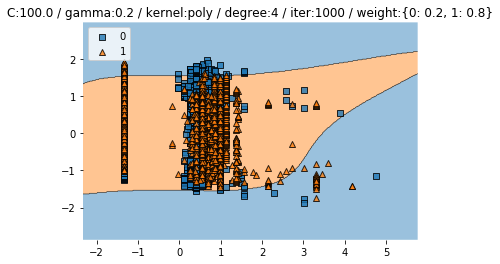

Train CV accuracy scores: [0.45755694 0.55486542 0.4        0.44190871 0.42634855]
Train CV accuracy: 0.456 +/- 0.053
Train CV f1 scores: [0.34357614 0.49802405 0.28737486 0.3569551  0.27890088]
Train CV f1: 0.353 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6254335260115608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


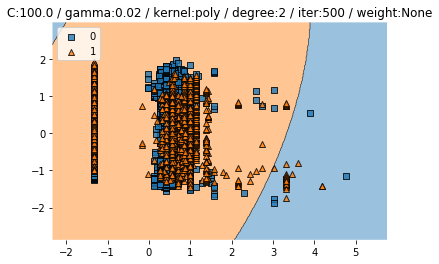

Train CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Train CV accuracy: 0.427 +/- 0.041
Train CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Train CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


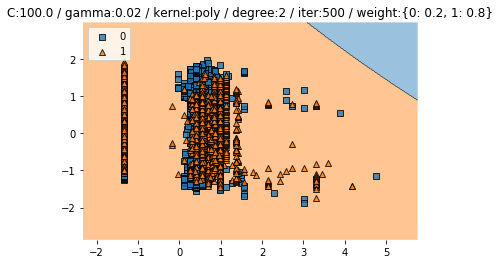

Train CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.005
Train CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


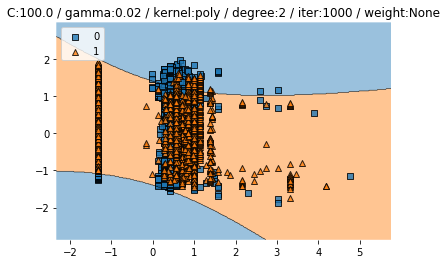

Train CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Train CV accuracy: 0.550 +/- 0.161
Train CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Train CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


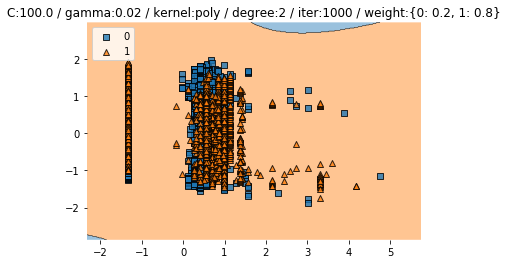

Train CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Train CV accuracy: 0.420 +/- 0.005
Train CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Train CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


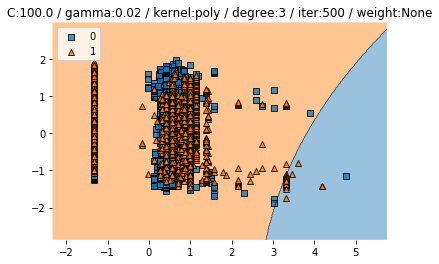

Train CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Train CV accuracy: 0.427 +/- 0.041
Train CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Train CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


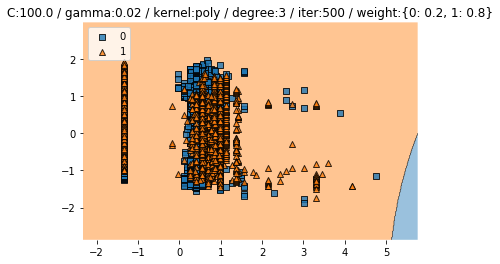

Train CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.005
Train CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


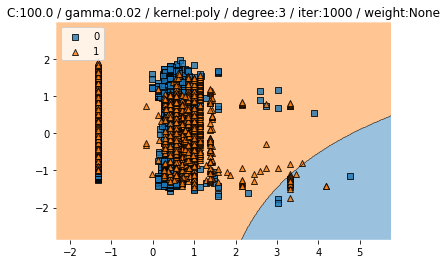

Train CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Train CV accuracy: 0.550 +/- 0.161
Train CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Train CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


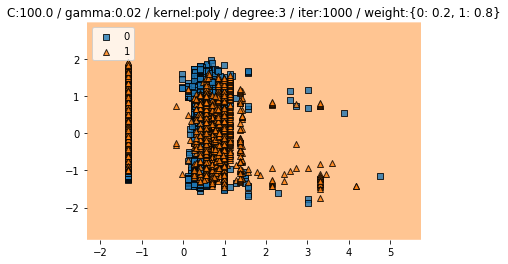

Train CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Train CV accuracy: 0.420 +/- 0.005
Train CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Train CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


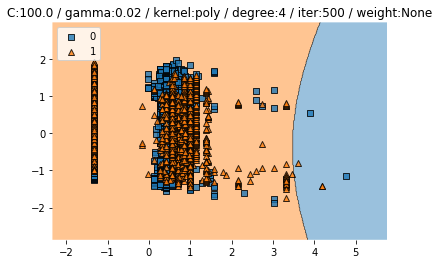

Train CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Train CV accuracy: 0.427 +/- 0.041
Train CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Train CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


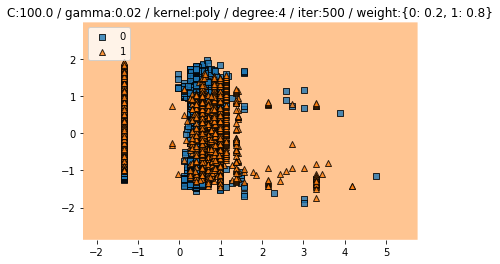

Train CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Train CV accuracy: 0.421 +/- 0.005
Train CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Train CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


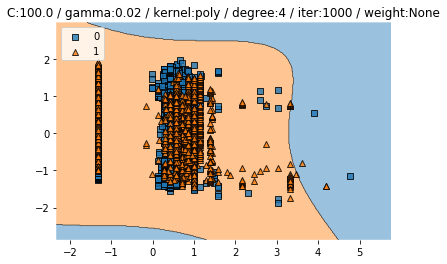

Train CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Train CV accuracy: 0.550 +/- 0.161
Train CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Train CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


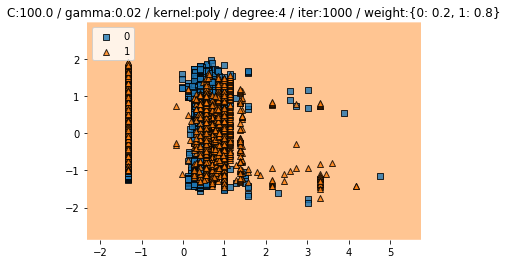

Train CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Train CV accuracy: 0.420 +/- 0.005
Train CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Train CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


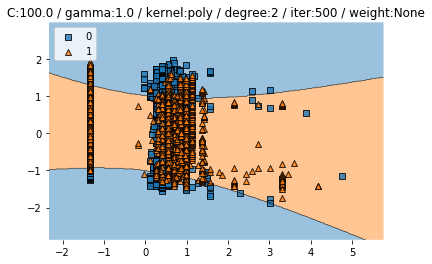

Train CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.422 +/- 0.028
Train CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Train CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


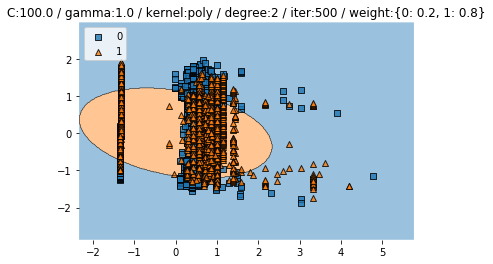

Train CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.422 +/- 0.028
Train CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Train CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


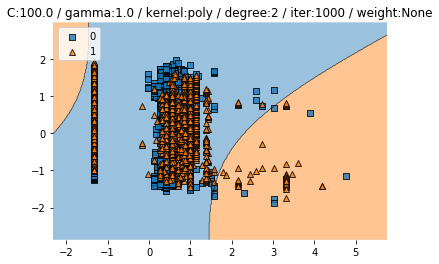

Train CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.414 +/- 0.016
Train CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


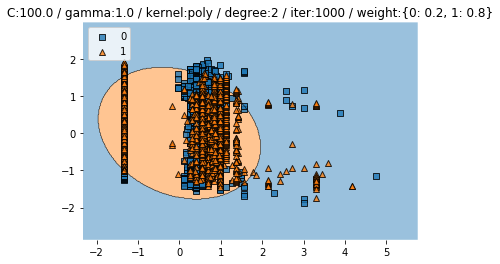

Train CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.414 +/- 0.016
Train CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


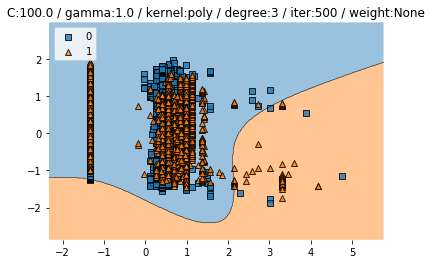

Train CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.422 +/- 0.028
Train CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Train CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


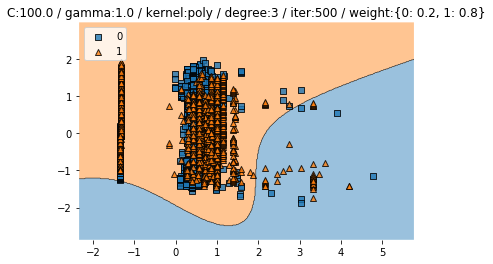

Train CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.422 +/- 0.028
Train CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Train CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


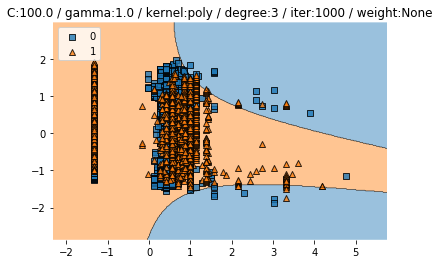

Train CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.414 +/- 0.016
Train CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


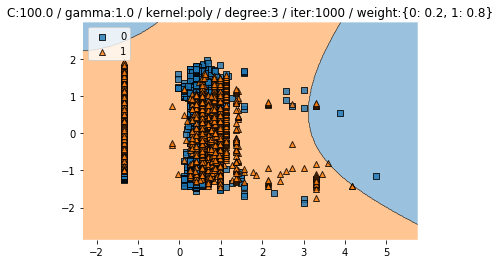

Train CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.414 +/- 0.016
Train CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


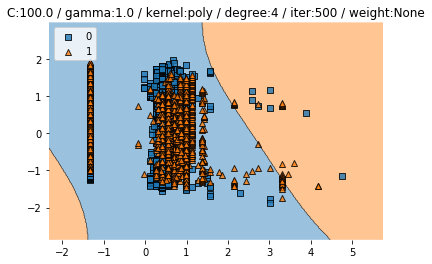

Train CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.422 +/- 0.028
Train CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Train CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


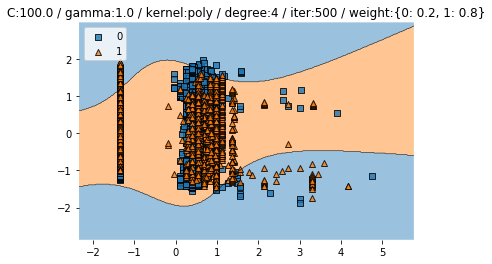

Train CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Train CV accuracy: 0.422 +/- 0.028
Train CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Train CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


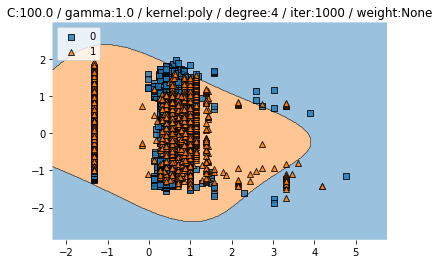

Train CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.414 +/- 0.016
Train CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


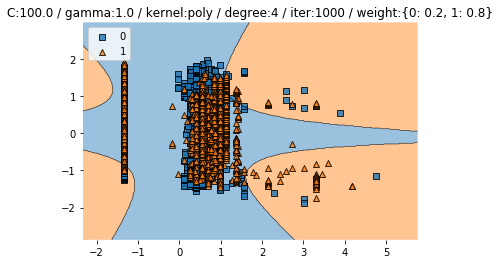

Train CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Train CV accuracy: 0.414 +/- 0.016
Train CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Train CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995
1166.1104409694672 secs


In [14]:
# blog poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
degree_range = [2, 3, 4]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "degree":degree, "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for degree in degree_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(3,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


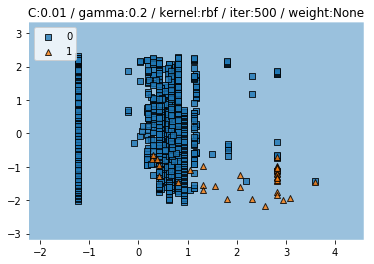

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


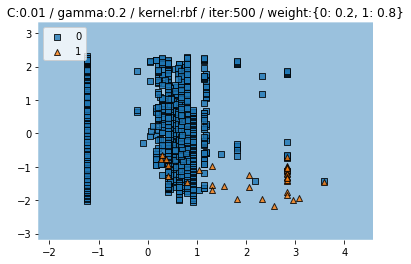

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


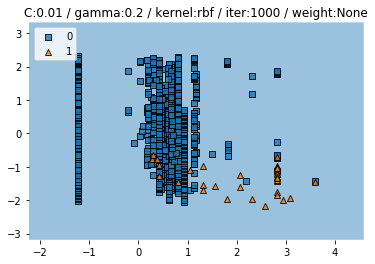

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


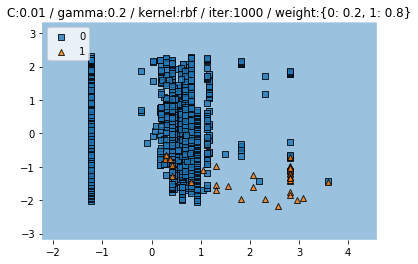

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


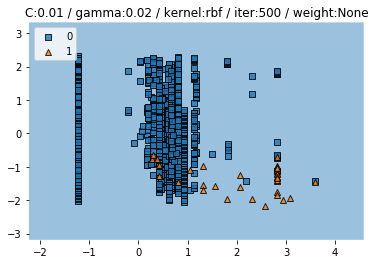

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


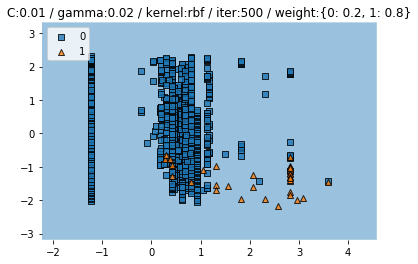

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


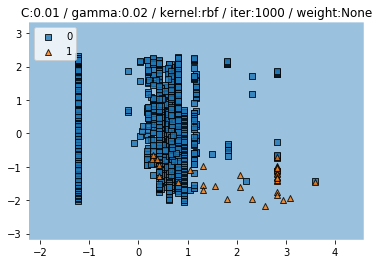

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


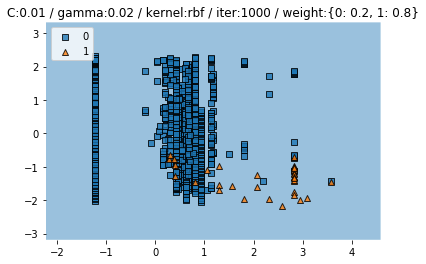

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


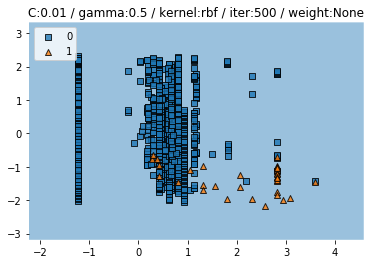

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


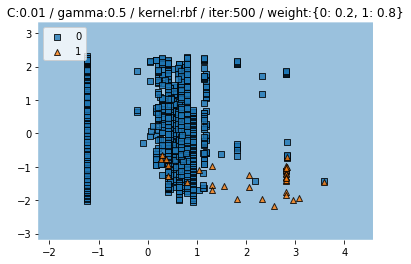

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


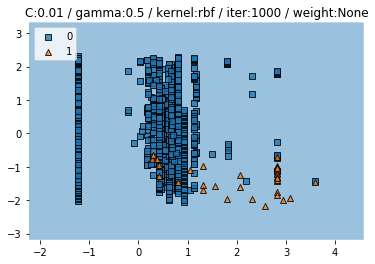

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


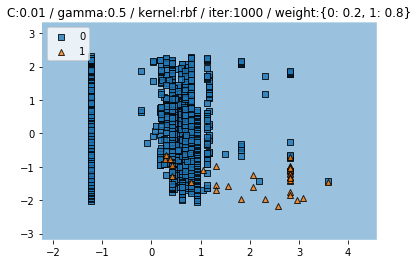

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


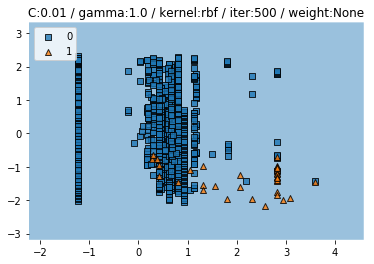

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


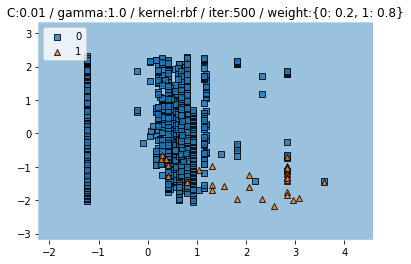

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


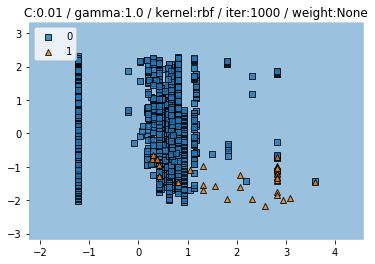

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


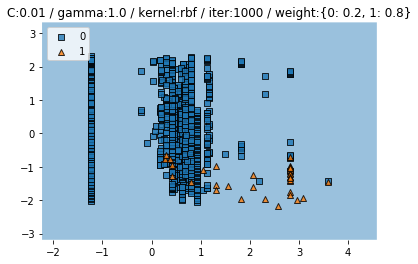

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


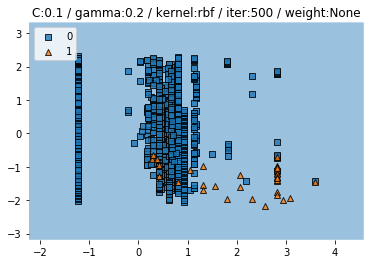

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


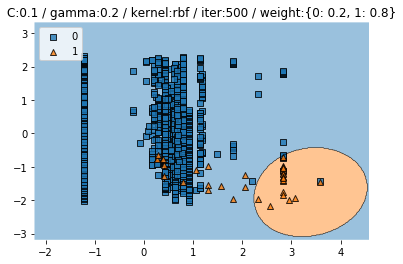

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


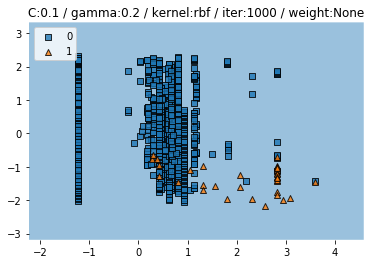

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


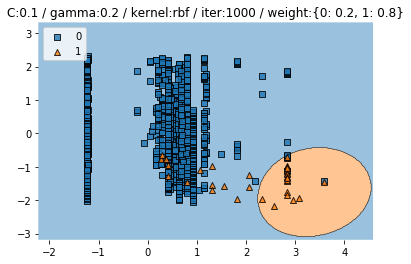

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


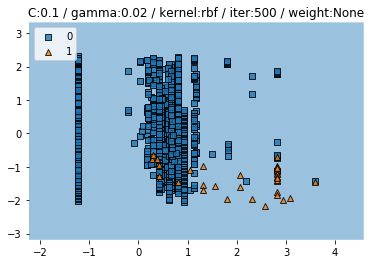

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


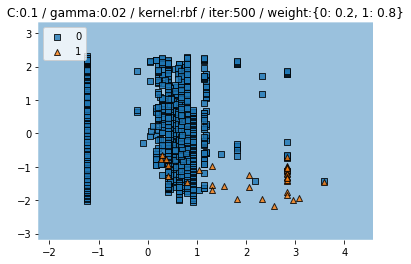

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


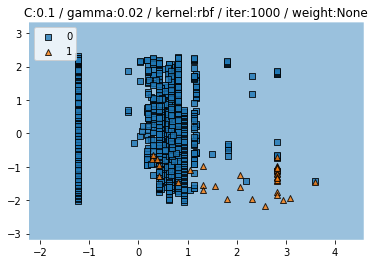

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


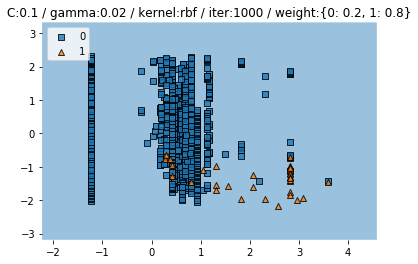

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


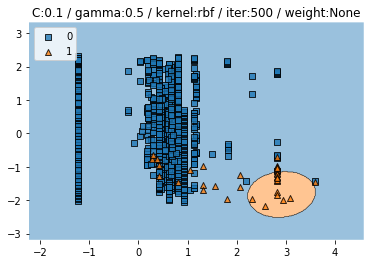

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


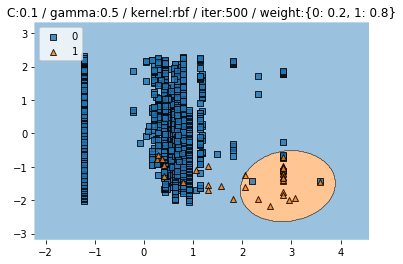

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


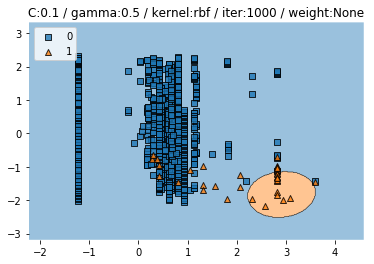

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


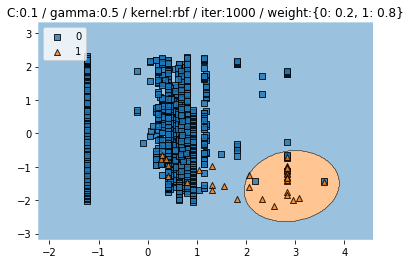

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


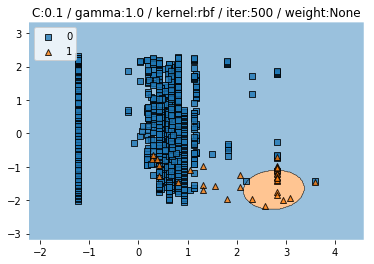

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


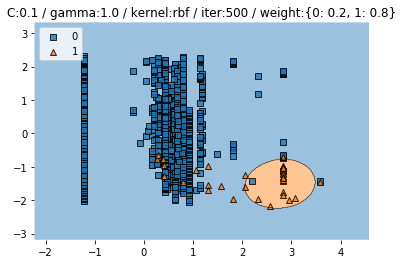

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


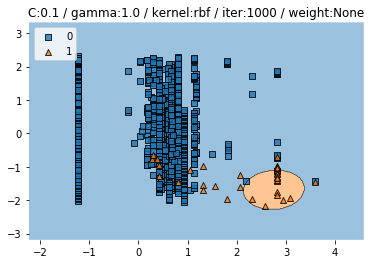

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


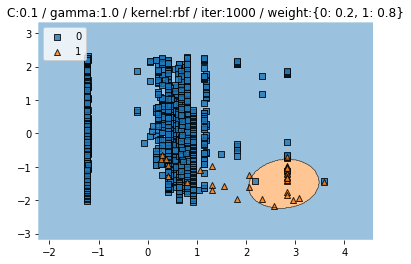

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


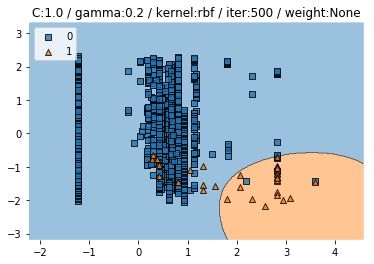

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


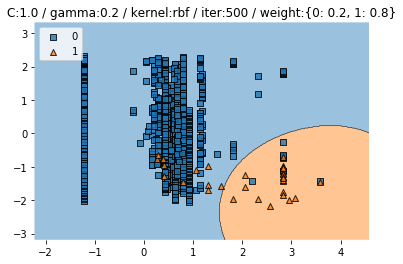

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.006
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


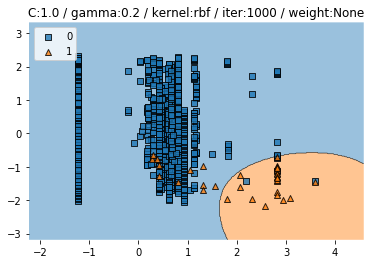

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


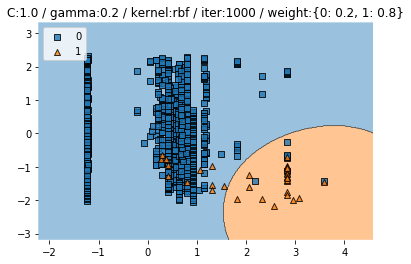

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.006
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


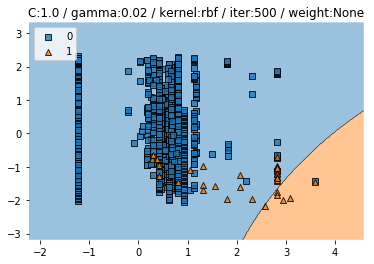

Train CV accuracy scores: [0.98280098 0.97788698 0.98525799 0.98522167 0.98518519]
Train CV accuracy: 0.983 +/- 0.003
Train CV f1 scores: [0.97427607 0.97979651 0.98234625 0.97788752 0.98151843]
Train CV f1: 0.979 +/- 0.003
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


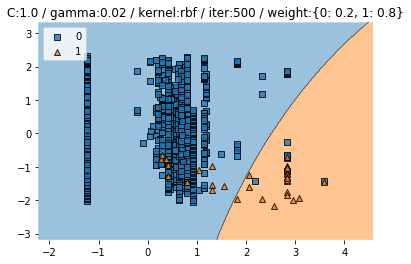

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.6153846153846153


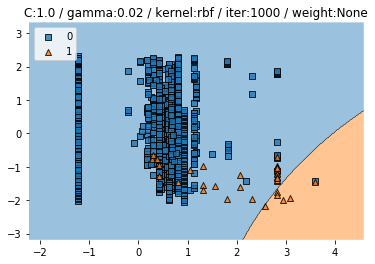

Train CV accuracy scores: [0.98280098 0.97788698 0.98525799 0.98522167 0.98518519]
Train CV accuracy: 0.983 +/- 0.003
Train CV f1 scores: [0.97427607 0.97979651 0.98234625 0.97788752 0.98151843]
Train CV f1: 0.979 +/- 0.003
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


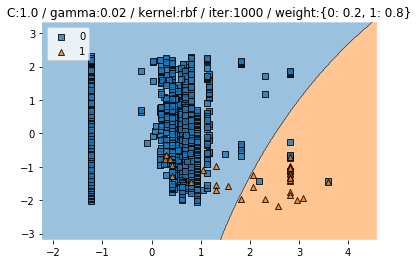

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.6153846153846153


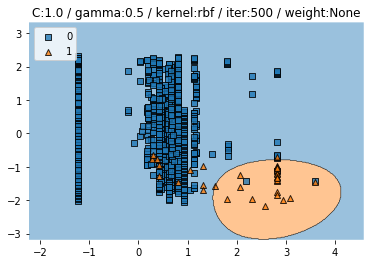

Train CV accuracy scores: [0.997543   0.997543   0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.994 +/- 0.005
Train CV f1 scores: [0.99745003 0.99745003 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.993 +/- 0.006
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


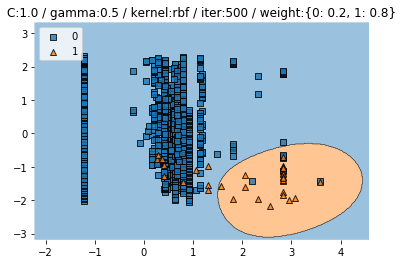

Train CV accuracy scores: [0.997543   0.997543   0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.994 +/- 0.005
Train CV f1 scores: [0.99745003 0.99745003 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.993 +/- 0.006
Test accuracy :  0.9910714285714286
Test f1 :  0.6153846153846153


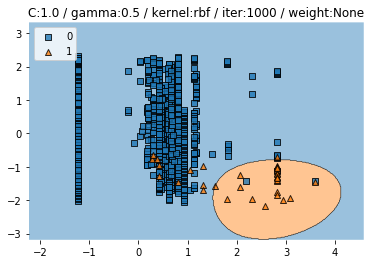

Train CV accuracy scores: [0.997543   0.997543   0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.994 +/- 0.005
Train CV f1 scores: [0.99745003 0.99745003 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.993 +/- 0.006
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


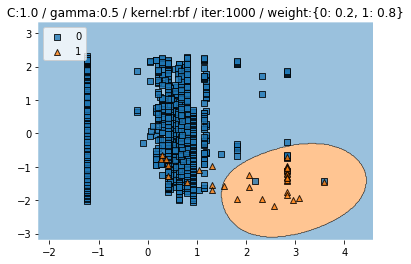

Train CV accuracy scores: [0.997543   0.997543   0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.994 +/- 0.005
Train CV f1 scores: [0.99745003 0.99745003 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.993 +/- 0.006
Test accuracy :  0.9910714285714286
Test f1 :  0.6153846153846153


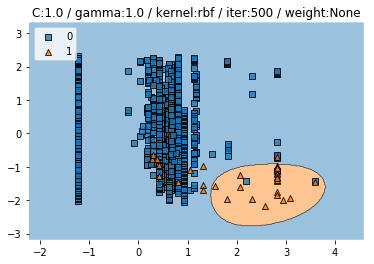

Train CV accuracy scores: [0.995086   0.997543   0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.993 +/- 0.004
Train CV f1 scores: [0.99468262 0.99745003 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.992 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


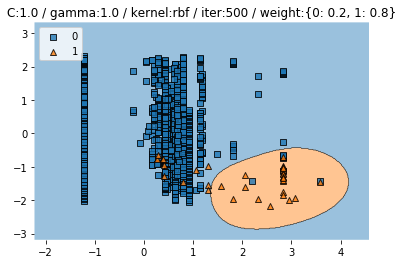

Train CV accuracy scores: [0.995086   0.997543   0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.993 +/- 0.004
Train CV f1 scores: [0.99468262 0.99745003 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.992 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


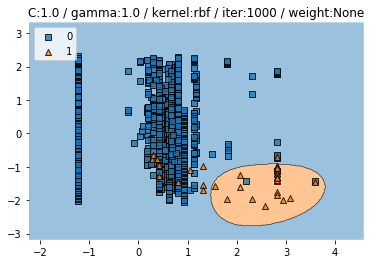

Train CV accuracy scores: [0.995086   0.997543   0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.993 +/- 0.004
Train CV f1 scores: [0.99468262 0.99745003 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.992 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


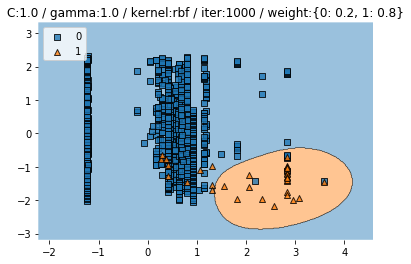

Train CV accuracy scores: [0.995086   0.997543   0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.993 +/- 0.004
Train CV f1 scores: [0.99468262 0.99745003 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.992 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


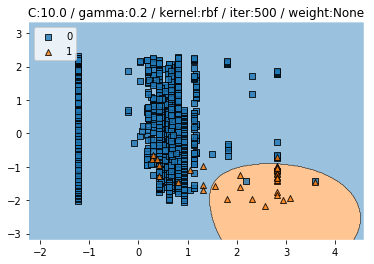

Train CV accuracy scores: [0.997543   0.98280098 0.98771499 0.99261084 0.99259259]
Train CV accuracy: 0.991 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98606271 0.99289041 0.99226053]
Train CV f1: 0.991 +/- 0.005
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


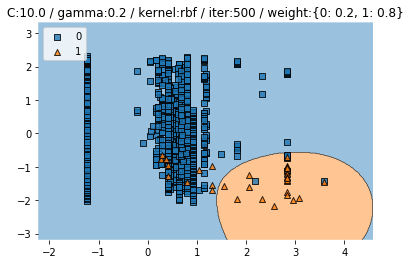

Train CV accuracy scores: [0.995086   0.97788698 0.98771499 0.99261084 0.99506173]
Train CV accuracy: 0.990 +/- 0.006
Train CV f1 scores: [0.99468262 0.98147488 0.98606271 0.99289041 0.99506173]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9982142857142857
Test f1 :  0.923076923076923


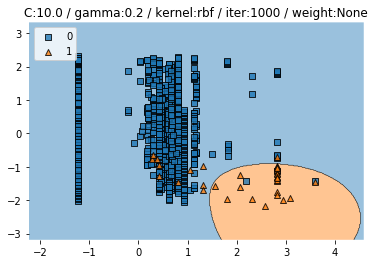

Train CV accuracy scores: [0.997543   0.98280098 0.98771499 0.99261084 0.99259259]
Train CV accuracy: 0.991 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98606271 0.99289041 0.99226053]
Train CV f1: 0.991 +/- 0.005
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


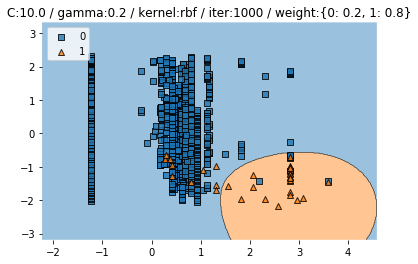

Train CV accuracy scores: [0.995086   0.97788698 0.98771499 0.99261084 0.99506173]
Train CV accuracy: 0.990 +/- 0.006
Train CV f1 scores: [0.99468262 0.98147488 0.98606271 0.99289041 0.99506173]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9982142857142857
Test f1 :  0.923076923076923


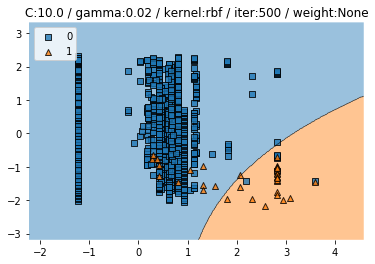

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9928571428571429
Test f1 :  0.6


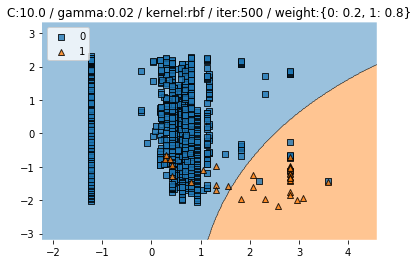

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.006
Test accuracy :  0.9910714285714286
Test f1 :  0.6153846153846153


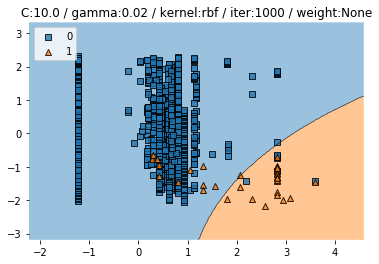

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9928571428571429
Test f1 :  0.6


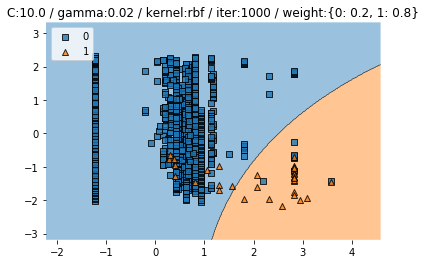

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.006
Test accuracy :  0.9910714285714286
Test f1 :  0.6153846153846153


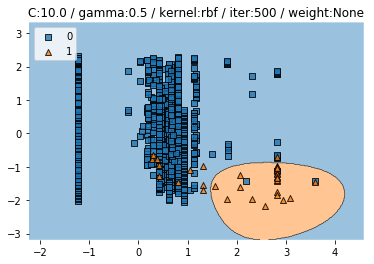

Train CV accuracy scores: [0.995086   0.995086   0.98771499 0.99261084 0.99259259]
Train CV accuracy: 0.993 +/- 0.003
Train CV f1 scores: [0.99468262 0.99538696 0.98606271 0.99289041 0.99226053]
Train CV f1: 0.992 +/- 0.003
Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


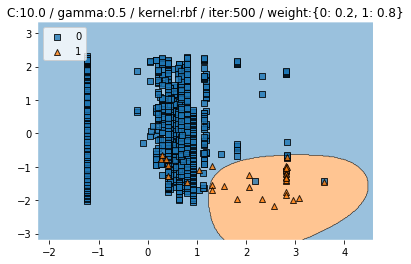

Train CV accuracy scores: [0.995086   0.98280098 0.98771499 0.99014778 0.99753086]
Train CV accuracy: 0.991 +/- 0.005
Train CV f1 scores: [0.99468262 0.98559158 0.98606271 0.99083917 0.99762428]
Train CV f1: 0.991 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


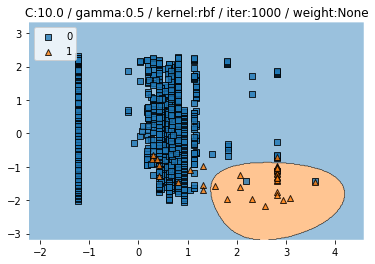

Train CV accuracy scores: [0.995086   0.995086   0.98771499 0.99261084 0.99259259]
Train CV accuracy: 0.993 +/- 0.003
Train CV f1 scores: [0.99468262 0.99538696 0.98606271 0.99289041 0.99226053]
Train CV f1: 0.992 +/- 0.003
Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


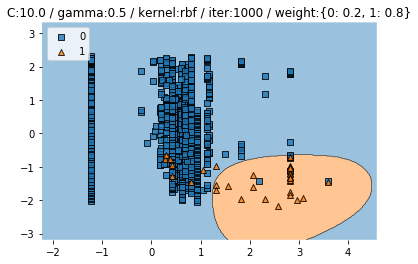

Train CV accuracy scores: [0.995086   0.98280098 0.98771499 0.99014778 0.99753086]
Train CV accuracy: 0.991 +/- 0.005
Train CV f1 scores: [0.99468262 0.98559158 0.98606271 0.99083917 0.99762428]
Train CV f1: 0.991 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


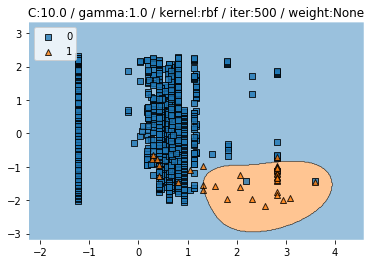

Train CV accuracy scores: [0.995086   0.997543   0.98771499 0.99014778 0.99753086]
Train CV accuracy: 0.994 +/- 0.004
Train CV f1 scores: [0.99468262 0.99762336 0.98606271 0.99083917 0.99762428]
Train CV f1: 0.993 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


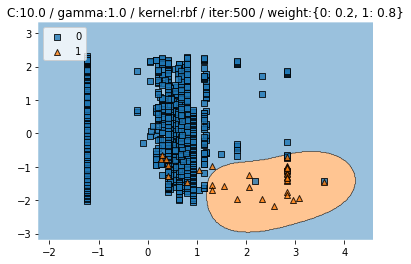

Train CV accuracy scores: [0.995086   0.997543   0.99262899 0.99014778 0.99506173]
Train CV accuracy: 0.994 +/- 0.003
Train CV f1 scores: [0.99468262 0.99762336 0.99235009 0.99083917 0.99506173]
Train CV f1: 0.994 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


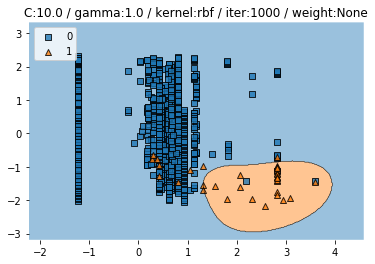

Train CV accuracy scores: [0.995086   0.997543   0.98771499 0.99014778 0.99753086]
Train CV accuracy: 0.994 +/- 0.004
Train CV f1 scores: [0.99468262 0.99762336 0.98606271 0.99083917 0.99762428]
Train CV f1: 0.993 +/- 0.004
Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


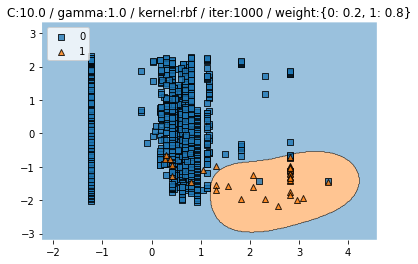

Train CV accuracy scores: [0.995086   0.997543   0.99262899 0.99014778 0.99506173]
Train CV accuracy: 0.994 +/- 0.003
Train CV f1 scores: [0.99468262 0.99762336 0.99235009 0.99083917 0.99506173]
Train CV f1: 0.994 +/- 0.002
Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


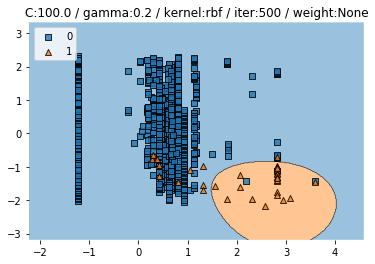

Train CV accuracy scores: [0.995086   0.98280098 0.98771499 0.99014778 0.99259259]
Train CV accuracy: 0.990 +/- 0.004
Train CV f1 scores: [0.99468262 0.98559158 0.98606271 0.99083917 0.99287285]
Train CV f1: 0.990 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


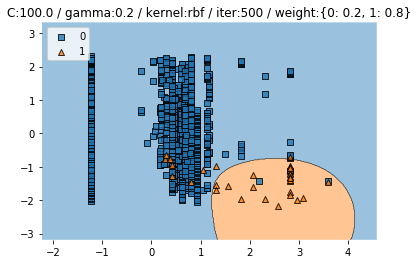

Train CV accuracy scores: [0.997543   0.98034398 0.99262899 0.99261084 0.99259259]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [0.99745003 0.98381853 0.99235009 0.99289041 0.99287285]
Train CV f1: 0.992 +/- 0.004
Test accuracy :  0.9946428571428572
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


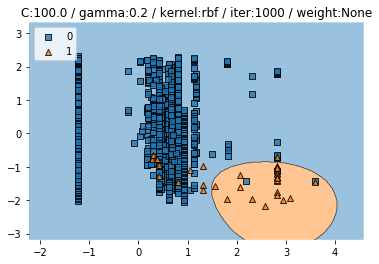

Train CV accuracy scores: [0.995086   0.98280098 0.98771499 0.99014778 0.99259259]
Train CV accuracy: 0.990 +/- 0.004
Train CV f1 scores: [0.99468262 0.98559158 0.98606271 0.99083917 0.99287285]
Train CV f1: 0.990 +/- 0.004
Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


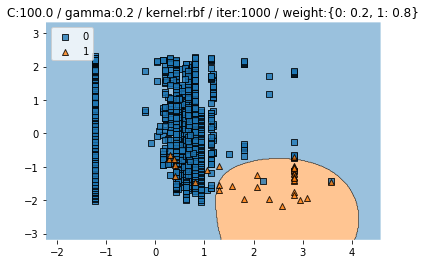

Train CV accuracy scores: [0.997543   0.98034398 0.99262899 0.99261084 0.99259259]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [0.99745003 0.98381853 0.99235009 0.99289041 0.99287285]
Train CV f1: 0.992 +/- 0.004
Test accuracy :  0.9946428571428572
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


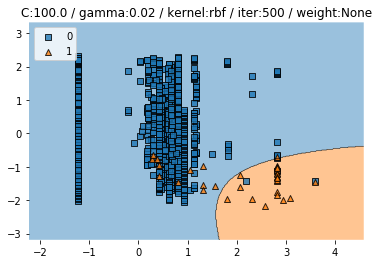

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99289041 0.99226053]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


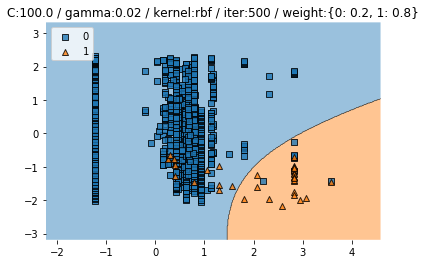

Train CV accuracy scores: [1.         0.98280098 0.98771499 0.98768473 0.99506173]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [1.         0.98500993 0.98606271 0.98889308 0.99506173]
Train CV f1: 0.991 +/- 0.006
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


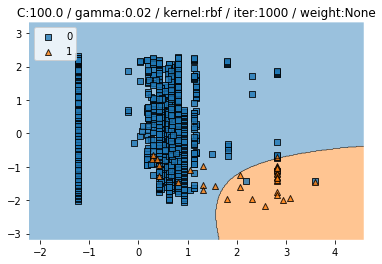

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99289041 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


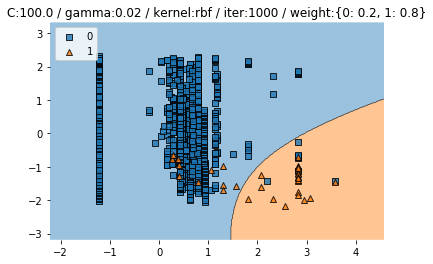

Train CV accuracy scores: [1.         0.98280098 0.98771499 0.98768473 0.99506173]
Train CV accuracy: 0.991 +/- 0.006
Train CV f1 scores: [1.         0.98500993 0.98606271 0.98889308 0.99506173]
Train CV f1: 0.991 +/- 0.006
Test accuracy :  0.9928571428571429
Test f1 :  0.6666666666666666


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


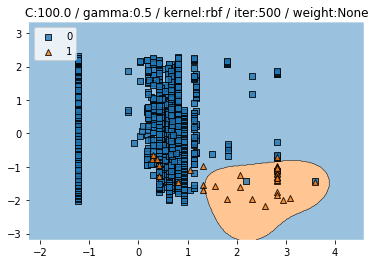

Train CV accuracy scores: [0.995086   0.997543   0.99262899 0.98768473 0.99259259]
Train CV accuracy: 0.993 +/- 0.003
Train CV f1 scores: [0.99468262 0.99762336 0.99235009 0.98889308 0.99287285]
Train CV f1: 0.993 +/- 0.003
Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


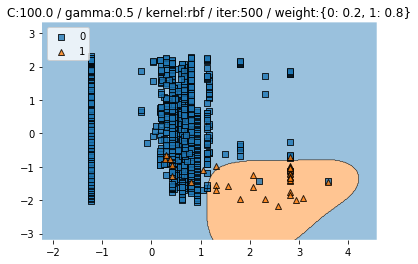

Train CV accuracy scores: [0.995086   0.98771499 0.99262899 0.99014778 0.99259259]
Train CV accuracy: 0.992 +/- 0.003
Train CV f1 scores: [0.99468262 0.9892928  0.99235009 0.99083917 0.99287285]
Train CV f1: 0.992 +/- 0.002
Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


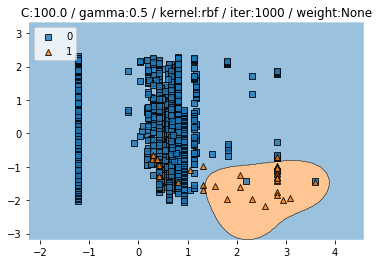

Train CV accuracy scores: [0.995086   0.997543   0.99262899 0.98768473 0.99259259]
Train CV accuracy: 0.993 +/- 0.003
Train CV f1 scores: [0.99468262 0.99762336 0.99235009 0.98889308 0.99287285]
Train CV f1: 0.993 +/- 0.003
Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


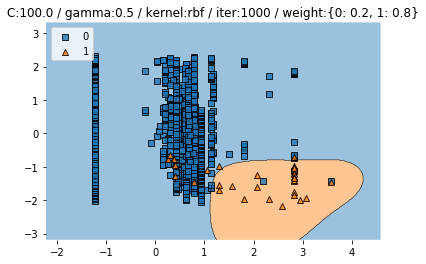

Train CV accuracy scores: [0.995086   0.98771499 0.99262899 0.99014778 0.99259259]
Train CV accuracy: 0.992 +/- 0.003
Train CV f1 scores: [0.99468262 0.9892928  0.99235009 0.99083917 0.99287285]
Train CV f1: 0.992 +/- 0.002
Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


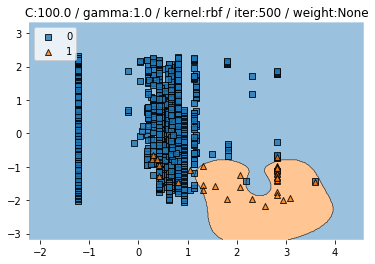

Train CV accuracy scores: [0.995086   0.997543   0.98771499 0.99014778 0.99506173]
Train CV accuracy: 0.993 +/- 0.004
Train CV f1 scores: [0.99468262 0.99762336 0.98606271 0.99083917 0.99506173]
Train CV f1: 0.993 +/- 0.004
Test accuracy :  0.9910714285714286
Test f1 :  0.6666666666666667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


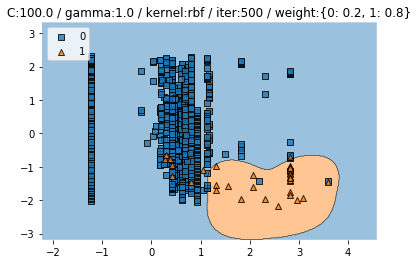

Train CV accuracy scores: [0.995086   0.997543   0.99262899 0.99014778 0.99506173]
Train CV accuracy: 0.994 +/- 0.003
Train CV f1 scores: [0.99468262 0.99762336 0.99235009 0.99083917 0.99506173]
Train CV f1: 0.994 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


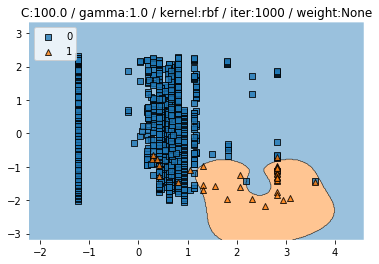

Train CV accuracy scores: [0.995086   0.997543   0.98771499 0.99014778 0.99506173]
Train CV accuracy: 0.993 +/- 0.004
Train CV f1 scores: [0.99468262 0.99762336 0.98606271 0.99083917 0.99506173]
Train CV f1: 0.993 +/- 0.004
Test accuracy :  0.9910714285714286
Test f1 :  0.6666666666666667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


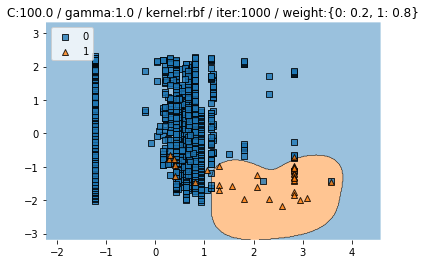

Train CV accuracy scores: [0.995086   0.997543   0.99262899 0.99014778 0.99506173]
Train CV accuracy: 0.994 +/- 0.003
Train CV f1 scores: [0.99468262 0.99762336 0.99235009 0.99083917 0.99506173]
Train CV f1: 0.994 +/- 0.002
Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764
172.82537150382996 secs


In [19]:
# blog title rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(4,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

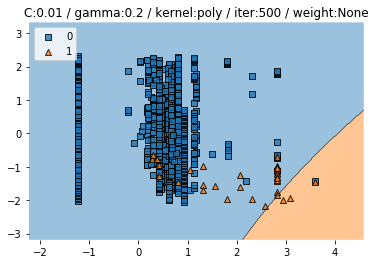

Train CV accuracy scores: [0.98280098 0.98771499 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.985 +/- 0.002
Train CV f1 scores: [0.97427607 0.98434064 0.97427607 0.97788752 0.98151843]
Train CV f1: 0.978 +/- 0.004
Test accuracy :  0.9875
Test f1 :  0.0


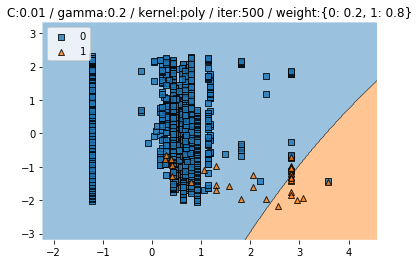

Train CV accuracy scores: [0.98280098 0.99017199 0.98525799 0.98522167 0.98765432]
Train CV accuracy: 0.986 +/- 0.003
Train CV f1 scores: [0.97427607 0.98823084 0.98234625 0.97788752 0.98561983]
Train CV f1: 0.982 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


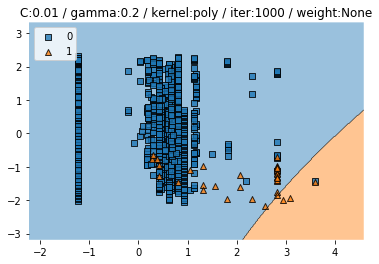

Train CV accuracy scores: [0.98280098 0.98771499 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.985 +/- 0.002
Train CV f1 scores: [0.97427607 0.98434064 0.97427607 0.97788752 0.98151843]
Train CV f1: 0.978 +/- 0.004
Test accuracy :  0.9875
Test f1 :  0.0


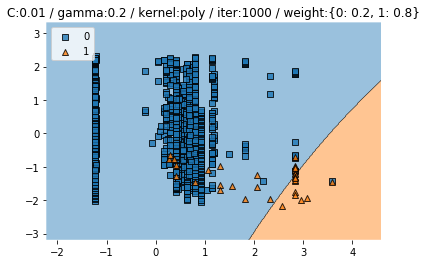

Train CV accuracy scores: [0.98280098 0.99017199 0.98525799 0.98522167 0.98765432]
Train CV accuracy: 0.986 +/- 0.003
Train CV f1 scores: [0.97427607 0.98823084 0.98234625 0.97788752 0.98561983]
Train CV f1: 0.982 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


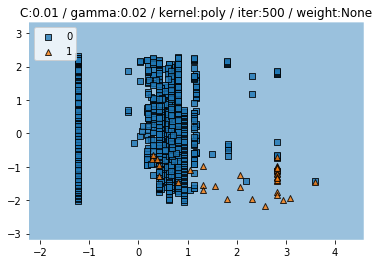

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


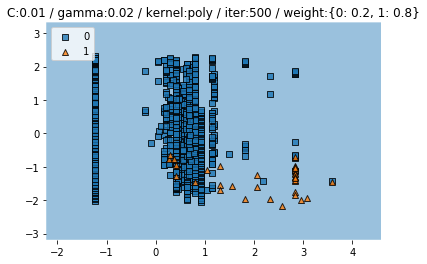

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


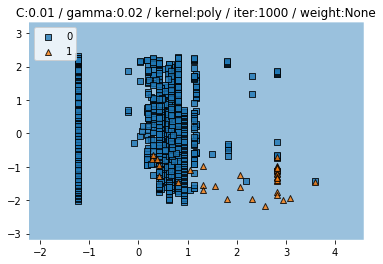

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


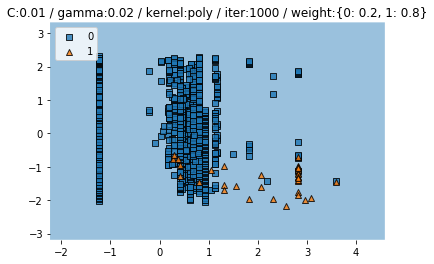

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


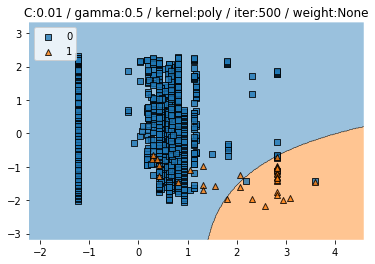

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9928571428571429
Test f1 :  0.6


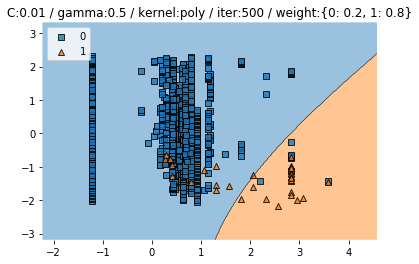

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.5454545454545454


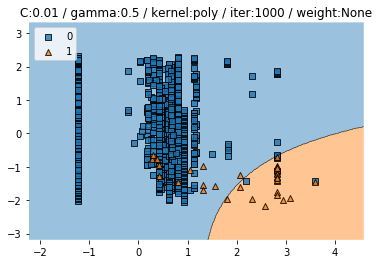

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9928571428571429
Test f1 :  0.6


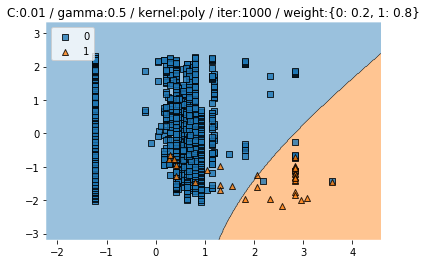

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.5454545454545454


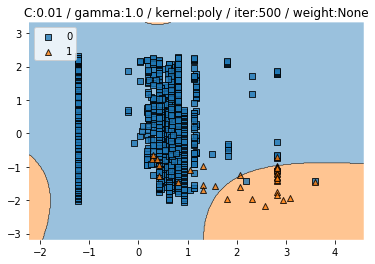

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


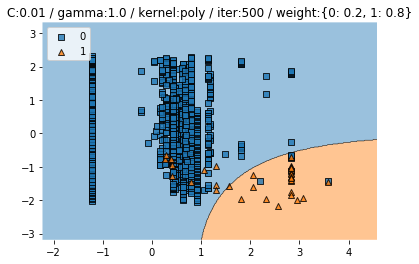

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


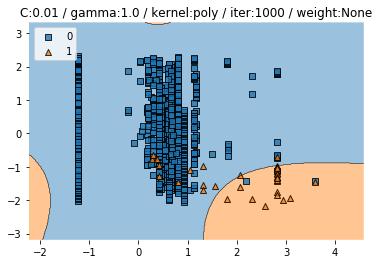

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


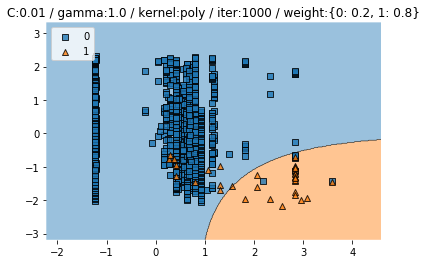

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


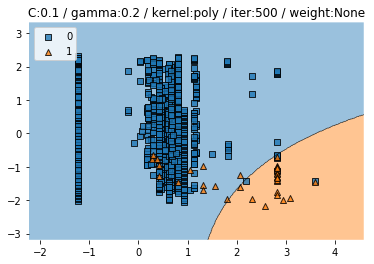

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


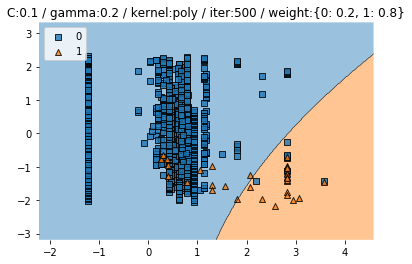

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9892857142857143
Test f1 :  0.5


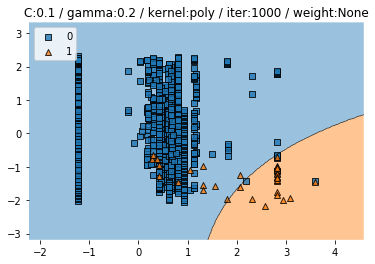

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


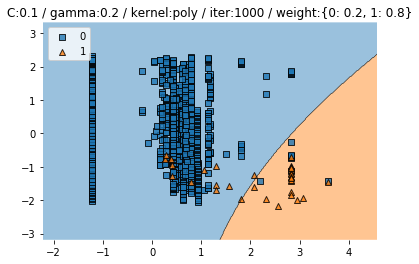

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9892857142857143
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


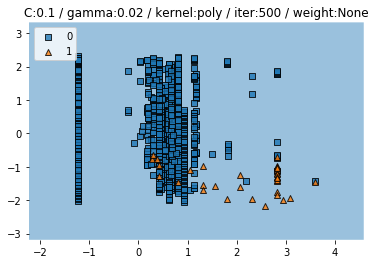

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


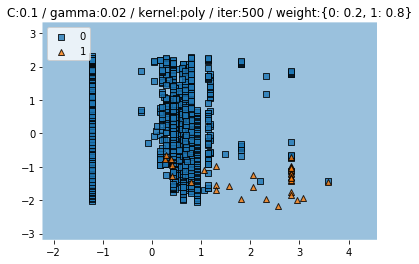

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


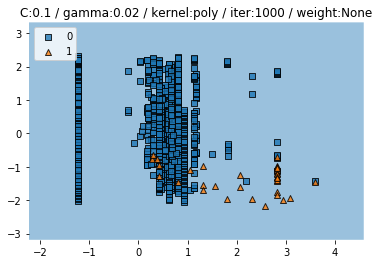

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


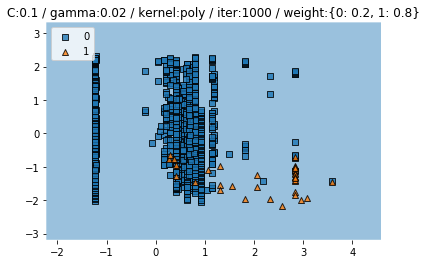

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


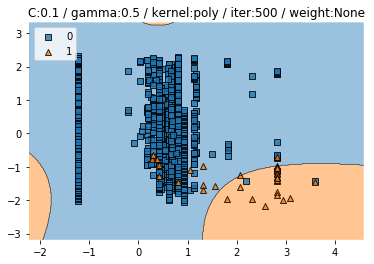

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


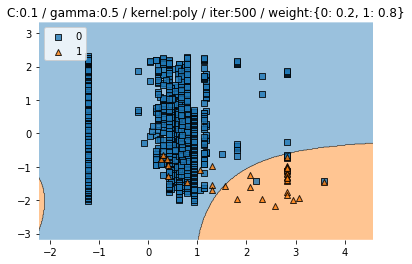

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99289041 0.99226053]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


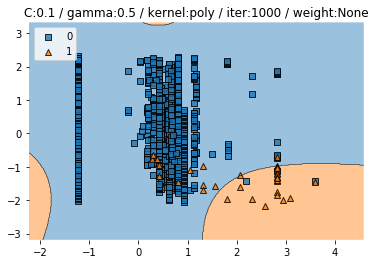

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


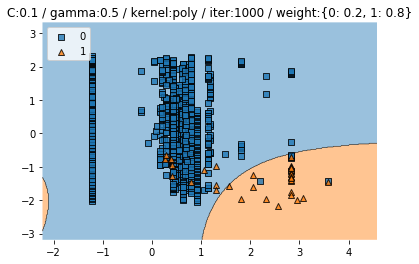

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99289041 0.99226053]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


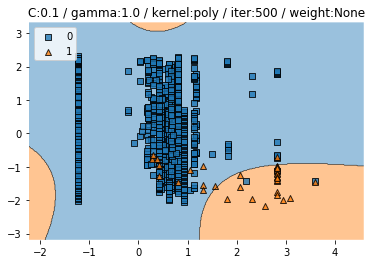

Train CV accuracy scores: [0.995086   0.98280098 0.98771499 0.98768473 0.99259259]
Train CV accuracy: 0.989 +/- 0.004
Train CV f1 scores: [0.99468262 0.98500993 0.98606271 0.98889308 0.99226053]
Train CV f1: 0.989 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9964285714285714
Test f1 :  0.8571428571428571


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


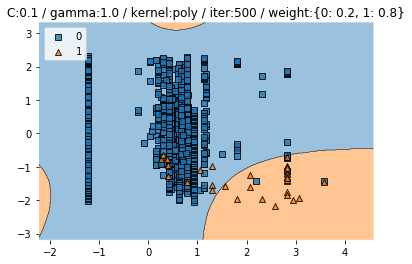

Train CV accuracy scores: [0.995086   0.98034398 0.98771499 0.98768473 0.99506173]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.99468262 0.98381853 0.98725016 0.98815069 0.99506173]
Train CV f1: 0.990 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


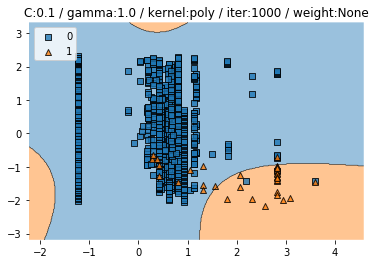

Train CV accuracy scores: [0.995086   0.98280098 0.98771499 0.99014778 0.99259259]
Train CV accuracy: 0.990 +/- 0.004
Train CV f1 scores: [0.99468262 0.98500993 0.98606271 0.99014778 0.99226053]
Train CV f1: 0.990 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9964285714285714
Test f1 :  0.8571428571428571


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


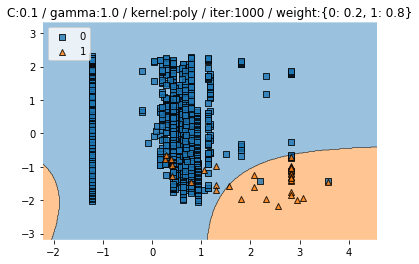

Train CV accuracy scores: [0.995086   0.98034398 0.98771499 0.98768473 0.99506173]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.99468262 0.98381853 0.98725016 0.98815069 0.99506173]
Train CV f1: 0.990 +/- 0.004
Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


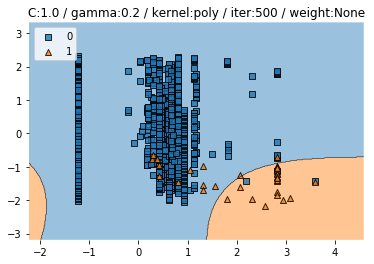

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


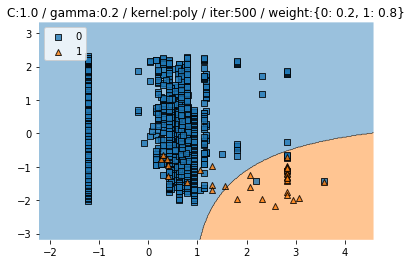

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


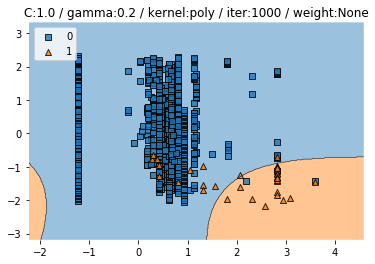

Train CV accuracy scores: [0.995086   0.98525799 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.991 +/- 0.004
Train CV f1 scores: [0.99468262 0.98685895 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


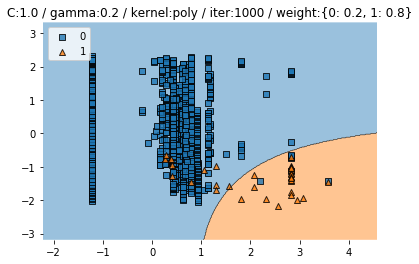

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99507389 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98234625 0.99507389 0.99226053]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.7272727272727272


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


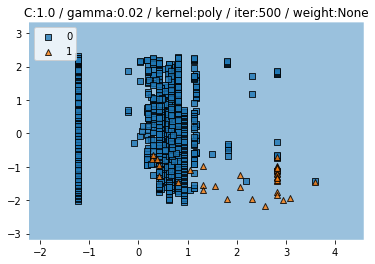

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


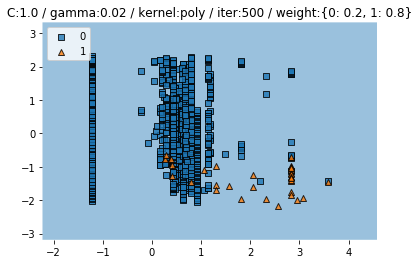

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


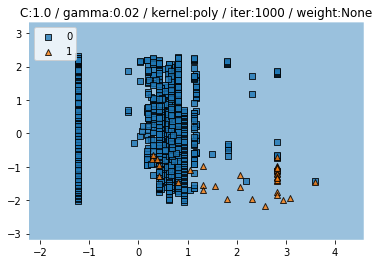

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


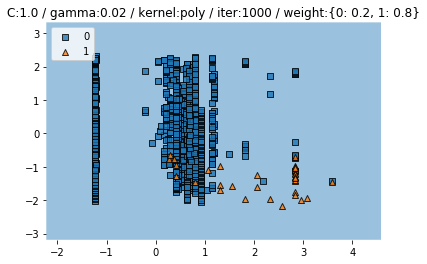

Train CV accuracy scores: [0.98280098 0.98280098 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.984 +/- 0.001
Train CV f1 scores: [0.97427607 0.97427607 0.97427607 0.97788752 0.97783306]
Train CV f1: 0.976 +/- 0.002
Test accuracy :  0.9892857142857143
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


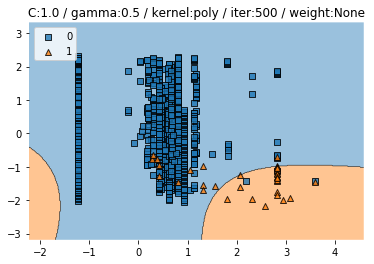

Train CV accuracy scores: [0.995086   0.98034398 0.98525799 0.98768473 0.99259259]
Train CV accuracy: 0.988 +/- 0.005
Train CV f1 scores: [0.99468262 0.98321812 0.98404787 0.98889308 0.99226053]
Train CV f1: 0.989 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9964285714285714
Test f1 :  0.8571428571428571


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


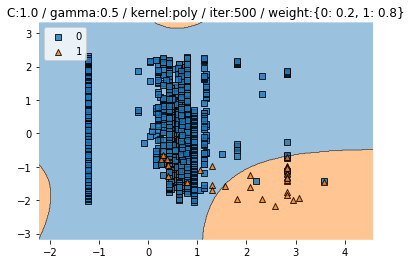

Train CV accuracy scores: [0.995086   0.97788698 0.99017199 0.98522167 0.99506173]
Train CV accuracy: 0.989 +/- 0.007
Train CV f1 scores: [0.99468262 0.98208764 0.99017199 0.98625875 0.99506173]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


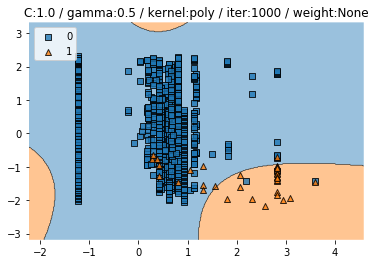

Train CV accuracy scores: [0.995086   0.98034398 0.98525799 0.99261084 0.99259259]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.99468262 0.98321812 0.98404787 0.99289041 0.99226053]
Train CV f1: 0.989 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9964285714285714
Test f1 :  0.8571428571428571


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


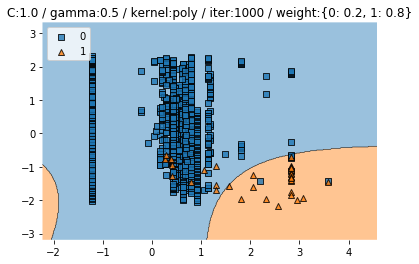

Train CV accuracy scores: [0.995086   0.97788698 0.99017199 0.98522167 0.99506173]
Train CV accuracy: 0.989 +/- 0.007
Train CV f1 scores: [0.99468262 0.98208764 0.99017199 0.98625875 0.99506173]
Train CV f1: 0.990 +/- 0.005
Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


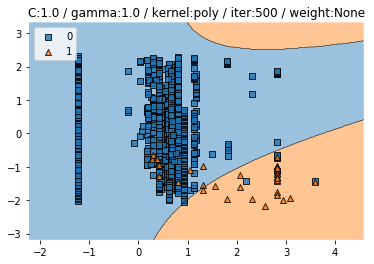

Train CV accuracy scores: [0.92628993 0.94348894 0.95823096 0.98029557 0.99259259]
Train CV accuracy: 0.960 +/- 0.024
Train CV f1 scores: [0.94952324 0.9602168  0.96712898 0.98350519 0.99226053]
Train CV f1: 0.971 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9767857142857143
Test f1 :  0.4799999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


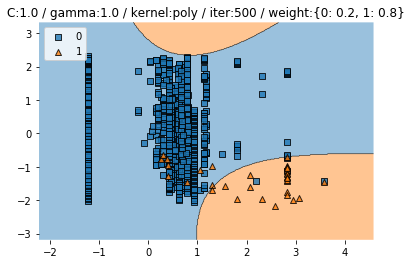

Train CV accuracy scores: [0.995086   0.98034398 0.98771499 0.98768473 0.99506173]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.995086   0.98321812 0.98725016 0.98889308 0.99506173]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


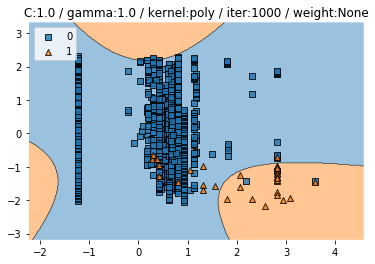

Train CV accuracy scores: [0.98771499 0.95823096 0.94348894 0.99014778 0.99259259]
Train CV accuracy: 0.974 +/- 0.020
Train CV f1 scores: [0.9881168  0.96712898 0.95756396 0.99083917 0.99226053]
Train CV f1: 0.979 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


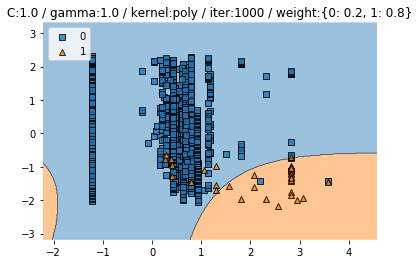

Train CV accuracy scores: [0.995086   0.98034398 0.98771499 0.98522167 0.99259259]
Train CV accuracy: 0.988 +/- 0.005
Train CV f1 scores: [0.995086   0.98321812 0.98877584 0.98703183 0.99226053]
Train CV f1: 0.989 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


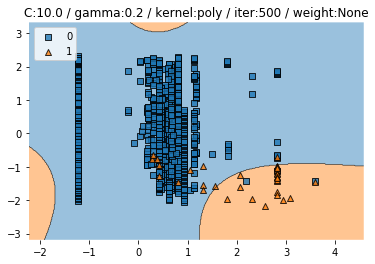

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99014778 0.99506173]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98404787 0.99014778 0.99506173]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7692307692307692


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


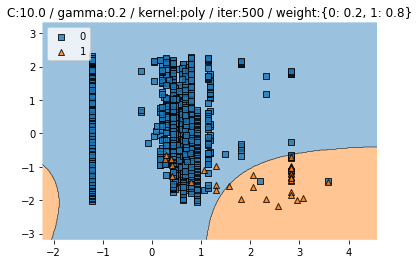

Train CV accuracy scores: [0.995086   0.98034398 0.98525799 0.98768473 0.99506173]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.99468262 0.98381853 0.98404787 0.98815069 0.99506173]
Train CV f1: 0.989 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.8


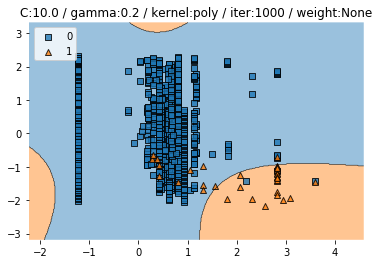

Train CV accuracy scores: [0.995086   0.98280098 0.98525799 0.99014778 0.99506173]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99468262 0.98500993 0.98404787 0.99014778 0.99506173]
Train CV f1: 0.990 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9946428571428572
Test f1 :  0.7692307692307692


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


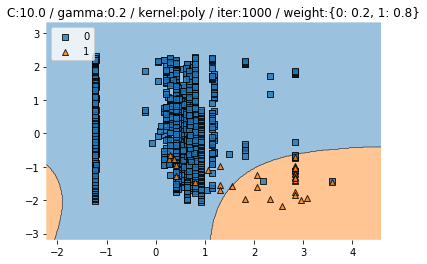

Train CV accuracy scores: [0.995086   0.98034398 0.98525799 0.98768473 0.99506173]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.99468262 0.98381853 0.98404787 0.98815069 0.99506173]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9946428571428572
Test f1 :  0.8


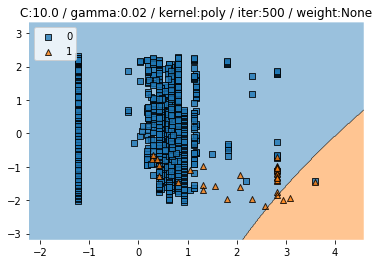

Train CV accuracy scores: [0.98280098 0.98771499 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.985 +/- 0.002
Train CV f1 scores: [0.97427607 0.98434064 0.97427607 0.97788752 0.98151843]
Train CV f1: 0.978 +/- 0.004
Test accuracy :  0.9875
Test f1 :  0.0


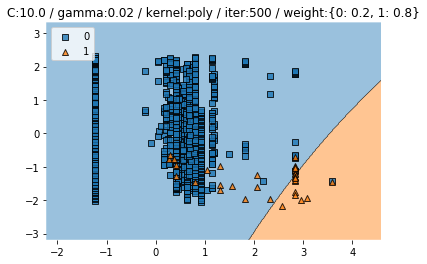

Train CV accuracy scores: [0.98280098 0.99017199 0.98525799 0.98522167 0.98765432]
Train CV accuracy: 0.986 +/- 0.003
Train CV f1 scores: [0.97427607 0.98823084 0.98234625 0.97788752 0.98561983]
Train CV f1: 0.982 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


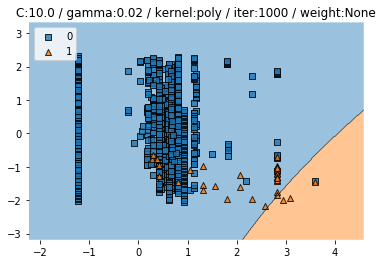

Train CV accuracy scores: [0.98280098 0.98771499 0.98280098 0.98522167 0.98518519]
Train CV accuracy: 0.985 +/- 0.002
Train CV f1 scores: [0.97427607 0.98434064 0.97427607 0.97788752 0.98151843]
Train CV f1: 0.978 +/- 0.004
Test accuracy :  0.9875
Test f1 :  0.0


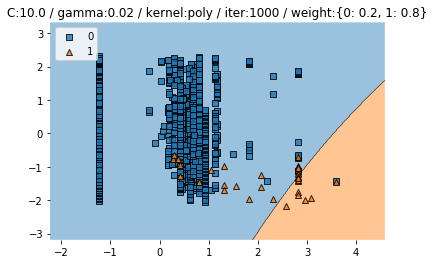

Train CV accuracy scores: [0.98280098 0.99017199 0.98525799 0.98522167 0.98765432]
Train CV accuracy: 0.986 +/- 0.003
Train CV f1 scores: [0.97427607 0.98823084 0.98234625 0.97788752 0.98561983]
Train CV f1: 0.982 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


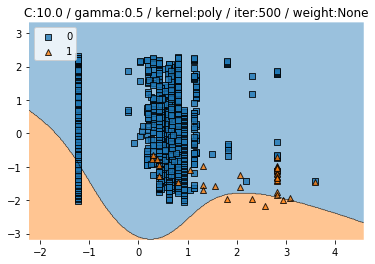

Train CV accuracy scores: [0.93611794 0.95823096 0.93366093 0.98522167 0.99012346]
Train CV accuracy: 0.961 +/- 0.024
Train CV f1 scores: [0.9525013  0.96863423 0.95018378 0.98703183 0.99012346]
Train CV f1: 0.970 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9785714285714285
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


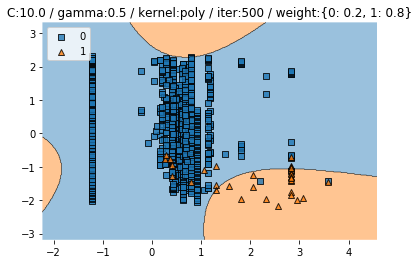

Train CV accuracy scores: [0.995086   0.97788698 0.97788698 0.99261084 0.99259259]
Train CV accuracy: 0.987 +/- 0.008
Train CV f1 scores: [0.995086   0.98147488 0.98072705 0.99289041 0.99226053]
Train CV f1: 0.988 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9910714285714286
Test f1 :  0.6666666666666667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


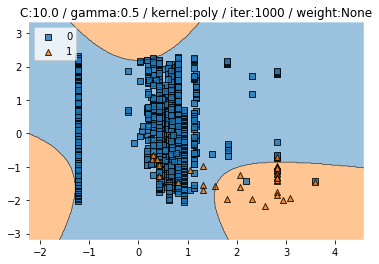

Train CV accuracy scores: [0.99262899 0.95577396 0.91646192 0.98768473 0.99506173]
Train CV accuracy: 0.970 +/- 0.030
Train CV f1 scores: [0.99235009 0.9664366  0.94155054 0.98889308 0.99506173]
Train CV f1: 0.977 +/- 0.020


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9892857142857143
Test f1 :  0.6666666666666666


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


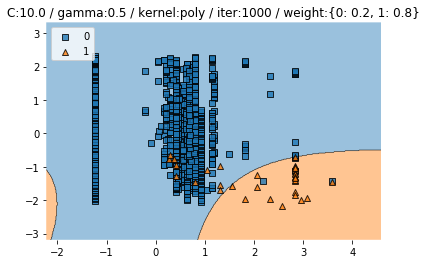

Train CV accuracy scores: [0.995086   0.98034398 0.98771499 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.995086   0.98321812 0.98877584 0.99289041 0.99226053]
Train CV f1: 0.990 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


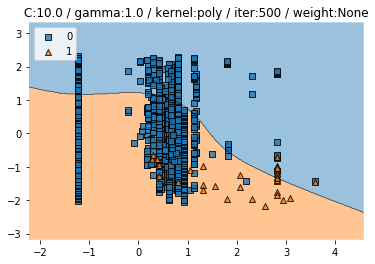

Train CV accuracy scores: [0.87223587 0.86732187 0.89189189 0.96305419 0.89135802]
Train CV accuracy: 0.897 +/- 0.034
Train CV f1 scores: [0.9181262  0.91413461 0.92908698 0.97235496 0.93058985]
Train CV f1: 0.933 +/- 0.021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9339285714285714
Test f1 :  0.17777777777777778


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


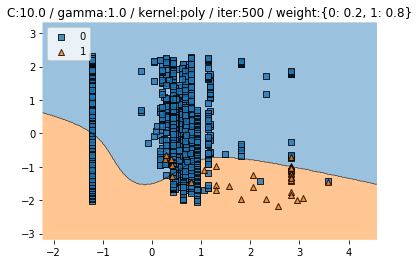

Train CV accuracy scores: [0.99262899 0.93366093 0.89189189 0.98522167 0.8962963 ]
Train CV accuracy: 0.940 +/- 0.043
Train CV f1 scores: [0.99287008 0.95329798 0.92908698 0.98625875 0.93374486]
Train CV f1: 0.959 +/- 0.026


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9089285714285714
Test f1 :  0.1904761904761905


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


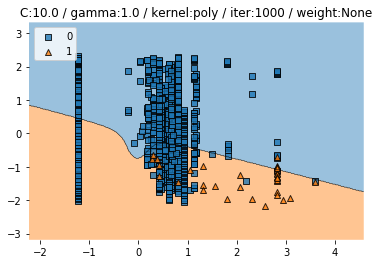

Train CV accuracy scores: [0.96314496 0.95331695 0.89434889 0.98522167 0.97530864]
Train CV accuracy: 0.954 +/- 0.032
Train CV f1 scores: [0.97232432 0.96618816 0.92916637 0.98625875 0.97833287]
Train CV f1: 0.966 +/- 0.020


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9678571428571429
Test f1 :  0.30769230769230765


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


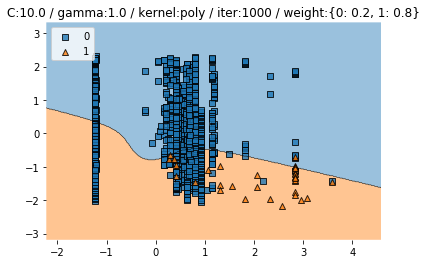

Train CV accuracy scores: [0.90663391 0.96314496 0.91400491 0.98768473 0.99506173]
Train CV accuracy: 0.953 +/- 0.037
Train CV f1 scores: [0.93804598 0.97099616 0.94138597 0.98889308 0.99506173]
Train CV f1: 0.967 +/- 0.024


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9875
Test f1 :  0.631578947368421


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


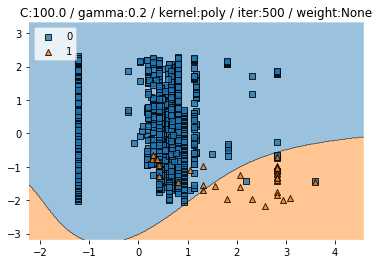

Train CV accuracy scores: [0.98771499 0.95823096 0.92628993 0.99014778 0.99259259]
Train CV accuracy: 0.971 +/- 0.026
Train CV f1 scores: [0.9881168  0.96794149 0.94777028 0.99083917 0.99226053]
Train CV f1: 0.977 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9785714285714285
Test f1 :  0.45454545454545453


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


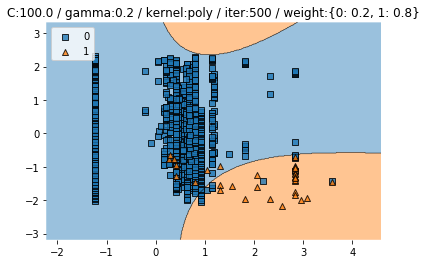

Train CV accuracy scores: [0.995086   0.98034398 0.98771499 0.99261084 0.99259259]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.995086   0.98321812 0.98877584 0.99289041 0.99226053]
Train CV f1: 0.990 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9910714285714286
Test f1 :  0.7058823529411764


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


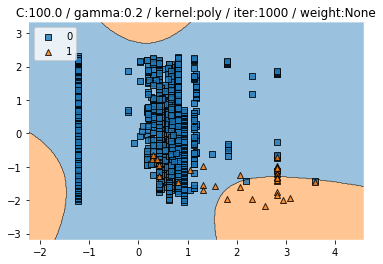

Train CV accuracy scores: [0.98771499 0.95823096 0.95823096 0.99014778 0.99259259]
Train CV accuracy: 0.977 +/- 0.016
Train CV f1 scores: [0.9881168  0.96794149 0.96712898 0.99083917 0.99226053]
Train CV f1: 0.981 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


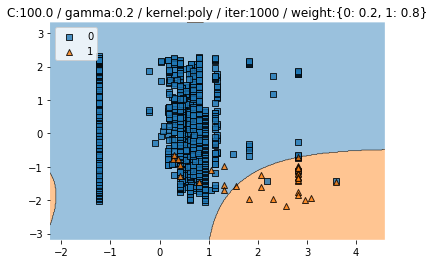

Train CV accuracy scores: [0.995086   0.98034398 0.98525799 0.98275862 0.99259259]
Train CV accuracy: 0.987 +/- 0.006
Train CV f1 scores: [0.995086   0.98321812 0.98685895 0.9852399  0.99226053]
Train CV f1: 0.989 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9928571428571429
Test f1 :  0.7499999999999999


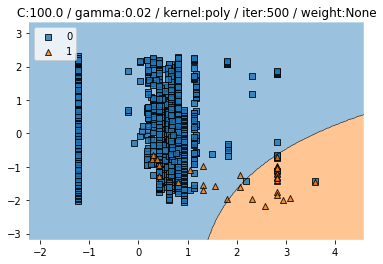

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


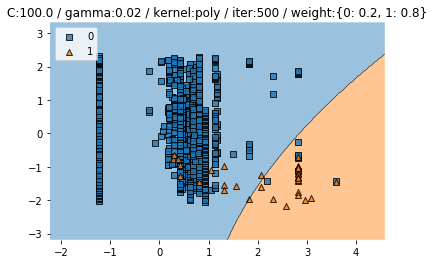

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9892857142857143
Test f1 :  0.5


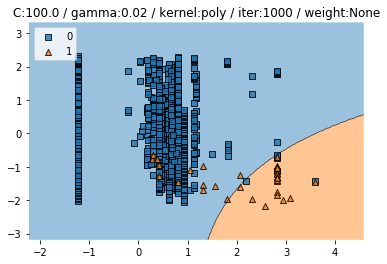

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9910714285714286
Test f1 :  0.4444444444444444


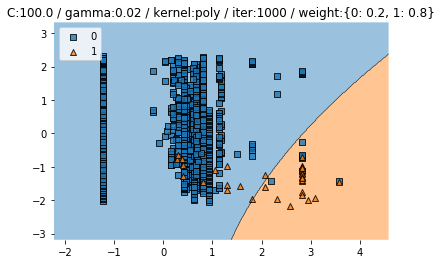

Train CV accuracy scores: [0.997543   0.98280098 0.98525799 0.99261084 0.99012346]
Train CV accuracy: 0.990 +/- 0.005
Train CV f1 scores: [0.99745003 0.98500993 0.98234625 0.99227958 0.98914815]
Train CV f1: 0.989 +/- 0.005
Test accuracy :  0.9892857142857143
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


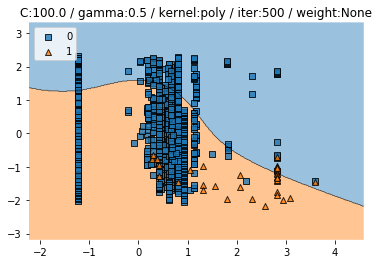

Train CV accuracy scores: [0.87223587 0.86732187 0.89189189 0.96305419 0.89135802]
Train CV accuracy: 0.897 +/- 0.034
Train CV f1 scores: [0.9181262  0.91413461 0.92908698 0.97235496 0.93058985]
Train CV f1: 0.933 +/- 0.021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9339285714285714
Test f1 :  0.17777777777777778


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


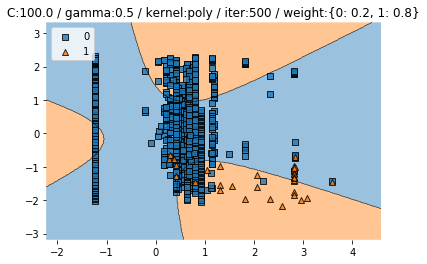

Train CV accuracy scores: [0.94594595 0.95331695 0.89189189 0.98029557 0.99259259]
Train CV accuracy: 0.953 +/- 0.035
Train CV f1 scores: [0.95897806 0.96618816 0.92908698 0.98350519 0.99331936]
Train CV f1: 0.966 +/- 0.022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9821428571428571
Test f1 :  0.5454545454545454


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


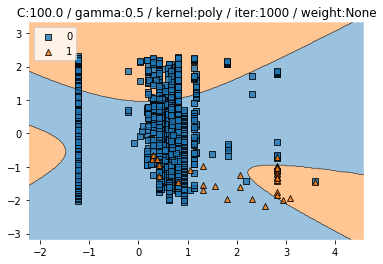

Train CV accuracy scores: [0.92383292 0.94840295 0.89434889 0.98029557 0.75308642]
Train CV accuracy: 0.900 +/- 0.079
Train CV f1 scores: [0.9456564  0.96199041 0.92916637 0.98413694 0.84579125]
Train CV f1: 0.933 +/- 0.047


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.55
Test f1 :  0.023255813953488372


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


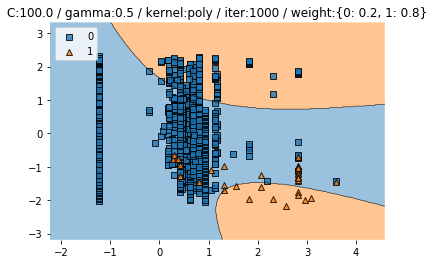

Train CV accuracy scores: [0.42997543 0.96068796 0.87469287 0.99261084 0.99506173]
Train CV accuracy: 0.851 +/- 0.215
Train CV f1 scores: [0.58235404 0.96946064 0.91801381 0.99289041 0.99506173]
Train CV f1: 0.892 +/- 0.157


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9767857142857143
Test f1 :  0.4799999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


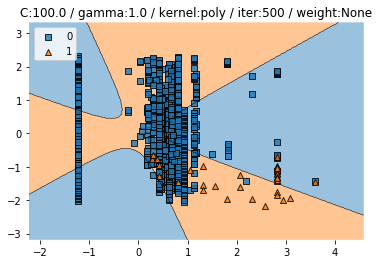

Train CV accuracy scores: [0.87223587 0.86732187 0.89189189 0.96305419 0.89135802]
Train CV accuracy: 0.897 +/- 0.034
Train CV f1 scores: [0.9181262  0.91413461 0.92908698 0.97235496 0.93058985]
Train CV f1: 0.933 +/- 0.021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9339285714285714
Test f1 :  0.17777777777777778


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


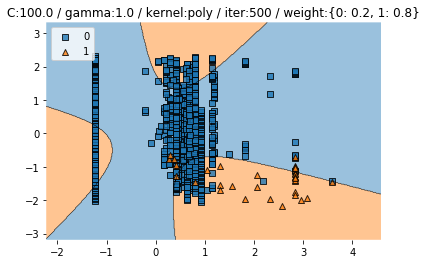

Train CV accuracy scores: [0.87223587 0.86732187 0.89189189 0.96305419 0.89135802]
Train CV accuracy: 0.897 +/- 0.034
Train CV f1 scores: [0.9181262  0.91413461 0.92908698 0.97235496 0.93058985]
Train CV f1: 0.933 +/- 0.021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9339285714285714
Test f1 :  0.17777777777777778


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


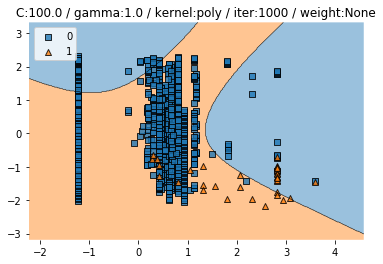

Train CV accuracy scores: [0.92383292 0.97051597 0.89434889 0.98029557 0.75308642]
Train CV accuracy: 0.904 +/- 0.082
Train CV f1 scores: [0.9456564  0.97647187 0.92916637 0.98413694 0.84579125]
Train CV f1: 0.936 +/- 0.049


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.55
Test f1 :  0.023255813953488372


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


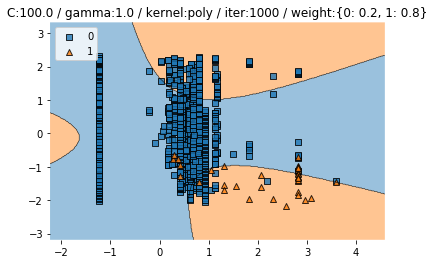

Train CV accuracy scores: [0.92383292 0.97051597 0.89434889 0.98029557 0.75308642]
Train CV accuracy: 0.904 +/- 0.082
Train CV f1 scores: [0.9456564  0.97647187 0.92916637 0.98413694 0.84579125]
Train CV f1: 0.936 +/- 0.049
Test accuracy :  0.55
Test f1 :  0.023255813953488372
117.16840386390686 secs


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


In [20]:
# blog title poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(4,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


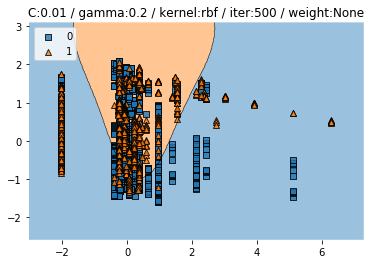

Train CV accuracy scores: [0.5578635  0.52077151 0.47774481 0.60029718 0.58035714]
Train CV accuracy: 0.547 +/- 0.044
Train CV f1 scores: [0.54338318 0.51418184 0.48472495 0.58243023 0.55541067]
Train CV f1: 0.536 +/- 0.034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4600985221674877
Test f1 :  0.5643879173290938


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


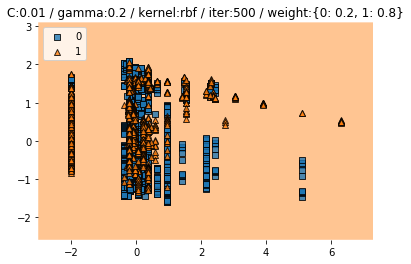

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


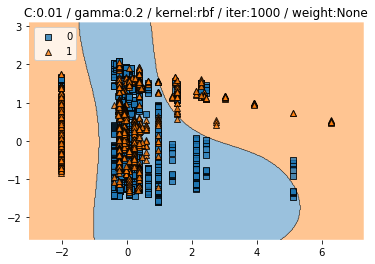

Train CV accuracy scores: [0.64985163 0.73145401 0.7537092  0.62852897 0.69196429]
Train CV accuracy: 0.691 +/- 0.047
Train CV f1 scores: [0.57315622 0.69832109 0.73183818 0.49318879 0.61727827]
Train CV f1: 0.623 +/- 0.086


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8
Test f1 :  0.7642276422764228


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


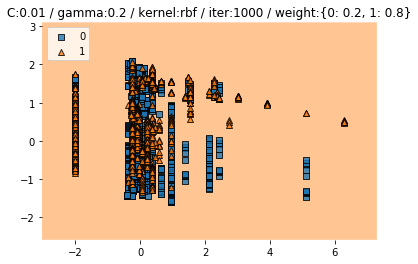

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


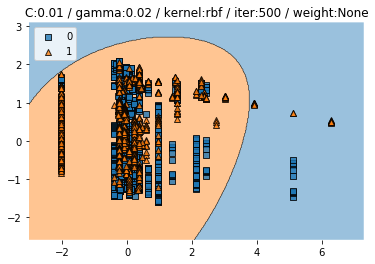

Train CV accuracy scores: [0.35905045 0.35459941 0.35905045 0.36106984 0.35565476]
Train CV accuracy: 0.358 +/- 0.002
Train CV f1 scores: [0.19889828 0.19207512 0.19128452 0.19157199 0.18973459]
Train CV f1: 0.193 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.569415081042988


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


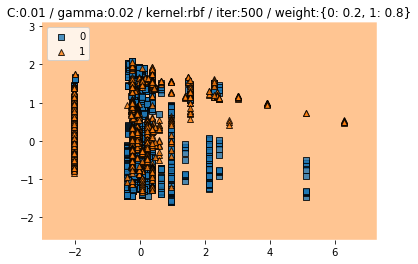

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


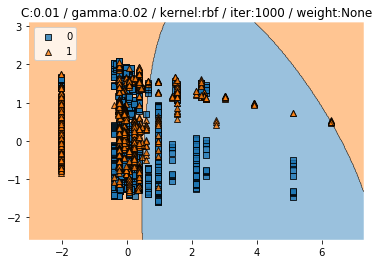

Train CV accuracy scores: [0.6379822  0.6379822  0.6379822  0.63893016 0.63839286]
Train CV accuracy: 0.638 +/- 0.000
Train CV f1 scores: [0.49697888 0.49697888 0.49697888 0.49816858 0.49749416]
Train CV f1: 0.497 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6798029556650246
Test f1 :  0.6713852376137514


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


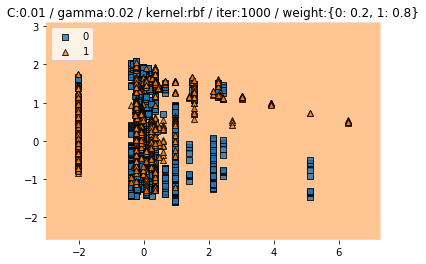

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


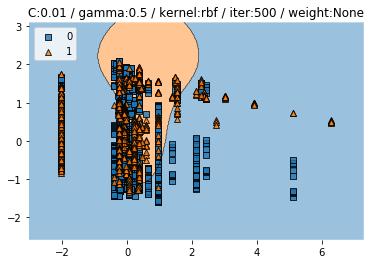

Train CV accuracy scores: [0.66468843 0.70178042 0.59643917 0.70579495 0.63839286]
Train CV accuracy: 0.661 +/- 0.041
Train CV f1 scores: [0.67009932 0.70731407 0.60426757 0.70437983 0.64379704]
Train CV f1: 0.666 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6945812807881774
Test f1 :  0.7080979284369113


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


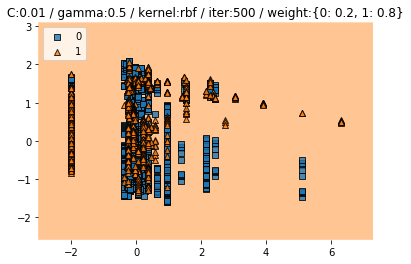

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


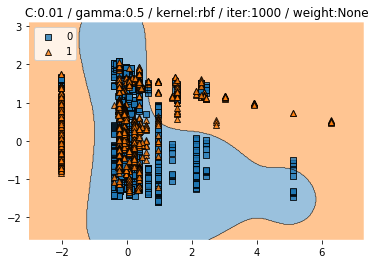

Train CV accuracy scores: [0.6884273  0.69881306 0.70029674 0.63744428 0.70238095]
Train CV accuracy: 0.685 +/- 0.024
Train CV f1 scores: [0.60963599 0.62933435 0.64728903 0.49746105 0.635247  ]
Train CV f1: 0.604 +/- 0.055


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8177339901477833
Test f1 :  0.7594278283485045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


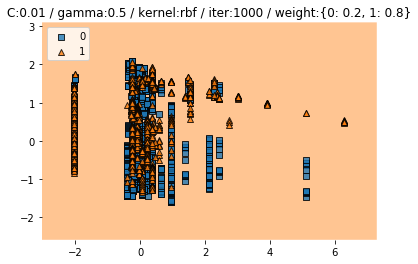

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


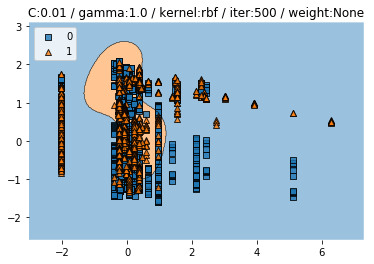

Train CV accuracy scores: [0.82492582 0.83827893 0.79228487 0.83655275 0.76636905]
Train CV accuracy: 0.812 +/- 0.028
Train CV f1 scores: [0.82277461 0.84008502 0.7953623  0.83973219 0.76743742]
Train CV f1: 0.813 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7093596059113301
Test f1 :  0.7315741583257508


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


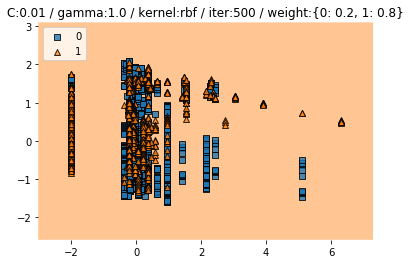

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


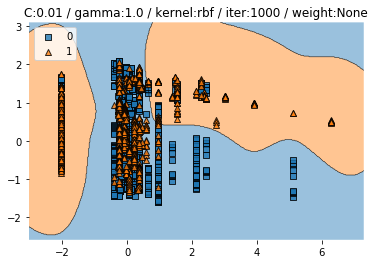

Train CV accuracy scores: [0.64688427 0.64094955 0.63501484 0.63893016 0.65327381]
Train CV accuracy: 0.643 +/- 0.006
Train CV f1 scores: [0.51707147 0.50376731 0.49556512 0.49816858 0.53063969]
Train CV f1: 0.509 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8236453201970443
Test f1 :  0.7629139072847682


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


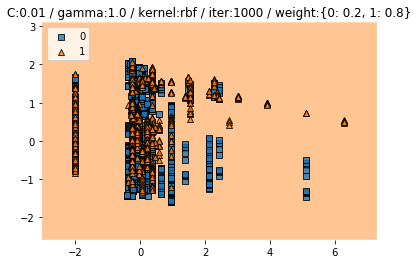

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


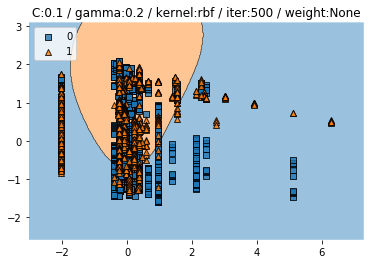

Train CV accuracy scores: [0.67507418 0.46884273 0.46735905 0.67161961 0.64732143]
Train CV accuracy: 0.586 +/- 0.097
Train CV f1 scores: [0.68008266 0.46238828 0.47329325 0.66794346 0.65384067]
Train CV f1: 0.588 +/- 0.098


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.48177339901477834
Test f1 :  0.5960061443932413


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


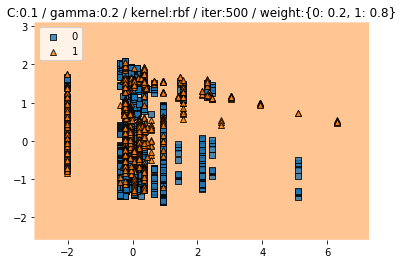

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


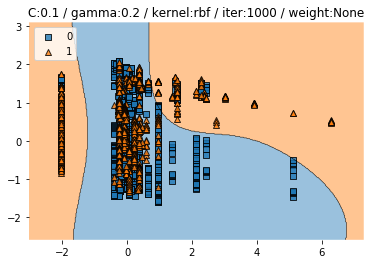

Train CV accuracy scores: [0.74480712 0.85459941 0.82492582 0.76968796 0.76934524]
Train CV accuracy: 0.793 +/- 0.041
Train CV f1 scores: [0.72693773 0.85361668 0.82522845 0.75610665 0.75282095]
Train CV f1: 0.783 +/- 0.048


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.819704433497537
Test f1 :  0.7543624161073825


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


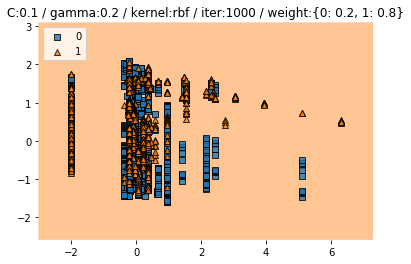

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


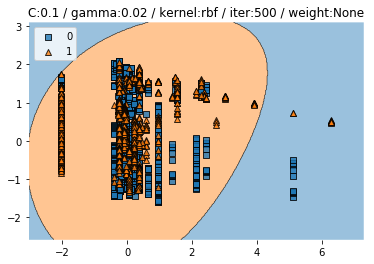

Train CV accuracy scores: [0.35905045 0.35014837 0.35905045 0.36106984 0.35565476]
Train CV accuracy: 0.357 +/- 0.004
Train CV f1 scores: [0.19889828 0.19028799 0.19128452 0.19157199 0.18973459]
Train CV f1: 0.192 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3960591133004926
Test f1 :  0.567395906845448


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


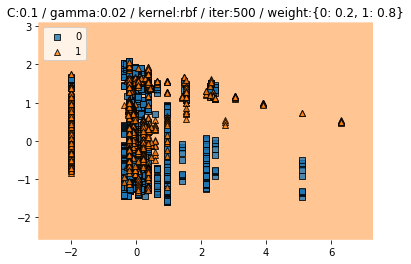

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


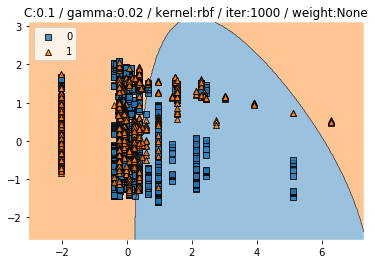

Train CV accuracy scores: [0.66913947 0.73293769 0.76854599 0.62704309 0.70386905]
Train CV accuracy: 0.700 +/- 0.049
Train CV f1 scores: [0.61740014 0.70922212 0.76237777 0.49505851 0.65278697]
Train CV f1: 0.647 +/- 0.091


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6945812807881774
Test f1 :  0.6966731898238747


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


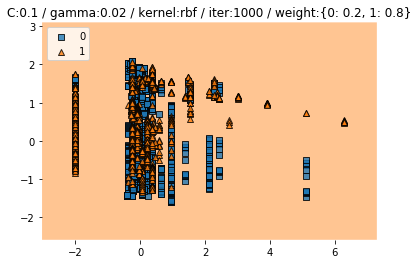

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


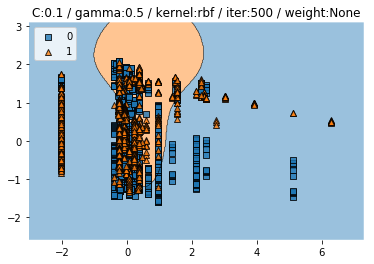

Train CV accuracy scores: [0.80267062 0.84272997 0.78931751 0.83506686 0.79017857]
Train CV accuracy: 0.812 +/- 0.023
Train CV f1 scores: [0.79575508 0.84395357 0.79205792 0.83828236 0.7884141 ]
Train CV f1: 0.812 +/- 0.024


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7507389162561576
Test f1 :  0.7033997655334114


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


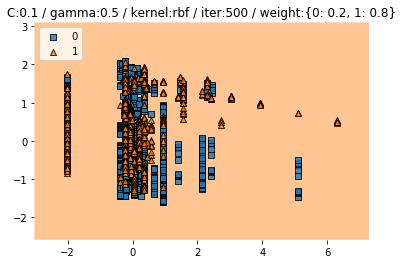

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


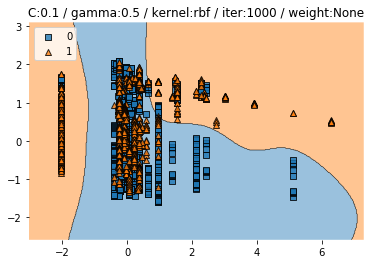

Train CV accuracy scores: [0.79821958 0.89317507 0.83976261 0.83060921 0.78422619]
Train CV accuracy: 0.829 +/- 0.038
Train CV f1 scores: [0.78129464 0.89222451 0.8400396  0.82850887 0.77152237]
Train CV f1: 0.823 +/- 0.044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.81871921182266
Test f1 :  0.747945205479452


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


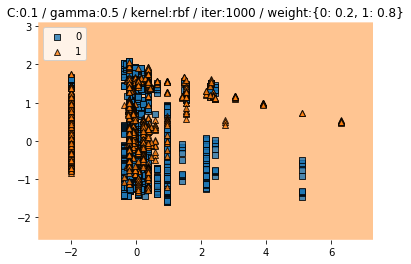

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


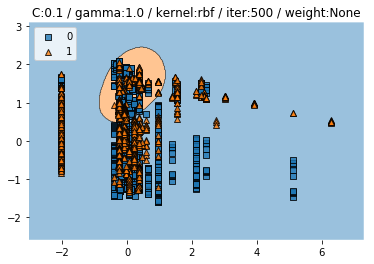

Train CV accuracy scores: [0.83531157 0.86795252 0.8115727  0.86329866 0.79910714]
Train CV accuracy: 0.835 +/- 0.027
Train CV f1 scores: [0.82696317 0.86789363 0.81334324 0.86589567 0.79386314]
Train CV f1: 0.834 +/- 0.029


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8147783251231527
Test f1 :  0.7655860349127183


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


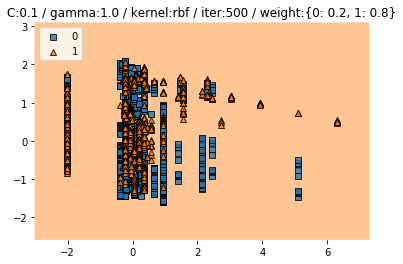

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


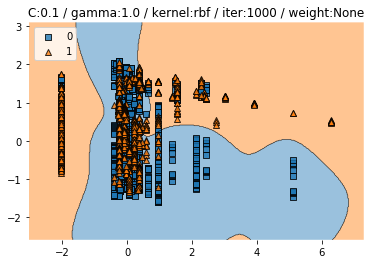

Train CV accuracy scores: [0.80860534 0.89762611 0.85311573 0.85735513 0.81547619]
Train CV accuracy: 0.846 +/- 0.032
Train CV f1 scores: [0.79412957 0.89642758 0.85277998 0.85722589 0.80851175]
Train CV f1: 0.842 +/- 0.037


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8226600985221675
Test f1 :  0.7520661157024793


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


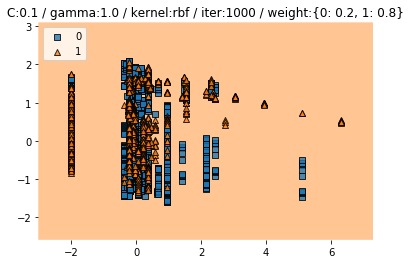

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


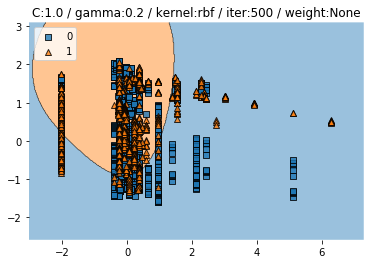

Train CV accuracy scores: [0.77448071 0.77744807 0.80860534 0.82020802 0.80059524]
Train CV accuracy: 0.796 +/- 0.018
Train CV f1 scores: [0.76014073 0.78170782 0.80947501 0.82168145 0.79371942]
Train CV f1: 0.793 +/- 0.021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5497536945812808
Test f1 :  0.5864253393665159


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


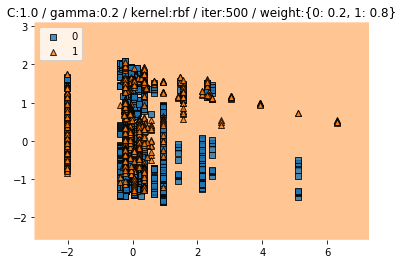

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.20507725 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.195 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


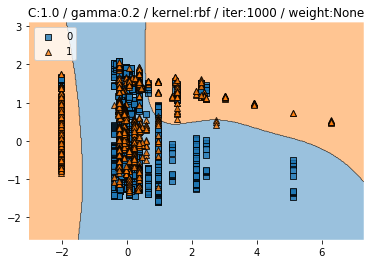

Train CV accuracy scores: [0.79376855 0.89614243 0.85608309 0.82317979 0.80208333]
Train CV accuracy: 0.834 +/- 0.038
Train CV f1 scores: [0.77571176 0.89498614 0.85518524 0.82325841 0.79377363]
Train CV f1: 0.829 +/- 0.043


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8315270935960591
Test f1 :  0.7692307692307693


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


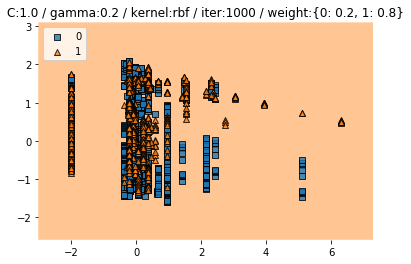

Train CV accuracy scores: [0.40059347 0.35756677 0.56824926 0.40713224 0.46577381]
Train CV accuracy: 0.440 +/- 0.073
Train CV f1 scores: [0.32164577 0.22183035 0.57181652 0.28623234 0.40622289]
Train CV f1: 0.362 +/- 0.121


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.41379310344827586
Test f1 :  0.5818692902319045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


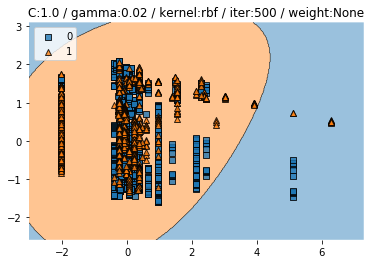

Train CV accuracy scores: [0.35608309 0.34718101 0.35905045 0.36106984 0.35565476]
Train CV accuracy: 0.356 +/- 0.005
Train CV f1 scores: [0.19011876 0.18909022 0.19128452 0.19157199 0.18973459]
Train CV f1: 0.190 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39704433497536945
Test f1 :  0.5684062059238365


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


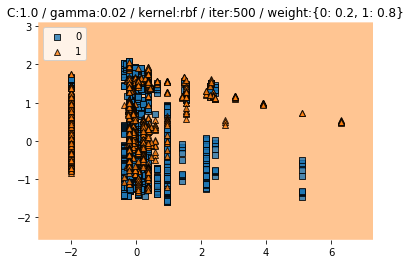

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


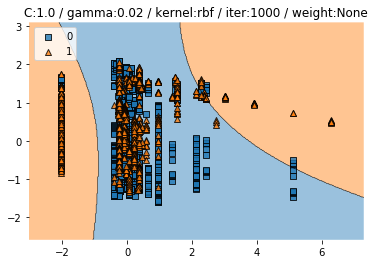

Train CV accuracy scores: [0.7462908  0.84272997 0.79821958 0.69985141 0.78125   ]
Train CV accuracy: 0.774 +/- 0.048
Train CV f1 scores: [0.73294941 0.84258882 0.7968558  0.63754681 0.76700933]
Train CV f1: 0.755 +/- 0.069


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7980295566502463
Test f1 :  0.7453416149068323


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


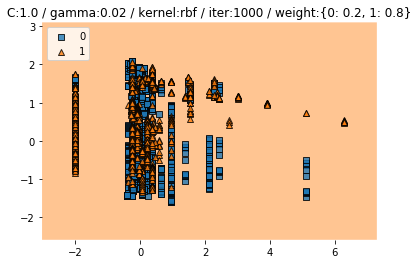

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.35565476]
Train CV accuracy: 0.361 +/- 0.002
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.18973459]
Train CV f1: 0.192 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


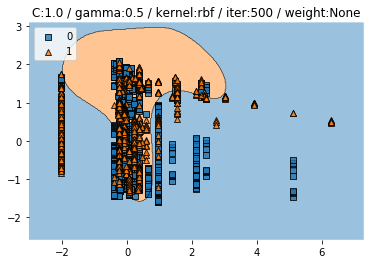

Train CV accuracy scores: [0.85163205 0.89169139 0.85756677 0.8692422  0.81547619]
Train CV accuracy: 0.857 +/- 0.025
Train CV f1 scores: [0.8433997  0.88990206 0.8570362  0.86999089 0.80788816]
Train CV f1: 0.854 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8443349753694581
Test f1 :  0.7937336814621411


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


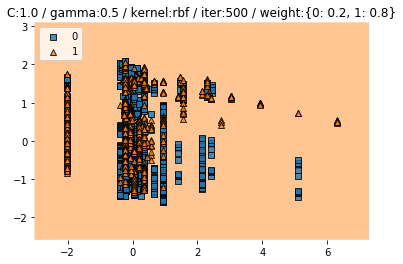

Train CV accuracy scores: [0.36795252 0.3694362  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.364 +/- 0.004
Train CV f1 scores: [0.20504745 0.20816537 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.198 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


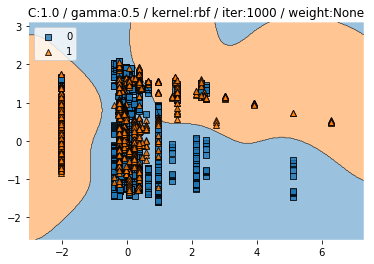

Train CV accuracy scores: [0.82937685 0.90059347 0.85756677 0.8692422  0.81547619]
Train CV accuracy: 0.854 +/- 0.030
Train CV f1 scores: [0.81724096 0.89942968 0.8570362  0.87017951 0.80788816]
Train CV f1: 0.850 +/- 0.034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8059113300492611
Test f1 :  0.7189728958630528


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


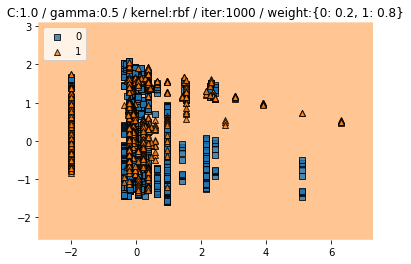

Train CV accuracy scores: [0.71364985 0.56973294 0.70771513 0.5423477  0.67410714]
Train CV accuracy: 0.642 +/- 0.072
Train CV f1 scores: [0.71619048 0.54356076 0.71338067 0.50343313 0.68006607]
Train CV f1: 0.631 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.43054187192118226
Test f1 :  0.5894886363636364


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


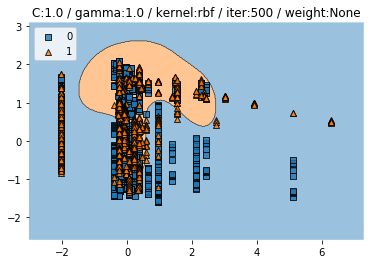

Train CV accuracy scores: [0.84124629 0.89910979 0.84718101 0.88707281 0.82291667]
Train CV accuracy: 0.860 +/- 0.029
Train CV f1 scores: [0.83131716 0.89787011 0.84724831 0.88855726 0.81517174]
Train CV f1: 0.856 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7921182266009852
Test f1 :  0.705718270571827


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


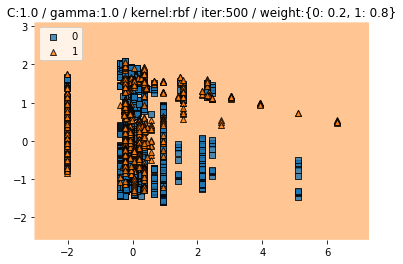

Train CV accuracy scores: [0.37388724 0.3768546  0.39910979 0.36106984 0.36904762]
Train CV accuracy: 0.376 +/- 0.013
Train CV f1 scores: [0.21744231 0.22356383 0.28423618 0.19157199 0.20783157]
Train CV f1: 0.225 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


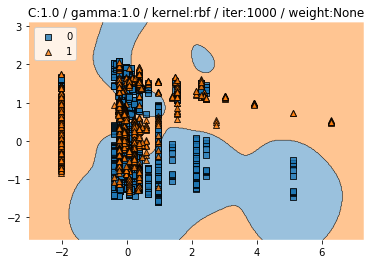

Train CV accuracy scores: [0.84569733 0.90059347 0.84569733 0.89301634 0.82589286]
Train CV accuracy: 0.862 +/- 0.029
Train CV f1 scores: [0.83652112 0.89931376 0.84583239 0.8941929  0.81796803]
Train CV f1: 0.859 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8068965517241379
Test f1 :  0.7231638418079097


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


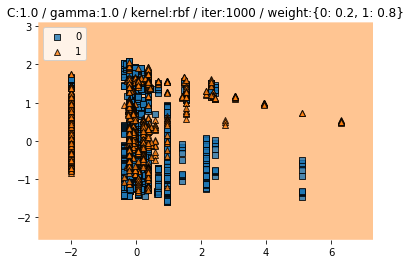

Train CV accuracy scores: [0.81305638 0.78338279 0.77002967 0.69390788 0.72916667]
Train CV accuracy: 0.758 +/- 0.042
Train CV f1 scores: [0.81663457 0.78719593 0.77432638 0.69185917 0.73228601]
Train CV f1: 0.760 +/- 0.044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6630541871921182
Test f1 :  0.7081911262798635


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


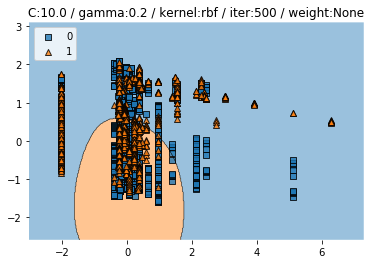

Train CV accuracy scores: [0.76854599 0.84866469 0.81602374 0.86775632 0.7797619 ]
Train CV accuracy: 0.816 +/- 0.038
Train CV f1 scores: [0.74621352 0.84715075 0.81706688 0.87011737 0.77509168]
Train CV f1: 0.811 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7093596059113301
Test f1 :  0.5718432510885341


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


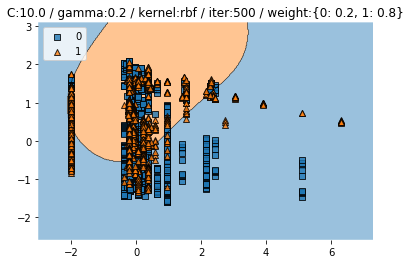

Train CV accuracy scores: [0.58902077 0.42878338 0.44362018 0.46953938 0.40922619]
Train CV accuracy: 0.468 +/- 0.064
Train CV f1 scores: [0.59677465 0.36141563 0.41311218 0.39504844 0.33766278]
Train CV f1: 0.421 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6098522167487684
Test f1 :  0.67


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


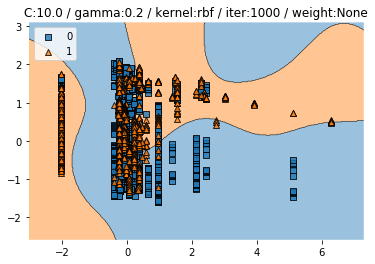

Train CV accuracy scores: [0.8264095  0.88724036 0.85459941 0.88261516 0.80505952]
Train CV accuracy: 0.851 +/- 0.032
Train CV f1 scores: [0.81406254 0.88598495 0.85433515 0.88387193 0.79818085]
Train CV f1: 0.847 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8
Test f1 :  0.7144866385372715


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


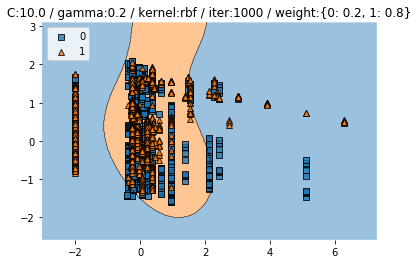

Train CV accuracy scores: [0.79821958 0.78338279 0.78041543 0.66121842 0.72619048]
Train CV accuracy: 0.750 +/- 0.051
Train CV f1 scores: [0.79992304 0.78757592 0.78384187 0.65794807 0.72851667]
Train CV f1: 0.752 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6236453201970443
Test f1 :  0.6086065573770492


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


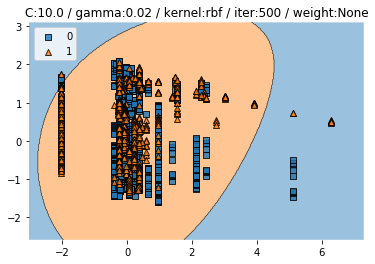

Train CV accuracy scores: [0.58753709 0.71216617 0.36498516 0.61812779 0.62053571]
Train CV accuracy: 0.581 +/- 0.116
Train CV f1 scores: [0.5842007  0.67795396 0.20382958 0.61044514 0.617634  ]
Train CV f1: 0.539 +/- 0.170


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.569415081042988


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


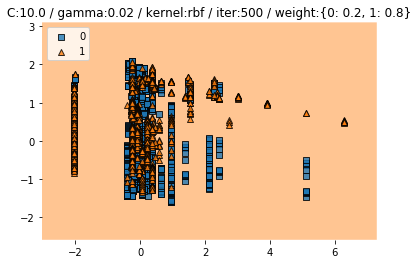

Train CV accuracy scores: [0.34866469 0.32492582 0.3620178  0.35958395 0.4047619 ]
Train CV accuracy: 0.360 +/- 0.026
Train CV f1 scores: [0.18718192 0.19144415 0.1975831  0.19099213 0.32740599]
Train CV f1: 0.219 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3891625615763547
Test f1 :  0.5602836879432624


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


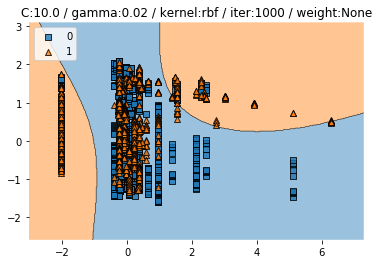

Train CV accuracy scores: [0.75816024 0.86350148 0.79970326 0.69687964 0.73958333]
Train CV accuracy: 0.772 +/- 0.057
Train CV f1 scores: [0.74497731 0.86213597 0.801055   0.67048634 0.73162295]
Train CV f1: 0.762 +/- 0.065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.864039408866995
Test f1 :  0.8368794326241135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


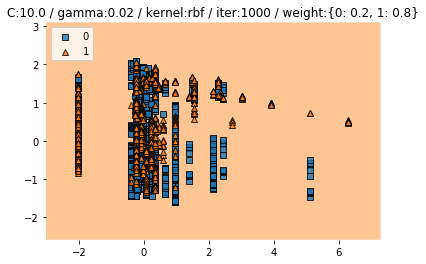

Train CV accuracy scores: [0.58456973 0.37240356 0.50296736 0.65527489 0.625     ]
Train CV accuracy: 0.548 +/- 0.102
Train CV f1 scores: [0.57771191 0.32797137 0.48277892 0.64854393 0.62404329]
Train CV f1: 0.532 +/- 0.117


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3931034482758621
Test f1 :  0.5490483162518301


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


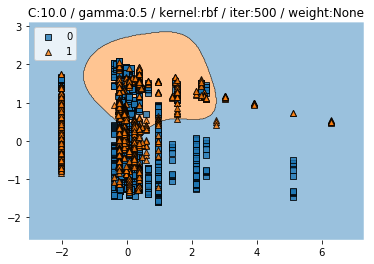

Train CV accuracy scores: [0.83086053 0.8620178  0.84272997 0.89598811 0.81994048]
Train CV accuracy: 0.850 +/- 0.027
Train CV f1 scores: [0.82180411 0.8578285  0.84258882 0.89665978 0.81108649]
Train CV f1: 0.846 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7359605911330049
Test f1 :  0.6203966005665722


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


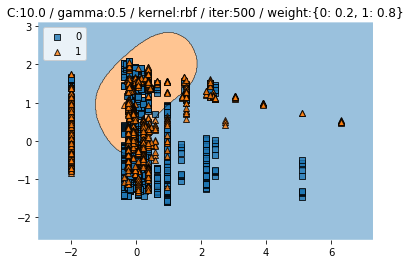

Train CV accuracy scores: [0.71513353 0.65578635 0.72848665 0.67607727 0.62946429]
Train CV accuracy: 0.681 +/- 0.037
Train CV f1 scores: [0.71434734 0.65712023 0.73256476 0.67261894 0.63667434]
Train CV f1: 0.683 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5802955665024631
Test f1 :  0.6263157894736843


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


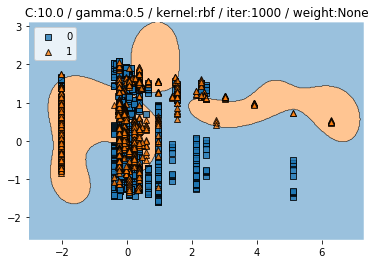

Train CV accuracy scores: [0.84718101 0.89020772 0.84272997 0.90341753 0.81547619]
Train CV accuracy: 0.860 +/- 0.032
Train CV f1 scores: [0.83824711 0.88910937 0.84300183 0.9040758  0.80588138]
Train CV f1: 0.856 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7901477832512315
Test f1 :  0.6978723404255319


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


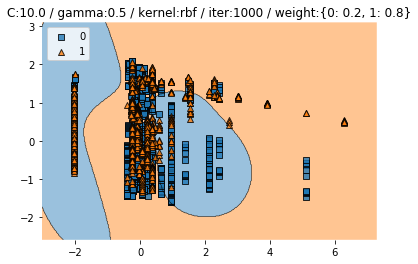

Train CV accuracy scores: [0.81454006 0.82492582 0.81305638 0.76077266 0.7485119 ]
Train CV accuracy: 0.792 +/- 0.031
Train CV f1 scores: [0.81478203 0.82711538 0.81557798 0.76431468 0.74985328]
Train CV f1: 0.794 +/- 0.031


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7753694581280788
Test f1 :  0.732394366197183


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


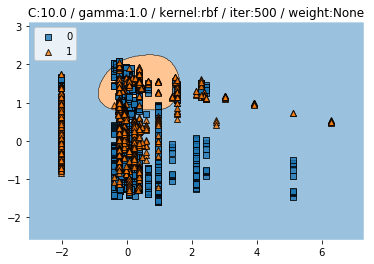

Train CV accuracy scores: [0.85459941 0.88278932 0.87240356 0.92570579 0.83482143]
Train CV accuracy: 0.874 +/- 0.031
Train CV f1 scores: [0.84565572 0.88024127 0.87240356 0.92589782 0.82788626]
Train CV f1: 0.870 +/- 0.033


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7182266009852217
Test f1 :  0.56797583081571


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


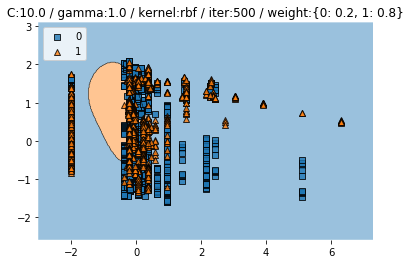

Train CV accuracy scores: [0.83827893 0.82344214 0.80860534 0.72808321 0.79166667]
Train CV accuracy: 0.798 +/- 0.038
Train CV f1 scores: [0.83979853 0.82676791 0.81015828 0.72953789 0.79067837]
Train CV f1: 0.799 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6679802955665025
Test f1 :  0.6731328806983511


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


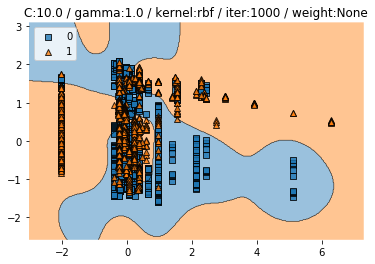

Train CV accuracy scores: [0.84569733 0.89317507 0.8694362  0.92421991 0.83035714]
Train CV accuracy: 0.873 +/- 0.033
Train CV f1 scores: [0.83683097 0.8909249  0.86955049 0.92444697 0.82308673]
Train CV f1: 0.869 +/- 0.037


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7862068965517242
Test f1 :  0.6904422253922968


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


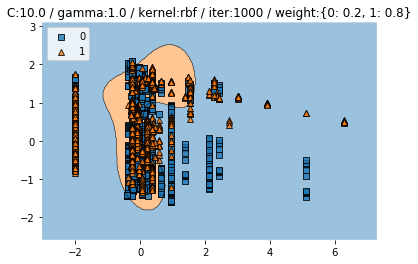

Train CV accuracy scores: [0.84866469 0.86795252 0.83086053 0.80089153 0.81994048]
Train CV accuracy: 0.834 +/- 0.023
Train CV f1 scores: [0.84824702 0.86963736 0.83297587 0.80472143 0.81760714]
Train CV f1: 0.835 +/- 0.023


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8039408866995074
Test f1 :  0.7540173053152041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


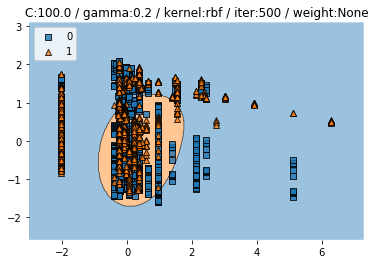

Train CV accuracy scores: [0.64391691 0.5727003  0.75222552 0.48142645 0.63690476]
Train CV accuracy: 0.617 +/- 0.089
Train CV f1 scores: [0.62052336 0.53475539 0.75594708 0.4915513  0.63365259]
Train CV f1: 0.607 +/- 0.091


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5891625615763547
Test f1 :  0.4945454545454545


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


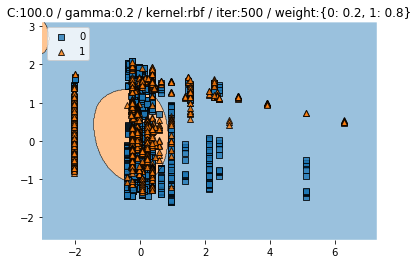

Train CV accuracy scores: [0.70029674 0.75816024 0.75964392 0.61515602 0.5610119 ]
Train CV accuracy: 0.679 +/- 0.079
Train CV f1 scores: [0.69975205 0.76229608 0.76430642 0.6227317  0.56543265]
Train CV f1: 0.683 +/- 0.078


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6827586206896552
Test f1 :  0.6298850574712642


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


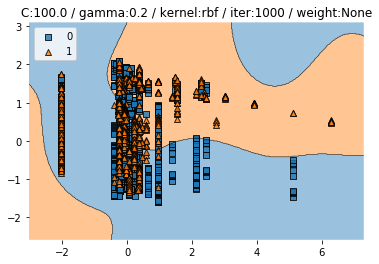

Train CV accuracy scores: [0.74925816 0.71958457 0.75667656 0.7013373  0.70833333]
Train CV accuracy: 0.727 +/- 0.022
Train CV f1 scores: [0.73197497 0.69901281 0.75424238 0.70693442 0.70329778]
Train CV f1: 0.719 +/- 0.021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6108374384236454
Test f1 :  0.43812233285917496


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


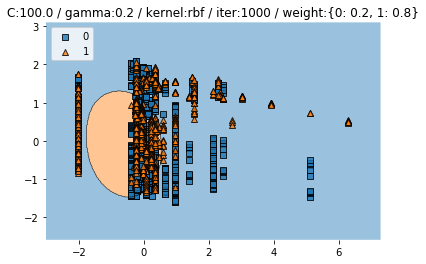

Train CV accuracy scores: [0.71216617 0.62908012 0.78783383 0.80980684 0.73511905]
Train CV accuracy: 0.735 +/- 0.063
Train CV f1 scores: [0.71618153 0.63599403 0.7917707  0.81353455 0.73770578]
Train CV f1: 0.739 +/- 0.062


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6827586206896552
Test f1 :  0.6220657276995306


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


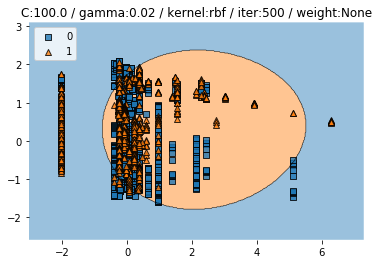

Train CV accuracy scores: [0.70919881 0.51038576 0.6379822  0.62109955 0.54613095]
Train CV accuracy: 0.605 +/- 0.070
Train CV f1 scores: [0.70596118 0.49514688 0.64382404 0.62727932 0.55097057]
Train CV f1: 0.605 +/- 0.074


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6275862068965518
Test f1 :  0.5944206008583691


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


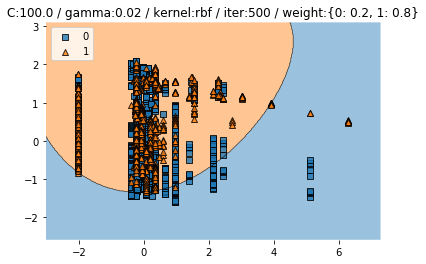

Train CV accuracy scores: [0.59792285 0.43175074 0.61721068 0.45468053 0.3735119 ]
Train CV accuracy: 0.495 +/- 0.096
Train CV f1 scores: [0.60373343 0.43055608 0.62232681 0.42594414 0.3080388 ]
Train CV f1: 0.478 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7172413793103448
Test f1 :  0.6807563959955505


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


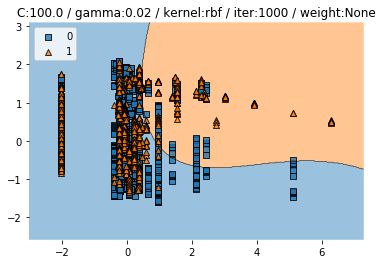

Train CV accuracy scores: [0.77151335 0.80563798 0.68545994 0.66121842 0.7202381 ]
Train CV accuracy: 0.729 +/- 0.053
Train CV f1 scores: [0.76138809 0.80621476 0.68397747 0.66778717 0.71610704]
Train CV f1: 0.727 +/- 0.051


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7477832512315271
Test f1 :  0.7110609480812641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


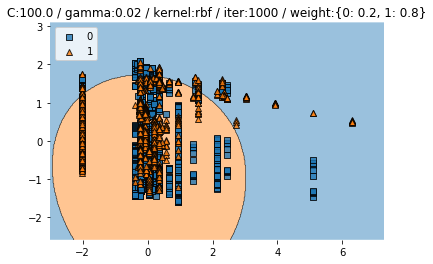

Train CV accuracy scores: [0.58456973 0.57566766 0.63946588 0.448737   0.62946429]
Train CV accuracy: 0.576 +/- 0.068
Train CV f1 scores: [0.58647979 0.57849434 0.64594084 0.36214027 0.62961608]
Train CV f1: 0.561 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4600985221674877
Test f1 :  0.5616000000000001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


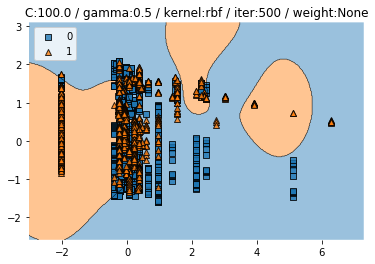

Train CV accuracy scores: [0.61424332 0.58902077 0.77596439 0.69985141 0.58035714]
Train CV accuracy: 0.652 +/- 0.075
Train CV f1 scores: [0.59207743 0.58846403 0.77015555 0.69957947 0.58821059]
Train CV f1: 0.648 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4640394088669951
Test f1 :  0.3732718894009217


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


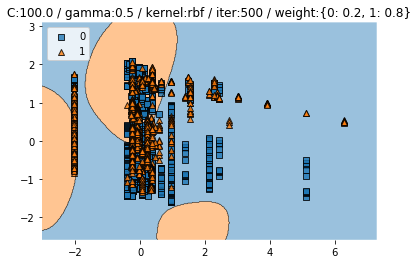

Train CV accuracy scores: [0.69139466 0.70771513 0.8041543  0.72511144 0.66071429]
Train CV accuracy: 0.718 +/- 0.048
Train CV f1 scores: [0.67716868 0.71046156 0.80660364 0.73052264 0.66616629]
Train CV f1: 0.718 +/- 0.050


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6068965517241379
Test f1 :  0.4450625869262865


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


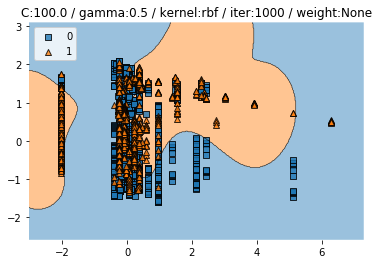

Train CV accuracy scores: [0.77299703 0.85608309 0.81602374 0.76968796 0.76041667]
Train CV accuracy: 0.795 +/- 0.036
Train CV f1 scores: [0.76391923 0.85080645 0.81376315 0.77187404 0.74951156]
Train CV f1: 0.790 +/- 0.037


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7054187192118226
Test f1 :  0.5685425685425686


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


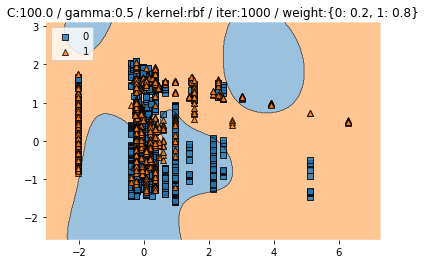

Train CV accuracy scores: [0.79376855 0.85311573 0.83086053 0.79791976 0.77232143]
Train CV accuracy: 0.810 +/- 0.029
Train CV f1 scores: [0.79570638 0.85305022 0.83288783 0.80183052 0.77370418]
Train CV f1: 0.811 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.723152709359606
Test f1 :  0.6134800550206327


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


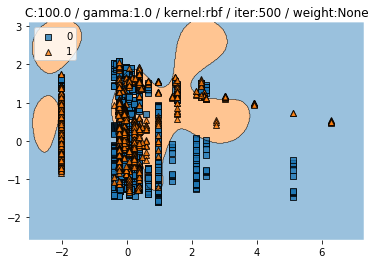

Train CV accuracy scores: [0.65133531 0.63649852 0.70029674 0.72511144 0.74255952]
Train CV accuracy: 0.691 +/- 0.041
Train CV f1 scores: [0.64600773 0.63094423 0.69187096 0.72186384 0.73262838]
Train CV f1: 0.685 +/- 0.040


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6177339901477833
Test f1 :  0.38607594936708867


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


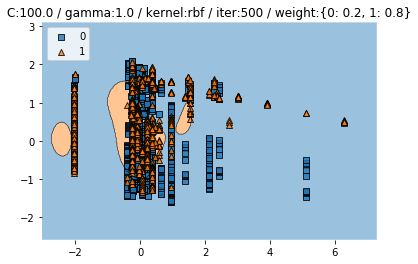

Train CV accuracy scores: [0.78189911 0.73738872 0.76854599 0.82020802 0.7797619 ]
Train CV accuracy: 0.778 +/- 0.027
Train CV f1 scores: [0.77280495 0.73132009 0.77018879 0.82354253 0.7765098 ]
Train CV f1: 0.775 +/- 0.029


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5428571428571428
Test f1 :  0.3643835616438357


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


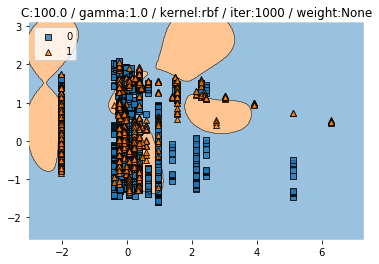

Train CV accuracy scores: [0.87240356 0.89614243 0.84866469 0.92421991 0.8125    ]
Train CV accuracy: 0.871 +/- 0.038
Train CV f1 scores: [0.86782904 0.89395477 0.84929391 0.92382098 0.80719291]
Train CV f1: 0.868 +/- 0.040


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.741871921182266
Test f1 :  0.6158357771260997


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


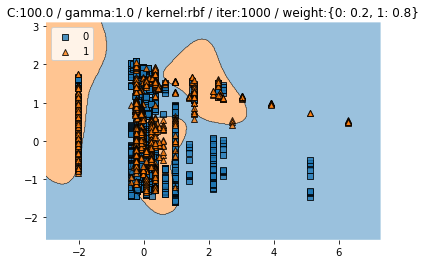

Train CV accuracy scores: [0.85608309 0.89910979 0.84421365 0.90193165 0.80803571]
Train CV accuracy: 0.862 +/- 0.035
Train CV f1 scores: [0.8517136  0.89901924 0.84586461 0.90335841 0.80662814]
Train CV f1: 0.861 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7901477832512315
Test f1 :  0.7102040816326531
631.9599978923798 secs


In [15]:
# shop rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(5,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


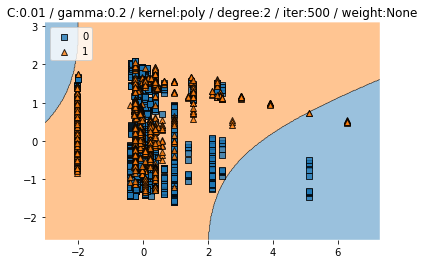

Train CV accuracy scores: [0.35756677 0.35311573 0.35905045 0.36106984 0.36011905]
Train CV accuracy: 0.358 +/- 0.003
Train CV f1 scores: [0.19070227 0.18894789 0.19128452 0.19157199 0.19148562]
Train CV f1: 0.191 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


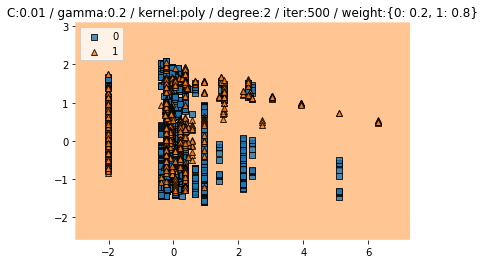

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


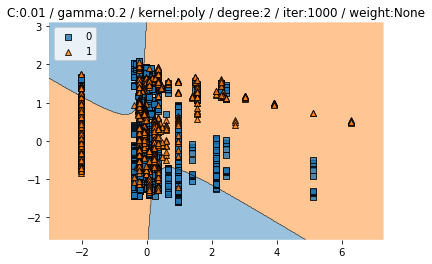

Train CV accuracy scores: [0.37388724 0.73442136 0.75074184 0.63447251 0.68154762]
Train CV accuracy: 0.635 +/- 0.137
Train CV f1 scores: [0.2222638  0.68151184 0.70761811 0.49869373 0.60193452]
Train CV f1: 0.542 +/- 0.176


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


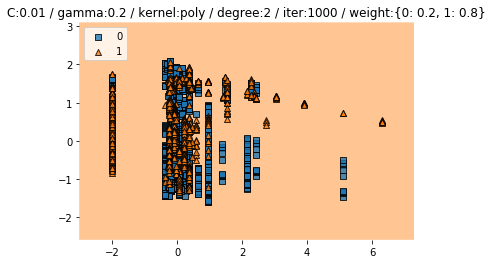

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


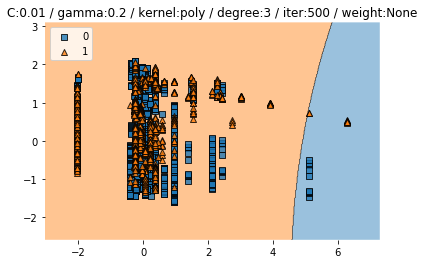

Train CV accuracy scores: [0.35756677 0.35311573 0.35905045 0.36106984 0.36011905]
Train CV accuracy: 0.358 +/- 0.003
Train CV f1 scores: [0.19070227 0.18894789 0.19128452 0.19157199 0.19148562]
Train CV f1: 0.191 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


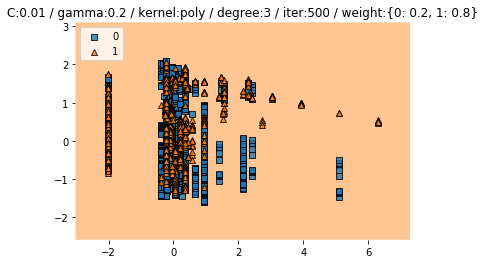

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


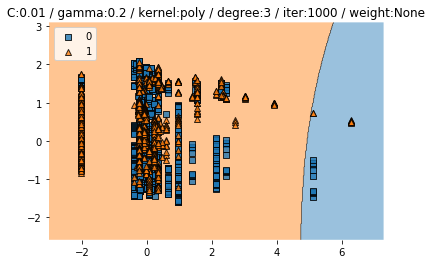

Train CV accuracy scores: [0.37388724 0.73442136 0.75074184 0.63447251 0.68154762]
Train CV accuracy: 0.635 +/- 0.137
Train CV f1 scores: [0.2222638  0.68151184 0.70761811 0.49869373 0.60193452]
Train CV f1: 0.542 +/- 0.176


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


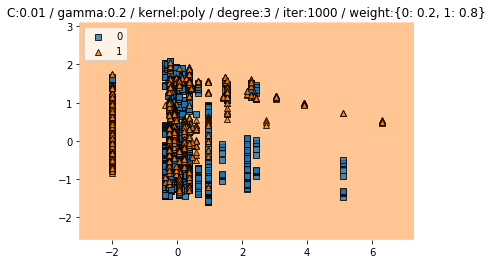

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


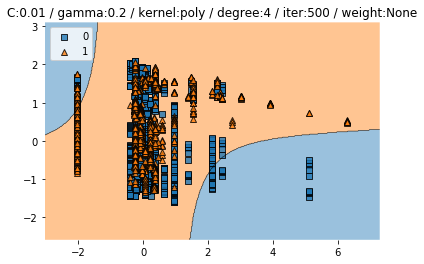

Train CV accuracy scores: [0.35756677 0.35311573 0.35905045 0.36106984 0.36011905]
Train CV accuracy: 0.358 +/- 0.003
Train CV f1 scores: [0.19070227 0.18894789 0.19128452 0.19157199 0.19148562]
Train CV f1: 0.191 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


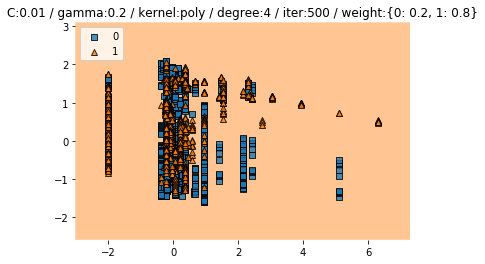

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


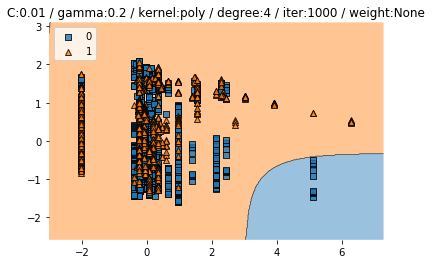

Train CV accuracy scores: [0.37388724 0.73442136 0.75074184 0.63447251 0.68154762]
Train CV accuracy: 0.635 +/- 0.137
Train CV f1 scores: [0.2222638  0.68151184 0.70761811 0.49869373 0.60193452]
Train CV f1: 0.542 +/- 0.176


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


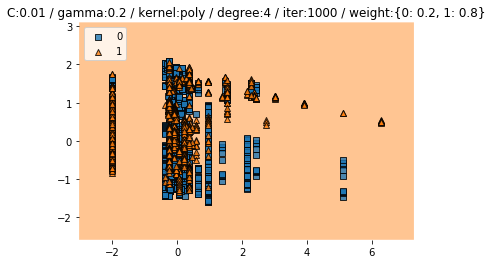

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


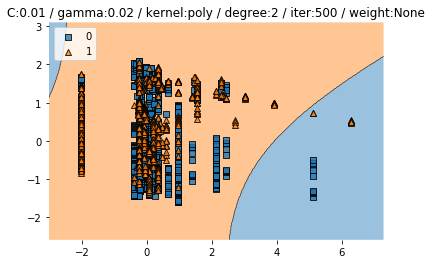

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


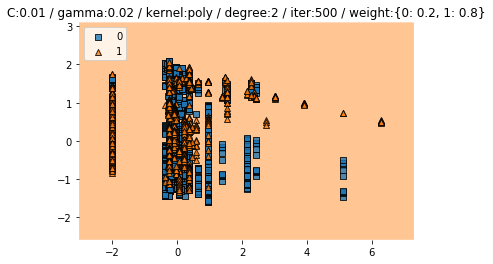

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


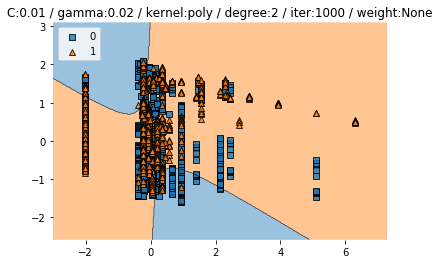

Train CV accuracy scores: [0.64243323 0.64094955 0.63946588 0.63893016 0.63988095]
Train CV accuracy: 0.640 +/- 0.001
Train CV f1 scores: [0.50712701 0.50376731 0.5003847  0.49816858 0.50091042]
Train CV f1: 0.502 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


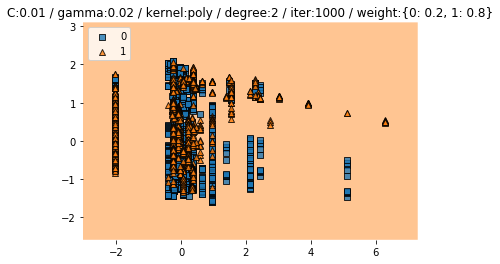

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


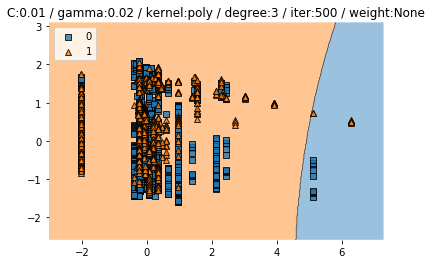

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


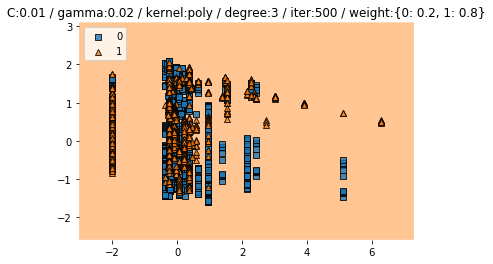

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


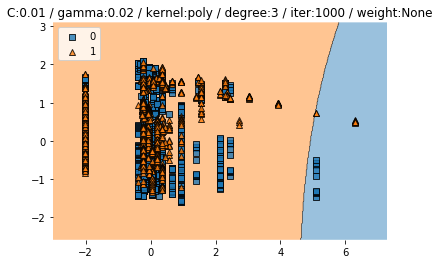

Train CV accuracy scores: [0.64243323 0.64094955 0.63946588 0.63893016 0.63988095]
Train CV accuracy: 0.640 +/- 0.001
Train CV f1 scores: [0.50712701 0.50376731 0.5003847  0.49816858 0.50091042]
Train CV f1: 0.502 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


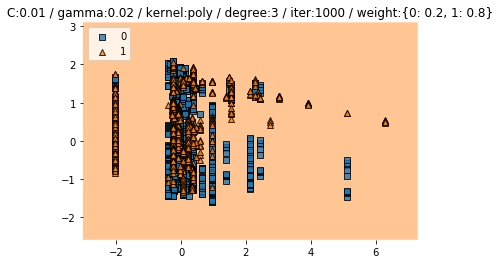

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


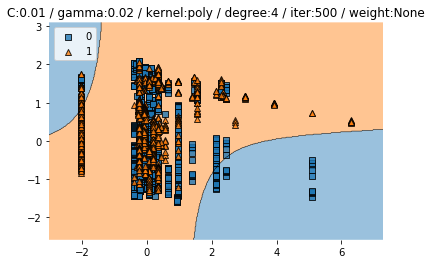

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


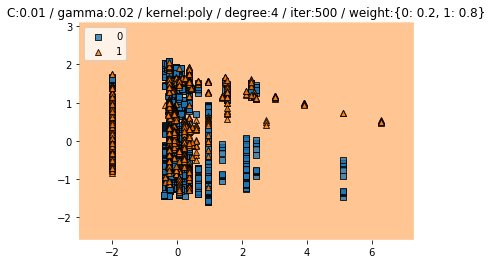

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


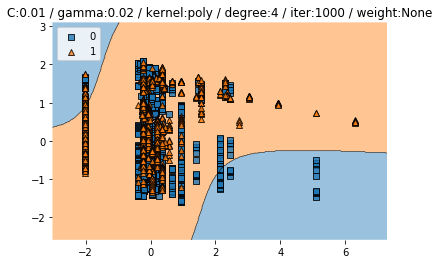

Train CV accuracy scores: [0.64243323 0.64094955 0.63946588 0.63893016 0.63988095]
Train CV accuracy: 0.640 +/- 0.001
Train CV f1 scores: [0.50712701 0.50376731 0.5003847  0.49816858 0.50091042]
Train CV f1: 0.502 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


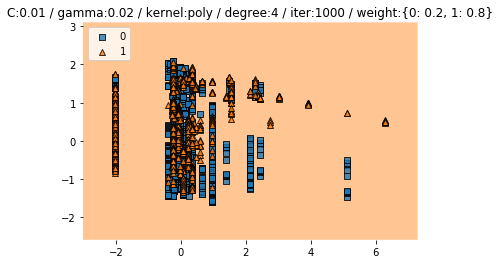

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


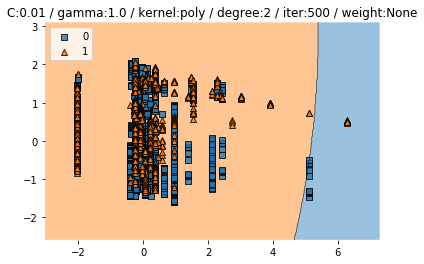

Train CV accuracy scores: [0.35014837 0.69139466 0.36498516 0.36106984 0.39136905]
Train CV accuracy: 0.432 +/- 0.131
Train CV f1 scores: [0.18777187 0.69632306 0.20382958 0.19157199 0.26192054]
Train CV f1: 0.308 +/- 0.196


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4059113300492611
Test f1 :  0.5774351786965662


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


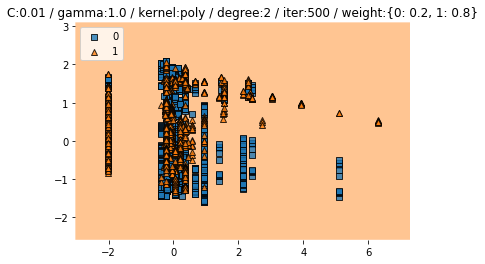

Train CV accuracy scores: [0.34718101 0.35756677 0.36795252 0.38038633 0.36904762]
Train CV accuracy: 0.364 +/- 0.011
Train CV f1 scores: [0.19642386 0.22839794 0.2100247  0.23182923 0.22000644]
Train CV f1: 0.217 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3960591133004926
Test f1 :  0.567395906845448


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


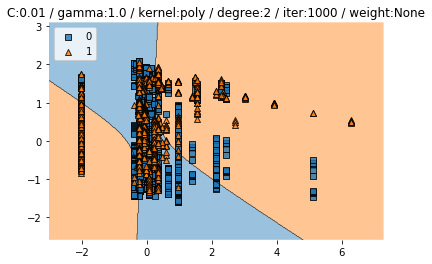

Train CV accuracy scores: [0.35014837 0.8115727  0.36053412 0.36998514 0.36904762]
Train CV accuracy: 0.452 +/- 0.180
Train CV f1 scores: [0.18777187 0.80869354 0.19186549 0.21042033 0.21032139]
Train CV f1: 0.322 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47586206896551725
Test f1 :  0.6023916292974589


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


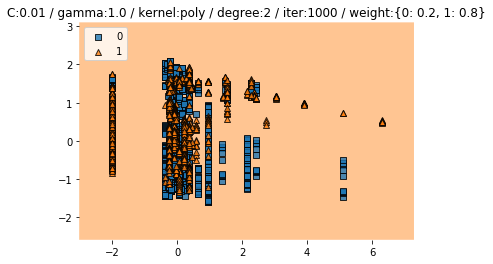

Train CV accuracy scores: [0.41394659 0.40801187 0.36498516 0.37741456 0.35863095]
Train CV accuracy: 0.385 +/- 0.022
Train CV f1 scores: [0.31645761 0.3229857  0.20382958 0.22577455 0.20102782]
Train CV f1: 0.254 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40295566502463054
Test f1 :  0.5484351713859912


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


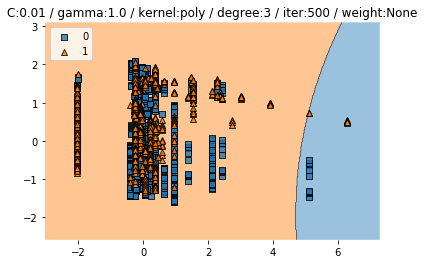

Train CV accuracy scores: [0.35014837 0.69139466 0.36498516 0.36106984 0.39136905]
Train CV accuracy: 0.432 +/- 0.131
Train CV f1 scores: [0.18777187 0.69632306 0.20382958 0.19157199 0.26192054]
Train CV f1: 0.308 +/- 0.196


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4059113300492611
Test f1 :  0.5774351786965662


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


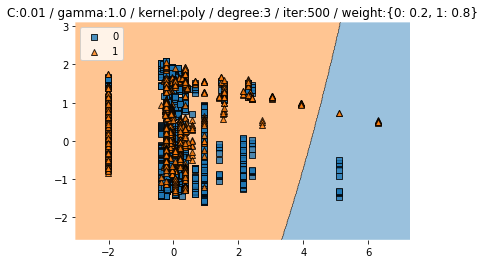

Train CV accuracy scores: [0.34718101 0.35756677 0.36795252 0.38038633 0.36904762]
Train CV accuracy: 0.364 +/- 0.011
Train CV f1 scores: [0.19642386 0.22839794 0.2100247  0.23182923 0.22000644]
Train CV f1: 0.217 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3960591133004926
Test f1 :  0.567395906845448


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


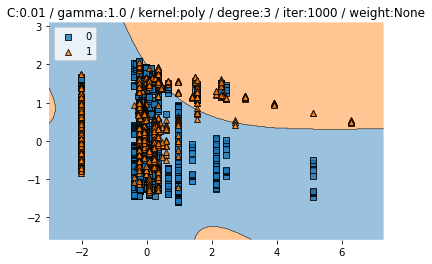

Train CV accuracy scores: [0.35014837 0.8115727  0.36053412 0.36998514 0.36904762]
Train CV accuracy: 0.452 +/- 0.180
Train CV f1 scores: [0.18777187 0.80869354 0.19186549 0.21042033 0.21032139]
Train CV f1: 0.322 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47586206896551725
Test f1 :  0.6023916292974589


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


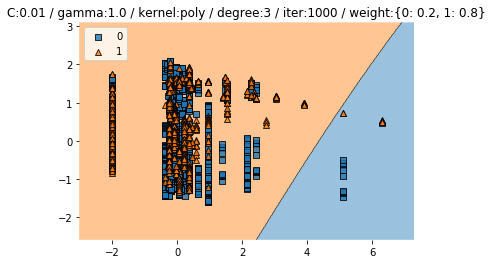

Train CV accuracy scores: [0.41394659 0.40801187 0.36498516 0.37741456 0.35863095]
Train CV accuracy: 0.385 +/- 0.022
Train CV f1 scores: [0.31645761 0.3229857  0.20382958 0.22577455 0.20102782]
Train CV f1: 0.254 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40295566502463054
Test f1 :  0.5484351713859912


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


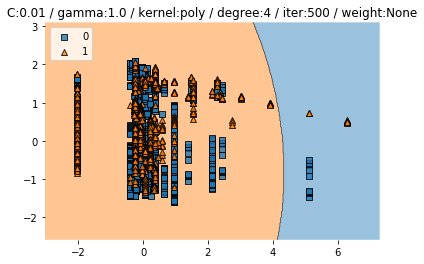

Train CV accuracy scores: [0.35014837 0.69139466 0.36498516 0.36106984 0.39136905]
Train CV accuracy: 0.432 +/- 0.131
Train CV f1 scores: [0.18777187 0.69632306 0.20382958 0.19157199 0.26192054]
Train CV f1: 0.308 +/- 0.196


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4059113300492611
Test f1 :  0.5774351786965662


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


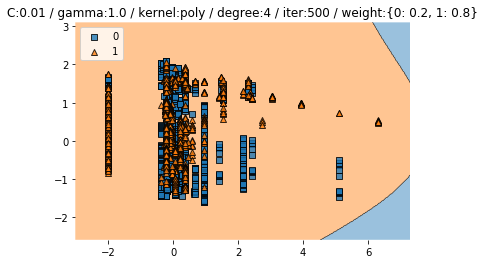

Train CV accuracy scores: [0.34718101 0.35756677 0.36795252 0.38038633 0.36904762]
Train CV accuracy: 0.364 +/- 0.011
Train CV f1 scores: [0.19642386 0.22839794 0.2100247  0.23182923 0.22000644]
Train CV f1: 0.217 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3960591133004926
Test f1 :  0.567395906845448


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


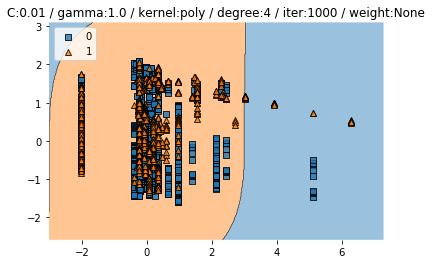

Train CV accuracy scores: [0.35014837 0.8115727  0.36053412 0.36998514 0.36904762]
Train CV accuracy: 0.452 +/- 0.180
Train CV f1 scores: [0.18777187 0.80869354 0.19186549 0.21042033 0.21032139]
Train CV f1: 0.322 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47586206896551725
Test f1 :  0.6023916292974589


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


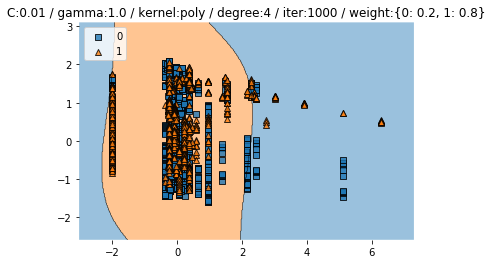

Train CV accuracy scores: [0.41394659 0.40801187 0.36498516 0.37741456 0.35863095]
Train CV accuracy: 0.385 +/- 0.022
Train CV f1 scores: [0.31645761 0.3229857  0.20382958 0.22577455 0.20102782]
Train CV f1: 0.254 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40295566502463054
Test f1 :  0.5484351713859912


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


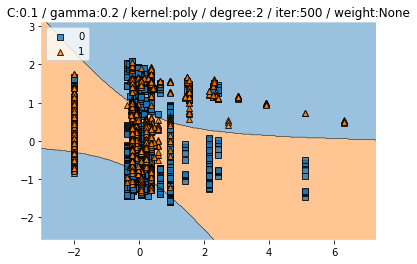

Train CV accuracy scores: [0.35014837 0.35311573 0.36498516 0.36998514 0.36011905]
Train CV accuracy: 0.360 +/- 0.007
Train CV f1 scores: [0.18777187 0.18894789 0.20382958 0.21042033 0.19148562]
Train CV f1: 0.196 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


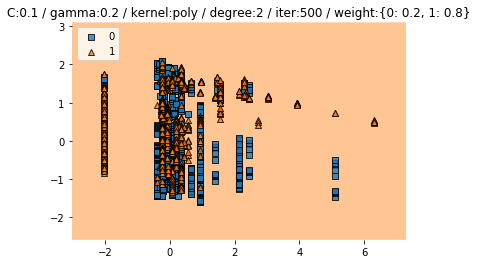

Train CV accuracy scores: [0.35608309 0.35311573 0.35905045 0.36106984 0.35565476]
Train CV accuracy: 0.357 +/- 0.003
Train CV f1 scores: [0.19011876 0.18894789 0.19128452 0.19157199 0.18973459]
Train CV f1: 0.190 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40295566502463054
Test f1 :  0.5744382022471911


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


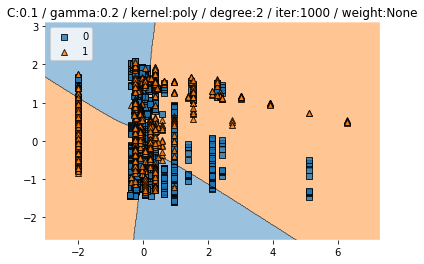

Train CV accuracy scores: [0.70919881 0.83827893 0.79376855 0.36998514 0.36309524]
Train CV accuracy: 0.615 +/- 0.207
Train CV f1 scores: [0.63858839 0.83038198 0.76894753 0.21042033 0.19781659]
Train CV f1: 0.529 +/- 0.273


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4068965517241379
Test f1 :  0.5784313725490197


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


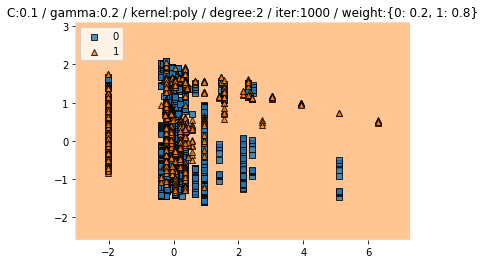

Train CV accuracy scores: [0.34866469 0.35311573 0.36498516 0.36849926 0.35565476]
Train CV accuracy: 0.358 +/- 0.007
Train CV f1 scores: [0.18718192 0.18894789 0.20382958 0.20731148 0.18973459]
Train CV f1: 0.195 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


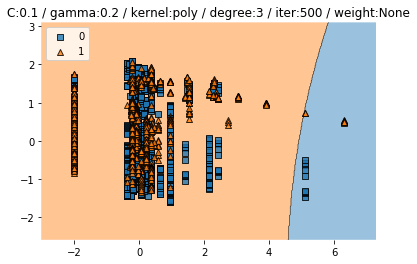

Train CV accuracy scores: [0.35014837 0.35311573 0.36498516 0.36998514 0.36011905]
Train CV accuracy: 0.360 +/- 0.007
Train CV f1 scores: [0.18777187 0.18894789 0.20382958 0.21042033 0.19148562]
Train CV f1: 0.196 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


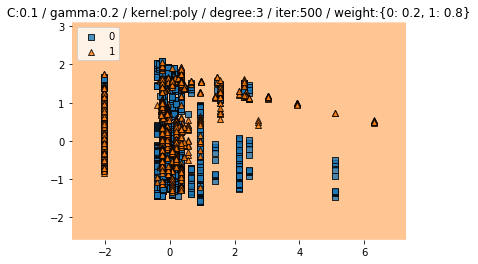

Train CV accuracy scores: [0.35608309 0.35311573 0.35905045 0.36106984 0.35565476]
Train CV accuracy: 0.357 +/- 0.003
Train CV f1 scores: [0.19011876 0.18894789 0.19128452 0.19157199 0.18973459]
Train CV f1: 0.190 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40295566502463054
Test f1 :  0.5744382022471911


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


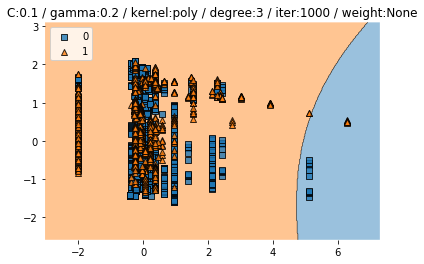

Train CV accuracy scores: [0.70919881 0.83827893 0.79376855 0.36998514 0.36309524]
Train CV accuracy: 0.615 +/- 0.207
Train CV f1 scores: [0.63858839 0.83038198 0.76894753 0.21042033 0.19781659]
Train CV f1: 0.529 +/- 0.273


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4068965517241379
Test f1 :  0.5784313725490197


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


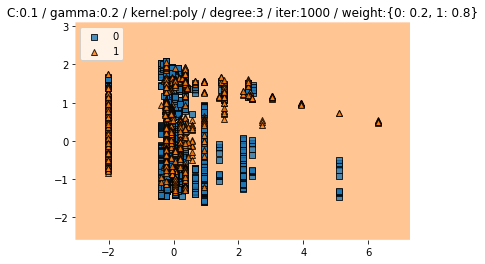

Train CV accuracy scores: [0.34866469 0.35311573 0.36498516 0.36849926 0.35565476]
Train CV accuracy: 0.358 +/- 0.007
Train CV f1 scores: [0.18718192 0.18894789 0.20382958 0.20731148 0.18973459]
Train CV f1: 0.195 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


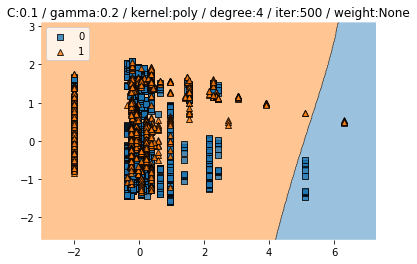

Train CV accuracy scores: [0.35014837 0.35311573 0.36498516 0.36998514 0.36011905]
Train CV accuracy: 0.360 +/- 0.007
Train CV f1 scores: [0.18777187 0.18894789 0.20382958 0.21042033 0.19148562]
Train CV f1: 0.196 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


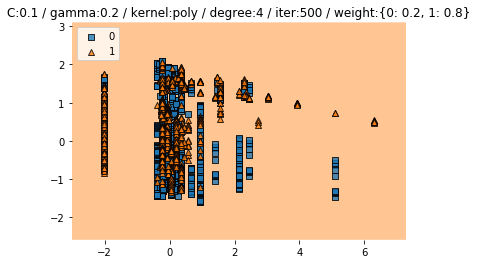

Train CV accuracy scores: [0.35608309 0.35311573 0.35905045 0.36106984 0.35565476]
Train CV accuracy: 0.357 +/- 0.003
Train CV f1 scores: [0.19011876 0.18894789 0.19128452 0.19157199 0.18973459]
Train CV f1: 0.190 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40295566502463054
Test f1 :  0.5744382022471911


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


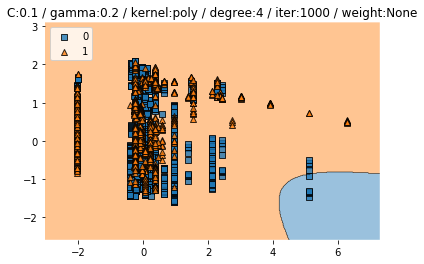

Train CV accuracy scores: [0.70919881 0.83827893 0.79376855 0.36998514 0.36309524]
Train CV accuracy: 0.615 +/- 0.207
Train CV f1 scores: [0.63858839 0.83038198 0.76894753 0.21042033 0.19781659]
Train CV f1: 0.529 +/- 0.273


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4068965517241379
Test f1 :  0.5784313725490197


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


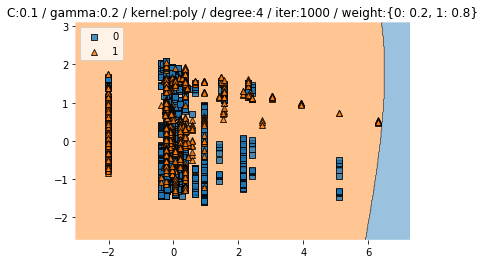

Train CV accuracy scores: [0.34866469 0.35311573 0.36498516 0.36849926 0.35565476]
Train CV accuracy: 0.358 +/- 0.007
Train CV f1 scores: [0.18718192 0.18894789 0.20382958 0.20731148 0.18973459]
Train CV f1: 0.195 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


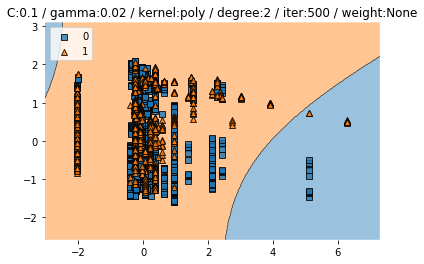

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


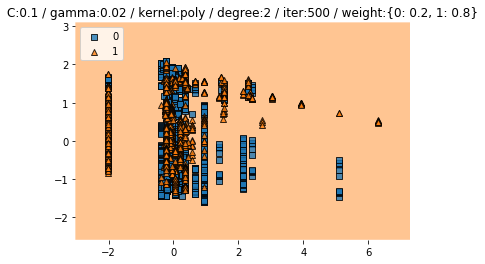

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


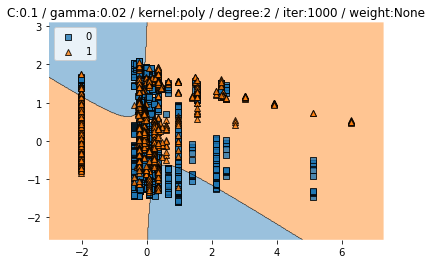

Train CV accuracy scores: [0.64391691 0.64094955 0.64094955 0.63893016 0.63988095]
Train CV accuracy: 0.641 +/- 0.002
Train CV f1 scores: [0.51046407 0.50638461 0.50376731 0.49816858 0.50091042]
Train CV f1: 0.504 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


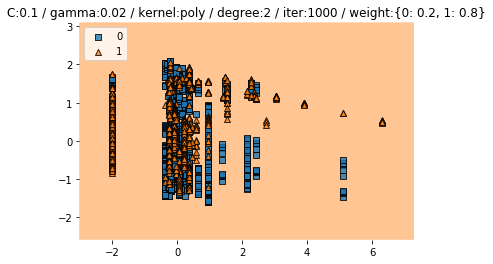

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


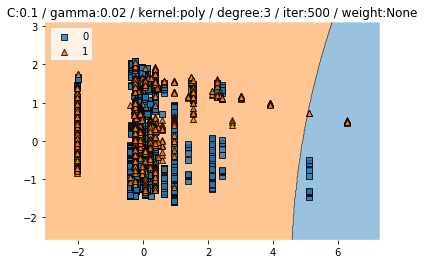

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


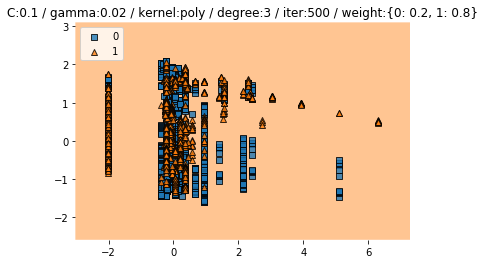

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


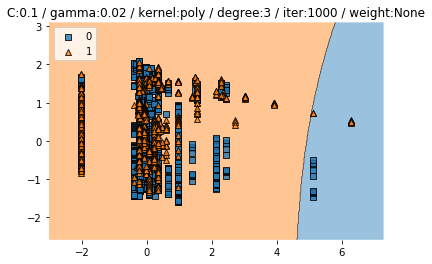

Train CV accuracy scores: [0.64391691 0.64094955 0.64094955 0.63893016 0.63988095]
Train CV accuracy: 0.641 +/- 0.002
Train CV f1 scores: [0.51046407 0.50638461 0.50376731 0.49816858 0.50091042]
Train CV f1: 0.504 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


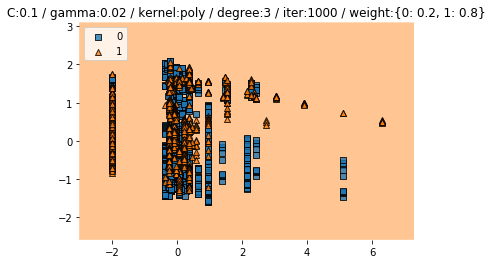

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


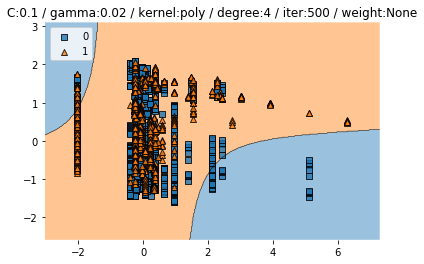

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


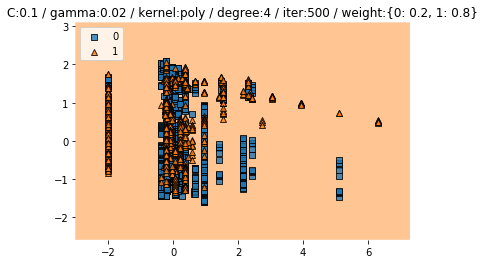

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


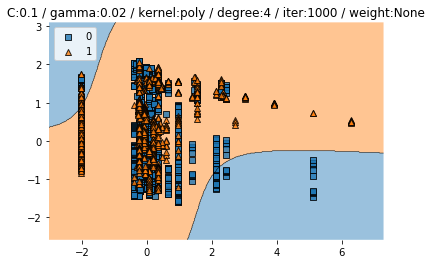

Train CV accuracy scores: [0.64391691 0.64094955 0.64094955 0.63893016 0.63988095]
Train CV accuracy: 0.641 +/- 0.002
Train CV f1 scores: [0.51046407 0.50638461 0.50376731 0.49816858 0.50091042]
Train CV f1: 0.504 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


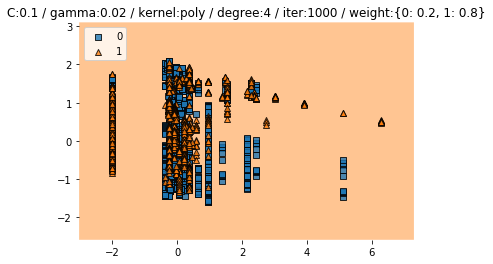

Train CV accuracy scores: [0.3620178  0.3620178  0.3620178  0.36106984 0.36160714]
Train CV accuracy: 0.362 +/- 0.000
Train CV f1 scores: [0.19244519 0.19244519 0.19244519 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


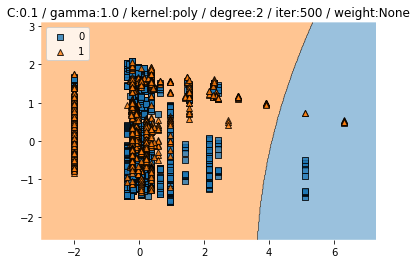

Train CV accuracy scores: [0.35014837 0.4495549  0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.378 +/- 0.036
Train CV f1 scores: [0.18777187 0.3960633  0.20382958 0.21042033 0.19031955]
Train CV f1: 0.238 +/- 0.080


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


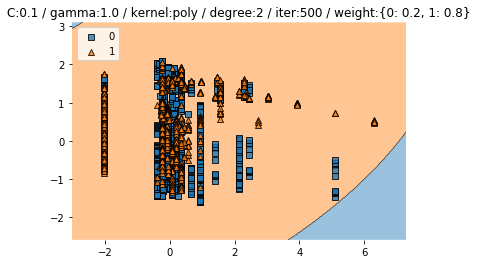

Train CV accuracy scores: [0.5578635  0.39614243 0.3694362  0.39970282 0.35714286]
Train CV accuracy: 0.416 +/- 0.073
Train CV f1 scores: [0.53249836 0.318928   0.21553107 0.27002893 0.19031955]
Train CV f1: 0.305 +/- 0.122


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.569415081042988


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


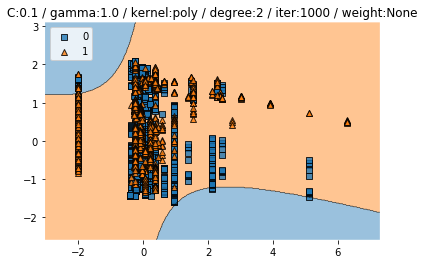

Train CV accuracy scores: [0.50148368 0.51186944 0.36350148 0.56760773 0.35863095]
Train CV accuracy: 0.461 +/- 0.084
Train CV f1 scores: [0.47372973 0.49204258 0.20321891 0.54113288 0.19090322]
Train CV f1: 0.380 +/- 0.151


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3921182266009852
Test f1 :  0.5633404104741684


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


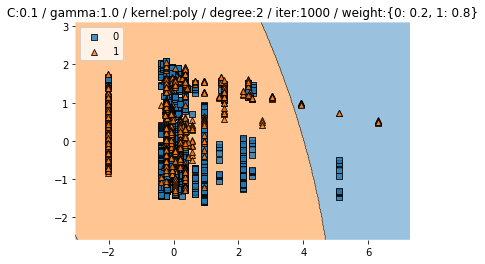

Train CV accuracy scores: [0.40059347 0.40652819 0.36498516 0.36998514 0.38839286]
Train CV accuracy: 0.386 +/- 0.016
Train CV f1 scores: [0.30177023 0.34285443 0.20382958 0.21042033 0.26253397]
Train CV f1: 0.264 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39704433497536945
Test f1 :  0.5684062059238365


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


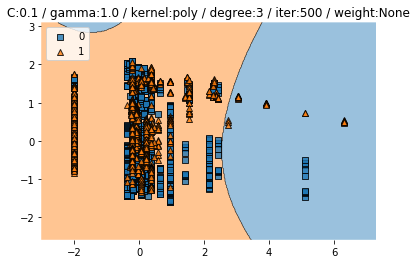

Train CV accuracy scores: [0.35014837 0.4495549  0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.378 +/- 0.036
Train CV f1 scores: [0.18777187 0.3960633  0.20382958 0.21042033 0.19031955]
Train CV f1: 0.238 +/- 0.080


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


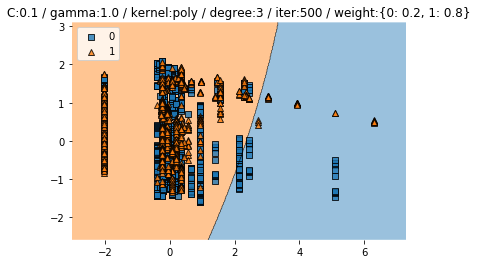

Train CV accuracy scores: [0.5578635  0.39614243 0.3694362  0.39970282 0.35714286]
Train CV accuracy: 0.416 +/- 0.073
Train CV f1 scores: [0.53249836 0.318928   0.21553107 0.27002893 0.19031955]
Train CV f1: 0.305 +/- 0.122


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.569415081042988


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


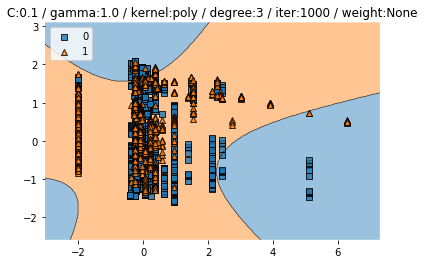

Train CV accuracy scores: [0.50148368 0.51186944 0.36350148 0.56760773 0.35863095]
Train CV accuracy: 0.461 +/- 0.084
Train CV f1 scores: [0.47372973 0.49204258 0.20321891 0.54113288 0.19090322]
Train CV f1: 0.380 +/- 0.151


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3921182266009852
Test f1 :  0.5633404104741684


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


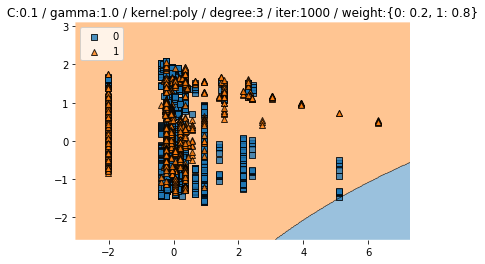

Train CV accuracy scores: [0.40059347 0.40652819 0.36498516 0.36998514 0.38839286]
Train CV accuracy: 0.386 +/- 0.016
Train CV f1 scores: [0.30177023 0.34285443 0.20382958 0.21042033 0.26253397]
Train CV f1: 0.264 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39704433497536945
Test f1 :  0.5684062059238365


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


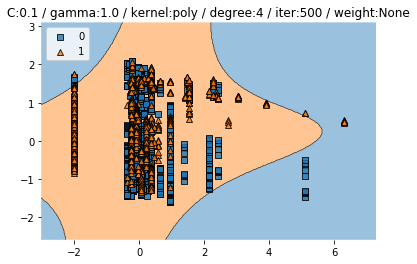

Train CV accuracy scores: [0.35014837 0.4495549  0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.378 +/- 0.036
Train CV f1 scores: [0.18777187 0.3960633  0.20382958 0.21042033 0.19031955]
Train CV f1: 0.238 +/- 0.080


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


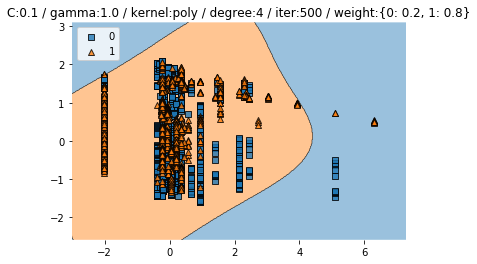

Train CV accuracy scores: [0.5578635  0.39614243 0.3694362  0.39970282 0.35714286]
Train CV accuracy: 0.416 +/- 0.073
Train CV f1 scores: [0.53249836 0.318928   0.21553107 0.27002893 0.19031955]
Train CV f1: 0.305 +/- 0.122


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.569415081042988


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


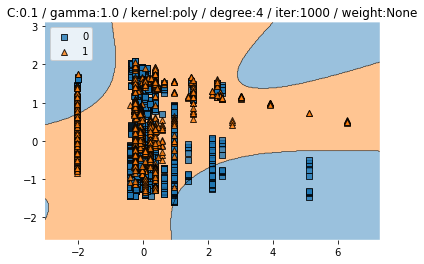

Train CV accuracy scores: [0.50148368 0.51186944 0.36350148 0.56760773 0.35863095]
Train CV accuracy: 0.461 +/- 0.084
Train CV f1 scores: [0.47372973 0.49204258 0.20321891 0.54113288 0.19090322]
Train CV f1: 0.380 +/- 0.151


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3921182266009852
Test f1 :  0.5633404104741684


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


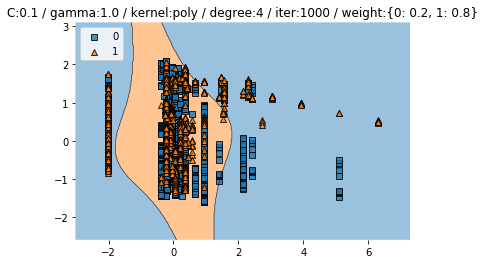

Train CV accuracy scores: [0.40059347 0.40652819 0.36498516 0.36998514 0.38839286]
Train CV accuracy: 0.386 +/- 0.016
Train CV f1 scores: [0.30177023 0.34285443 0.20382958 0.21042033 0.26253397]
Train CV f1: 0.264 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39704433497536945
Test f1 :  0.5684062059238365


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


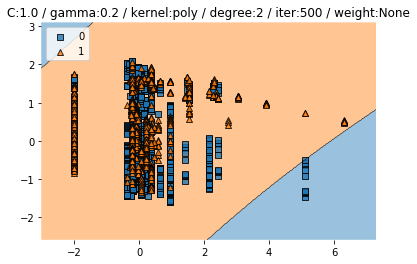

Train CV accuracy scores: [0.34866469 0.40059347 0.38278932 0.36106984 0.35565476]
Train CV accuracy: 0.370 +/- 0.019
Train CV f1 scores: [0.18718192 0.32164577 0.24696148 0.19157199 0.18973459]
Train CV f1: 0.227 +/- 0.052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45123152709359604
Test f1 :  0.591941391941392


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


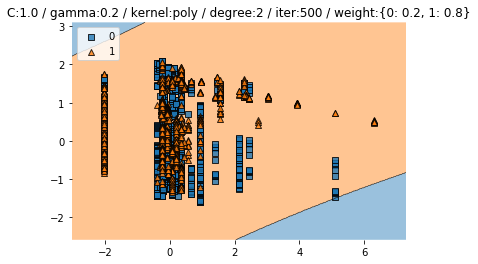

Train CV accuracy scores: [0.35756677 0.37388724 0.36350148 0.37592868 0.35416667]
Train CV accuracy: 0.365 +/- 0.009
Train CV f1 scores: [0.20562967 0.23385783 0.20569714 0.22272875 0.18914835]
Train CV f1: 0.211 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3901477832512315
Test f1 :  0.557541100786276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


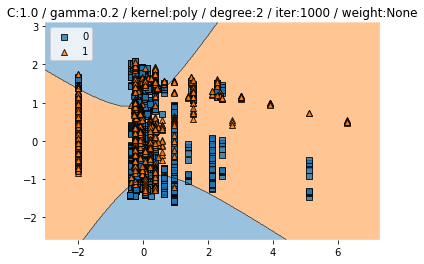

Train CV accuracy scores: [0.73442136 0.82047478 0.36350148 0.36106984 0.36011905]
Train CV accuracy: 0.528 +/- 0.206
Train CV f1 scores: [0.70001012 0.818373   0.19817847 0.19157199 0.19148562]
Train CV f1: 0.420 +/- 0.280


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5763546798029556
Test f1 :  0.6254355400696865


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


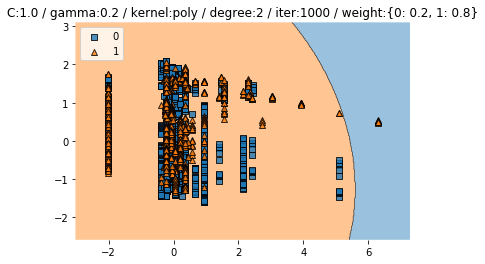

Train CV accuracy scores: [0.42136499 0.40059347 0.37537092 0.39821694 0.36755952]
Train CV accuracy: 0.393 +/- 0.019
Train CV f1 scores: [0.32596631 0.30352959 0.23454539 0.26715929 0.2240177 ]
Train CV f1: 0.271 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3527093596059113
Test f1 :  0.5165562913907285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


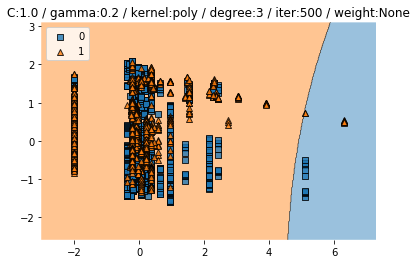

Train CV accuracy scores: [0.34866469 0.40059347 0.38278932 0.36106984 0.35565476]
Train CV accuracy: 0.370 +/- 0.019
Train CV f1 scores: [0.18718192 0.32164577 0.24696148 0.19157199 0.18973459]
Train CV f1: 0.227 +/- 0.052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45123152709359604
Test f1 :  0.591941391941392


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


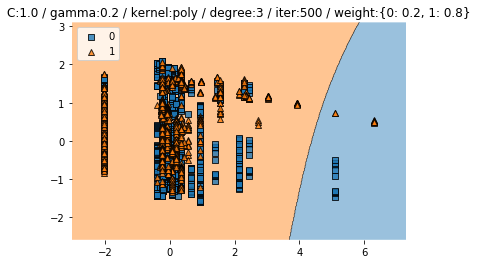

Train CV accuracy scores: [0.35756677 0.37388724 0.36350148 0.37592868 0.35416667]
Train CV accuracy: 0.365 +/- 0.009
Train CV f1 scores: [0.20562967 0.23385783 0.20569714 0.22272875 0.18914835]
Train CV f1: 0.211 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3901477832512315
Test f1 :  0.557541100786276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


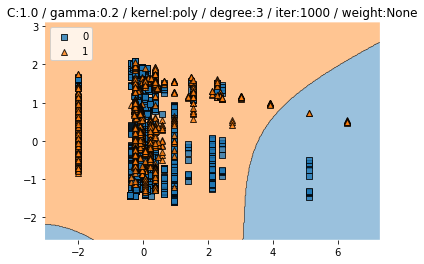

Train CV accuracy scores: [0.73442136 0.82047478 0.36350148 0.36106984 0.36011905]
Train CV accuracy: 0.528 +/- 0.206
Train CV f1 scores: [0.70001012 0.818373   0.19817847 0.19157199 0.19148562]
Train CV f1: 0.420 +/- 0.280


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5763546798029556
Test f1 :  0.6254355400696865


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


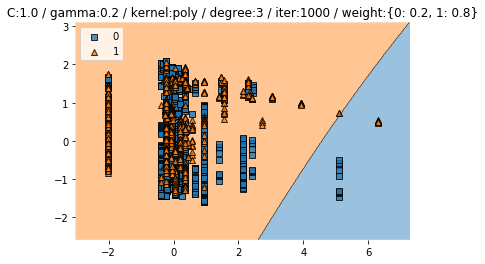

Train CV accuracy scores: [0.42136499 0.40059347 0.37537092 0.39821694 0.36755952]
Train CV accuracy: 0.393 +/- 0.019
Train CV f1 scores: [0.32596631 0.30352959 0.23454539 0.26715929 0.2240177 ]
Train CV f1: 0.271 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3527093596059113
Test f1 :  0.5165562913907285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


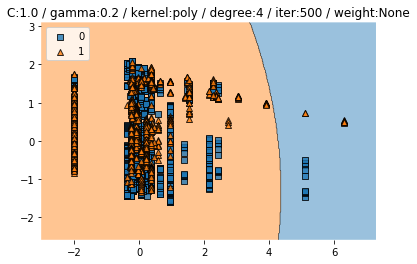

Train CV accuracy scores: [0.34866469 0.40059347 0.38278932 0.36106984 0.35565476]
Train CV accuracy: 0.370 +/- 0.019
Train CV f1 scores: [0.18718192 0.32164577 0.24696148 0.19157199 0.18973459]
Train CV f1: 0.227 +/- 0.052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45123152709359604
Test f1 :  0.591941391941392


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


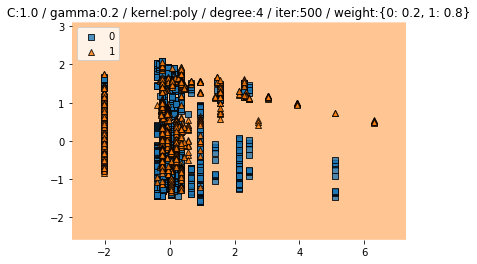

Train CV accuracy scores: [0.35756677 0.37388724 0.36350148 0.37592868 0.35416667]
Train CV accuracy: 0.365 +/- 0.009
Train CV f1 scores: [0.20562967 0.23385783 0.20569714 0.22272875 0.18914835]
Train CV f1: 0.211 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3901477832512315
Test f1 :  0.557541100786276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


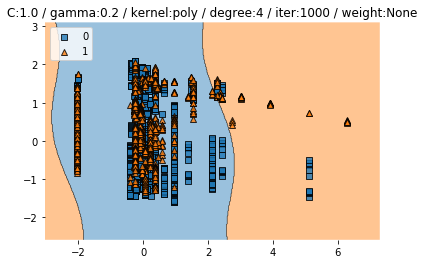

Train CV accuracy scores: [0.73442136 0.82047478 0.36350148 0.36106984 0.36011905]
Train CV accuracy: 0.528 +/- 0.206
Train CV f1 scores: [0.70001012 0.818373   0.19817847 0.19157199 0.19148562]
Train CV f1: 0.420 +/- 0.280


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5763546798029556
Test f1 :  0.6254355400696865


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


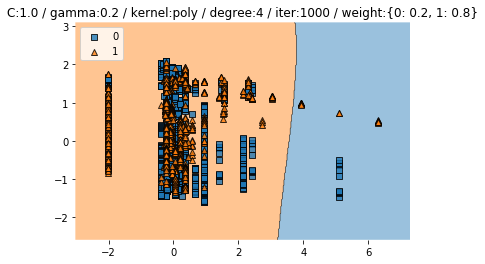

Train CV accuracy scores: [0.42136499 0.40059347 0.37537092 0.39821694 0.36755952]
Train CV accuracy: 0.393 +/- 0.019
Train CV f1 scores: [0.32596631 0.30352959 0.23454539 0.26715929 0.2240177 ]
Train CV f1: 0.271 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3527093596059113
Test f1 :  0.5165562913907285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


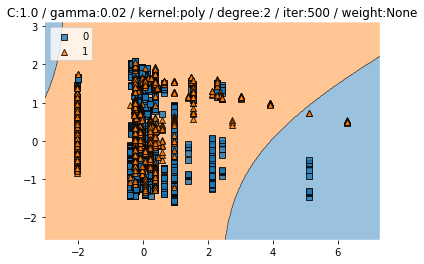

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


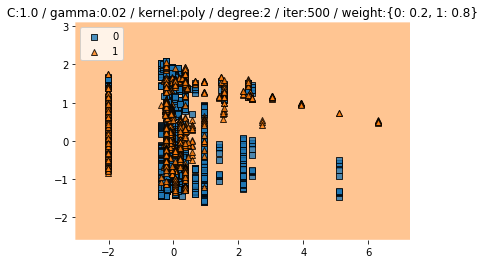

Train CV accuracy scores: [0.3620178  0.3620178  0.36053412 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19186549 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


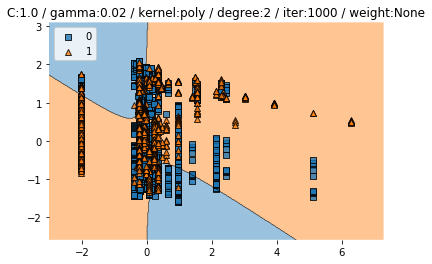

Train CV accuracy scores: [0.66468843 0.66023739 0.64688427 0.64041605 0.65625   ]
Train CV accuracy: 0.654 +/- 0.009
Train CV f1 scores: [0.55495901 0.54796281 0.51707147 0.50158022 0.5370098 ]
Train CV f1: 0.532 +/- 0.020


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


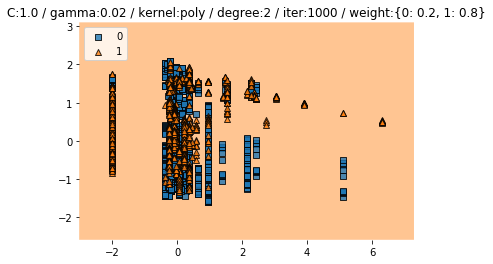

Train CV accuracy scores: [0.3620178  0.3620178  0.36053412 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19186549 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


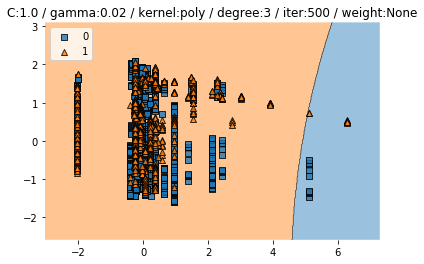

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


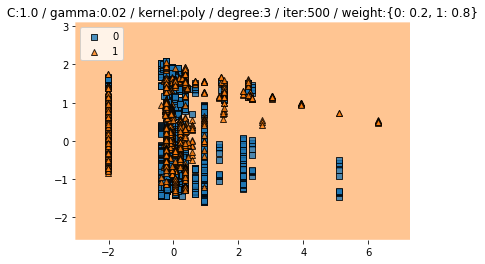

Train CV accuracy scores: [0.3620178  0.3620178  0.36053412 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19186549 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


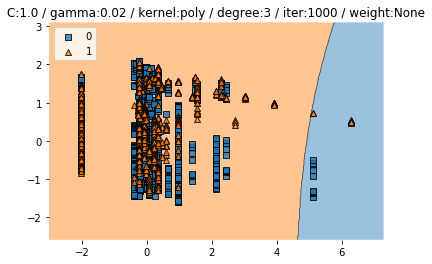

Train CV accuracy scores: [0.66468843 0.66023739 0.64688427 0.64041605 0.65625   ]
Train CV accuracy: 0.654 +/- 0.009
Train CV f1 scores: [0.55495901 0.54796281 0.51707147 0.50158022 0.5370098 ]
Train CV f1: 0.532 +/- 0.020


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


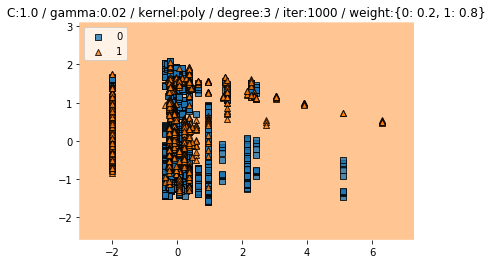

Train CV accuracy scores: [0.3620178  0.3620178  0.36053412 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19186549 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


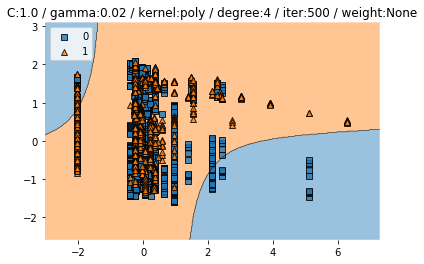

Train CV accuracy scores: [0.35459941 0.35311573 0.3620178  0.36998514 0.35863095]
Train CV accuracy: 0.360 +/- 0.006
Train CV f1 scores: [0.18953397 0.18894789 0.19244519 0.21042033 0.19090322]
Train CV f1: 0.194 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


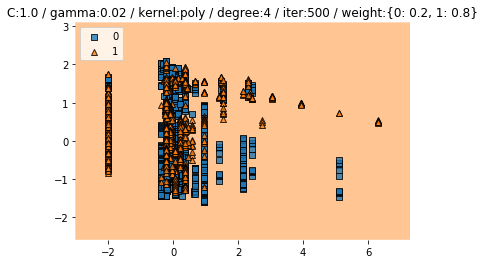

Train CV accuracy scores: [0.3620178  0.3620178  0.36053412 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19186549 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


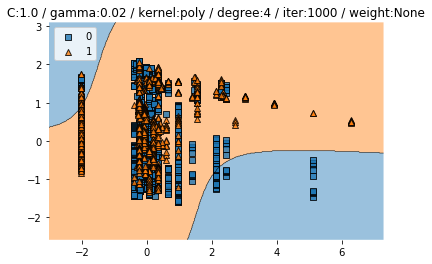

Train CV accuracy scores: [0.66468843 0.66023739 0.64688427 0.64041605 0.65625   ]
Train CV accuracy: 0.654 +/- 0.009
Train CV f1 scores: [0.55495901 0.54796281 0.51707147 0.50158022 0.5370098 ]
Train CV f1: 0.532 +/- 0.020


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5734364019676739


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


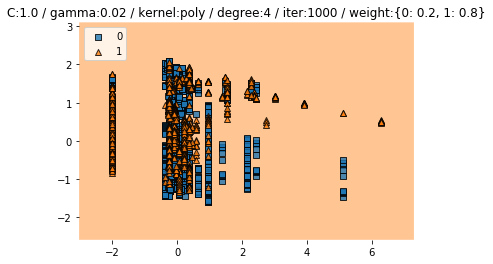

Train CV accuracy scores: [0.3620178  0.3620178  0.36053412 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19186549 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


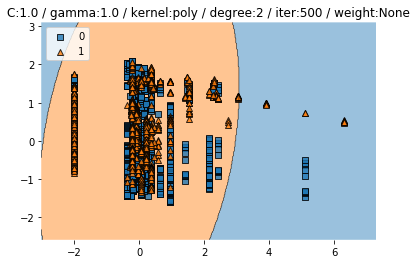

Train CV accuracy scores: [0.48367953 0.43916914 0.35905045 0.36998514 0.35714286]
Train CV accuracy: 0.402 +/- 0.051
Train CV f1 scores: [0.44057809 0.37769688 0.19128452 0.21042033 0.19031955]
Train CV f1: 0.282 +/- 0.106


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4
Test f1 :  0.5714285714285714


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


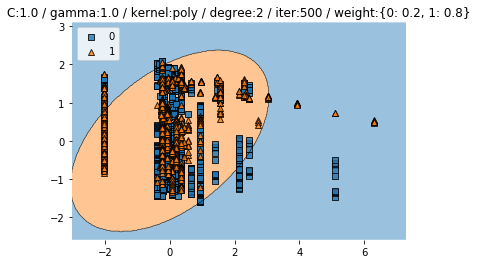

Train CV accuracy scores: [0.37388724 0.40207715 0.3620178  0.38930163 0.37946429]
Train CV accuracy: 0.381 +/- 0.014
Train CV f1 scores: [0.23831814 0.3413234  0.20260709 0.24970408 0.24087634]
Train CV f1: 0.255 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39408866995073893
Test f1 :  0.5653710247349824


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


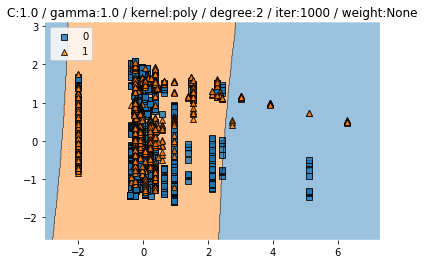

Train CV accuracy scores: [0.74332344 0.33531157 0.36646884 0.64041605 0.35714286]
Train CV accuracy: 0.489 +/- 0.169
Train CV f1 scores: [0.74707259 0.19371836 0.20693351 0.50158022 0.22375285]
Train CV f1: 0.375 +/- 0.218


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4266009852216749
Test f1 :  0.576419213973799


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


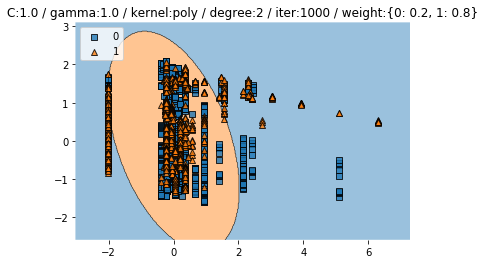

Train CV accuracy scores: [0.37388724 0.40949555 0.36498516 0.448737   0.38244048]
Train CV accuracy: 0.396 +/- 0.030
Train CV f1 scores: [0.24694774 0.30132821 0.20382958 0.35894019 0.24673354]
Train CV f1: 0.272 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5673556664290805


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


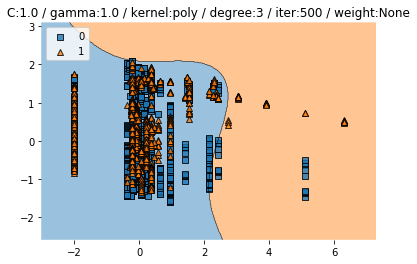

Train CV accuracy scores: [0.48367953 0.43916914 0.35905045 0.36998514 0.35714286]
Train CV accuracy: 0.402 +/- 0.051
Train CV f1 scores: [0.44057809 0.37769688 0.19128452 0.21042033 0.19031955]
Train CV f1: 0.282 +/- 0.106


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4
Test f1 :  0.5714285714285714


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


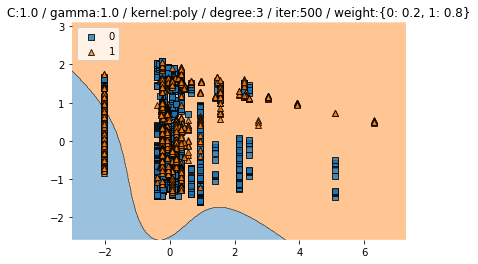

Train CV accuracy scores: [0.37388724 0.40207715 0.3620178  0.38930163 0.37946429]
Train CV accuracy: 0.381 +/- 0.014
Train CV f1 scores: [0.23831814 0.3413234  0.20260709 0.24970408 0.24087634]
Train CV f1: 0.255 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39408866995073893
Test f1 :  0.5653710247349824


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


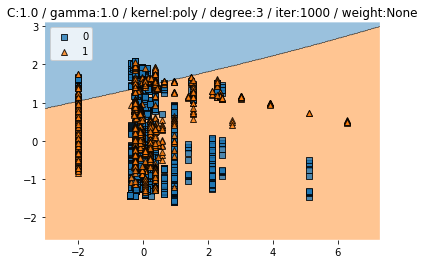

Train CV accuracy scores: [0.74332344 0.33531157 0.36646884 0.64041605 0.35714286]
Train CV accuracy: 0.489 +/- 0.169
Train CV f1 scores: [0.74707259 0.19371836 0.20693351 0.50158022 0.22375285]
Train CV f1: 0.375 +/- 0.218


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4266009852216749
Test f1 :  0.576419213973799


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


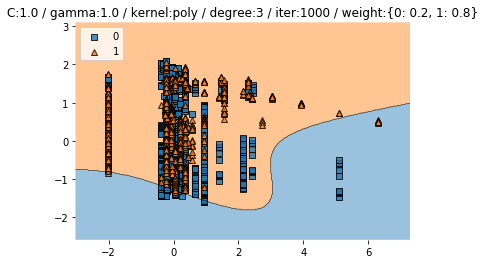

Train CV accuracy scores: [0.37388724 0.40949555 0.36498516 0.448737   0.38244048]
Train CV accuracy: 0.396 +/- 0.030
Train CV f1 scores: [0.24694774 0.30132821 0.20382958 0.35894019 0.24673354]
Train CV f1: 0.272 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5673556664290805


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


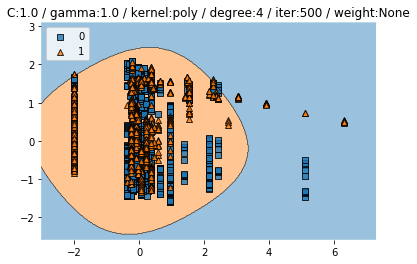

Train CV accuracy scores: [0.48367953 0.43916914 0.35905045 0.36998514 0.35714286]
Train CV accuracy: 0.402 +/- 0.051
Train CV f1 scores: [0.44057809 0.37769688 0.19128452 0.21042033 0.19031955]
Train CV f1: 0.282 +/- 0.106


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4
Test f1 :  0.5714285714285714


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


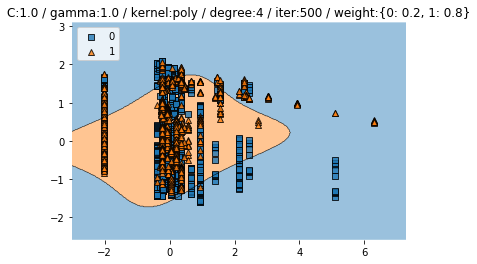

Train CV accuracy scores: [0.37388724 0.40207715 0.3620178  0.38930163 0.37946429]
Train CV accuracy: 0.381 +/- 0.014
Train CV f1 scores: [0.23831814 0.3413234  0.20260709 0.24970408 0.24087634]
Train CV f1: 0.255 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39408866995073893
Test f1 :  0.5653710247349824


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


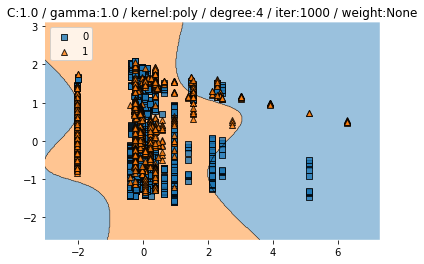

Train CV accuracy scores: [0.74332344 0.33531157 0.36646884 0.64041605 0.35714286]
Train CV accuracy: 0.489 +/- 0.169
Train CV f1 scores: [0.74707259 0.19371836 0.20693351 0.50158022 0.22375285]
Train CV f1: 0.375 +/- 0.218


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4266009852216749
Test f1 :  0.576419213973799


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


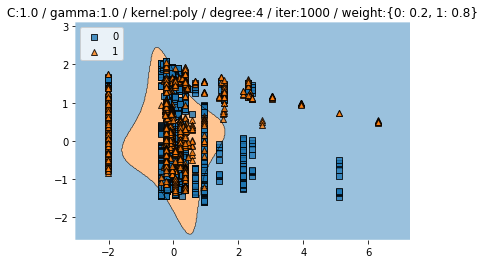

Train CV accuracy scores: [0.37388724 0.40949555 0.36498516 0.448737   0.38244048]
Train CV accuracy: 0.396 +/- 0.030
Train CV f1 scores: [0.24694774 0.30132821 0.20382958 0.35894019 0.24673354]
Train CV f1: 0.272 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4019704433497537
Test f1 :  0.5673556664290805


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


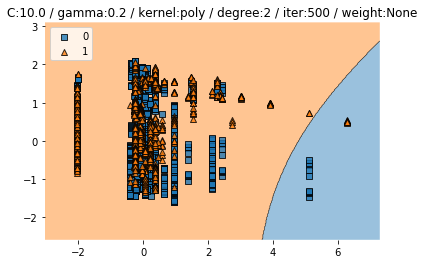

Train CV accuracy scores: [0.40504451 0.54599407 0.36498516 0.36998514 0.36011905]
Train CV accuracy: 0.409 +/- 0.070
Train CV f1 scores: [0.28740463 0.53174496 0.20382958 0.21042033 0.19148562]
Train CV f1: 0.285 +/- 0.128


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


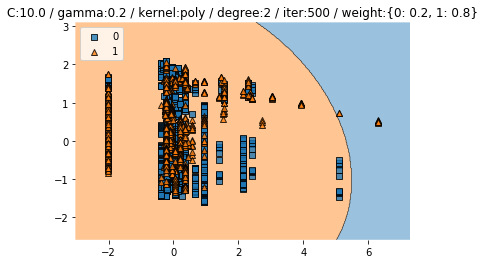

Train CV accuracy scores: [0.35014837 0.39614243 0.36498516 0.40118871 0.5014881 ]
Train CV accuracy: 0.403 +/- 0.053
Train CV f1 scores: [0.18777187 0.30609496 0.20382958 0.27288748 0.44938955]
Train CV f1: 0.284 +/- 0.093


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


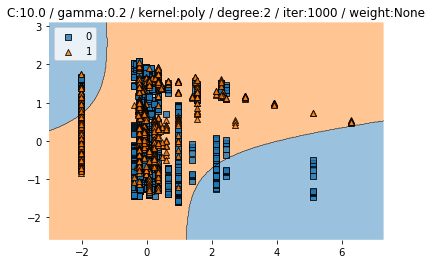

Train CV accuracy scores: [0.45400593 0.49554896 0.3620178  0.42793462 0.38690476]
Train CV accuracy: 0.425 +/- 0.047
Train CV f1 scores: [0.40034755 0.47315291 0.1975831  0.32252996 0.25108175]
Train CV f1: 0.329 +/- 0.099


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6088669950738916
Test f1 :  0.6683375104427737


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


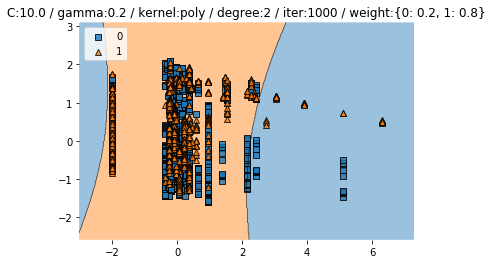

Train CV accuracy scores: [0.38278932 0.37833828 0.36053412 0.36106984 0.35416667]
Train CV accuracy: 0.367 +/- 0.011
Train CV f1 scores: [0.2677726  0.29884725 0.19444037 0.19157199 0.18914835]
Train CV f1: 0.228 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5730416372618208


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


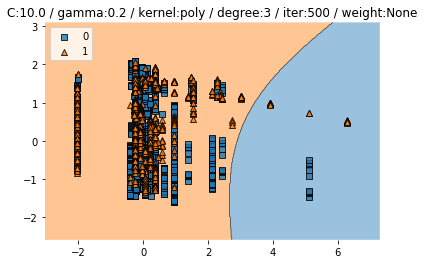

Train CV accuracy scores: [0.40504451 0.54599407 0.36498516 0.36998514 0.36011905]
Train CV accuracy: 0.409 +/- 0.070
Train CV f1 scores: [0.28740463 0.53174496 0.20382958 0.21042033 0.19148562]
Train CV f1: 0.285 +/- 0.128


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


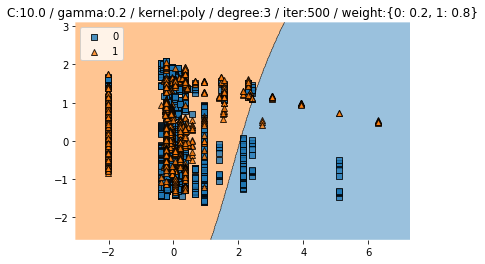

Train CV accuracy scores: [0.35014837 0.39614243 0.36498516 0.40118871 0.5014881 ]
Train CV accuracy: 0.403 +/- 0.053
Train CV f1 scores: [0.18777187 0.30609496 0.20382958 0.27288748 0.44938955]
Train CV f1: 0.284 +/- 0.093


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


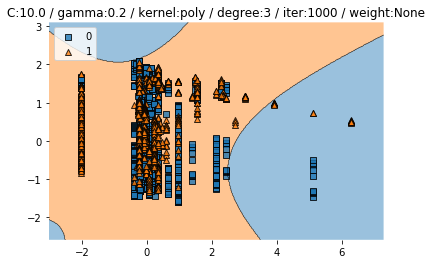

Train CV accuracy scores: [0.45400593 0.49554896 0.3620178  0.42793462 0.38690476]
Train CV accuracy: 0.425 +/- 0.047
Train CV f1 scores: [0.40034755 0.47315291 0.1975831  0.32252996 0.25108175]
Train CV f1: 0.329 +/- 0.099


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6088669950738916
Test f1 :  0.6683375104427737


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


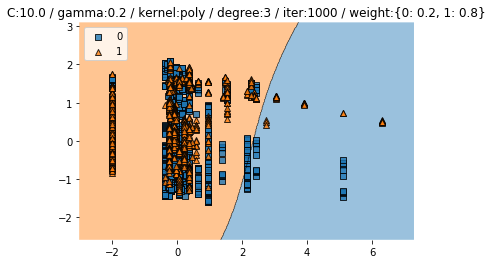

Train CV accuracy scores: [0.38278932 0.37833828 0.36053412 0.36106984 0.35416667]
Train CV accuracy: 0.367 +/- 0.011
Train CV f1 scores: [0.2677726  0.29884725 0.19444037 0.19157199 0.18914835]
Train CV f1: 0.228 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5730416372618208


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


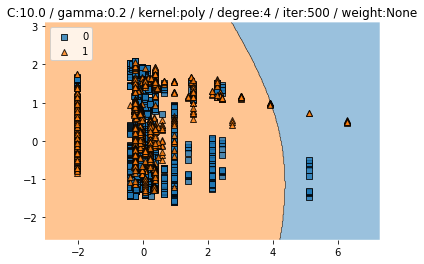

Train CV accuracy scores: [0.40504451 0.54599407 0.36498516 0.36998514 0.36011905]
Train CV accuracy: 0.409 +/- 0.070
Train CV f1 scores: [0.28740463 0.53174496 0.20382958 0.21042033 0.19148562]
Train CV f1: 0.285 +/- 0.128


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


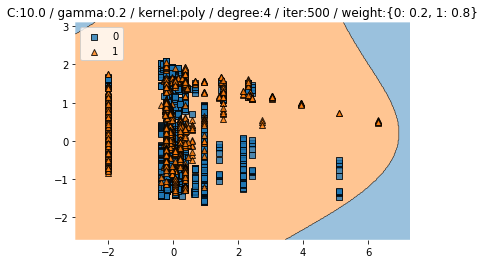

Train CV accuracy scores: [0.35014837 0.39614243 0.36498516 0.40118871 0.5014881 ]
Train CV accuracy: 0.403 +/- 0.053
Train CV f1 scores: [0.18777187 0.30609496 0.20382958 0.27288748 0.44938955]
Train CV f1: 0.284 +/- 0.093


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


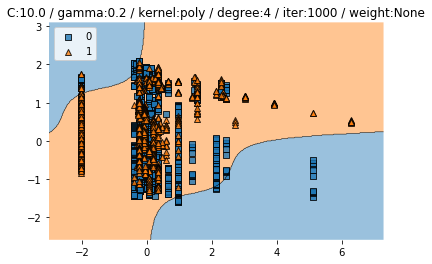

Train CV accuracy scores: [0.45400593 0.49554896 0.3620178  0.42793462 0.38690476]
Train CV accuracy: 0.425 +/- 0.047
Train CV f1 scores: [0.40034755 0.47315291 0.1975831  0.32252996 0.25108175]
Train CV f1: 0.329 +/- 0.099


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6088669950738916
Test f1 :  0.6683375104427737


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


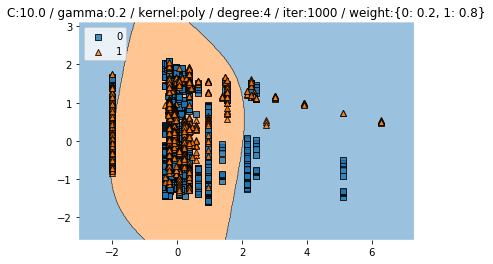

Train CV accuracy scores: [0.38278932 0.37833828 0.36053412 0.36106984 0.35416667]
Train CV accuracy: 0.367 +/- 0.011
Train CV f1 scores: [0.2677726  0.29884725 0.19444037 0.19157199 0.18914835]
Train CV f1: 0.228 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5730416372618208


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


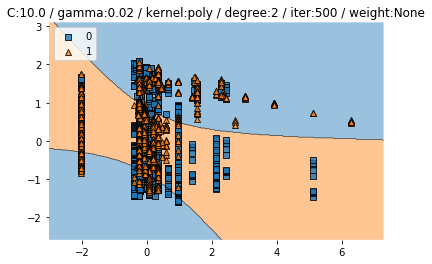

Train CV accuracy scores: [0.35014837 0.35311573 0.35905045 0.36106984 0.35714286]
Train CV accuracy: 0.356 +/- 0.004
Train CV f1 scores: [0.18777187 0.18894789 0.19128452 0.19157199 0.19031955]
Train CV f1: 0.190 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


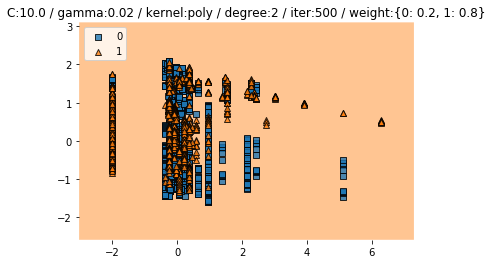

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


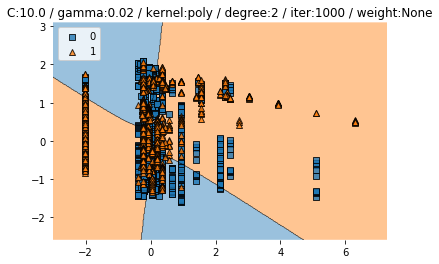

Train CV accuracy scores: [0.72403561 0.73442136 0.75222552 0.63447251 0.68154762]
Train CV accuracy: 0.705 +/- 0.042
Train CV f1 scores: [0.66483877 0.68151184 0.70983091 0.49869373 0.6003001 ]
Train CV f1: 0.631 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


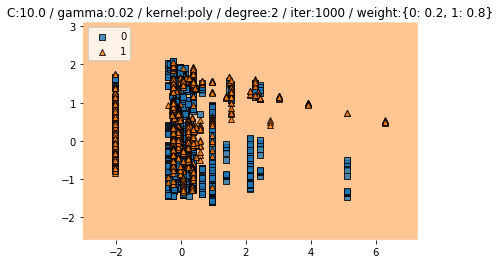

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


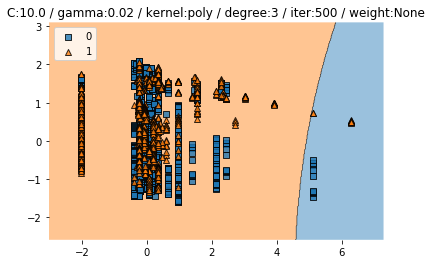

Train CV accuracy scores: [0.35014837 0.35311573 0.35905045 0.36106984 0.35714286]
Train CV accuracy: 0.356 +/- 0.004
Train CV f1 scores: [0.18777187 0.18894789 0.19128452 0.19157199 0.19031955]
Train CV f1: 0.190 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


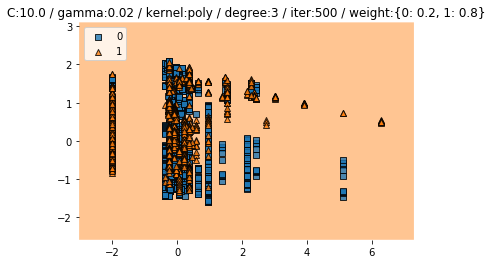

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


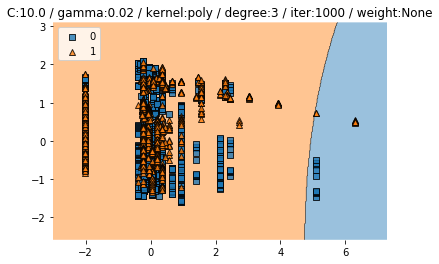

Train CV accuracy scores: [0.72403561 0.73442136 0.75222552 0.63447251 0.68154762]
Train CV accuracy: 0.705 +/- 0.042
Train CV f1 scores: [0.66483877 0.68151184 0.70983091 0.49869373 0.6003001 ]
Train CV f1: 0.631 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


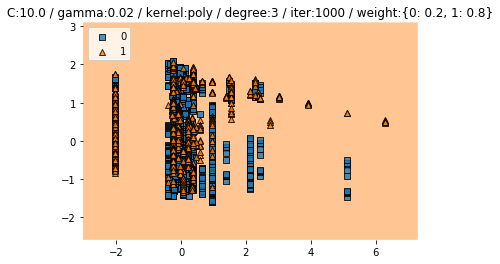

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


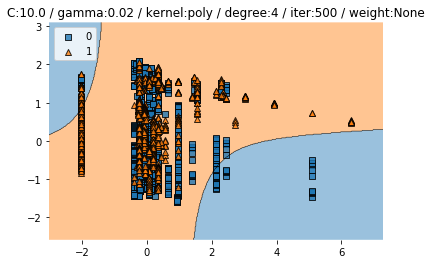

Train CV accuracy scores: [0.35014837 0.35311573 0.35905045 0.36106984 0.35714286]
Train CV accuracy: 0.356 +/- 0.004
Train CV f1 scores: [0.18777187 0.18894789 0.19128452 0.19157199 0.19031955]
Train CV f1: 0.190 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


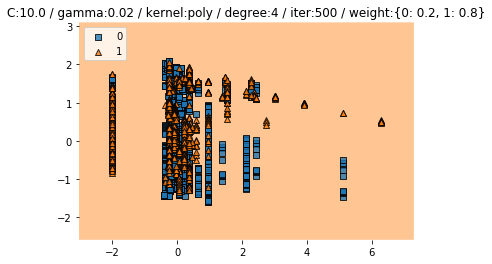

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


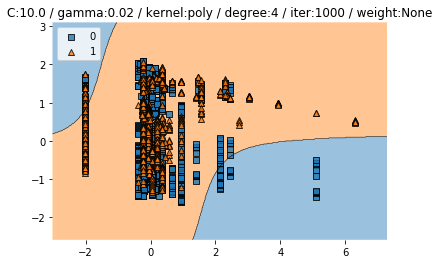

Train CV accuracy scores: [0.72403561 0.73442136 0.75222552 0.63447251 0.68154762]
Train CV accuracy: 0.705 +/- 0.042
Train CV f1 scores: [0.66483877 0.68151184 0.70983091 0.49869373 0.6003001 ]
Train CV f1: 0.631 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


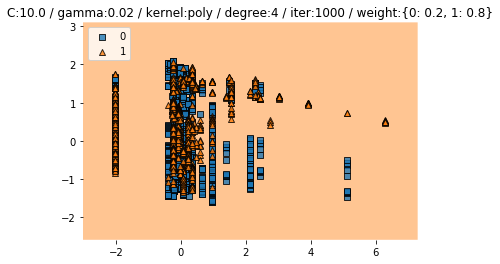

Train CV accuracy scores: [0.3620178  0.3620178  0.35905045 0.36106984 0.36160714]
Train CV accuracy: 0.361 +/- 0.001
Train CV f1 scores: [0.19244519 0.19244519 0.19128452 0.19157199 0.19206674]
Train CV f1: 0.192 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4088669950738916
Test f1 :  0.5804195804195804


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


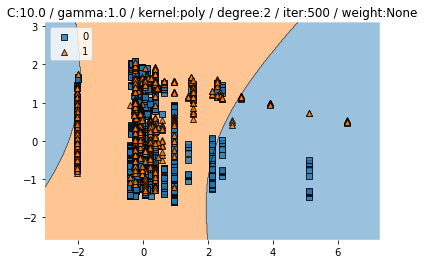

Train CV accuracy scores: [0.52077151 0.37240356 0.36053412 0.36998514 0.36309524]
Train CV accuracy: 0.397 +/- 0.062
Train CV f1 scores: [0.48861858 0.28226303 0.19444037 0.21042033 0.20287159]
Train CV f1: 0.276 +/- 0.111


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3960591133004926
Test f1 :  0.5661712668082095


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


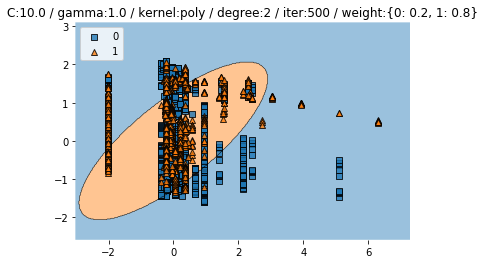

Train CV accuracy scores: [0.40059347 0.3620178  0.36498516 0.36106984 0.36011905]
Train CV accuracy: 0.370 +/- 0.016
Train CV f1 scores: [0.30699037 0.22161884 0.20382958 0.19157199 0.19148562]
Train CV f1: 0.223 +/- 0.043


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39408866995073893
Test f1 :  0.5653710247349824


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


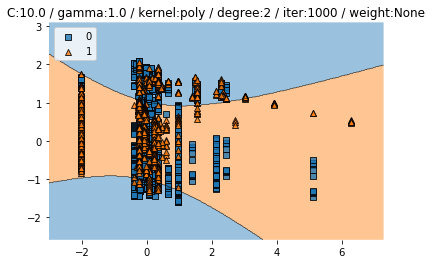

Train CV accuracy scores: [0.42284866 0.3768546  0.36350148 0.36998514 0.36011905]
Train CV accuracy: 0.379 +/- 0.023
Train CV f1 scores: [0.35478099 0.25260516 0.20321891 0.21042033 0.20164359]
Train CV f1: 0.245 +/- 0.058


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6334975369458128
Test f1 :  0.5168831168831168


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


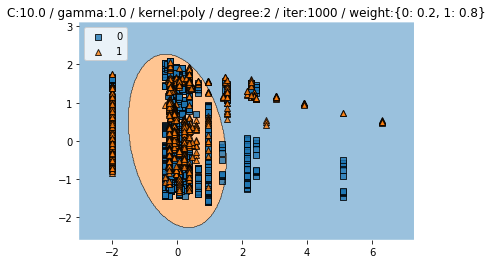

Train CV accuracy scores: [0.64243323 0.3189911  0.35905045 0.36998514 0.35565476]
Train CV accuracy: 0.409 +/- 0.118
Train CV f1 scores: [0.64925873 0.21167018 0.19128452 0.21042033 0.18973459]
Train CV f1: 0.290 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39901477832512317
Test f1 :  0.5427286356821589


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


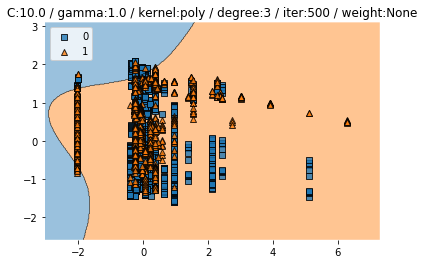

Train CV accuracy scores: [0.52077151 0.37240356 0.36053412 0.36998514 0.36309524]
Train CV accuracy: 0.397 +/- 0.062
Train CV f1 scores: [0.48861858 0.28226303 0.19444037 0.21042033 0.20287159]
Train CV f1: 0.276 +/- 0.111


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3960591133004926
Test f1 :  0.5661712668082095


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


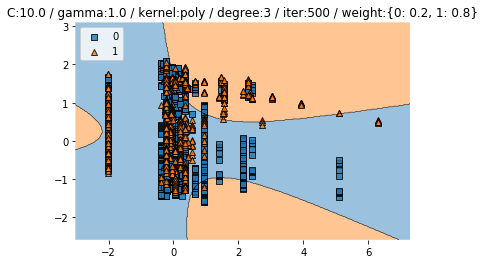

Train CV accuracy scores: [0.40059347 0.3620178  0.36498516 0.36106984 0.36011905]
Train CV accuracy: 0.370 +/- 0.016
Train CV f1 scores: [0.30699037 0.22161884 0.20382958 0.19157199 0.19148562]
Train CV f1: 0.223 +/- 0.043


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39408866995073893
Test f1 :  0.5653710247349824


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


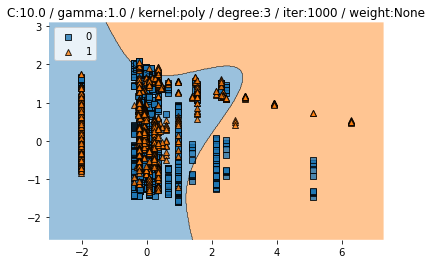

Train CV accuracy scores: [0.42284866 0.3768546  0.36350148 0.36998514 0.36011905]
Train CV accuracy: 0.379 +/- 0.023
Train CV f1 scores: [0.35478099 0.25260516 0.20321891 0.21042033 0.20164359]
Train CV f1: 0.245 +/- 0.058


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6334975369458128
Test f1 :  0.5168831168831168


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


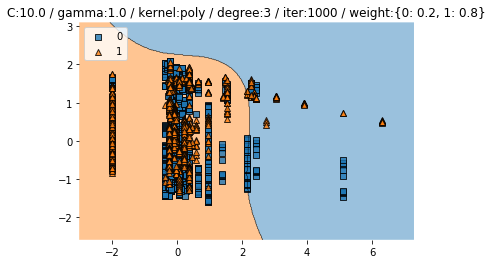

Train CV accuracy scores: [0.64243323 0.3189911  0.35905045 0.36998514 0.35565476]
Train CV accuracy: 0.409 +/- 0.118
Train CV f1 scores: [0.64925873 0.21167018 0.19128452 0.21042033 0.18973459]
Train CV f1: 0.290 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39901477832512317
Test f1 :  0.5427286356821589


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


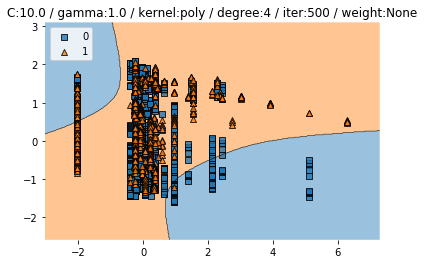

Train CV accuracy scores: [0.52077151 0.37240356 0.36053412 0.36998514 0.36309524]
Train CV accuracy: 0.397 +/- 0.062
Train CV f1 scores: [0.48861858 0.28226303 0.19444037 0.21042033 0.20287159]
Train CV f1: 0.276 +/- 0.111


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3960591133004926
Test f1 :  0.5661712668082095


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


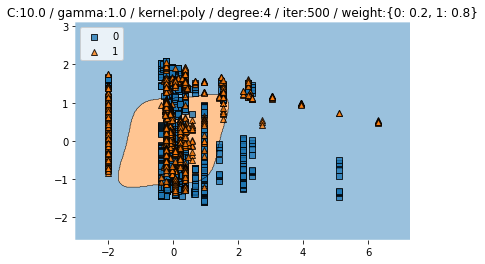

Train CV accuracy scores: [0.40059347 0.3620178  0.36498516 0.36106984 0.36011905]
Train CV accuracy: 0.370 +/- 0.016
Train CV f1 scores: [0.30699037 0.22161884 0.20382958 0.19157199 0.19148562]
Train CV f1: 0.223 +/- 0.043


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39408866995073893
Test f1 :  0.5653710247349824


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


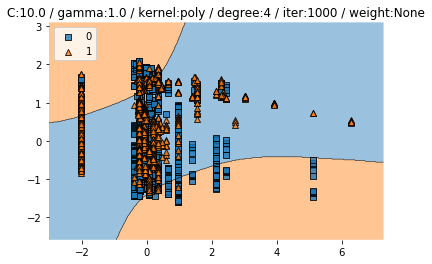

Train CV accuracy scores: [0.42284866 0.3768546  0.36350148 0.36998514 0.36011905]
Train CV accuracy: 0.379 +/- 0.023
Train CV f1 scores: [0.35478099 0.25260516 0.20321891 0.21042033 0.20164359]
Train CV f1: 0.245 +/- 0.058


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6334975369458128
Test f1 :  0.5168831168831168


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


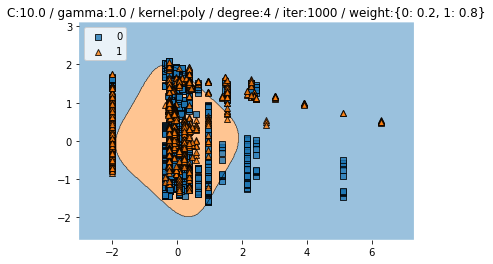

Train CV accuracy scores: [0.64243323 0.3189911  0.35905045 0.36998514 0.35565476]
Train CV accuracy: 0.409 +/- 0.118
Train CV f1 scores: [0.64925873 0.21167018 0.19128452 0.21042033 0.18973459]
Train CV f1: 0.290 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39901477832512317
Test f1 :  0.5427286356821589


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


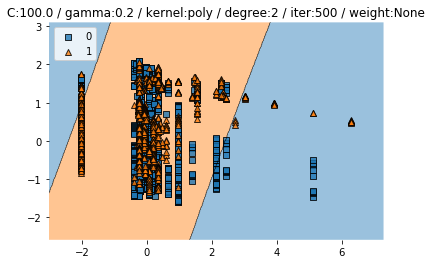

Train CV accuracy scores: [0.34124629 0.3768546  0.35905045 0.36106984 0.35863095]
Train CV accuracy: 0.359 +/- 0.011
Train CV f1 scores: [0.1842126  0.27411757 0.19128452 0.19157199 0.19090322]
Train CV f1: 0.206 +/- 0.034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


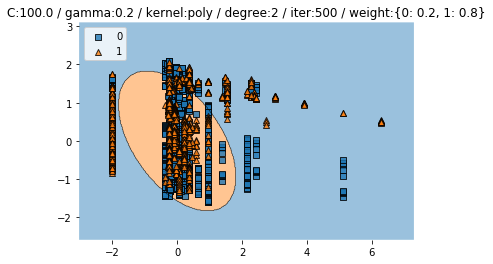

Train CV accuracy scores: [0.40801187 0.70919881 0.36498516 0.36998514 0.35565476]
Train CV accuracy: 0.442 +/- 0.135
Train CV f1 scores: [0.32772874 0.71379122 0.20382958 0.21042033 0.18973459]
Train CV f1: 0.329 +/- 0.199


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40788177339901477
Test f1 :  0.5740609496810772


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


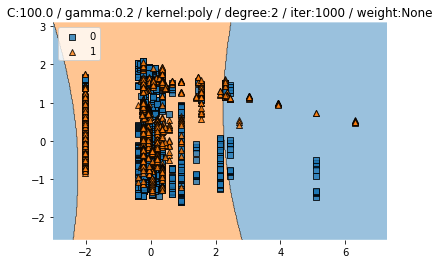

Train CV accuracy scores: [0.3620178  0.3768546  0.84569733 0.64041605 0.43154762]
Train CV accuracy: 0.531 +/- 0.186
Train CV f1 scores: [0.25109096 0.29316199 0.84432429 0.50423658 0.34860206]
Train CV f1: 0.448 +/- 0.216


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.5601151907847371


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


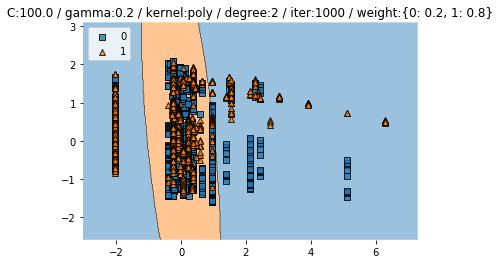

Train CV accuracy scores: [0.35756677 0.37240356 0.36498516 0.37444279 0.36160714]
Train CV accuracy: 0.366 +/- 0.006
Train CV f1 scores: [0.19070227 0.27529173 0.20382958 0.21967051 0.22132214]
Train CV f1: 0.222 +/- 0.029


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39507389162561574
Test f1 :  0.5663841807909604


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


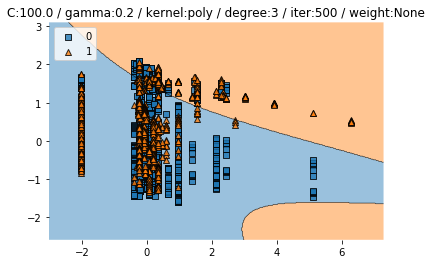

Train CV accuracy scores: [0.34124629 0.3768546  0.35905045 0.36106984 0.35863095]
Train CV accuracy: 0.359 +/- 0.011
Train CV f1 scores: [0.1842126  0.27411757 0.19128452 0.19157199 0.19090322]
Train CV f1: 0.206 +/- 0.034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


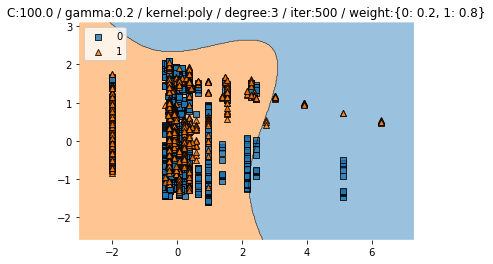

Train CV accuracy scores: [0.40801187 0.70919881 0.36498516 0.36998514 0.35565476]
Train CV accuracy: 0.442 +/- 0.135
Train CV f1 scores: [0.32772874 0.71379122 0.20382958 0.21042033 0.18973459]
Train CV f1: 0.329 +/- 0.199


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40788177339901477
Test f1 :  0.5740609496810772


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


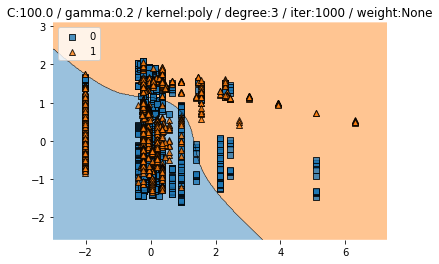

Train CV accuracy scores: [0.3620178  0.3768546  0.84569733 0.64041605 0.43154762]
Train CV accuracy: 0.531 +/- 0.186
Train CV f1 scores: [0.25109096 0.29316199 0.84432429 0.50423658 0.34860206]
Train CV f1: 0.448 +/- 0.216


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.5601151907847371


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


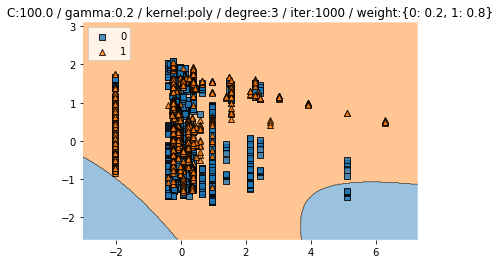

Train CV accuracy scores: [0.35756677 0.37240356 0.36498516 0.37444279 0.36160714]
Train CV accuracy: 0.366 +/- 0.006
Train CV f1 scores: [0.19070227 0.27529173 0.20382958 0.21967051 0.22132214]
Train CV f1: 0.222 +/- 0.029


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39507389162561574
Test f1 :  0.5663841807909604


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


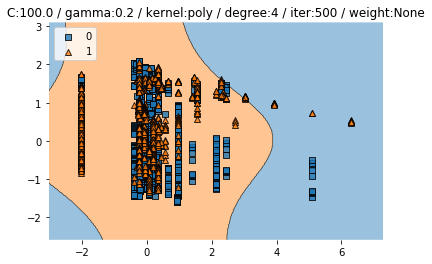

Train CV accuracy scores: [0.34124629 0.3768546  0.35905045 0.36106984 0.35863095]
Train CV accuracy: 0.359 +/- 0.011
Train CV f1 scores: [0.1842126  0.27411757 0.19128452 0.19157199 0.19090322]
Train CV f1: 0.206 +/- 0.034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


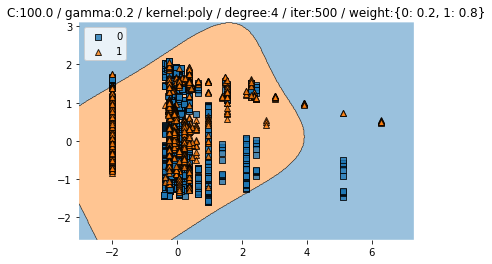

Train CV accuracy scores: [0.40801187 0.70919881 0.36498516 0.36998514 0.35565476]
Train CV accuracy: 0.442 +/- 0.135
Train CV f1 scores: [0.32772874 0.71379122 0.20382958 0.21042033 0.18973459]
Train CV f1: 0.329 +/- 0.199


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40788177339901477
Test f1 :  0.5740609496810772


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


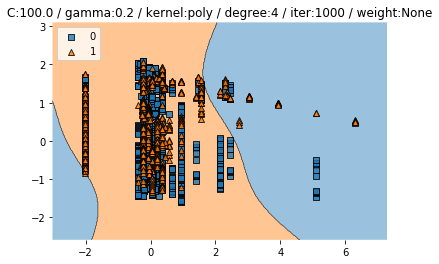

Train CV accuracy scores: [0.3620178  0.3768546  0.84569733 0.64041605 0.43154762]
Train CV accuracy: 0.531 +/- 0.186
Train CV f1 scores: [0.25109096 0.29316199 0.84432429 0.50423658 0.34860206]
Train CV f1: 0.448 +/- 0.216


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3980295566502463
Test f1 :  0.5601151907847371


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


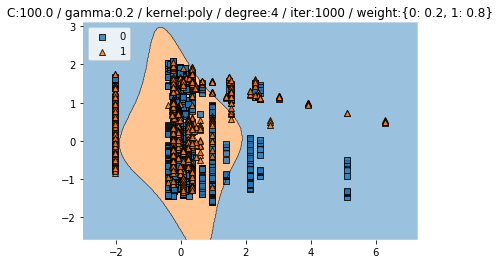

Train CV accuracy scores: [0.35756677 0.37240356 0.36498516 0.37444279 0.36160714]
Train CV accuracy: 0.366 +/- 0.006
Train CV f1 scores: [0.19070227 0.27529173 0.20382958 0.21967051 0.22132214]
Train CV f1: 0.222 +/- 0.029


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39507389162561574
Test f1 :  0.5663841807909604


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


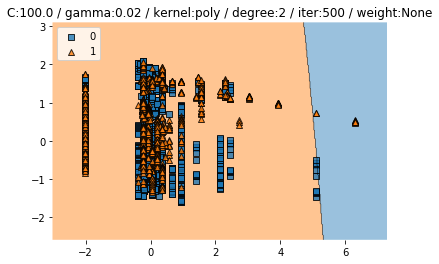

Train CV accuracy scores: [0.64391691 0.35311573 0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.418 +/- 0.113
Train CV f1 scores: [0.51046407 0.18894789 0.20382958 0.21042033 0.19031955]
Train CV f1: 0.261 +/- 0.125


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


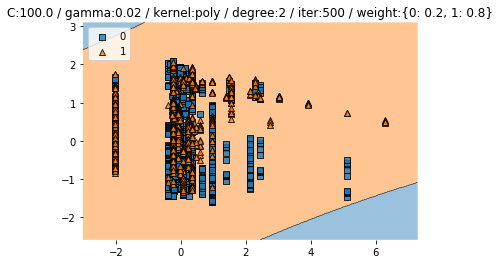

Train CV accuracy scores: [0.35756677 0.35311573 0.35905045 0.36106984 0.35714286]
Train CV accuracy: 0.358 +/- 0.003
Train CV f1 scores: [0.19070227 0.18894789 0.19128452 0.19157199 0.19031955]
Train CV f1: 0.191 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


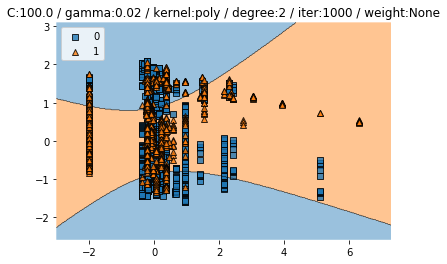

Train CV accuracy scores: [0.37388724 0.79970326 0.36646884 0.36998514 0.69642857]
Train CV accuracy: 0.521 +/- 0.188
Train CV f1 scores: [0.22697894 0.77848592 0.20443909 0.21042033 0.64347856]
Train CV f1: 0.413 +/- 0.247


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4068965517241379
Test f1 :  0.5784313725490197


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


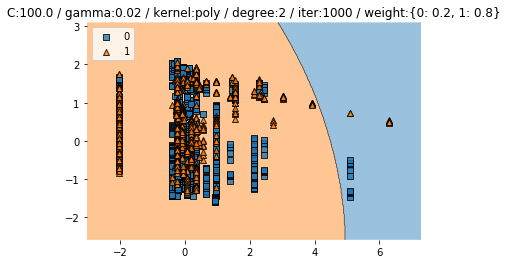

Train CV accuracy scores: [0.35014837 0.35311573 0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.359 +/- 0.007
Train CV f1 scores: [0.18777187 0.18894789 0.20382958 0.21042033 0.19031955]
Train CV f1: 0.196 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


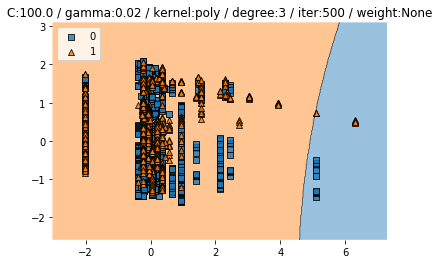

Train CV accuracy scores: [0.64391691 0.35311573 0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.418 +/- 0.113
Train CV f1 scores: [0.51046407 0.18894789 0.20382958 0.21042033 0.19031955]
Train CV f1: 0.261 +/- 0.125


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


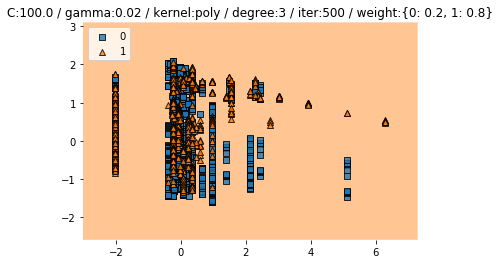

Train CV accuracy scores: [0.35756677 0.35311573 0.35905045 0.36106984 0.35714286]
Train CV accuracy: 0.358 +/- 0.003
Train CV f1 scores: [0.19070227 0.18894789 0.19128452 0.19157199 0.19031955]
Train CV f1: 0.191 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


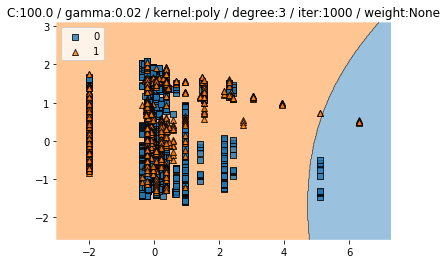

Train CV accuracy scores: [0.37388724 0.79970326 0.36646884 0.36998514 0.69642857]
Train CV accuracy: 0.521 +/- 0.188
Train CV f1 scores: [0.22697894 0.77848592 0.20443909 0.21042033 0.64347856]
Train CV f1: 0.413 +/- 0.247


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4068965517241379
Test f1 :  0.5784313725490197


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


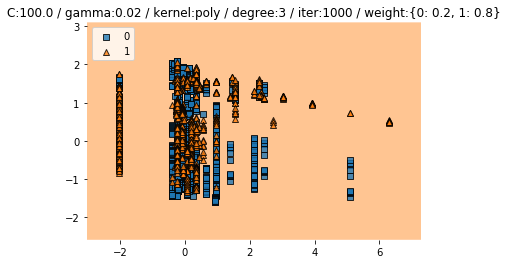

Train CV accuracy scores: [0.35014837 0.35311573 0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.359 +/- 0.007
Train CV f1 scores: [0.18777187 0.18894789 0.20382958 0.21042033 0.19031955]
Train CV f1: 0.196 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


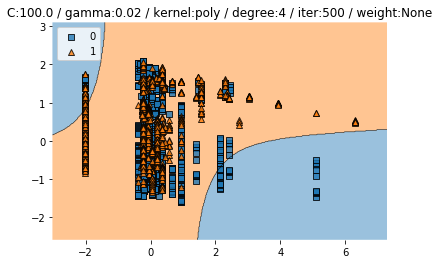

Train CV accuracy scores: [0.64391691 0.35311573 0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.418 +/- 0.113
Train CV f1 scores: [0.51046407 0.18894789 0.20382958 0.21042033 0.19031955]
Train CV f1: 0.261 +/- 0.125


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


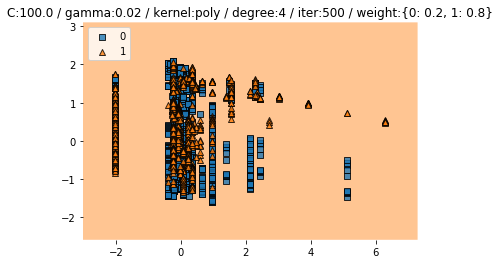

Train CV accuracy scores: [0.35756677 0.35311573 0.35905045 0.36106984 0.35714286]
Train CV accuracy: 0.358 +/- 0.003
Train CV f1 scores: [0.19070227 0.18894789 0.19128452 0.19157199 0.19031955]
Train CV f1: 0.191 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4039408866995074
Test f1 :  0.5754385964912281


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


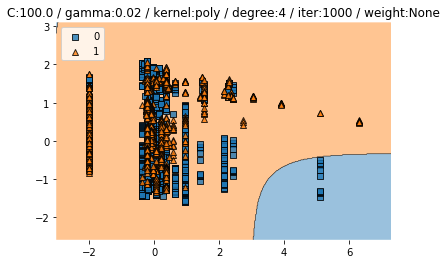

Train CV accuracy scores: [0.37388724 0.79970326 0.36646884 0.36998514 0.69642857]
Train CV accuracy: 0.521 +/- 0.188
Train CV f1 scores: [0.22697894 0.77848592 0.20443909 0.21042033 0.64347856]
Train CV f1: 0.413 +/- 0.247


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4068965517241379
Test f1 :  0.5784313725490197


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


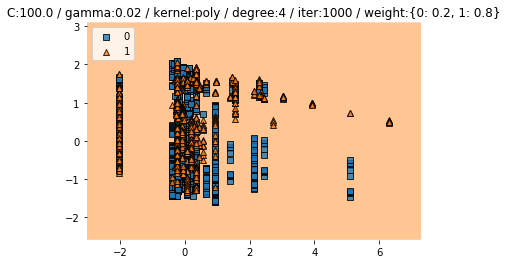

Train CV accuracy scores: [0.35014837 0.35311573 0.36498516 0.36998514 0.35714286]
Train CV accuracy: 0.359 +/- 0.007
Train CV f1 scores: [0.18777187 0.18894789 0.20382958 0.21042033 0.19031955]
Train CV f1: 0.196 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40492610837438425
Test f1 :  0.5764375876577841


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


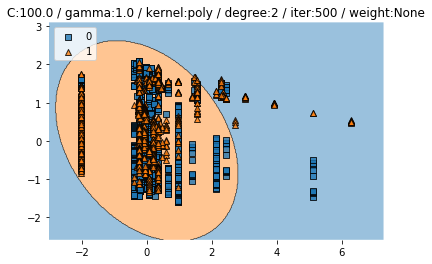

Train CV accuracy scores: [0.40949555 0.55489614 0.35905045 0.36998514 0.36011905]
Train CV accuracy: 0.411 +/- 0.074
Train CV f1 scores: [0.30682373 0.55297529 0.19128452 0.21042033 0.21371771]
Train CV f1: 0.295 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


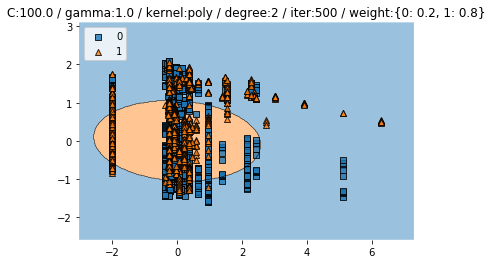

Train CV accuracy scores: [0.44807122 0.68397626 0.83531157 0.62852897 0.36011905]
Train CV accuracy: 0.591 +/- 0.169
Train CV f1 scores: [0.40742948 0.68997959 0.8298018  0.49834108 0.19148562]
Train CV f1: 0.523 +/- 0.222


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39704433497536945
Test f1 :  0.56657223796034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


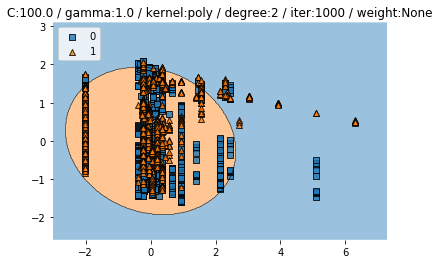

Train CV accuracy scores: [0.44510386 0.3694362  0.47626113 0.36552749 0.375     ]
Train CV accuracy: 0.406 +/- 0.046
Train CV f1 scores: [0.38809859 0.30953109 0.46422298 0.201055   0.23428412]
Train CV f1: 0.319 +/- 0.097


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4098522167487685
Test f1 :  0.5681326604181687


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


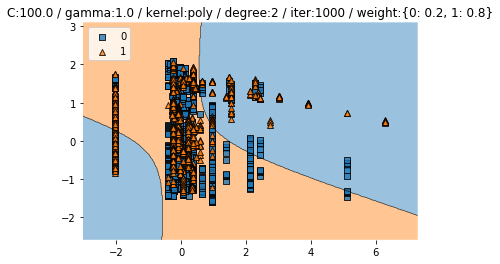

Train CV accuracy scores: [0.34272997 0.4347181  0.36350148 0.36998514 0.36309524]
Train CV accuracy: 0.375 +/- 0.031
Train CV f1 scores: [0.18480909 0.36243628 0.20569714 0.21042033 0.20535687]
Train CV f1: 0.234 +/- 0.065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4059113300492611
Test f1 :  0.5652487382840663


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


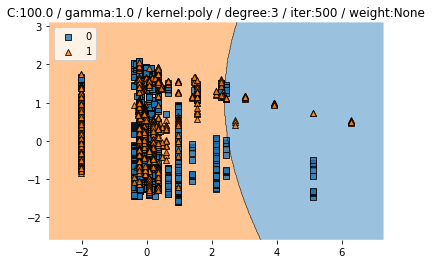

Train CV accuracy scores: [0.40949555 0.55489614 0.35905045 0.36998514 0.36011905]
Train CV accuracy: 0.411 +/- 0.074
Train CV f1 scores: [0.30682373 0.55297529 0.19128452 0.21042033 0.21371771]
Train CV f1: 0.295 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


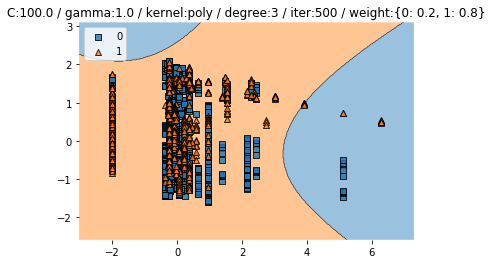

Train CV accuracy scores: [0.44807122 0.68397626 0.83531157 0.62852897 0.36011905]
Train CV accuracy: 0.591 +/- 0.169
Train CV f1 scores: [0.40742948 0.68997959 0.8298018  0.49834108 0.19148562]
Train CV f1: 0.523 +/- 0.222


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39704433497536945
Test f1 :  0.56657223796034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


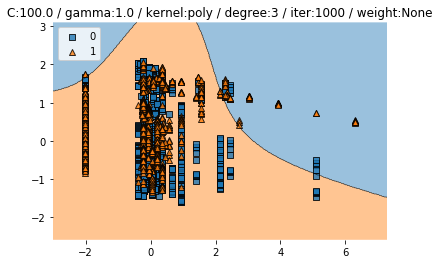

Train CV accuracy scores: [0.44510386 0.3694362  0.47626113 0.36552749 0.375     ]
Train CV accuracy: 0.406 +/- 0.046
Train CV f1 scores: [0.38809859 0.30953109 0.46422298 0.201055   0.23428412]
Train CV f1: 0.319 +/- 0.097


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4098522167487685
Test f1 :  0.5681326604181687


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


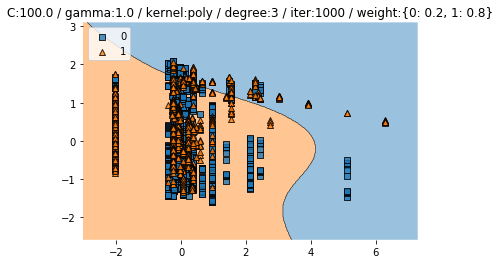

Train CV accuracy scores: [0.34272997 0.4347181  0.36350148 0.36998514 0.36309524]
Train CV accuracy: 0.375 +/- 0.031
Train CV f1 scores: [0.18480909 0.36243628 0.20569714 0.21042033 0.20535687]
Train CV f1: 0.234 +/- 0.065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4059113300492611
Test f1 :  0.5652487382840663


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


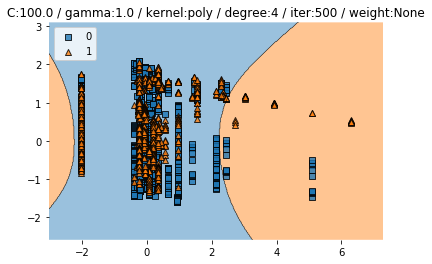

Train CV accuracy scores: [0.40949555 0.55489614 0.35905045 0.36998514 0.36011905]
Train CV accuracy: 0.411 +/- 0.074
Train CV f1 scores: [0.30682373 0.55297529 0.19128452 0.21042033 0.21371771]
Train CV f1: 0.295 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4009852216748768
Test f1 :  0.5724331926863572


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


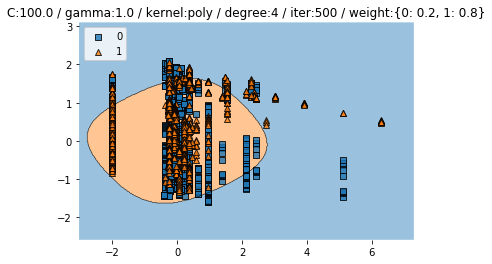

Train CV accuracy scores: [0.44807122 0.68397626 0.83531157 0.62852897 0.36011905]
Train CV accuracy: 0.591 +/- 0.169
Train CV f1 scores: [0.40742948 0.68997959 0.8298018  0.49834108 0.19148562]
Train CV f1: 0.523 +/- 0.222


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39704433497536945
Test f1 :  0.56657223796034


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


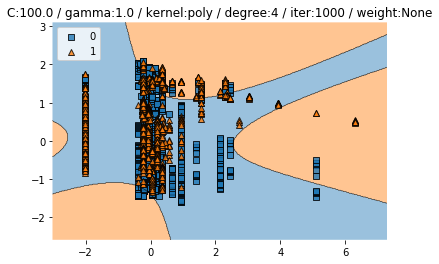

Train CV accuracy scores: [0.44510386 0.3694362  0.47626113 0.36552749 0.375     ]
Train CV accuracy: 0.406 +/- 0.046
Train CV f1 scores: [0.38809859 0.30953109 0.46422298 0.201055   0.23428412]
Train CV f1: 0.319 +/- 0.097


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4098522167487685
Test f1 :  0.5681326604181687


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


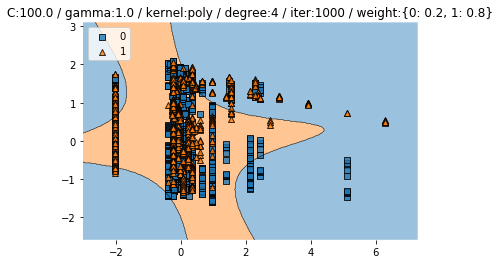

Train CV accuracy scores: [0.34272997 0.4347181  0.36350148 0.36998514 0.36309524]
Train CV accuracy: 0.375 +/- 0.031
Train CV f1 scores: [0.18480909 0.36243628 0.20569714 0.21042033 0.20535687]
Train CV f1: 0.234 +/- 0.065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4059113300492611
Test f1 :  0.5652487382840663
977.9660634994507 secs


In [16]:
# shop poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
degree_range = [2, 3, 4]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "degree":degree, "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for degree in degree_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(5,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


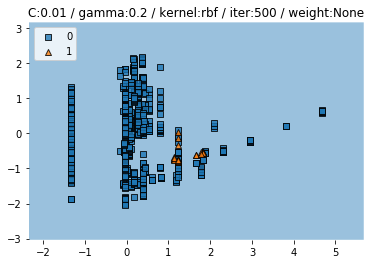

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


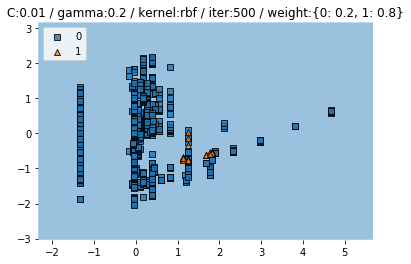

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


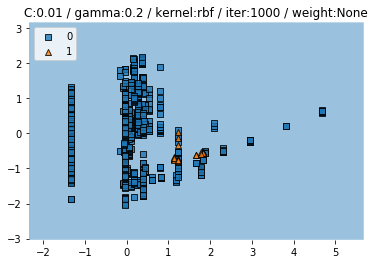

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


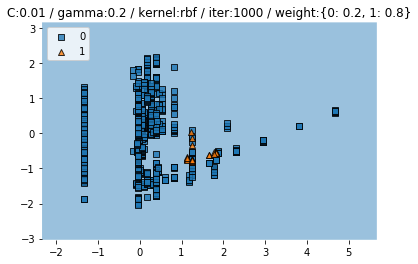

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


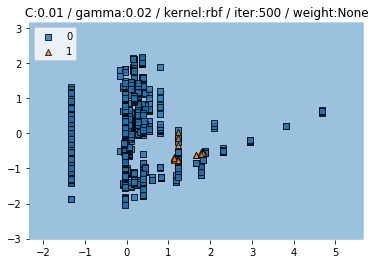

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


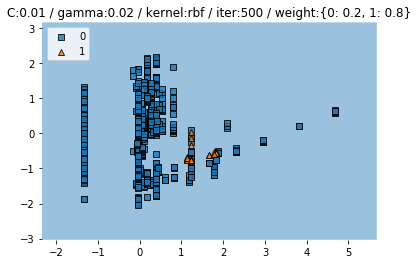

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


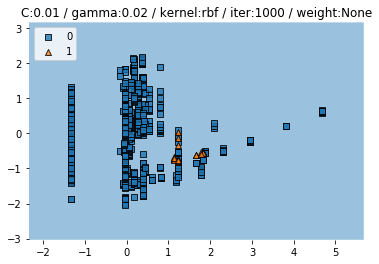

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


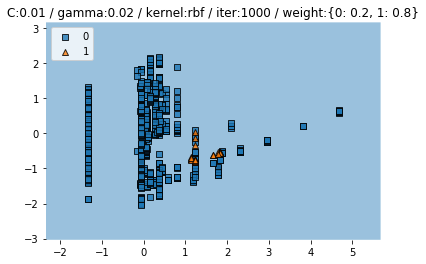

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


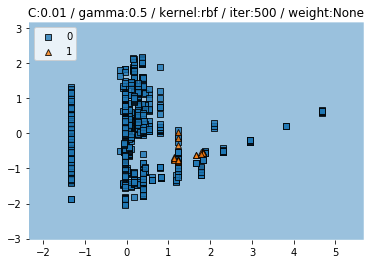

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


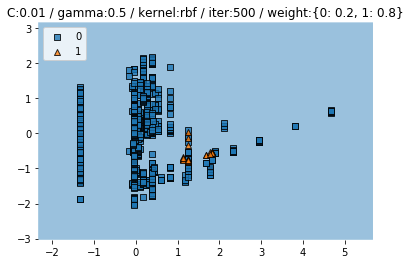

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


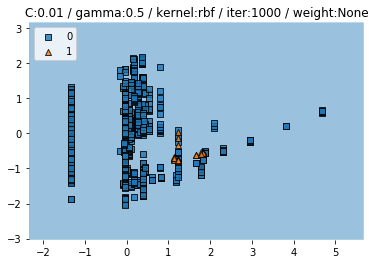

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


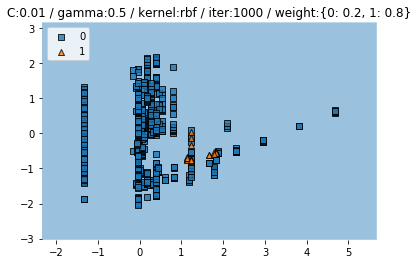

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


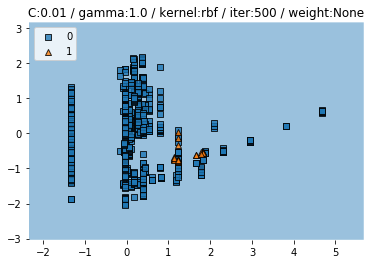

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


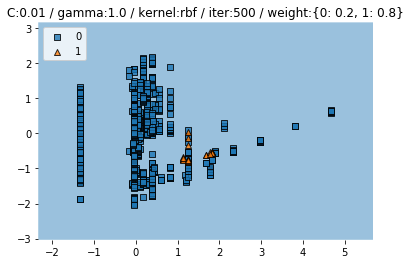

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


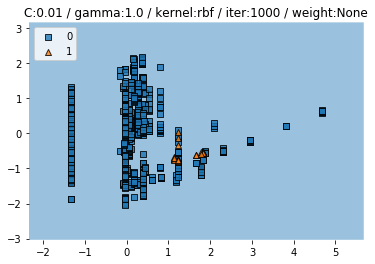

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


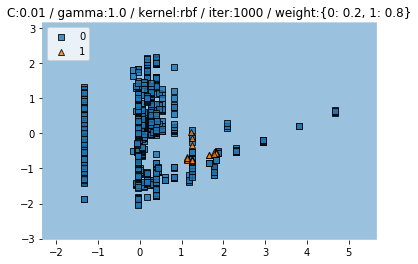

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


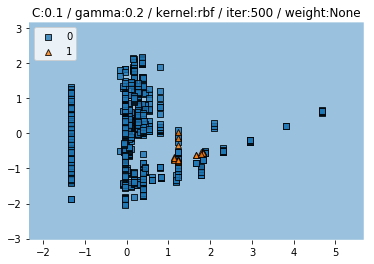

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


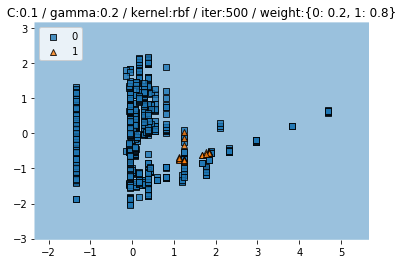

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


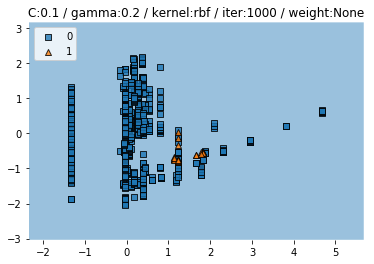

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


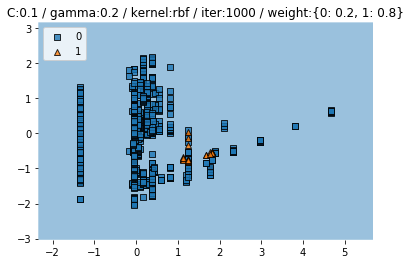

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


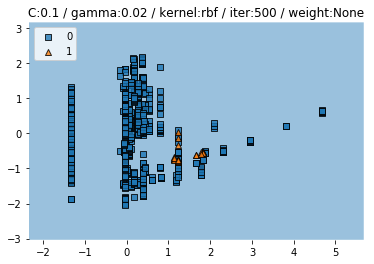

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


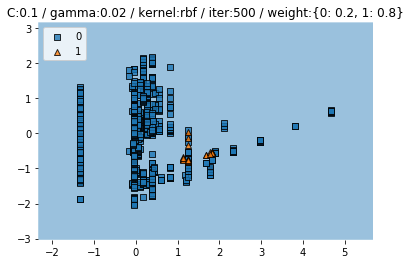

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


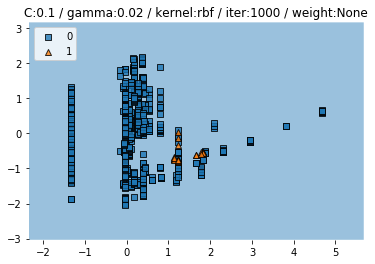

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


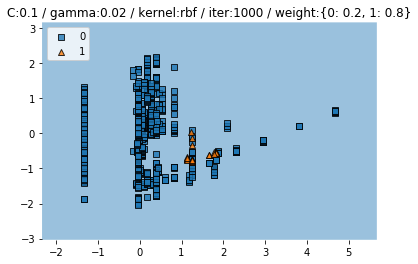

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


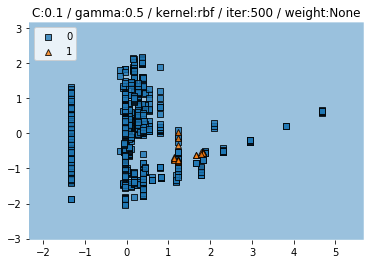

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


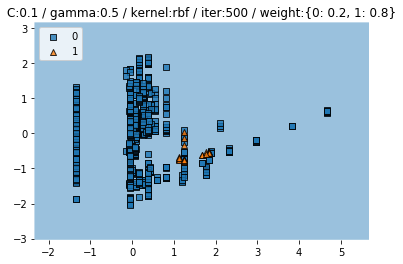

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


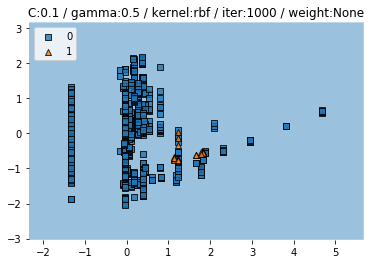

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


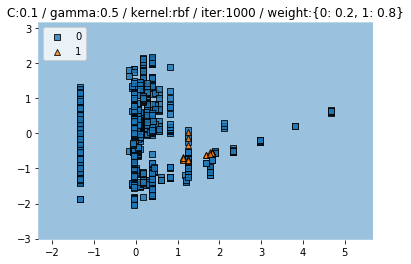

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


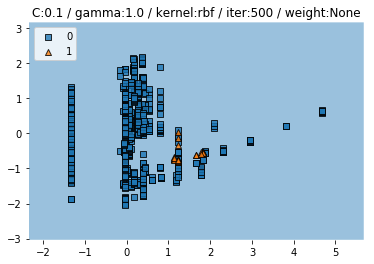

Train CV accuracy scores: [0.97540984 0.98770492 0.97540984 0.98360656 0.98360656]
Train CV accuracy: 0.981 +/- 0.005
Train CV f1 scores: [0.9632678  0.98569424 0.9632678  0.9795765  0.9795765 ]
Train CV f1: 0.974 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


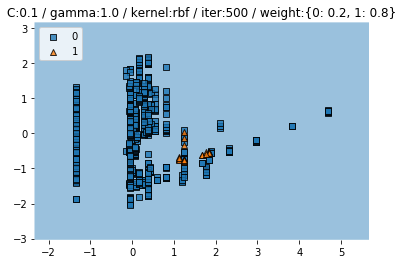

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.98360656 0.98360656]
Train CV accuracy: 0.979 +/- 0.004
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9795765 0.9795765]
Train CV f1: 0.970 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


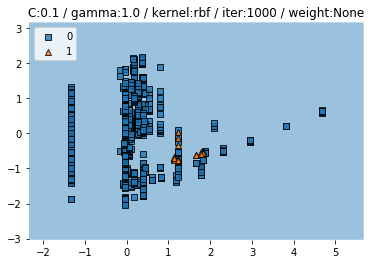

Train CV accuracy scores: [0.97540984 0.98770492 0.97540984 0.98360656 0.98360656]
Train CV accuracy: 0.981 +/- 0.005
Train CV f1 scores: [0.9632678  0.98569424 0.9632678  0.9795765  0.9795765 ]
Train CV f1: 0.974 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


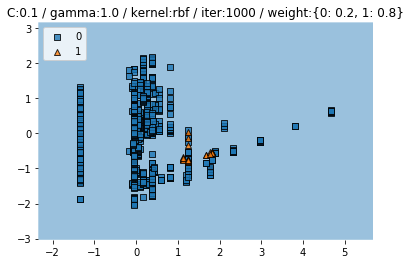

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.98360656 0.98360656]
Train CV accuracy: 0.979 +/- 0.004
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9795765 0.9795765]
Train CV f1: 0.970 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


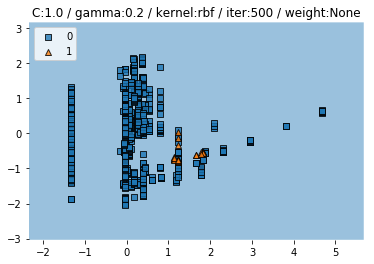

Train CV accuracy scores: [1.         1.         1.         0.98360656 0.98360656]
Train CV accuracy: 0.993 +/- 0.008
Train CV f1 scores: [1.        1.        1.        0.9795765 0.9795765]
Train CV f1: 0.992 +/- 0.010
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


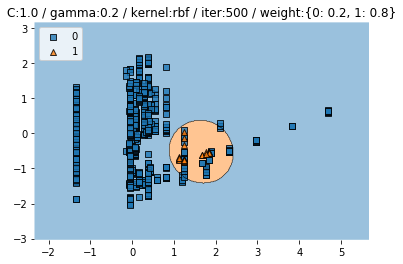

Train CV accuracy scores: [0.99590164 0.98770492 1.         0.98360656 0.98360656]
Train CV accuracy: 0.990 +/- 0.007
Train CV f1 scores: [0.99605495 0.98889544 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  0.9734939759036144
Test f1 :  0.5925925925925926


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


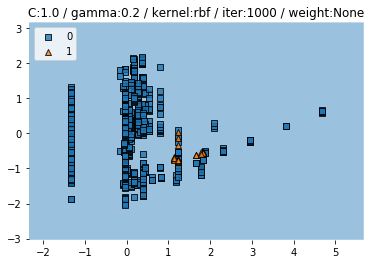

Train CV accuracy scores: [1.         1.         1.         0.98360656 0.98360656]
Train CV accuracy: 0.993 +/- 0.008
Train CV f1 scores: [1.        1.        1.        0.9795765 0.9795765]
Train CV f1: 0.992 +/- 0.010
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


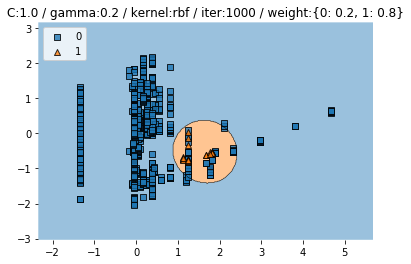

Train CV accuracy scores: [0.99590164 0.98770492 1.         0.98360656 0.98360656]
Train CV accuracy: 0.990 +/- 0.007
Train CV f1 scores: [0.99605495 0.98889544 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  0.9734939759036144
Test f1 :  0.5925925925925926


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


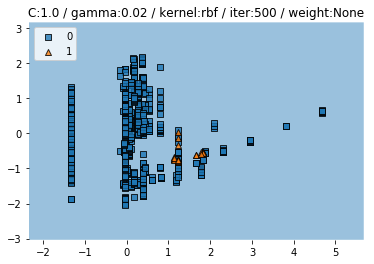

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


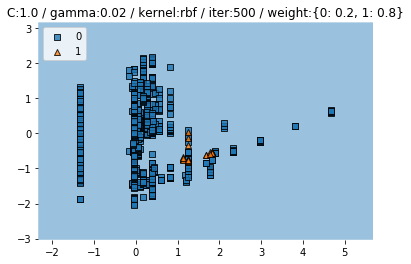

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


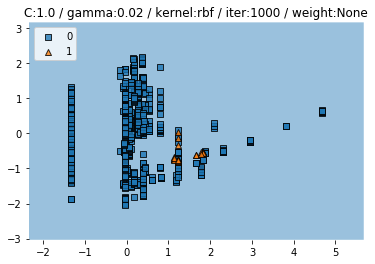

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


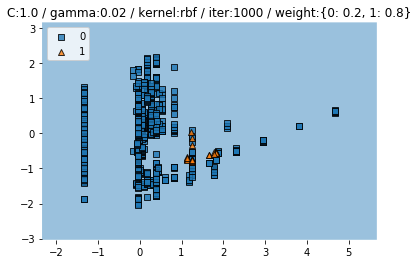

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


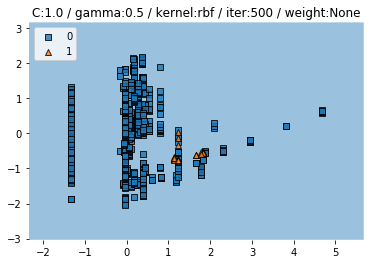

Train CV accuracy scores: [1.         0.98770492 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.008
Train CV f1 scores: [1.         0.98889544 1.         0.9795765  0.9795765 ]
Train CV f1: 0.990 +/- 0.009
Test accuracy :  0.9927710843373494
Test f1 :  0.8421052631578948


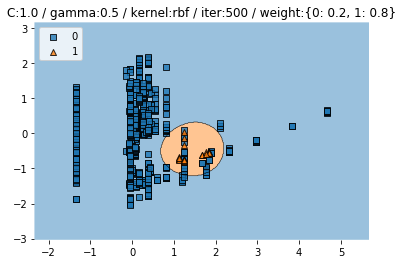

Train CV accuracy scores: [1.         0.98360656 1.         0.98360656 0.98360656]
Train CV accuracy: 0.990 +/- 0.008
Train CV f1 scores: [1.         0.98558627 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.009
Test accuracy :  0.983132530120482
Test f1 :  0.6956521739130436


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


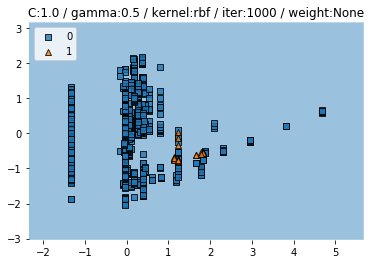

Train CV accuracy scores: [1.         0.98770492 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.008
Train CV f1 scores: [1.         0.98889544 1.         0.9795765  0.9795765 ]
Train CV f1: 0.990 +/- 0.009
Test accuracy :  0.9927710843373494
Test f1 :  0.8421052631578948


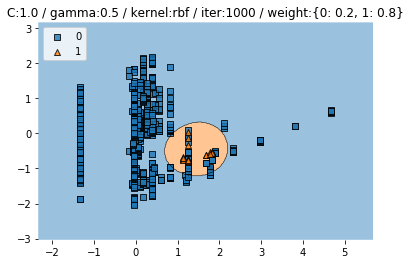

Train CV accuracy scores: [1.         0.98360656 1.         0.98360656 0.98360656]
Train CV accuracy: 0.990 +/- 0.008
Train CV f1 scores: [1.         0.98558627 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.009
Test accuracy :  0.983132530120482
Test f1 :  0.6956521739130436


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


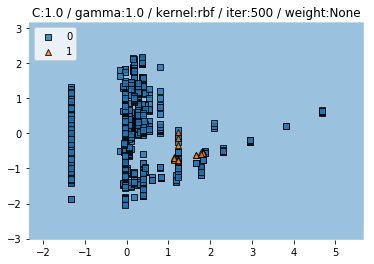

Train CV accuracy scores: [1.         0.98770492 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.008
Train CV f1 scores: [1.         0.98889544 1.         0.9795765  0.9795765 ]
Train CV f1: 0.990 +/- 0.009
Test accuracy :  0.9927710843373494
Test f1 :  0.8421052631578948


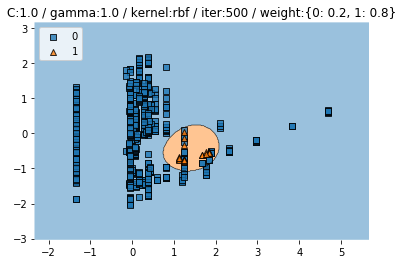

Train CV accuracy scores: [1.         0.9795082  1.         0.98360656 0.98360656]
Train CV accuracy: 0.989 +/- 0.009
Train CV f1 scores: [1.         0.98241293 1.         0.9795765  0.9795765 ]
Train CV f1: 0.988 +/- 0.010
Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


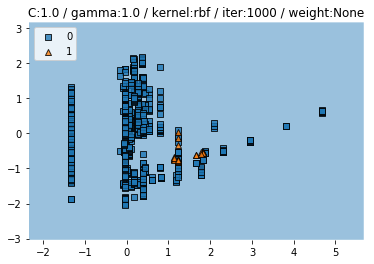

Train CV accuracy scores: [1.         0.98770492 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.008
Train CV f1 scores: [1.         0.98889544 1.         0.9795765  0.9795765 ]
Train CV f1: 0.990 +/- 0.009
Test accuracy :  0.9927710843373494
Test f1 :  0.8421052631578948


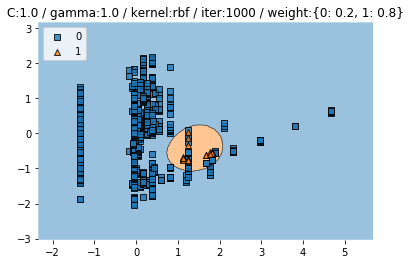

Train CV accuracy scores: [1.         0.9795082  1.         0.98360656 0.98360656]
Train CV accuracy: 0.989 +/- 0.009
Train CV f1 scores: [1.         0.98241293 1.         0.9795765  0.9795765 ]
Train CV f1: 0.988 +/- 0.010
Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


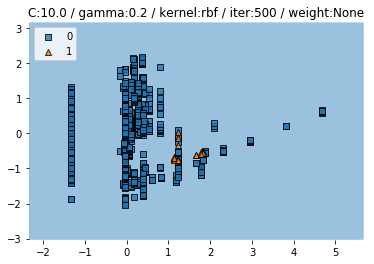

Train CV accuracy scores: [1.         0.97540984 1.         0.98360656 0.98360656]
Train CV accuracy: 0.989 +/- 0.010
Train CV f1 scores: [1.         0.97935124 1.         0.9795765  0.9795765 ]
Train CV f1: 0.988 +/- 0.010
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


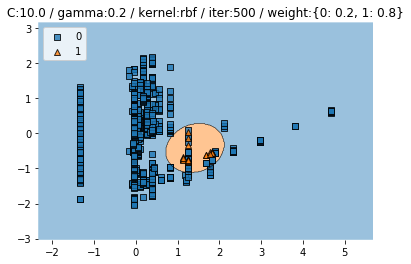

Train CV accuracy scores: [1.         0.96721311 1.         0.98360656 0.98360656]
Train CV accuracy: 0.987 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.9795765  0.9795765 ]
Train CV f1: 0.987 +/- 0.011
Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


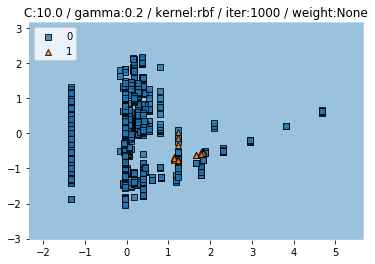

Train CV accuracy scores: [1.         0.97540984 1.         0.98360656 0.98360656]
Train CV accuracy: 0.989 +/- 0.010
Train CV f1 scores: [1.         0.97935124 1.         0.9795765  0.9795765 ]
Train CV f1: 0.988 +/- 0.010
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


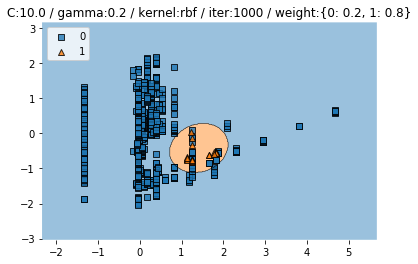

Train CV accuracy scores: [1.         0.96721311 1.         0.98360656 0.98360656]
Train CV accuracy: 0.987 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.9795765  0.9795765 ]
Train CV f1: 0.987 +/- 0.011
Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


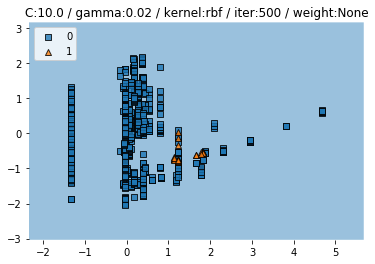

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


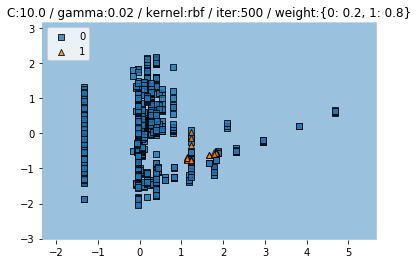

Train CV accuracy scores: [0.97131148 0.9795082  1.         0.95901639 0.9795082 ]
Train CV accuracy: 0.978 +/- 0.013
Train CV f1 scores: [0.97638211 0.98241293 1.         0.96185733 0.97859823]
Train CV f1: 0.980 +/- 0.012
Test accuracy :  0.9734939759036144
Test f1 :  0.5925925925925926


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


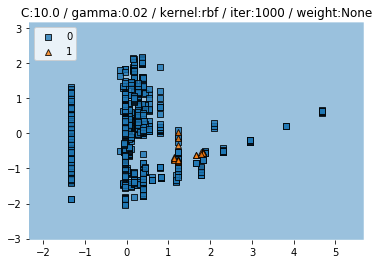

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


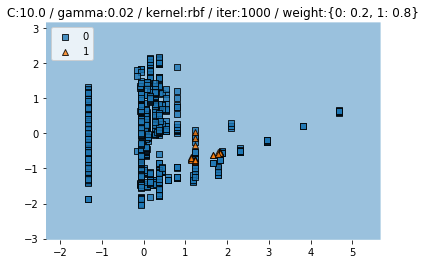

Train CV accuracy scores: [0.97131148 0.9795082  1.         0.95901639 0.9795082 ]
Train CV accuracy: 0.978 +/- 0.013
Train CV f1 scores: [0.97638211 0.98241293 1.         0.96185733 0.97859823]
Train CV f1: 0.980 +/- 0.012
Test accuracy :  0.9734939759036144
Test f1 :  0.5925925925925926


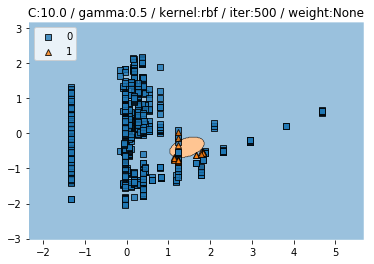

Train CV accuracy scores: [1.         0.96721311 1.         0.98360656 0.98770492]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.9795765  0.98569424]
Train CV f1: 0.988 +/- 0.011
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


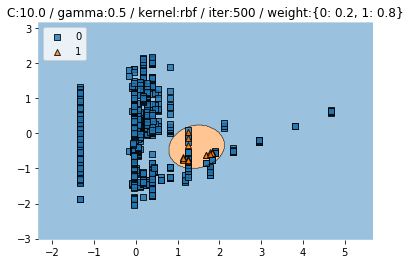

Train CV accuracy scores: [1.         0.96721311 1.         0.98360656 0.98770492]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.9795765  0.98569424]
Train CV f1: 0.988 +/- 0.011
Test accuracy :  0.9855421686746988
Test f1 :  0.7272727272727273


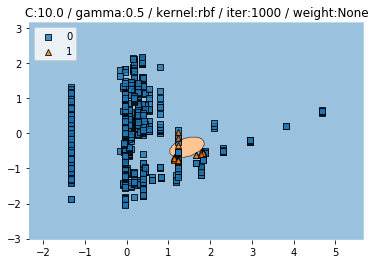

Train CV accuracy scores: [1.         0.96721311 1.         0.98360656 0.98770492]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.9795765  0.98569424]
Train CV f1: 0.988 +/- 0.011
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


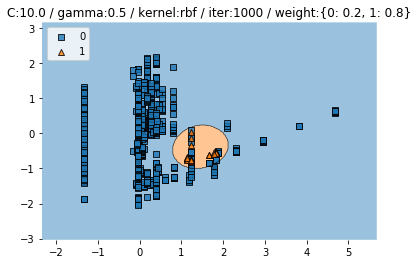

Train CV accuracy scores: [1.         0.96721311 1.         0.98360656 0.98770492]
Train CV accuracy: 0.988 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.9795765  0.98569424]
Train CV f1: 0.988 +/- 0.011
Test accuracy :  0.9855421686746988
Test f1 :  0.7272727272727273


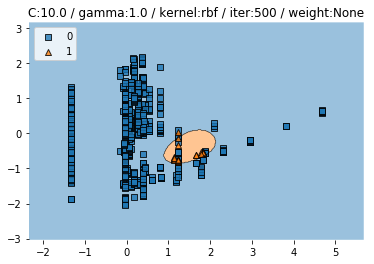

Train CV accuracy scores: [1.         0.96721311 1.         0.98770492 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.98569424 0.98569424]
Train CV f1: 0.989 +/- 0.010
Test accuracy :  0.9903614457831326
Test f1 :  0.8


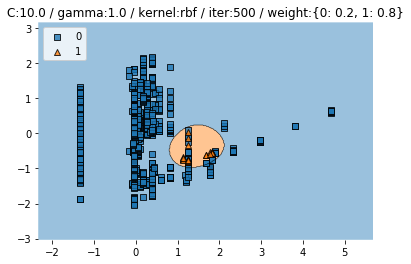

Train CV accuracy scores: [1.         0.96721311 1.         0.98770492 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.98569424 0.98569424]
Train CV f1: 0.989 +/- 0.010
Test accuracy :  0.983132530120482
Test f1 :  0.6956521739130436


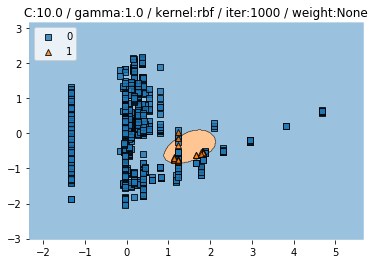

Train CV accuracy scores: [1.         0.96721311 1.         0.98770492 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.98569424 0.98569424]
Train CV f1: 0.989 +/- 0.010
Test accuracy :  0.9903614457831326
Test f1 :  0.8


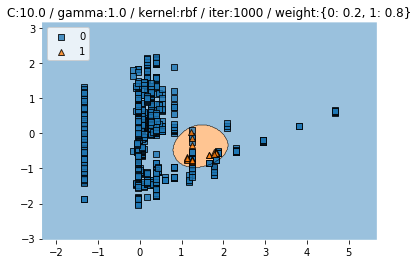

Train CV accuracy scores: [1.         0.96721311 1.         0.98770492 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.98569424 0.98569424]
Train CV f1: 0.989 +/- 0.010
Test accuracy :  0.983132530120482
Test f1 :  0.6956521739130436


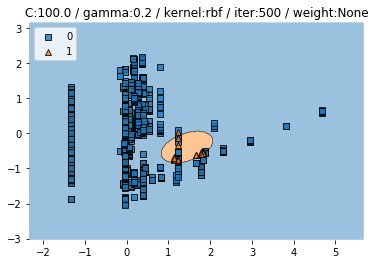

Train CV accuracy scores: [1.         0.96311475 1.         0.99180328 0.99180328]
Train CV accuracy: 0.989 +/- 0.014
Train CV f1 scores: [1.         0.97066331 1.         0.99100075 0.99100075]
Train CV f1: 0.991 +/- 0.011
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


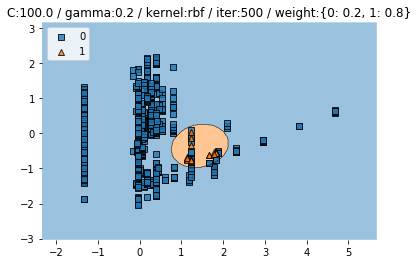

Train CV accuracy scores: [1.         0.96721311 1.         0.98770492 0.99180328]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.98569424 0.99100075]
Train CV f1: 0.990 +/- 0.010
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


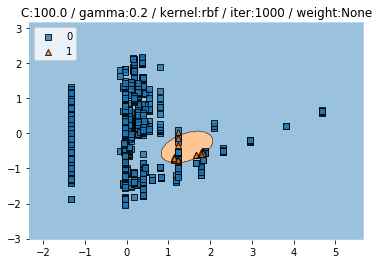

Train CV accuracy scores: [1.         0.96311475 1.         0.99180328 0.99180328]
Train CV accuracy: 0.989 +/- 0.014
Train CV f1 scores: [1.         0.97066331 1.         0.99100075 0.99100075]
Train CV f1: 0.991 +/- 0.011
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


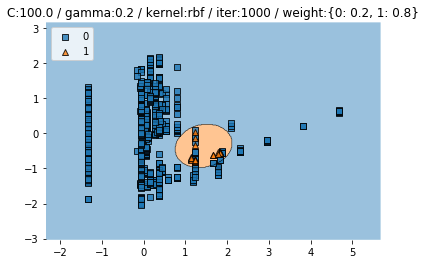

Train CV accuracy scores: [1.         0.96721311 1.         0.98770492 0.99180328]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.98569424 0.99100075]
Train CV f1: 0.990 +/- 0.010
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


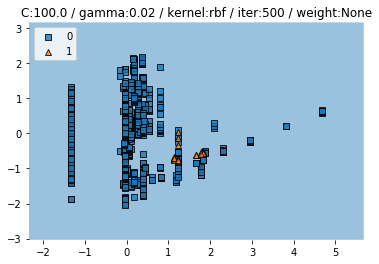

Train CV accuracy scores: [1.         1.         1.         0.98360656 0.98770492]
Train CV accuracy: 0.994 +/- 0.007
Train CV f1 scores: [1.         1.         1.         0.9795765  0.98569424]
Train CV f1: 0.993 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


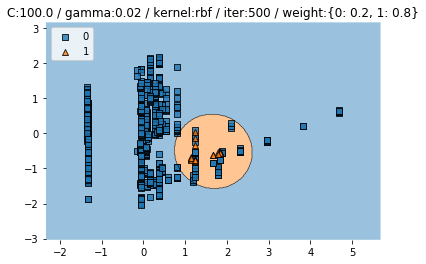

Train CV accuracy scores: [0.98770492 0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.991 +/- 0.005
Train CV f1 scores: [0.98889544 0.99237147 1.         0.9795765  0.99100075]
Train CV f1: 0.990 +/- 0.007
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


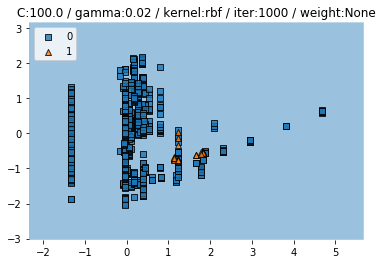

Train CV accuracy scores: [1.         1.         1.         0.98360656 0.98770492]
Train CV accuracy: 0.994 +/- 0.007
Train CV f1 scores: [1.         1.         1.         0.9795765  0.98569424]
Train CV f1: 0.993 +/- 0.009
Test accuracy :  1.0
Test f1 :  1.0


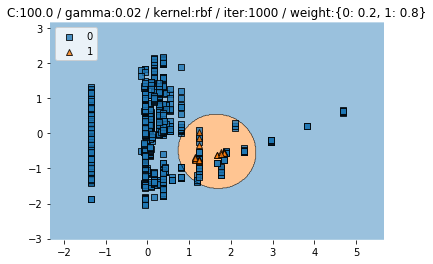

Train CV accuracy scores: [0.98770492 0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.991 +/- 0.005
Train CV f1 scores: [0.98889544 0.99237147 1.         0.9795765  0.99100075]
Train CV f1: 0.990 +/- 0.007
Test accuracy :  1.0
Test f1 :  1.0


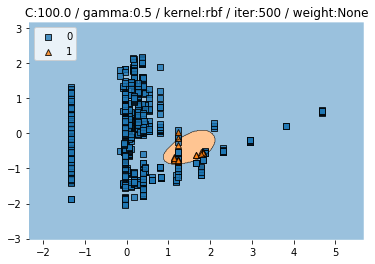

Train CV accuracy scores: [1.         0.96311475 1.         0.99590164 0.99180328]
Train CV accuracy: 0.990 +/- 0.014
Train CV f1 scores: [1.         0.97066331 1.         0.99571965 0.99100075]
Train CV f1: 0.991 +/- 0.011
Test accuracy :  1.0
Test f1 :  1.0


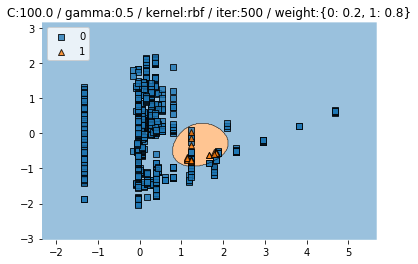

Train CV accuracy scores: [1.         0.96311475 1.         0.99590164 0.99180328]
Train CV accuracy: 0.990 +/- 0.014
Train CV f1 scores: [1.         0.97066331 1.         0.99571965 0.99100075]
Train CV f1: 0.991 +/- 0.011
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


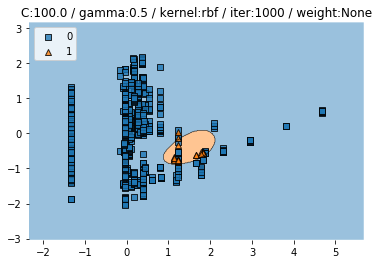

Train CV accuracy scores: [1.         0.96311475 1.         0.99590164 0.99180328]
Train CV accuracy: 0.990 +/- 0.014
Train CV f1 scores: [1.         0.97066331 1.         0.99571965 0.99100075]
Train CV f1: 0.991 +/- 0.011
Test accuracy :  1.0
Test f1 :  1.0


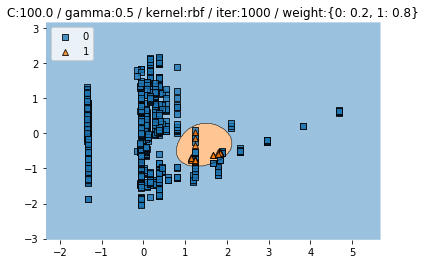

Train CV accuracy scores: [1.         0.96311475 1.         0.99590164 0.99180328]
Train CV accuracy: 0.990 +/- 0.014
Train CV f1 scores: [1.         0.97066331 1.         0.99571965 0.99100075]
Train CV f1: 0.991 +/- 0.011
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


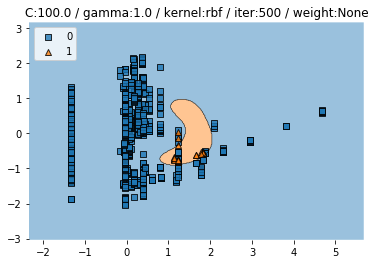

Train CV accuracy scores: [1.         0.96721311 1.         0.99180328 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.99100075 0.98569424]
Train CV f1: 0.990 +/- 0.010
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


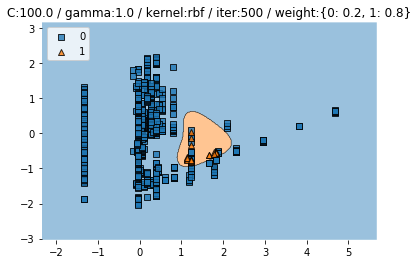

Train CV accuracy scores: [1.         0.96721311 1.         0.99180328 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.99100075 0.98569424]
Train CV f1: 0.990 +/- 0.010
Test accuracy :  0.9927710843373494
Test f1 :  0.8421052631578948


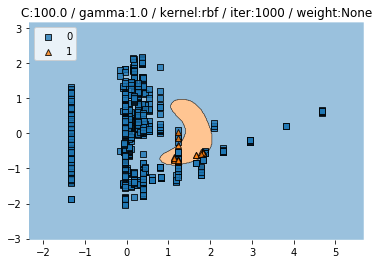

Train CV accuracy scores: [1.         0.96721311 1.         0.99180328 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.99100075 0.98569424]
Train CV f1: 0.990 +/- 0.010
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


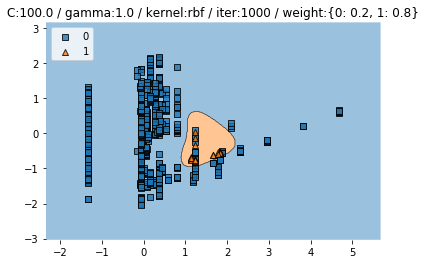

Train CV accuracy scores: [1.         0.96721311 1.         0.99180328 0.98770492]
Train CV accuracy: 0.989 +/- 0.012
Train CV f1 scores: [1.         0.97349026 1.         0.99100075 0.98569424]
Train CV f1: 0.990 +/- 0.010
Test accuracy :  0.9927710843373494
Test f1 :  0.8421052631578948
109.59913206100464 secs


In [ ]:
# shop title rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(6,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


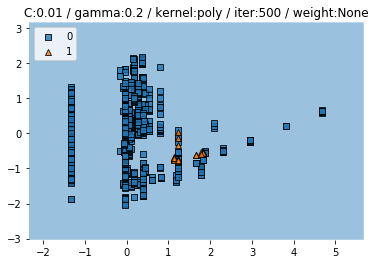

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


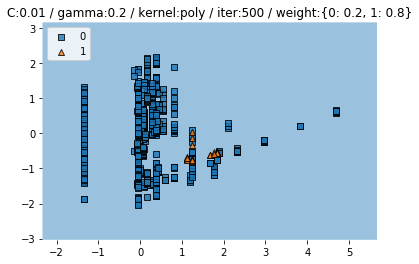

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


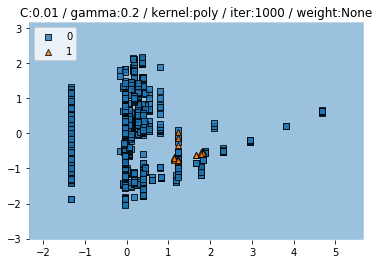

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


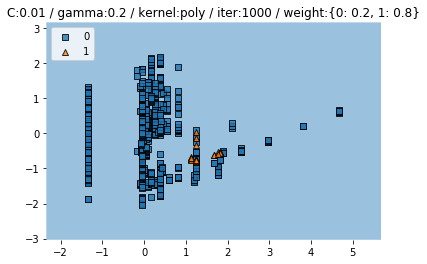

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


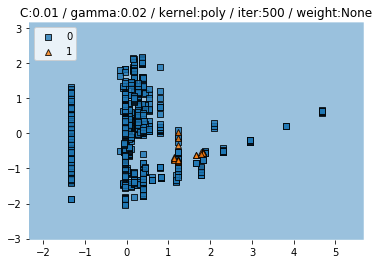

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


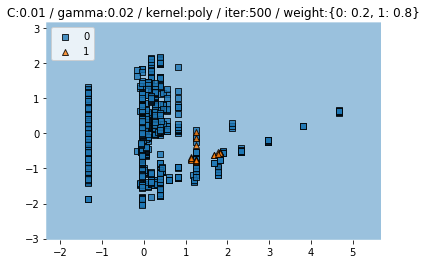

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


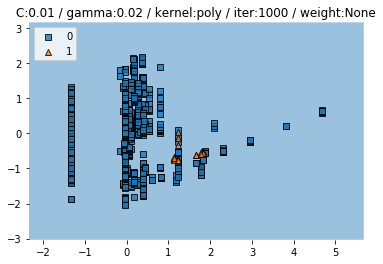

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


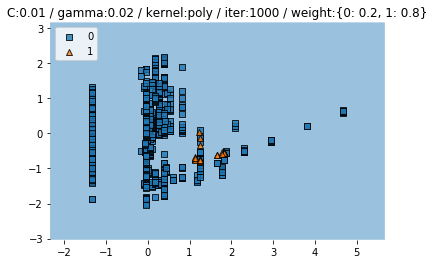

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


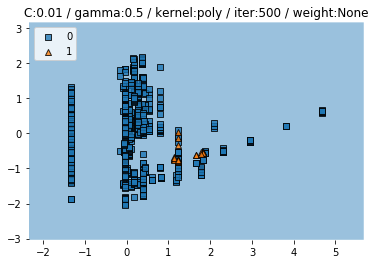

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


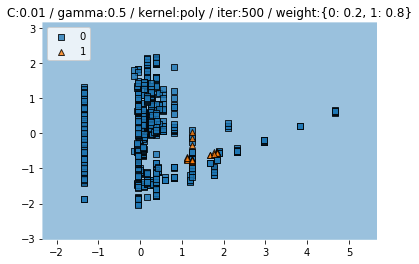

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.98360656 0.97540984]
Train CV accuracy: 0.977 +/- 0.003
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9795765 0.9632678]
Train CV f1: 0.967 +/- 0.007
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


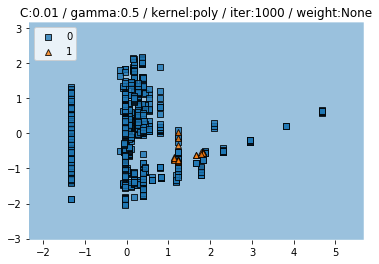

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


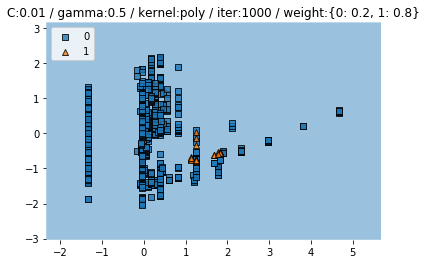

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.98360656 0.97540984]
Train CV accuracy: 0.977 +/- 0.003
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9795765 0.9632678]
Train CV f1: 0.967 +/- 0.007
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


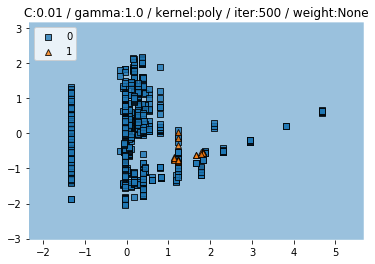

Train CV accuracy scores: [0.99590164 0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.007
Train CV f1 scores: [0.99571965 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


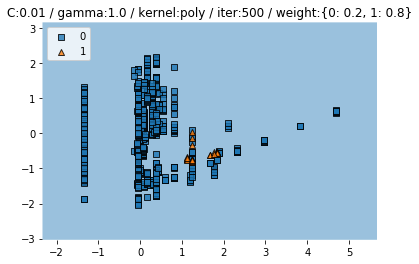

Train CV accuracy scores: [0.98770492 0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.98889544 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.988 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


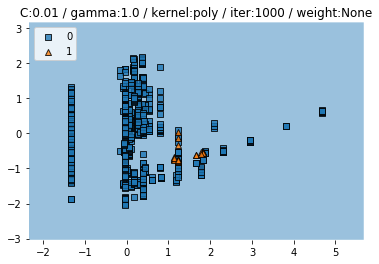

Train CV accuracy scores: [0.99590164 0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.007
Train CV f1 scores: [0.99571965 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


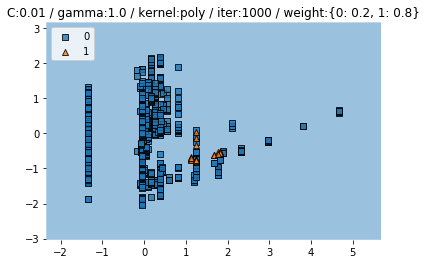

Train CV accuracy scores: [0.98770492 0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.989 +/- 0.006
Train CV f1 scores: [0.98889544 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.988 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


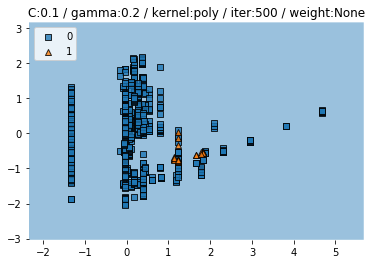

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


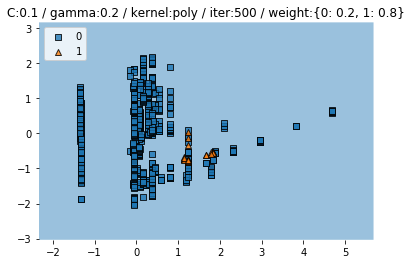

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


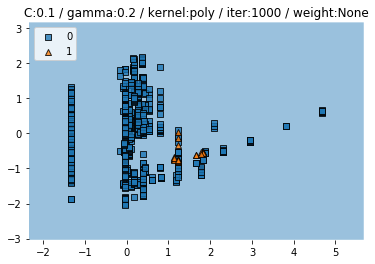

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


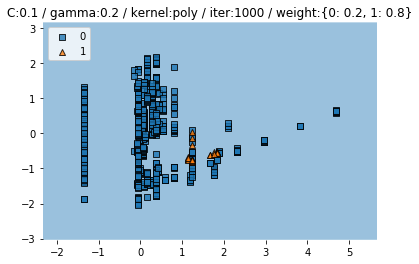

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


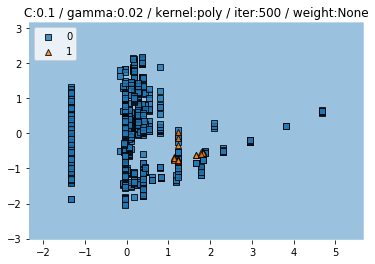

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


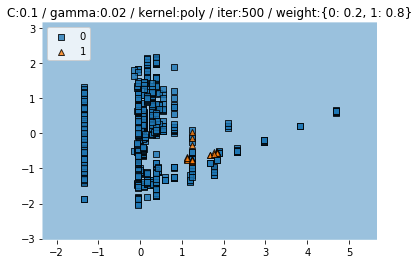

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


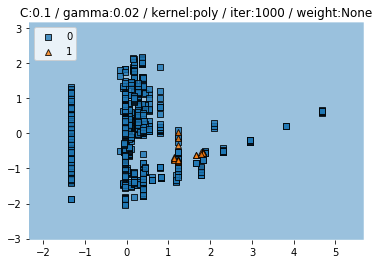

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


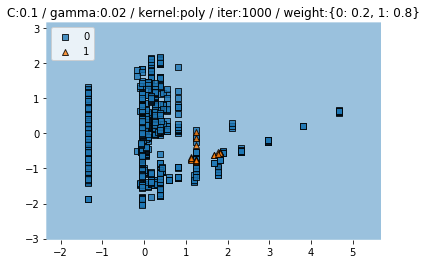

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


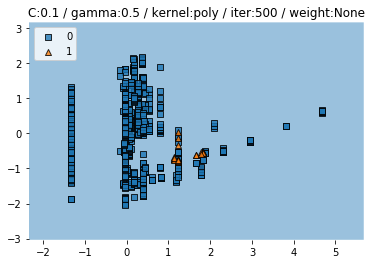

Train CV accuracy scores: [0.99590164 0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.007
Train CV f1 scores: [0.99571965 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


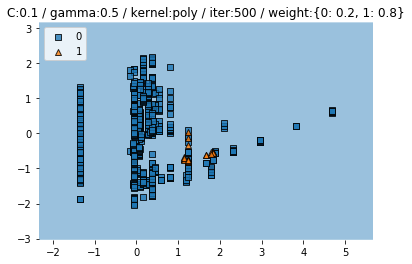

Train CV accuracy scores: [0.98770492 0.99590164 1.         0.98360656 0.98360656]
Train CV accuracy: 0.990 +/- 0.007
Train CV f1 scores: [0.98889544 0.99571965 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


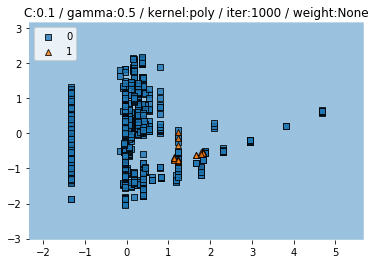

Train CV accuracy scores: [0.99590164 0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.991 +/- 0.007
Train CV f1 scores: [0.99571965 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


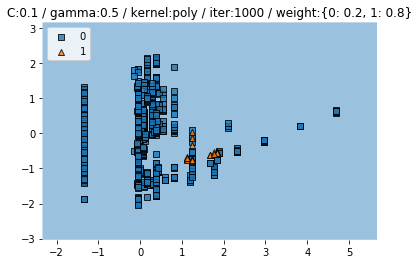

Train CV accuracy scores: [0.98770492 0.99590164 1.         0.98360656 0.98360656]
Train CV accuracy: 0.990 +/- 0.007
Train CV f1 scores: [0.98889544 0.99571965 1.         0.9795765  0.9795765 ]
Train CV f1: 0.989 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


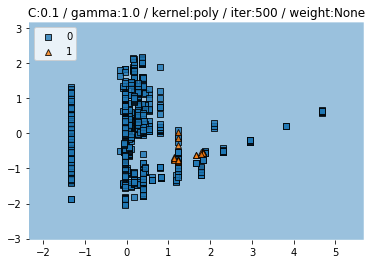

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.993 +/- 0.006
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.99100075]
Train CV f1: 0.992 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


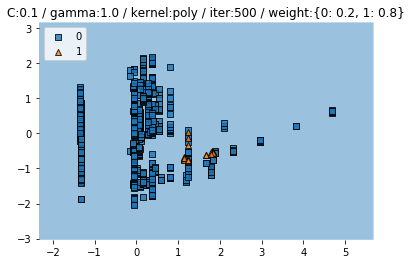

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.98770492]
Train CV accuracy: 0.993 +/- 0.007
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.98569424]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


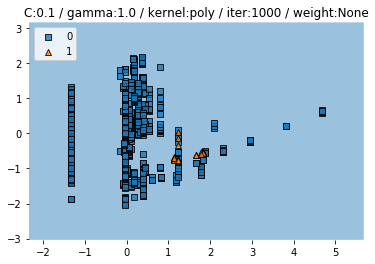

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.993 +/- 0.006
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.99100075]
Train CV f1: 0.992 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


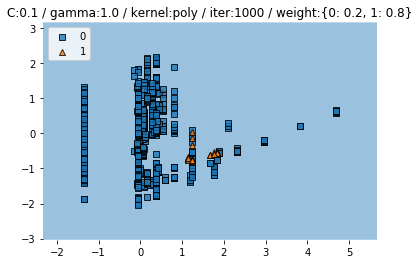

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.98770492]
Train CV accuracy: 0.993 +/- 0.007
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.98569424]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


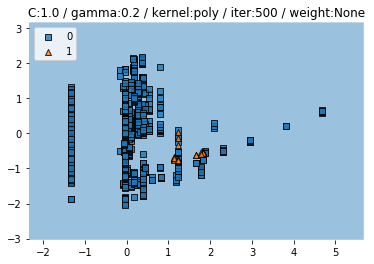

Train CV accuracy scores: [0.99590164 0.99180328 1.         0.98360656 0.9795082 ]
Train CV accuracy: 0.990 +/- 0.008
Train CV f1 scores: [0.99571965 0.99180328 1.         0.9795765  0.9722962 ]
Train CV f1: 0.988 +/- 0.010
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


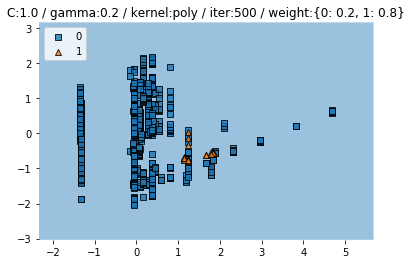

Train CV accuracy scores: [0.9795082  0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.988 +/- 0.007
Train CV f1 scores: [0.98241293 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.987 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


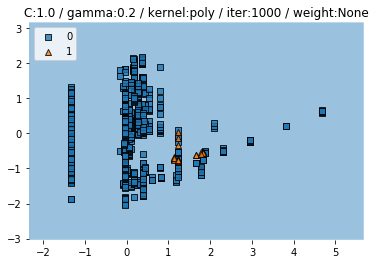

Train CV accuracy scores: [0.99590164 0.99180328 1.         0.98360656 0.9795082 ]
Train CV accuracy: 0.990 +/- 0.008
Train CV f1 scores: [0.99571965 0.99180328 1.         0.9795765  0.9722962 ]
Train CV f1: 0.988 +/- 0.010
Test accuracy :  0.9975903614457832
Test f1 :  0.9333333333333333


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


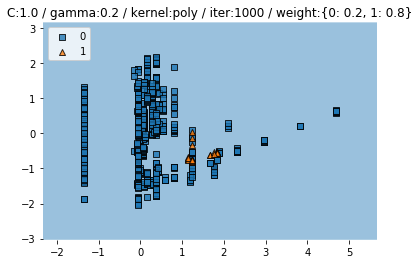

Train CV accuracy scores: [0.9795082  0.99180328 1.         0.98360656 0.98360656]
Train CV accuracy: 0.988 +/- 0.007
Train CV f1 scores: [0.98241293 0.99180328 1.         0.9795765  0.9795765 ]
Train CV f1: 0.987 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


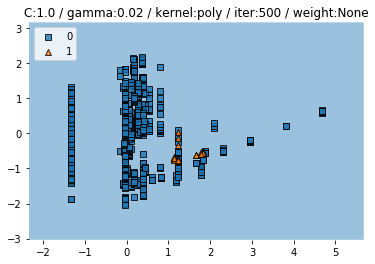

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


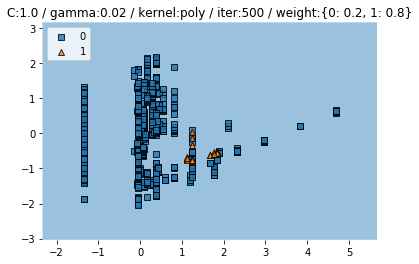

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


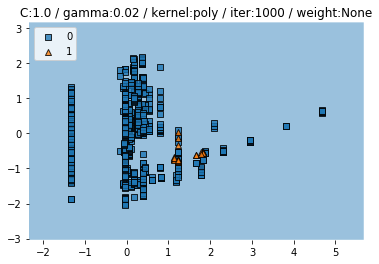

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


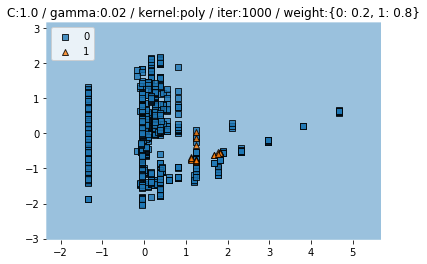

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


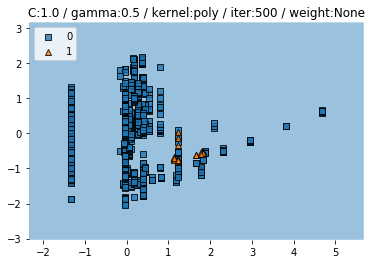

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.993 +/- 0.006
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.99100075]
Train CV f1: 0.992 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


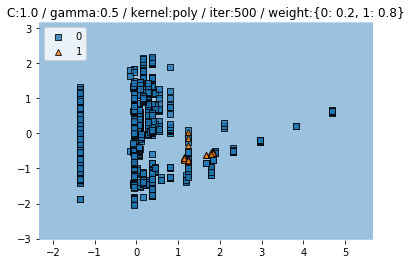

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.98770492]
Train CV accuracy: 0.993 +/- 0.007
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.98569424]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


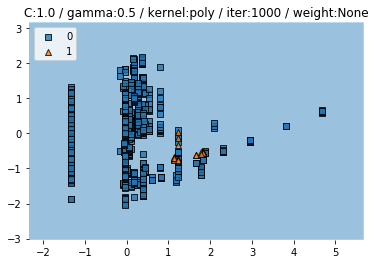

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.993 +/- 0.006
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.99100075]
Train CV f1: 0.992 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


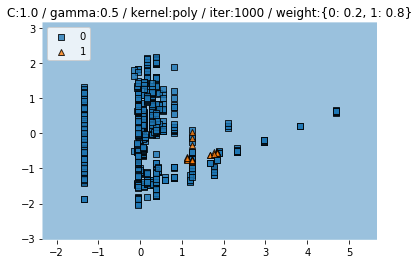

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.98770492]
Train CV accuracy: 0.993 +/- 0.007
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.98569424]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


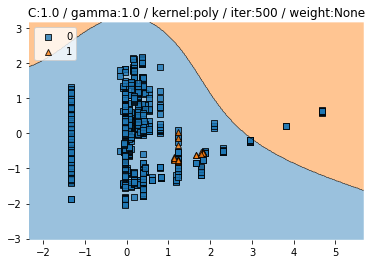

Train CV accuracy scores: [0.99590164 0.97540984 1.         0.98770492 0.99590164]
Train CV accuracy: 0.991 +/- 0.009
Train CV f1 scores: [0.99605495 0.97837941 1.         0.98569424 0.99571965]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


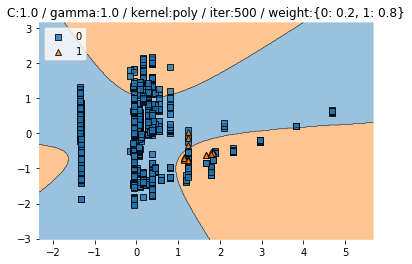

Train CV accuracy scores: [1.         0.97540984 1.         0.98770492 0.98770492]
Train CV accuracy: 0.990 +/- 0.009
Train CV f1 scores: [1.         0.97837941 1.         0.98569424 0.98816486]
Train CV f1: 0.990 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


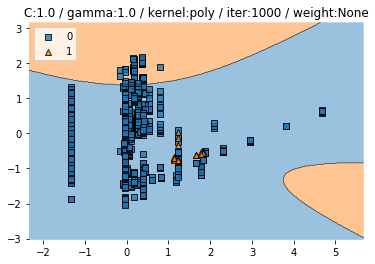

Train CV accuracy scores: [0.99590164 0.97540984 1.         0.98770492 0.99590164]
Train CV accuracy: 0.991 +/- 0.009
Train CV f1 scores: [0.99605495 0.97837941 1.         0.98569424 0.99571965]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


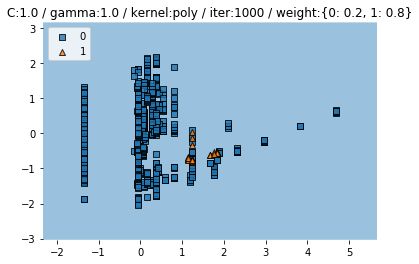

Train CV accuracy scores: [1.         0.97540984 1.         0.98770492 0.98770492]
Train CV accuracy: 0.990 +/- 0.009
Train CV f1 scores: [1.         0.97837941 1.         0.98569424 0.98816486]
Train CV f1: 0.990 +/- 0.008
Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


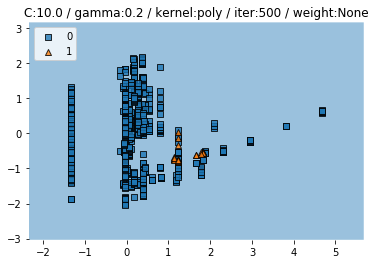

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.993 +/- 0.006
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.99100075]
Train CV f1: 0.992 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


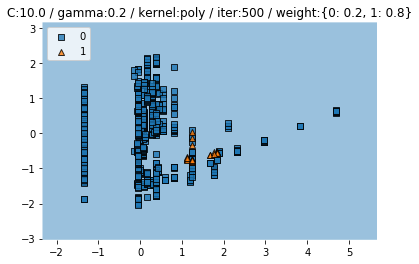

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.98770492]
Train CV accuracy: 0.993 +/- 0.007
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.98569424]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


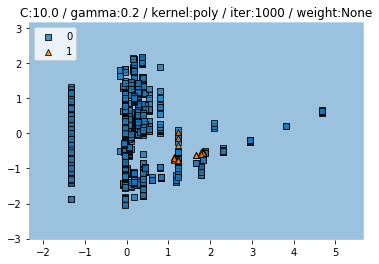

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.99180328]
Train CV accuracy: 0.993 +/- 0.006
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.99100075]
Train CV f1: 0.992 +/- 0.008
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


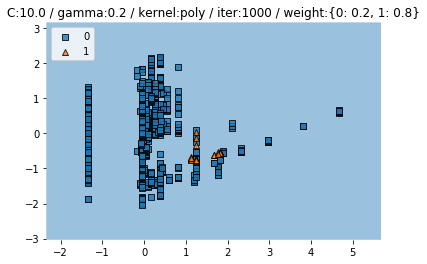

Train CV accuracy scores: [1.         0.99180328 1.         0.98360656 0.98770492]
Train CV accuracy: 0.993 +/- 0.007
Train CV f1 scores: [1.         0.99180328 1.         0.9795765  0.98569424]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


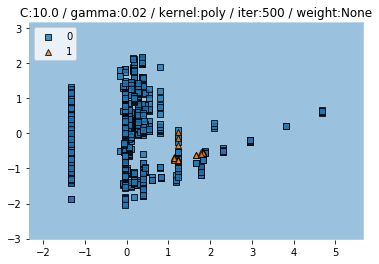

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


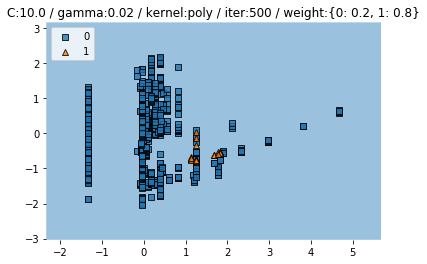

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


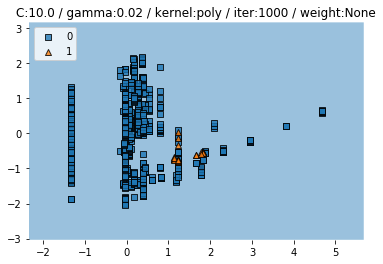

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


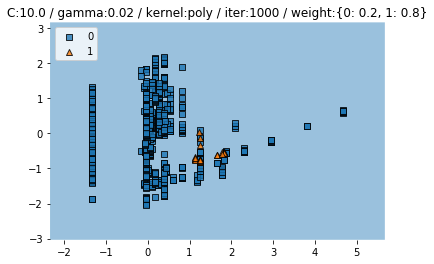

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


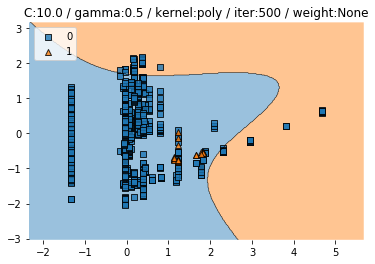

Train CV accuracy scores: [0.99590164 0.97540984 1.         0.98770492 0.99590164]
Train CV accuracy: 0.991 +/- 0.009
Train CV f1 scores: [0.99605495 0.97837941 1.         0.98569424 0.99571965]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


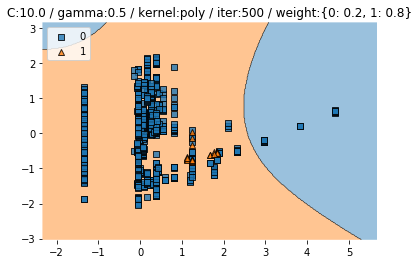

Train CV accuracy scores: [1.         0.97540984 1.         0.98770492 0.98770492]
Train CV accuracy: 0.990 +/- 0.009
Train CV f1 scores: [1.         0.97837941 1.         0.98569424 0.98816486]
Train CV f1: 0.990 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


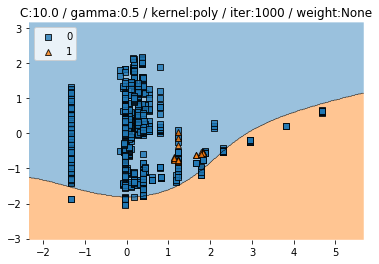

Train CV accuracy scores: [0.99590164 0.97540984 1.         0.98770492 0.99590164]
Train CV accuracy: 0.991 +/- 0.009
Train CV f1 scores: [0.99605495 0.97837941 1.         0.98569424 0.99571965]
Train CV f1: 0.991 +/- 0.008
Test accuracy :  0.9975903614457832
Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


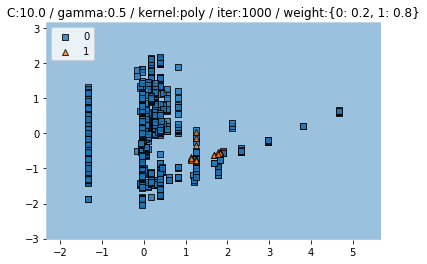

Train CV accuracy scores: [1.         0.97540984 1.         0.98770492 0.98770492]
Train CV accuracy: 0.990 +/- 0.009
Train CV f1 scores: [1.         0.97837941 1.         0.98569424 0.98816486]
Train CV f1: 0.990 +/- 0.008
Test accuracy :  0.9903614457831326
Test f1 :  0.8


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


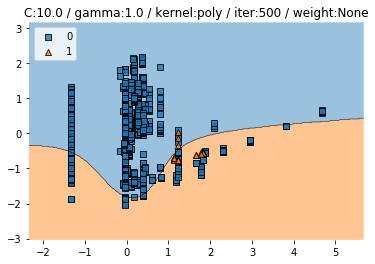

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


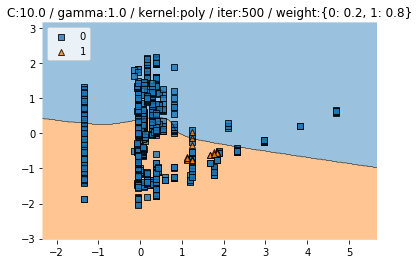

Train CV accuracy scores: [0.99590164 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.993 +/- 0.009
Train CV f1 scores: [0.99605495 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.993 +/- 0.008
Test accuracy :  0.9975903614457832


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  0.9411764705882353


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


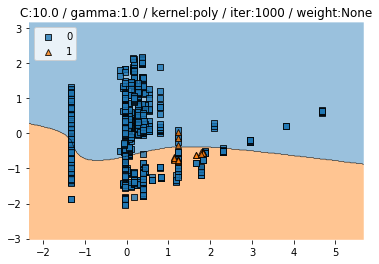

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


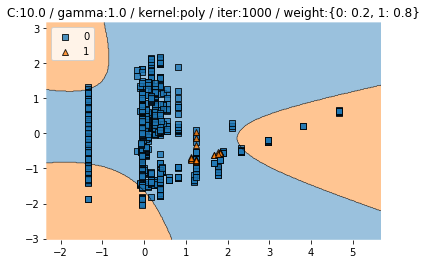

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


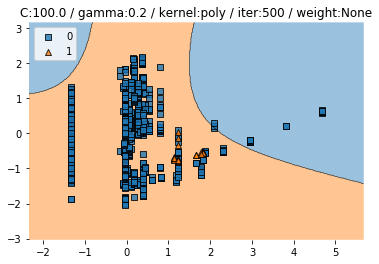

Train CV accuracy scores: [0.99590164 0.97540984 1.         0.98360656 0.99180328]
Train CV accuracy: 0.989 +/- 0.009
Train CV f1 scores: [0.99605495 0.97837941 1.         0.9795765  0.99180328]
Train CV f1: 0.989 +/- 0.009
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


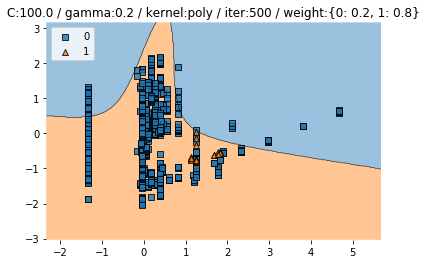

Train CV accuracy scores: [0.99180328 0.9795082  1.         0.98360656 0.98360656]
Train CV accuracy: 0.988 +/- 0.007
Train CV f1 scores: [0.99237147 0.98241293 1.         0.9795765  0.98474293]
Train CV f1: 0.988 +/- 0.007
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


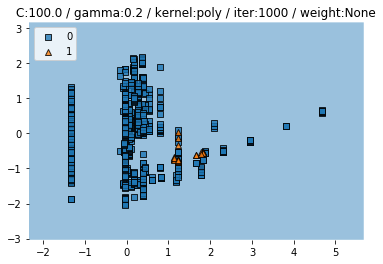

Train CV accuracy scores: [0.99590164 0.97540984 1.         0.98360656 0.99180328]
Train CV accuracy: 0.989 +/- 0.009
Train CV f1 scores: [0.99605495 0.97837941 1.         0.9795765  0.99180328]
Train CV f1: 0.989 +/- 0.009
Test accuracy :  0.9951807228915662


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


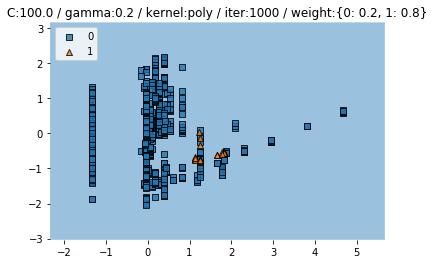

Train CV accuracy scores: [0.99180328 0.9795082  1.         0.98360656 0.98360656]
Train CV accuracy: 0.988 +/- 0.007
Train CV f1 scores: [0.99237147 0.98241293 1.         0.9795765  0.98474293]
Train CV f1: 0.988 +/- 0.007
Test accuracy :  0.9951807228915662
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


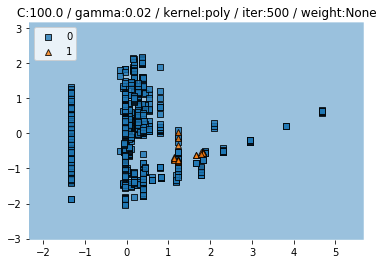

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


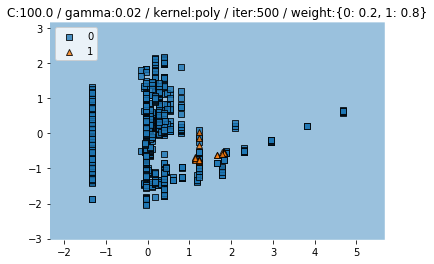

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


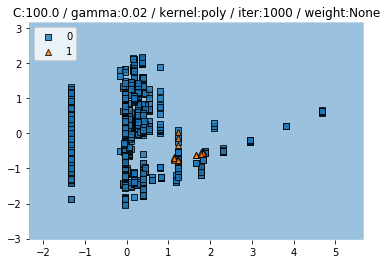

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


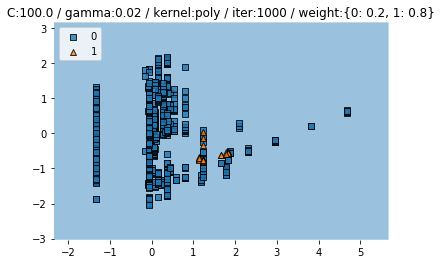

Train CV accuracy scores: [0.97540984 0.97540984 0.97540984 0.97540984 0.97540984]
Train CV accuracy: 0.975 +/- 0.000
Train CV f1 scores: [0.9632678 0.9632678 0.9632678 0.9632678 0.9632678]
Train CV f1: 0.963 +/- 0.000
Test accuracy :  0.980722891566265


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)


Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


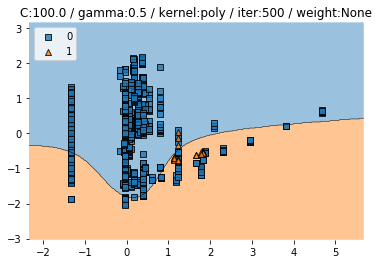

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


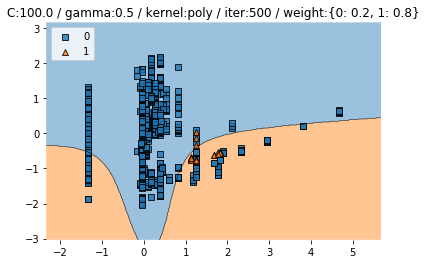

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


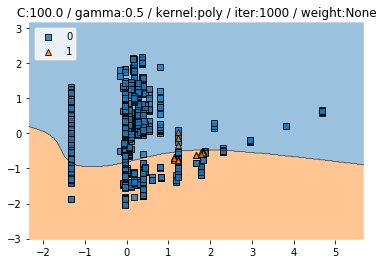

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


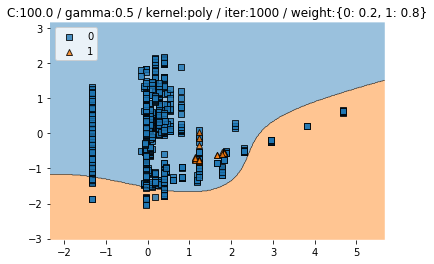

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


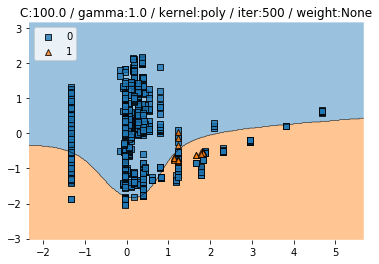

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0
Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


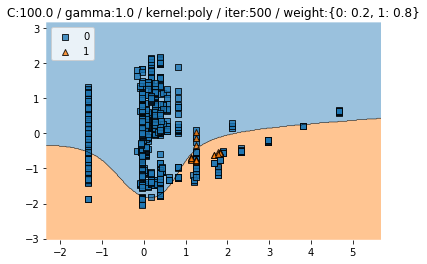

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


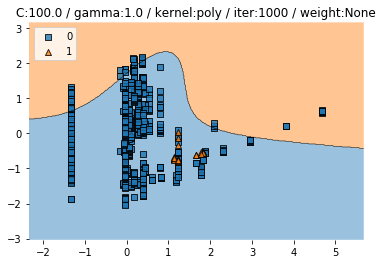

Train CV accuracy scores: [0.99180328 0.97540984 1.         0.99590164 0.99590164]
Train CV accuracy: 0.992 +/- 0.009
Train CV f1 scores: [0.99237147 0.97837941 1.         0.99571965 0.99571965]
Train CV f1: 0.992 +/- 0.007
Test accuracy :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test f1 :  1.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


In [ ]:
# shop title poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(6,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")